<a href="https://colab.research.google.com/github/jfaveloso/datasharing/blob/master/TESE_Artigo_1_GARCH.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# TESE - Artigo 1

João Veloso

ARTIGO 1 - Comportamento da Volatilidade em Fundos de Investimento Imobiliário: Análise de Riscos e Retornos via Modelos GARCH

A análise de séries temporais financeiras é fundamental na economia e nas finanças, pois oferece subsídios valiosos para compreender a dinâmica de ativos e índices. Um dos grandes desafios na análise desses dados consiste em lidar com a volatilidade, que tende a variar ao longo do tempo e frequentemente apresenta agrupamentos, sobretudo em períodos de crise ou expansão econômica. Para capturar essas particularidades, modelos como o GARCH (Generalized Autoregressive Conditional Heteroskedasticity) e suas variantes foram desenvolvidos, possibilitando modelagens mais precisas da volatilidade.

Este estudo se concentra nas séries temporais de fundos de investimento imobiliário (FIIs), que têm se consolidado como uma importante classe de ativos em diversos mercados financeiros. Os FIIs analisados estão classificados de acordo com seu setor de atuação, incluindo segmentos como shoppings, escritórios e galpões logísticos. Cada tipo de fundo pode exibir padrões específicos de volatilidade, decorrentes das particularidades de cada segmento do mercado imobiliário. Diante disso, o uso de modelos de volatilidade condicional torna-se relevante para captar essas especificidades.

Os principais objetivos deste trabalho são:

- Ajustar diferentes especificações de modelos GARCH (como GARCH-M, IGARCH, EGARCH, FIGARCH, entre outros) às séries de retorno dos FIIs e comparar o desempenho de cada especificação.
- Identificar a melhor configuração de variáveis exógenas e dummies para cada série, a fim de minimizar os critérios de informação AIC (Akaike Information Criterion) e BIC (Bayesian Information Criterion), selecionando o modelo que melhor se ajusta a cada setor de atuação.

Espera-se que este estudo aponte a combinação de modelo e variáveis exógenas mais adequada para descrever o comportamento da volatilidade em cada tipo de fundo de investimento imobiliário analisado. Os resultados almejados visam fornecer uma compreensão mais detalhada da dinâmica dos diferentes segmentos do mercado imobiliário, contribuindo para decisões de investimento mais fundamentadas e alinhadas às características específicas de cada fundo.

# **1. BIBLIOTECAS**

In [1]:
# # @title DRIVE

# from google.colab import drive
# drive.mount('/content/drive')

directory = '/content/drive/MyDrive/tese/economatica-20241029'

In [2]:
# @title 1.1. Instalações de Bibliotecas

# Instalação de Bibliotecas para Análise e Modelagem
!pip install ruptures
!pip install arch
!pip install statsmodels
!pip install scipy
!pip install openpyxl
!pip install python-bcb
!pip install rpy2

# Instalações Alternativas e Atualizações
# !apt-get update
# !apt-get install -y build-essential
# !apt-get install -y python3-dev
# !apt-get install -y python3-pip
# !apt-get install -y python3-setuptools
# !pip install arch==4.19
# !pip install arch --upgrade  # Assegura que o arch esteja atualizado
# !pip install --no-binary :all: arch
# !pip install git+https://github.com/bashtage/arch.git
# !pip install -U nbconvert

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 13.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 985.1/985.1 kB 15.0 MB/s eta 0:00:00


In [3]:
# @title 1.2. Carregamento de Bibliotecas

# Manipulação de Dados e Operações de Data
import pandas as pd
import numpy as np
from datetime import date, datetime, timedelta
import os

# Funções Matemáticas
import math
from math import sqrt

# Visualização de Dados
import matplotlib.pyplot as plt
import seaborn as sns
from itertools import combinations

# Análise de Séries Temporais
import ruptures as rpt
import statsmodels.api as sm
from statsmodels.tsa.seasonal import STL
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.api import VAR
from statsmodels.tsa.stattools import adfuller, kpss
from statsmodels.regression.linear_model import OLS

# Estatística e Testes
import scipy.stats as stats
from scipy.stats import shapiro
from statsmodels.stats.diagnostic import (
    acorr_ljungbox, het_arch, het_breuschpagan, het_white
)
from statsmodels.tsa.vector_ar.vecm import coint_johansen

# Modelagem Econométrica e GARCH
from arch import arch_model
from scipy.optimize import minimize

# Importação de Dados do Banco Central do Brasil
from bcb import sgs

# Integração com o R
import rpy2.robjects as ro
from rpy2.robjects import pandas2ri
from rpy2.robjects.packages import importr

# **2. EXTRAÇÃO DE DADOS**

In [4]:
# @title 2.1. Cadastro FIIs

# Caminho do arquivo CSV
file_path = '/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029.csv'

# Tentar carregar o arquivo CSV com uma codificação alternativa
df_cadastro = pd.read_csv(file_path, delimiter=',', encoding='latin1')

# Exibir as primeiras linhas para confirmação
print(df_cadastro.head())

          Ativo                                Nome Classe  Código  \
0  RBDS11<XBSP>       Rb Capital Desenv Residencial    NaN  RBDS11   
1  RCFA11<XBSP>      Grupo Rcfa Fundo de Investimen    NaN  RCFA11   
2  REIT11<XBSP>                       Singulare FII    NaN  REIT11   
3  MFCR11<XBSP>  Mérito Recebíveis Imobiliários FII    NaN  MFCR11   
4  EGYR11<XBSP>      Energy Resort Fundo de Investi    NaN  EGYR11   

           ISIN                  Link para|regulamento CVM|30Out24  \
0  BRRBDSCTF006  https://fnet.bmfbovespa.com.br/fnet/publico/do...   
1  BRRCFACTF007  https://fnet.bmfbovespa.com.br/fnet/publico/do...   
2  BRREITCTF007  https://fnet.bmfbovespa.com.br/fnet/publico/do...   
3  BRMFCRCTF002  https://fnet.bmfbovespa.com.br/fnet/publico/do...   
4  BREGYRCTF001  https://fnet.bmfbovespa.com.br/fnet/publico/do...   

                    Link para o|regulamento (antigo)  \
0  http://cvmweb.cvm.gov.br/SWB/Sistemas/SCW/CPub...   
1  http://cvmweb.cvm.gov.br/SWB/Sistemas/SCW/C

In [5]:
# @title 2.2. Função load_dataframe

def load_dataframe(file_path, columns, encoding='latin-1'):
    try:
        df1 = pd.read_csv(file_path, usecols=columns, encoding=encoding)
        df1.set_index('Data', inplace=True)
        return df1
    except pd.errors.ParserError as e:
        print(f"Error parsing file {file_path}: {e}")
        return None
    except pd.errors.EmptyDataError as e:
        print(f"Empty data in file {file_path}: {e}")
        return None
    except Exception as e:
        print(f"An error occurred while loading file {file_path}: {e}")
        return None

In [6]:
# @title 2.3. Lista que arquivos

files_and_names1 = [
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-KNIP11.csv','KNIP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-KNCR11.csv','KNCR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-XPML11.csv','XPML11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HGLG11.csv','HGLG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-MXRF11.csv','MXRF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BTLG11.csv','BTLG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-KNRI11.csv','KNRI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VISC11.csv','VISC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-KNHY11.csv','KNHY11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-XPLG11.csv','XPLG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ANCR11.csv','ANCR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HGBS11.csv','HGBS11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-IRDM11.csv','IRDM11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TGAR11.csv','TGAR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CPTS11.csv','CPTS11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HGRU11.csv','HGRU11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PVBI11.csv','PVBI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RECR11.csv','RECR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TRXF11.csv','TRXF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HSML11.csv','HSML11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-KNHF11.csv','KNHF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BRCO11.csv','BRCO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-LVBI11.csv','LVBI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RZTR11.csv','RZTR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-KNUQ11.csv','KNUQ11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HGCR11.csv','HGCR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TVRI11.csv','TVRI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HFOF11.csv','HFOF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VGIR11.csv','VGIR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-MCCI11.csv','MCCI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-JSRE11.csv','JSRE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-MALL11.csv','MALL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VGHF11.csv','VGHF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VRTA11.csv','VRTA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HGRE11.csv','HGRE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBRR11.csv','RBRR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VCJR11.csv','VCJR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ALZR11.csv','ALZR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBVA11.csv','RBVA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VILG11.csv','VILG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-KNSC11.csv','KNSC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BRCR11.csv','BRCR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBRY11.csv','RBRY11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-GARE11.csv','GARE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-GZIT11.csv','GZIT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-GGRC11.csv','GGRC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HSLG11.csv','HSLG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VGIP11.csv','VGIP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-MCHY11.csv','MCHY11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CVBI11.csv','CVBI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BBIG11.csv','BBIG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBRF11.csv','RBRF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BTCI11.csv','BTCI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BVAR11.csv','BVAR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-GTWR11.csv','GTWR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-KORE11.csv','KORE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HSRE11.csv','HSRE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PQAG11.csv','PQAG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-URPR11.csv','URPR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CPSH11.csv','CPSH11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VJFD11.csv','VJFD11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RVBI11.csv','RVBI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-GSFI11.csv','GSFI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-XPCI11.csv','XPCI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RZAK11.csv','RZAK11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RZZR11.csv','RZZR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-JSAF11.csv','JSAF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HABT11.csv','HABT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBRP11.csv','RBRP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CCME11.csv','CCME11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BPML11.csv','BPML11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HCTR11.csv','HCTR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FPNG11.csv','FPNG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BROF11.csv','BROF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TRBL11.csv','TRBL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-NVHO11.csv','NVHO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HGPO11.csv','HGPO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-KFOF11.csv','KFOF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SHPH11.csv','SHPH11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-XPIN11.csv','XPIN11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-MFII11.csv','MFII11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ITRI11.csv','ITRI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RCRB11.csv','RCRB11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CACR11.csv','CACR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBRL11.csv','RBRL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TRXB11.csv','TRXB11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BTSI11.csv','BTSI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-DEVA11.csv','DEVA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HREC11.csv','HREC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TRNT11.csv','TRNT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-AFHI11.csv','AFHI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BTAL11.csv','BTAL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VINO11.csv','VINO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TOPP11.csv','TOPP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CLIN11.csv','CLIN11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SJAU11.csv','SJAU11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BCRI11.csv','BCRI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FCFL11.csv','FCFL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-EVBI11.csv','EVBI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SNCI11.csv','SNCI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RZAT11.csv','RZAT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CPLG11.csv','CPLG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ICRI11.csv','ICRI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TEPP11.csv','TEPP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-JASC11.csv','JASC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SARE11.csv','SARE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HLOG11.csv','HLOG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ABCP11.csv','ABCP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-INLG11.csv','INLG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VRTM11.csv','VRTM11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BARI11.csv','BARI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FIIB11.csv','FIIB11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BCIA11.csv','BCIA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-KISU11.csv','KISU11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-LASC11.csv','LASC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-KCRE11.csv','KCRE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-MANA11.csv','MANA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CYCR11.csv','CYCR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CPOF11.csv','CPOF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FATN11.csv','FATN11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VGRI11.csv','VGRI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PORD11.csv','PORD11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RPRI11.csv','RPRI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBED11.csv','RBED11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-XPSF11.csv','XPSF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-NEWL11.csv','NEWL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HPDP11.csv','HPDP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HTMX11.csv','HTMX11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-WHGR11.csv','WHGR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TJKB11.csv','TJKB11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BPFF11.csv','BPFF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BBFO11.csv','BBFO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PATL11.csv','PATL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-JCCJ11.csv','JCCJ11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-OUJP11.csv','OUJP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RECT11.csv','RECT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBRX11.csv','RBRX11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SNFF11.csv','SNFF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VVMR11.csv','VVMR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CXCO11.csv','CXCO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-LIFE11.csv','LIFE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FAMB11.csv','FAMB11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-AJFI11.csv','AJFI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-QAGR11.csv','QAGR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-APXM11.csv','APXM11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-AIEC11.csv','AIEC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HBCR11.csv','HBCR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-NSLU11.csv','NSLU11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HGFF11.csv','HGFF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-GRUL11.csv','GRUL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-JSCR11.csv','JSCR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BRIP11.csv','BRIP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PQDP11.csv','PQDP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BTYU11.csv','BTYU11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RINV11.csv','RINV11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-JCIN11.csv','JCIN11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HSAF11.csv','HSAF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBFF11.csv','RBFF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VTLT11.csv','VTLT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SPXS11.csv','SPXS11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FLMA11.csv','FLMA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-GAME11.csv','GAME11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VXXV11.csv','VXXV11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RMAI11.csv','RMAI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-AROA11.csv','AROA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBHG11.csv','RBHG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SNEL11.csv','SNEL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PLCR11.csv','PLCR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BBRC11.csv','BBRC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CJCT11.csv','CJCT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FPAB11.csv','FPAB11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ARRI11.csv','ARRI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FVPQ11.csv','FVPQ11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SPGM16.csv','SPGM16'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-KIVO11.csv','KIVO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBHY11.csv','RBHY11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BLCA11.csv','BLCA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CPFF11.csv','CPFF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-KEVE11.csv','KEVE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RSPD11.csv','RSPD11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-MCEM11.csv','MCEM11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VIUR11.csv','VIUR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FIIP11.csv','FIIP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CXCI11.csv','CXCI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CXAG11.csv','CXAG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BLOG11.csv','BLOG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VSHO11.csv','VSHO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FIGS11.csv','FIGS11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BLMG11.csv','BLMG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FLRP11.csv','FLRP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HUSI11.csv','HUSI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BRIM11.csv','BRIM11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VCRI11.csv','VCRI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SADI11.csv','SADI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PMIS11.csv','PMIS11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VCRR11.csv','VCRR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SAPI11.csv','SAPI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-AZPL11.csv','AZPL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-IRIM11.csv','IRIM11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-NCHB11.csv','NCHB11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RNGO11.csv','RNGO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FISC11.csv','FISC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBIR11.csv','RBIR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HGBL11.csv','HGBL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VVCO11.csv','VVCO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BTRA11.csv','BTRA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BTSG11.csv','BTSG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ZAVI11.csv','ZAVI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PATC11.csv','PATC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HAAA11.csv','HAAA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PULV11.csv','PULV11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SPDE11.csv','SPDE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ALZM11.csv','ALZM11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CXRI11.csv','CXRI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-XPPR11.csv','XPPR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-JFLL11.csv','JFLL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BICE11.csv','BICE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VSLH11.csv','VSLH11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HDEL11.csv','HDEL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HUCG11.csv','HUCG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FAED11.csv','FAED11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BMLC11.csv','BMLC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HOFC11.csv','HOFC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-GCRI11.csv','GCRI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HUSC11.csv','HUSC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ATSA11.csv','ATSA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-EQIR11.csv','EQIR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-EURO11.csv','EURO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BTWR11.csv','BTWR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TCIN15.csv','TCIN15'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TMPS11.csv','TMPS11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SEQR11.csv','SEQR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HCHG11.csv','HCHG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SHOP11.csv','SHOP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-INRD11.csv','INRD11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VVRI11.csv','VVRI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BNFS11.csv','BNFS11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-OULG11.csv','OULG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-AURB11.csv','AURB11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CEOC11.csv','CEOC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SNLG11.csv','SNLG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-DVFF11.csv','DVFF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-MAXR11.csv','MAXR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RELG11.csv','RELG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-JPPA11.csv','JPPA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBRS11.csv','RBRS11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-DVLP11.csv','DVLP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RFOF11.csv','RFOF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BLMO11.csv','BLMO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PMFO11.csv','PMFO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VVCR11.csv','VVCR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CXCE11.csv','CXCE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-EXES11.csv','EXES11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-EDGA11.csv','EDGA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PNPR11.csv','PNPR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBRD11.csv','RBRD11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SNME11.csv','SNME11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SPTW11.csv','SPTW11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ERPA11.csv','ERPA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ITIT11.csv','ITIT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ALMI11.csv','ALMI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ALZC11.csv','ALZC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VOTS11.csv','VOTS11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FLCR11.csv','FLCR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-WPLZ11.csv','WPLZ11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ZAGH11.csv','ZAGH11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VIFI11.csv','VIFI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ARXD11.csv','ARXD11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-NEWU11.csv','NEWU11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ITIP11.csv','ITIP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HCRI11.csv','HCRI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-IBCR11.csv','IBCR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CRFF11.csv','CRFF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-EGDB11.csv','EGDB11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HOSI11.csv','HOSI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RZLC11.csv','RZLC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-EMET11.csv','EMET11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-MINT11.csv','MINT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BBFI11.csv','BBFI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CARE11.csv','CARE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-WTSP11.csv','WTSP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-NAVT11.csv','NAVT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SMRE11.csv','SMRE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-DAMA11.csv','DAMA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-GLOG11.csv','GLOG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HGIC11.csv','HGIC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CNES11.csv','CNES11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-OCRE11.csv','OCRE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TCIN12.csv','TCIN12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-DRIT11.csv','DRIT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-APTO11.csv','APTO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BIME11.csv','BIME11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ASMT11.csv','ASMT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBOP11.csv','RBOP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-EDFO11.csv','EDFO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ZIFI11.csv','ZIFI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBLG11.csv','RBLG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TORD11.csv','TORD11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CBOP11.csv','CBOP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RRCI11.csv','RRCI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-NCRI11.csv','NCRI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-DPRO11.csv','DPRO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBTS11.csv','RBTS11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RCFF11.csv','RCFF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ZAVC11.csv','ZAVC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RTEL16.csv','RTEL16'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ASRF11.csv','ASRF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-LFTT11.csv','LFTT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CTXT11.csv','CTXT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ISCJ11.csv','ISCJ11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-MFAI11.csv','MFAI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HCST11.csv','HCST11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FIVN11.csv','FIVN11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-MGHT11.csv','MGHT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FMOF11.csv','FMOF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-WSEC11.csv','WSEC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PATA11.csv','PATA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BICR11.csv','BICR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-XPCM11.csv','XPCM11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PEMA11.csv','PEMA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RECX11.csv','RECX11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-LSPA11.csv','LSPA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-URHF11.csv','URHF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CXTL11.csv','CXTL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PRSV11.csv','PRSV11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PLRI11.csv','PLRI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PABY11.csv','PABY11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-GCOI11.csv','GCOI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RENV11.csv','RENV11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-JPPC11.csv','JPPC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SCPF11.csv','SCPF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BLUR11.csv','BLUR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-GCDL11.csv','GCDL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HRDF11.csv','HRDF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-KNRE11.csv','KNRE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RNDP11.csv','RNDP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-IDFI11.csv','IDFI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PRSN11.csv','PRSN11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-IDGR11.csv','IDGR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBVO11.csv','RBVO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-EGYR11.csv','EGYR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-MFCR11.csv','MFCR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-REIT11.csv','REIT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RCFA11.csv','RCFA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBDS11.csv','RBDS11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FAOE11.csv','FAOE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-OURE11.csv','OURE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-OUFF11.csv','OUFF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-MTOF11.csv','MTOF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-APXR11.csv','APXR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BTML11.csv','BTML11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BBIM11.csv','BBIM11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BIPD11.csv','BIPD11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BIPE11.csv','BIPE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BRIX16.csv','BRIX16'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BRIX11.csv','BRIX11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BRIX15.csv','BRIX15'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-LLAO11.csv','LLAO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CCVA11.csv','CCVA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CENU11.csv','CENU11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CFHI11.csv','CFHI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CFII11.csv','CFII11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CYLD11.csv','CYLD11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-DOVL11.csv','DOVL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ELDO11.csv','ELDO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ERCR11.csv','ERCR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ERCR13.csv','ERCR13'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-IDUA11.csv','IDUA11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VTPL11.csv','VTPL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ROOF11.csv','ROOF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BRHT11.csv','BRHT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BMII11.csv','BMII11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-LKDV11.csv','LKDV11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-DAMT11B.csv','DAMT11B'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-GESE11B.csv','GESE11B'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-LRDI11.csv','LRDI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-NVIF11.csv','NVIF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-OPTM11.csv','OPTM11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VPSI11.csv','VPSI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBRM11.csv','RBRM11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FISD11.csv','FISD11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SFND11.csv','SFND11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SAIC11.csv','SAIC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VERE11.csv','VERE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FLNR11.csv','FLNR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TCIN11.csv','TCIN11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-GCFF11.csv','GCFF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ATCR11.csv','ATCR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HDOF11.csv','HDOF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SEED13.csv','SEED13'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-YEES11.csv','YEES11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HILG11.csv','HILG11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HRES11.csv','HRES11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-IVCI11.csv','IVCI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ICNE11.csv','ICNE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FINF11.csv','FINF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-INDE11.csv','INDE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ISCJ12.csv','ISCJ12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-JBFO11.csv','JBFO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-JTPR11.csv','JTPR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-LPLP11.csv','LPLP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-MMVE11.csv','MMVE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-MGRI11.csv','MGRI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-OBAL11.csv','OBAL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-OBAL15.csv','OBAL15'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-OBAL16.csv','OBAL16'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FTCE11.csv','FTCE11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-OGHY11.csv','OGHY11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PNCR11.csv','PNCR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PNDL11.csv','PNDL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PNRC11.csv','PNRC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PBLV11.csv','PBLV11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-XBXO11.csv','XBXO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CCRF11.csv','CCRF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RDLI11.csv','RDLI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RBRI11.csv','RBRI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RECD11.csv','RECD11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SRVD11.csv','SRVD11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SHSO11.csv','SHSO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SHDP11.csv','SHDP11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SOLR11.csv','SOLR11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SPAF11.csv','SPAF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-LTMT11.csv','LTMT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-DVLT11.csv','DVLT11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SPGM11.csv','SPGM11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SPGM15.csv','SPGM15'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-STRX11.csv','STRX11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SPMO11.csv','SPMO11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TSER11.csv','TSER11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TSNC11.csv','TSNC11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TCPF11.csv','TCPF11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VGII11.csv','VGII11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FLFL11.csv','FLFL11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VLJS11.csv','VLJS11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VIDS11.csv','VIDS11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-YUFI11.csv','YUFI11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ALZC12.csv','ALZC12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-APXM12.csv','APXM12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BTSI12.csv','BTSI12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-CPOF12.csv','CPOF12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-DAMA12.csv','DAMA12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VRTM12.csv','VRTM12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-BMII12.csv','BMII12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-WTSP12.csv','WTSP12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-REON11.csv','REON11'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SMRE12.csv','SMRE12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ZAGH12.csv','ZAGH12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-GSFI12.csv','GSFI12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-GGRC12.csv','GGRC12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-EVBI12.csv','EVBI12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HCST12.csv','HCST12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-HGBL12.csv','HGBL12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-INDE12.csv','INDE12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-LGCP12.csv','LGCP12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-KNCR12.csv','KNCR12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SHOP12.csv','SHOP12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-NEWL12.csv','NEWL12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-ARRI12.csv','ARRI12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-FTCE12.csv','FTCE12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PMIS12.csv','PMIS12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PRSV12.csv','PRSV12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RZZR12.csv','RZZR12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RINV12.csv','RINV12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-RZAT12.csv','RZAT12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-PMFO12.csv','PMFO12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-SNFF12.csv','SNFF12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-TSER12.csv','TSER12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VVCO12.csv','VVCO12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VGIR12.csv','VGIR12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-VGRI12.csv','VGRI12'),
    ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-dados-20241029-WHGR12.csv','WHGR12'),
]

In [7]:
# @title 2.4. Fechamento dos FIIs

columns_to_load = [
                  'Ativo',
                  'Data',
                  # 'TIR|em 1 anos|Em moeda orig',
                  # 'Presença|1 meses',
                  # 'Volatilidade|base anual|1 anos|Em moeda orig',
                  # 'P/VPA|Em moeda orig|consolid:sim*',
                  # 'Valor Mercado|da empresa|Em moeda orig|em milhares',
                  # 'Divid por Ação|1 tri|Em moeda orig',
                  'Fechamento',
                  # 'Fechamento|sem dividendos',
                  # 'Retorno',
                  # 'Retorno|sem dividendos',
                  # 'Liquidez|1 dias|Em moeda orig',
                  # 'Negociabilidade|1 dias|Em moeda orig',
                  # 'Presença|1 dias',
                  # 'Media|nulos = 0|do volume$|em 1 dias|Em moeda orig|em milhares',
                  # 'Volatilidade|base anual|1 meses|Em moeda orig',
                  # 'Volatilidade|base anual|1 sem|Em moeda orig',
                  # 'Divid por Ação|1 meses|Em moeda orig',
                  # 'Divid por Ação|1 anos|Em moeda orig'
                  ]

dataframes_dict = {}
for file_path, name in files_and_names1:
    df1 = load_dataframe(file_path, columns_to_load)
    if df1 is not None:
        # Renomear coluna 'Fechamento' para o nome do ativo
        df1.rename(columns={'Fechamento': 'fechamento'}, inplace=True)

        # Converter a coluna 'fechamento' para numérico (caso existam valores não numéricos)
        df1['fechamento'] = pd.to_numeric(df1['fechamento'], errors='coerce')

        # Armazenar no dicionário com o nome do ativo como chave
        dataframes_dict[name] = df1[['fechamento']].rename(columns={'fechamento': name})

# Concatenar todos os DataFrames em um único DataFrame
df_fechamento = pd.concat(dataframes_dict.values(), axis=1)

# Verificar se o índice de df_fechamento está em formato datetime
if not pd.api.types.is_datetime64_any_dtype(df_fechamento.index):
    df_fechamento.index = pd.to_datetime(df_fechamento.index)  # Converte o índice para datetime se necessário

# Ordenando por data em ordem decrescente
df_fechamento.sort_index(ascending=False, inplace=True)

# Exportação em CSV
df_fechamento.to_csv(os.path.join(directory, 'df_fechamento.csv'), index=True)

# Mostrando as 5 primeiras linhas (head) e as 5 últimas linhas (tail)
print(df_fechamento)

            KNIP11  KNCR11  XPML11  HGLG11  MXRF11  BTLG11  KNRI11  VISC11  \
Data                                                                         
2024-10-29   91.81  103.80  103.78  155.34    9.58   95.99  138.38  103.78   
2024-10-28   91.48  103.61  103.52  154.91    9.64   96.20  137.70  102.50   
2024-10-25   92.10  104.07  103.41  155.35    9.51   95.40  138.00  102.00   
2024-10-24   91.57  103.77  103.00  154.30    9.32   95.30  137.04  100.35   
2024-10-23   91.33  104.19  103.75  154.99    9.55   95.70  137.20  100.16   
...            ...     ...     ...     ...     ...     ...     ...     ...   
2003-01-06     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
2003-01-03     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
2003-01-02     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
2003-01-01     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
2002-12-31     NaN     NaN     NaN     NaN     NaN     NaN     N

In [8]:
# @title 2.5. Retorno dos FIIs

columns_to_load = [
                  'Ativo',
                  'Data',
                  # 'TIR|em 1 anos|Em moeda orig',
                  # 'Presença|1 meses',
                  # 'Volatilidade|base anual|1 anos|Em moeda orig',
                  # 'P/VPA|Em moeda orig|consolid:sim*',
                  # 'Valor Mercado|da empresa|Em moeda orig|em milhares',
                  # 'Divid por Ação|1 tri|Em moeda orig',
                  # 'Fechamento',
                  # 'Fechamento|sem dividendos',
                  'Retorno',
                  # 'Retorno|sem dividendos',
                  # 'Liquidez|1 dias|Em moeda orig',
                  # 'Negociabilidade|1 dias|Em moeda orig',
                  # 'Presença|1 dias',
                  # 'Media|nulos = 0|do volume$|em 1 dias|Em moeda orig|em milhares',
                  # 'Volatilidade|base anual|1 meses|Em moeda orig',
                  # 'Volatilidade|base anual|1 sem|Em moeda orig',
                  # 'Divid por Ação|1 meses|Em moeda orig',
                  # 'Divid por Ação|1 anos|Em moeda orig'
                  ]

dataframes_dict = {}
for file_path, name in files_and_names1:
    df1 = load_dataframe(file_path, columns_to_load)
    if df1 is not None:
        # Renomear coluna 'Retorno' para o nome do ativo
        df1.rename(columns={'Retorno': 'retorno'}, inplace=True)

        # Converter a coluna 'retorno' para numérico (caso existam valores não numéricos)
        df1['retorno'] = pd.to_numeric(df1['retorno'], errors='coerce')

        # Armazenar no dicionário com o nome do ativo como chave
        dataframes_dict[name] = df1[['retorno']].rename(columns={'retorno': name})

# Concatenar todos os DataFrames em um único DataFrame
df_retorno = pd.concat(dataframes_dict.values(), axis=1)

# Verificar se o índice de df_retorno está em formato datetime
if not pd.api.types.is_datetime64_any_dtype(df_retorno.index):
    df_retorno.index = pd.to_datetime(df_retorno.index)  # Converte o índice para datetime se necessário

# Ordenando por data em ordem decrescente
df_retorno.sort_index(ascending=False, inplace=True)

# Exportação em CSV
df_retorno.to_csv(os.path.join(directory, 'df_retorno.csv'), index=True)

# Mostrando as 5 primeiras linhas (head) e as 5 últimas linhas (tail)
print(df_retorno)

              KNIP11    KNCR11    XPML11    HGLG11    MXRF11    BTLG11  \
Data                                                                     
2024-10-29  0.360735  0.183380  0.251159  0.277581 -0.622407 -0.218295   
2024-10-28 -0.673181 -0.442010  0.106373 -0.283231  1.366982  0.838574   
2024-10-25  0.578792  0.289101  0.398058  0.680493  2.038627  0.104932   
2024-10-24  0.262783 -0.403110 -0.722892 -0.445190 -2.408377 -0.417973   
2024-10-23 -0.511983  0.453143 -0.727203 -0.385629 -1.342975 -1.289324   
...              ...       ...       ...       ...       ...       ...   
2003-01-06       NaN       NaN       NaN       NaN       NaN       NaN   
2003-01-03       NaN       NaN       NaN       NaN       NaN       NaN   
2003-01-02       NaN       NaN       NaN       NaN       NaN       NaN   
2003-01-01       NaN       NaN       NaN       NaN       NaN       NaN   
2002-12-31       NaN       NaN       NaN       NaN       NaN       NaN   

              KNRI11    VISC11    KNH

In [9]:
## Estatísticas de retorno
print(df_retorno.describe())

            KNIP11       KNCR11       XPML11       HGLG11       MXRF11  \
count  2003.000000  2964.000000  1699.000000  3176.000000  3087.000000   
mean      0.036385     0.041782     0.041672     0.065608     0.052089   
std       0.702568     0.840932     1.303672     1.188037     0.917701   
min      -9.231363   -11.091607   -25.355191   -19.275862    -8.675799   
25%      -0.243809    -0.290203    -0.434993    -0.345431    -0.290125   
50%       0.009092     0.010074     0.009598     0.000000     0.000000   
75%       0.345675     0.382874     0.521998     0.457150     0.415129   
max       7.787209     8.500000     7.731258    10.730457     5.791506   

            BTLG11       KNRI11       VISC11       KNHY11       XPLG11  ...  \
count  3510.000000  3444.000000  1736.000000  1547.000000  1592.000000  ...   
mean      0.048758     0.043904     0.042269     0.049773     0.038806  ...   
std       1.227199     1.202254     1.235366     0.975953     1.155186  ...   
min     -16.71144

In [10]:
# @title 2.6. Valor de mercado dos FIIs

columns_to_load = [
                  'Ativo',
                  'Data',
                  # 'TIR|em 1 anos|Em moeda orig',
                  # 'Presença|1 meses',
                  # 'Volatilidade|base anual|1 anos|Em moeda orig',
                  # 'P/VPA|Em moeda orig|consolid:sim*',
                  'Valor Mercado|da empresa|Em moeda orig|em milhares',
                  # 'Divid por Ação|1 tri|Em moeda orig',
                  # 'Fechamento',
                  # 'Fechamento|sem dividendos',
                  # 'Retorno',
                  # 'Retorno|sem dividendos',
                  # 'Liquidez|1 dias|Em moeda orig',
                  # 'Negociabilidade|1 dias|Em moeda orig',
                  # 'Presença|1 dias',
                  # 'Media|nulos = 0|do volume$|em 1 dias|Em moeda orig|em milhares',
                  # 'Volatilidade|base anual|1 meses|Em moeda orig',
                  # 'Volatilidade|base anual|1 sem|Em moeda orig',
                  # 'Divid por Ação|1 meses|Em moeda orig',
                  # 'Divid por Ação|1 anos|Em moeda orig'
                  ]

dataframes_dict = {}
for file_path, name in files_and_names1:
    df1 = load_dataframe(file_path, columns_to_load)
    if df1 is not None:
        # Renomear coluna 'Valor Mercado|da empresa|Em moeda orig|em milhares' para o nome do ativo
        df1.rename(columns={'Valor Mercado|da empresa|Em moeda orig|em milhares': 'valor_mercado'}, inplace=True)

        # Converter a coluna 'valor_mercado' para numérico (caso existam valores não numéricos)
        df1['valor_mercado'] = pd.to_numeric(df1['valor_mercado'], errors='coerce')

        # Armazenar no dicionário com o nome do ativo como chave
        dataframes_dict[name] = df1[['valor_mercado']].rename(columns={'valor_mercado': name})

# Concatenar todos os DataFrames em um único DataFrame
df_valor_mercado = pd.concat(dataframes_dict.values(), axis=1)

# Verificar se o índice de df_valor_mercado está em formato datetime
if not pd.api.types.is_datetime64_any_dtype(df_valor_mercado.index):
    df_valor_mercado.index = pd.to_datetime(df_valor_mercado.index)  # Converte o índice para datetime se necessário

# Ordenando por data em ordem decrescente
df_valor_mercado.sort_index(ascending=False, inplace=True)

# Exportação em CSV
df_valor_mercado.to_csv(os.path.join(directory, 'df_valor_mercado.csv'), index=True)

# Mostrando as 5 primeiras linhas (head) e as 5 últimas linhas (tail)
print(df_valor_mercado)

# Estatísticas descritivas
print(df_valor_mercado.describe())

                  KNIP11        KNCR11        XPML11        HGLG11  \
Data                                                                 
2024-10-29  7.351978e+06  7.212987e+06  5.741129e+06  5.248562e+06   
2024-10-28  7.325552e+06  7.199784e+06  5.726746e+06  5.234033e+06   
2024-10-25  7.375201e+06  7.231749e+06  5.720661e+06  5.248900e+06   
2024-10-24  7.332759e+06  7.210902e+06  5.697980e+06  5.213423e+06   
2024-10-23  7.313541e+06  7.240087e+06  5.739470e+06  5.236736e+06   
...                  ...           ...           ...           ...   
2003-01-06           NaN           NaN           NaN           NaN   
2003-01-03           NaN           NaN           NaN           NaN   
2003-01-02           NaN           NaN           NaN           NaN   
2003-01-01           NaN           NaN           NaN           NaN   
2002-12-31           NaN           NaN           NaN           NaN   

                  MXRF11        BTLG11        KNRI11        VISC11  \
Data               

In [11]:
# @title 2.7. Informações cadastrais
# Lista completa dos campos específicos, incluindo os comentados, com nomes ajustados
campos_especificos = [
    # 'Ativo',
    'Nome',
    'Classe',
    'Codigo',
    # 'ISIN',
    # 'Link_regulamento_CVM_30Out24',
    # 'Link_regulamento_antigo',
    'Classificacao_Anbima',
    'Classe_Anbima',
    'Categoria_Anbima',
    'Subcategoria_Anbima',
    'Classificacao_CVM',
    'Empresa_gestora',
    'Administradora',
    # 'Fundo_ASG',
    'Data_inicio',
    'Data_fim',
    'Fundo',
    'Administrador',
    'Situacao_atual',
    'Data_inicio_situacao_atual',
    'Gestor_carteira',
    # 'Taxa_adm_max_porcent_ano',
    'Cobra_taxa_performance',
    # 'CNPJ',
    'Tipo_de_Ativo',
    'Classificacao_Anbima_1',
    'Classe_Anbima_1',
    'Categoria_Anbima_1',
    'Subcategoria_Anbima_1',
    'Forma_de_condominio',
    # 'Fundo_de_cotas',
    'Foco_de_Atuacao',
    # 'Valor_Mercado_empresa_30Out24'
]

# Renomear todos os campos no DataFrame original
df_cadastro = df_cadastro.rename(columns={
    # 'Ativo': 'Ativo',
    'Nome': 'Nome',
    'Classe': 'Classe',
    'Código': 'Codigo',
    # 'ISIN': 'ISIN',
    # 'Link para|regulamento CVM|30Out24': 'Link_regulamento_CVM_30Out24',
    # 'Link para o|regulamento (antigo)': 'Link_regulamento_antigo',
    'Classificação|Anbima': 'Classificacao_Anbima',
    'Classe Anbima': 'Classe_Anbima',
    'Categoria|Anbima': 'Categoria_Anbima',
    'Subcategoria|Anbima': 'Subcategoria_Anbima',
    'Classificação|CVM': 'Classificacao_CVM',
    'Empresa|gestora': 'Empresa_gestora',
    'Administradora': 'Administradora',
    # 'Fundo ASG': 'Fundo_ASG',
    'Data|inicio': 'Data_inicio',
    'Data|fim': 'Data_fim',
    'Fundo': 'Fundo',
    'Administrador': 'Administrador',
    'Situação atual': 'Situacao_atual',
    'Data de início|da situação atual': 'Data_inicio_situacao_atual',
    'Gestor da|carteira': 'Gestor_carteira',
    # 'Taxa adm max|%/ano': 'Taxa_adm_max_porcent_ano',
    'Cobra taxa|performance': 'Cobra_taxa_performance',
    # 'CNPJ': 'CNPJ',
    'Tipo de Ativo': 'Tipo_de_Ativo',
    'Classificação|Anbima.1': 'Classificacao_Anbima_1',
    'Classe Anbima.1': 'Classe_Anbima_1',
    'Categoria|Anbima.1': 'Categoria_Anbima_1',
    'Subcategoria|Anbima.1': 'Subcategoria_Anbima_1',
    'Forma de|condomínio': 'Forma_de_condominio',
    # 'Fundo de|cotas': 'Fundo_de_cotas',
    'Foco de|atuação': 'Foco_de_Atuacao',
    # 'Valor Mercado|da empresa|30Out24|Em moeda orig|em milhares': 'Valor_Mercado_empresa_30Out24'
})

# Criar um novo DataFrame com apenas os campos especificados
df_cadastro_reduzido = df_cadastro[campos_especificos]

# Listar itens únicos de cada campo em df_cadastro
for coluna in df_cadastro_reduzido.columns:
    itens_unicos = df_cadastro_reduzido[coluna].unique()
    print(f"Itens únicos do campo '{coluna}':")
    print(itens_unicos)
    print("\n" + "="*50 + "\n")  # Separador para facilitar a leitura


Itens únicos do campo 'Nome':
['Rb Capital Desenv Residencial' 'Grupo Rcfa Fundo de Investimen'
 'Singulare FII' 'Mérito Recebíveis Imobiliários FII'
 'Energy Resort Fundo de Investi' 'FII Crédito Imobiliário II'
 'FII de Unidades Autônomas II' 'Personale I FII'
 'FII de Unidades Autônomas' 'Hedge Realty Development FII'
 'FII BB Renda de Papeis Imobili' 'Kinea II Real Estate Equity'
 'Galapagos Desenvolvimento Logístico FII Responsabi' 'Scp'
 'FII - Blue Recebíveis Imobiliá' 'Jpp Capital FI. Imo'
 'Cpv Energia FII Responsabilidade Limitada' 'Galapagos Special Oport FII'
 'FII Panamby' 'Polo FII - Recebiveis Imobiliarios I'
 'Presidente Vargas FII' 'FII Caixa Seq Logistica Renda'
 'Urca Hedge Fund Estratégia Imobiliária FII Resp Li'
 'Leste Riva Equity Preferencial I FII' 'FII Rec Fundo de Fundos'
 'Performa Real Estate FII' 'Inter Titulos Imobiliarios FII'
 'Xp Corporate Macae FII'
 'Patagônia Capital Multiestratégia Classe de Invest'
 'Warren Securities FII - FII-Sub' 'FII Memorial O

# **3. PREPARAÇÃO DOS DADOS**

In [12]:
# @title 3.1. Exclusão de observações e ajustes de classificação

# Excluir observações
df_cadastro_filtrado = df_cadastro_reduzido.loc[
    ~df_cadastro_reduzido['Classe'].isin(['DIR SUB']) &
    ~df_cadastro_reduzido['Classificacao_CVM'].isin(['FIP', '-']) &
    ~df_cadastro_reduzido['Tipo_de_Ativo'].isin(['Direito/recibo de subscrição', 'Outros'])
].copy()  # <- Adiciona .copy() para evitar SettingWithCopyWarning

# Consolidar valores e corrigir ortografia
df_cadastro_filtrado['Foco_de_Atuacao'] = df_cadastro_filtrado['Foco_de_Atuacao'].replace({
    'Não': 'Outros',
    'Não se aplica': 'Outros',
    'Escritórios': 'Lajes Corporativas',
    'Logistica': 'Logística'
})

# Listar itens únicos de cada campo em df_cadastro_filtrado
for coluna in df_cadastro_filtrado.columns:
    itens_unicos = df_cadastro_filtrado[coluna].unique()
    print(f"Itens únicos do campo '{coluna}':")
    print(itens_unicos)
    print("\n" + "="*50 + "\n")  # Separador para facilitar a leitura

Itens únicos do campo 'Nome':
['Rb Capital Desenv Residencial' 'Grupo Rcfa Fundo de Investimen'
 'Singulare FII' 'Mérito Recebíveis Imobiliários FII'
 'Energy Resort Fundo de Investi' 'FII Crédito Imobiliário II'
 'FII de Unidades Autônomas II' 'Personale I FII'
 'FII de Unidades Autônomas' 'Hedge Realty Development FII'
 'FII BB Renda de Papeis Imobili' 'Kinea II Real Estate Equity'
 'Galapagos Desenvolvimento Logístico FII Responsabi' 'Scp'
 'FII - Blue Recebíveis Imobiliá' 'Jpp Capital FI. Imo'
 'Cpv Energia FII Responsabilidade Limitada' 'Galapagos Special Oport FII'
 'FII Panamby' 'Polo FII - Recebiveis Imobiliarios I'
 'Presidente Vargas FII' 'FII Caixa Seq Logistica Renda'
 'Urca Hedge Fund Estratégia Imobiliária FII Resp Li'
 'Leste Riva Equity Preferencial I FII' 'FII Rec Fundo de Fundos'
 'Performa Real Estate FII' 'Inter Titulos Imobiliarios FII'
 'Xp Corporate Macae FII'
 'Patagônia Capital Multiestratégia Classe de Invest'
 'Warren Securities FII - FII-Sub' 'FII Memorial O

In [13]:
# Contar o número de observações no DataFrame inicial e filtrado
numero_observacoes1 = df_cadastro.shape[0]
numero_observacoes2 = df_cadastro_filtrado.shape[0]

# Exibir o número de observações
print("Número de ativos inicial:", numero_observacoes1)
print("Número de ativos após o filtro:", numero_observacoes2)

Número de ativos inicial: 472
Número de ativos após o filtro: 431


In [14]:
# @title 3.2. Filtragem em retorno e valor de mercado

# Extraindo os códigos dos ativos de df_cadastro_filtrado
codigos_filtrados = df_cadastro_filtrado['Codigo'].unique()  # Assume que a coluna 'Codigo' contém os códigos

# Filtrando df_retorno para incluir apenas os códigos presentes em df_cadastro_filtrado
df_retorno_filtrado = df_retorno.loc[:, df_retorno.columns.isin(codigos_filtrados)]

# Filtrando df_valor_mercado para incluir apenas os códigos presentes em df_cadastro_filtrado
df_valor_mercado_filtrado = df_valor_mercado.loc[:, df_valor_mercado.columns.isin(codigos_filtrados)]

# Excluir linhas onde todas as colunas são NaN em ambos os DataFrames
df_retorno_filtrado = df_retorno_filtrado.dropna(how='all')
df_valor_mercado_filtrado = df_valor_mercado_filtrado.dropna(how='all')

# Encontrar as datas (índices) comuns entre os dois DataFrames
datas_comuns = df_retorno_filtrado.index.intersection(df_valor_mercado_filtrado.index)

# Filtrar ambos os DataFrames para conter apenas as datas comuns
df_retorno_filtrado = df_retorno_filtrado.loc[datas_comuns]
df_valor_mercado_filtrado = df_valor_mercado_filtrado.loc[datas_comuns]

# Exibir os DataFrames para verificação
print("df_retorno_filtrado com datas comuns:\n", df_retorno_filtrado)
print("df_valor_mercado_filtrado com datas comuns:\n", df_valor_mercado_filtrado)

df_retorno_filtrado com datas comuns:
               KNIP11    KNCR11    XPML11    HGLG11    MXRF11    BTLG11  \
Data                                                                     
2024-10-29  0.360735  0.183380  0.251159  0.277581 -0.622407 -0.218295   
2024-10-28 -0.673181 -0.442010  0.106373 -0.283231  1.366982  0.838574   
2024-10-25  0.578792  0.289101  0.398058  0.680493  2.038627  0.104932   
2024-10-24  0.262783 -0.403110 -0.722892 -0.445190 -2.408377 -0.417973   
2024-10-23 -0.511983  0.453143 -0.727203 -0.385629 -1.342975 -1.289324   
...              ...       ...       ...       ...       ...       ...   
2004-03-17       NaN       NaN       NaN       NaN       NaN       NaN   
2004-01-20       NaN       NaN       NaN       NaN       NaN       NaN   
2004-01-19       NaN       NaN       NaN       NaN       NaN       NaN   
2003-12-22       NaN       NaN       NaN       NaN       NaN       NaN   
2003-10-28       NaN       NaN       NaN       NaN       NaN       NaN   

In [15]:
# # @title 3.2. Redução de valores não observados

# # Excluir linhas onde todas as colunas são NaN em ambos os DataFrames
# df_retorno_filtrado = df_retorno_filtrado.dropna(how='all')
# df_valor_mercado_filtrado = df_valor_mercado_filtrado.dropna(how='all')

# # Encontrar as datas (índices) comuns entre os dois DataFrames
# datas_comuns = df_retorno_filtrado.index.intersection(df_valor_mercado_filtrado.index)

# # Filtrar ambos os DataFrames para conter apenas as datas comuns
# df_retorno_filtrado = df_retorno_filtrado.loc[datas_comuns]
# df_valor_mercado_filtrado = df_valor_mercado_filtrado.loc[datas_comuns]

# # Exibir os DataFrames para verificação
# print("df_retorno_filtrado com datas comuns:\n", df_retorno_filtrado)
# print("df_valor_mercado_filtrado com datas comuns:\n", df_valor_mercado_filtrado)

### 3.3. Retorno carteira IFIX

O IFIX (Índice de Fundos de Investimentos Imobiliários) é um índice de retorno total que representa o desempenho de uma carteira teórica composta por cotas de Fundos de Investimentos Imobiliários (FIIs) negociados nos mercados de bolsa e balcão organizado da B3. Esse índice considera não apenas as variações de preço dos ativos, mas também o impacto da distribuição de proventos, incluindo dividendos, juros sobre capital próprio, rendimentos líquidos de imposto e direitos de subscrição.

###**Critérios de Elegibilidade**

Para integrar o IFIX, as cotas dos FIIs devem atender aos seguintes critérios:

- Negociabilidade: Os ativos devem estar entre os que, em conjunto, representem 95% do Índice de Negociabilidade, conforme calculado nas três últimas carteiras.
- Presença em Pregão: Devem ter sido negociados em pelo menos 95% dos pregões durante o período das três últimas carteiras.
- Classificação de Valor: Não podem ser classificados como "Penny Stock".

Adicionalmente, ativos oriundos de Ofertas Públicas recentes podem ser incluídos, desde que:

- Apresentem presença em, no mínimo, 95% dos pregões desde o início de sua negociação;
- Cumpram os critérios de liquidez e não sejam classificados como "Penny Stock".

Além disso, o índice mantém ativos recebidos por bonificação ou desdobramento na carteira e incorpora proventos em dinheiro após o último pregão com direito a eles, redistribuindo esses valores proporcionalmente.

###**Critérios de Exclusão**

Os ativos são removidos do IFIX se:

- Deixarem de cumprir os critérios de elegibilidade;
- Forem objeto de resgate total pelo fundo emissor.

###**Ponderação**

No IFIX, os ativos são ponderados pelo valor de mercado das cotas emitidas por cada fundo. A participação de qualquer fundo individual é limitada a 20% do índice. Caso um fundo exceda esse limite, a B3 ajusta a distribuição de peso, alocando o excedente proporcionalmente entre os demais ativos.

###**Vigência**

O IFIX é reavaliado e ajustado a cada quatro meses, seguindo três ciclos anuais: janeiro a abril, maio a agosto, e setembro a dezembro.

###**Início da Série Histórica**

O IFIX iniciou sua série histórica em 30/12/2010, com base 1000.

###**Referências**

B3. Metodologia do Índice de Fundos de Investimentos Imobiliários (IFIX). São Paulo: B3, 2020. Disponível em: www.b3.com.br. Acesso em: 31 out. 2024.

https://www.b3.com.br/pt_br/market-data-e-indices/indices/indices-de-segmentos-e-setoriais/indice-de-fundos-de-investimentos-imobiliarios-ifix.htm

In [16]:
# Definir o caminho do arquivo IFIX e as colunas para carregar
file_path = '/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-IFIX.csv'
columns_to_load = ['Ativo', 'Data', 'Fechamento']

# Carregar o DataFrame IFIX com as colunas selecionadas e definir 'Data' como índice
df_ifix = pd.read_csv(file_path, usecols=columns_to_load, parse_dates=['Data'], dayfirst=True)
df_ifix.set_index('Data', inplace=True)

# Renomear a coluna 'Fechamento' para 'IFIX' para facilitar a identificação
df_ifix.rename(columns={'Fechamento': 'IFIX'}, inplace=True)

# Converter a coluna 'IFIX' para numérico, substituindo valores inválidos por NaN
df_ifix['IFIX'] = pd.to_numeric(df_ifix['IFIX'], errors='coerce')

# Ordenar o DataFrame por data em ordem decrescente
df_ifix.sort_index(ascending=False, inplace=True)

# Exportar o DataFrame final para CSV
directory = '/content/drive/MyDrive/tese/economatica-20241029'
df_ifix.to_csv(os.path.join(directory, 'df_ifix.csv'), index=True)

# Exibir as primeiras e últimas linhas do DataFrame para verificação
print("Head do DataFrame (primeiras linhas):")
print(df_ifix.head())

print("\nTail do DataFrame (últimas linhas):")
print(df_ifix.tail())

# Estatísticas descritivas do DataFrame
print("\nEstatísticas descritivas:")
print(df_ifix.describe())

<ipython-input-16-8fd6c5b43d99>:6: UserWarning: Parsing dates in %Y-%m-%d format when dayfirst=True was specified. Pass `dayfirst=False` or specify a format to silence this warning.
  df_ifix = pd.read_csv(file_path, usecols=columns_to_load, parse_dates=['Data'], dayfirst=True)


Head do DataFrame (primeiras linhas):
                 Ativo     IFIX
Data                           
2024-10-29  IFIX<XBSP>  3197.08
2024-10-28  IFIX<XBSP>  3189.83
2024-10-25  IFIX<XBSP>  3181.65
2024-10-24  IFIX<XBSP>  3169.03
2024-10-23  IFIX<XBSP>  3179.22

Tail do DataFrame (últimas linhas):
                 Ativo     IFIX
Data                           
2011-01-05  IFIX<XBSP>   998.65
2011-01-04  IFIX<XBSP>   992.56
2011-01-03  IFIX<XBSP>  1001.11
2010-12-31  IFIX<XBSP>      NaN
2010-12-30  IFIX<XBSP>  1000.00

Estatísticas descritivas:
              IFIX
count  3430.000000
mean   2134.464589
std     726.283712
min     981.440000
25%    1417.000000
50%    2145.400000
75%    2793.662500
max    3423.950000


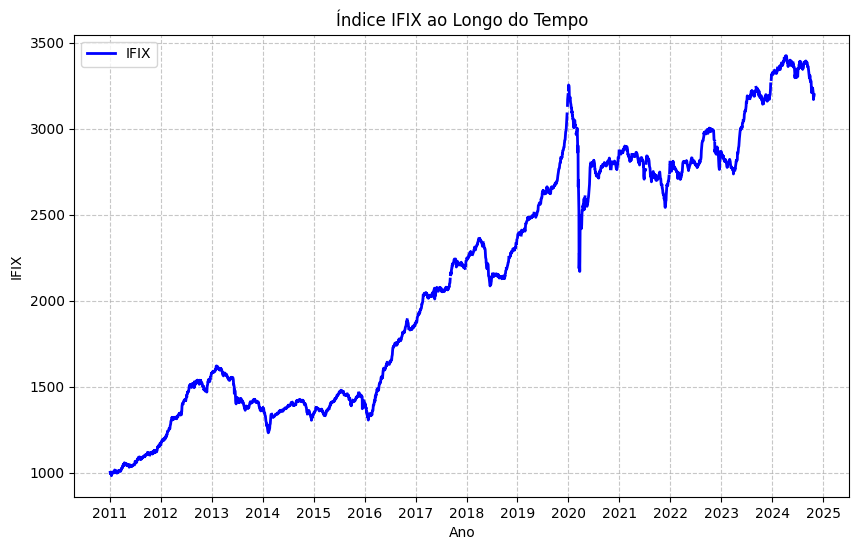

In [17]:
# Ordenar o subset IFIX em ordem cronológica crescente
df_ifix = df_ifix.sort_index()

# Criar o gráfico de linha para o subset IFIX
plt.figure(figsize=(10, 6))
plt.plot(df_ifix.index, df_ifix['IFIX'], label='IFIX', color='b', linewidth=2)

# Ajustar o eixo X para mostrar apenas os anos
plt.gca().xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%Y'))
plt.gca().xaxis.set_major_locator(plt.matplotlib.dates.YearLocator())

# Adicionar título e rótulos
plt.title('Índice IFIX ao Longo do Tempo')
plt.xlabel('Ano')
plt.ylabel('IFIX')
plt.legend()
plt.grid(True, linestyle='--', alpha=0.7)

# Exibir o gráfico
plt.show()

In [18]:
# Calcular o retorno diário do IFIX usando a variação percentual
retorno_ifix = df_ifix['IFIX'].pct_change() * 100  # Multiplicar por 100 para obter o retorno em porcentagem

# Renomear a série para facilitar a interpretação
retorno_ifix.name = 'Retorno_Diario_IFIX'

# Ordenar em ordem decrescente
retorno_ifix = retorno_ifix.sort_index(ascending=False)

# Exibir as primeiras linhas do retorno diário ordenado
print(retorno_ifix)

Data
2024-10-29    0.227285
2024-10-28    0.257099
2024-10-25    0.398229
2024-10-24   -0.320519
2024-10-23   -0.890953
                ...   
2011-01-05    0.613565
2011-01-04   -0.854052
2011-01-03    0.111000
2010-12-31    0.000000
2010-12-30         NaN
Name: Retorno_Diario_IFIX, Length: 3609, dtype: float64


<ipython-input-18-d4d0878b5555>:2: FutureWarning: The default fill_method='pad' in Series.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  retorno_ifix = df_ifix['IFIX'].pct_change() * 100  # Multiplicar por 100 para obter o retorno em porcentagem


## 3.4. Retorno carteira geral

In [19]:
# Passo 1: Calcular os pesos diários com base no valor de mercado, somando para normalização
pesos_diarios = df_valor_mercado_filtrado.div(df_valor_mercado_filtrado.sum(axis=1), axis=0)
print(pesos_diarios)

              KNIP11    KNCR11    XPML11    HGLG11    MXRF11    BTLG11  \
Data                                                                     
2024-10-29  0.043669  0.042844  0.034101  0.031175  0.024885  0.024659   
2024-10-28  0.043561  0.042813  0.034054  0.031124  0.025069  0.024741   
2024-10-25  0.043955  0.043100  0.034094  0.031282  0.024787  0.024590   
2024-10-24  0.043832  0.043103  0.034060  0.031163  0.024364  0.024637   
2024-10-23  0.043871  0.043431  0.034429  0.031413  0.025053  0.024828   
...              ...       ...       ...       ...       ...       ...   
2004-03-17       NaN       NaN       NaN       NaN       NaN       NaN   
2004-01-20       NaN       NaN       NaN       NaN       NaN       NaN   
2004-01-19       NaN       NaN       NaN       NaN       NaN       NaN   
2003-12-22       NaN       NaN       NaN       NaN       NaN       NaN   
2003-10-28       NaN       NaN       NaN       NaN       NaN       NaN   

              KNRI11    VISC11    KNH

In [20]:
# Passo 2: Calcular o retorno ponderado diário de cada ativo
df_retorno_ponderado = df_retorno_filtrado * pesos_diarios
print(df_retorno_ponderado)

              KNIP11    KNCR11    XPML11    HGLG11    MXRF11    BTLG11  \
Data                                                                     
2024-10-29  0.015753  0.007857  0.008565  0.008654 -0.015489 -0.005383   
2024-10-28 -0.029325 -0.018924  0.003622 -0.008815  0.034269  0.020747   
2024-10-25  0.025441  0.012460  0.013571  0.021287  0.050531  0.002580   
2024-10-24  0.011518 -0.017375 -0.024621 -0.013874 -0.058677 -0.010298   
2024-10-23 -0.022461  0.019680 -0.025037 -0.012114 -0.033646 -0.032011   
...              ...       ...       ...       ...       ...       ...   
2004-03-17       NaN       NaN       NaN       NaN       NaN       NaN   
2004-01-20       NaN       NaN       NaN       NaN       NaN       NaN   
2004-01-19       NaN       NaN       NaN       NaN       NaN       NaN   
2003-12-22       NaN       NaN       NaN       NaN       NaN       NaN   
2003-10-28       NaN       NaN       NaN       NaN       NaN       NaN   

              KNRI11    VISC11    KNH

In [21]:
# Passo 3: Calcular o retorno total diário do índice somando as linhas de df_retorno_ponderado
retorno_indice_geral = df_retorno_ponderado.sum(axis=1)
print(retorno_indice_geral)

Data
2024-10-29    0.232292
2024-10-28    0.239642
2024-10-25    0.321386
2024-10-24    0.824195
2024-10-23   -0.796185
                ...   
2004-03-17   -0.198016
2004-01-20   -2.526968
2004-01-19   -6.630786
2003-12-22    0.000000
2003-10-28   -0.162162
Length: 4840, dtype: float64


In [22]:
# Passo 4: Calcular o fator percentual do retorno total diário
fator_percentual_diario = 1 + (retorno_indice_geral / 100)
print(fator_percentual_diario)

Data
2024-10-29    1.002323
2024-10-28    1.002396
2024-10-25    1.003214
2024-10-24    1.008242
2024-10-23    0.992038
                ...   
2004-03-17    0.998020
2004-01-20    0.974730
2004-01-19    0.933692
2003-12-22    1.000000
2003-10-28    0.998378
Length: 4840, dtype: float64


In [23]:
# Passo 5: Construir o índice geral partindo de um valor inicial de 1000 em 30/12/2010

# Definir a data base e o valor inicial do índice
data_base = pd.to_datetime('2010-12-30')
valor_inicial = 1000

# Garantir que o índice de 'retorno_total_diario' está ordenado cronologicamente e em formato datetime
retorno_indice_geral = retorno_indice_geral.sort_index()
retorno_indice_geral.index = pd.to_datetime(retorno_indice_geral.index)

# Calcular o fator percentual diário para acumulação
fator_percentual_diario = 1 + (retorno_indice_geral / 100)

# Verificar se a data base existe no índice
if data_base not in retorno_indice_geral.index:
    print(f"A data base {data_base.strftime('%Y-%m-%d')} não foi encontrada no índice.")
else:
    # Calcular o índice geral a partir da data base

    # Dias posteriores à data base
    posteriores = fator_percentual_diario.loc[data_base:].cumprod() * valor_inicial

    # Dias anteriores à data base
    anteriores = (1 / fator_percentual_diario.loc[:data_base][::-1]).cumprod()[::-1] * valor_inicial

    # Concatenar e ordenar o índice acumulado completo, em ordem cronológica decrescente
    indice_geral = pd.concat([anteriores, posteriores]).sort_index(ascending=False)

    # Definir o nome da série para o índice geral e exibir o resultado
    indice_geral.name = 'Indice geral'
    print("Índice geral calculado em ordem cronológica decrescente:\n", indice_geral)

Índice geral calculado em ordem cronológica decrescente:
 Data
2024-10-29    5589.524843
2024-10-28    5576.570921
2024-10-25    5563.239090
2024-10-24    5545.416885
2024-10-23    5500.085454
                 ...     
2004-03-17     489.824055
2004-01-20     502.522641
2004-01-19     538.210206
2003-12-22     538.210206
2003-10-28     539.084397
Name: Indice geral, Length: 4841, dtype: float64


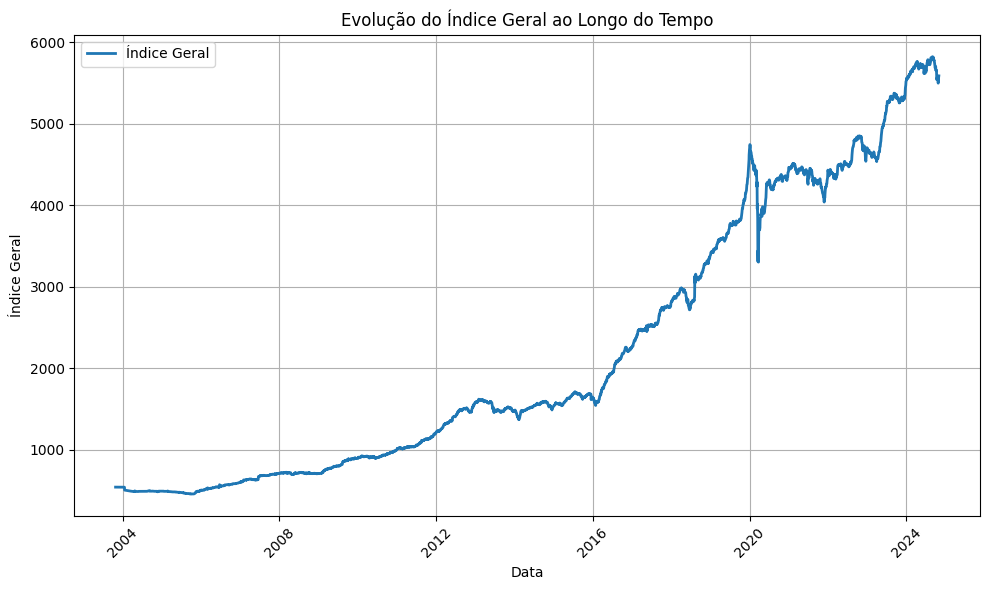

In [24]:
# Remover valores NaN anteriores ao primeiro valor válido
indice_geral = indice_geral[indice_geral.first_valid_index():]

# Plotar o índice geral
plt.figure(figsize=(10, 6))
plt.plot(indice_geral.index, indice_geral, label="Índice Geral", linewidth=2)
plt.xlabel("Data")
plt.ylabel("Índice Geral")
plt.title("Evolução do Índice Geral ao Longo do Tempo")
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()  # Ajusta layout para exibição clara
plt.show()


## 3.5. Retorno carteira por foco de atuação

Além das classificações da ANBIMA com base no tipo de operação (renda, desenvolvimento para venda, etc.), os Fundos de Investimento Imobiliário (FIIs) também são comumente agrupados conforme o tipo de imóvel em que investem, o que pode incluir categorias como:

- Shoppings: FIIs focados em adquirir ou desenvolver shopping centers e centros comerciais, obtendo renda principalmente a partir de aluguéis de lojas e espaços comerciais nesses locais.

- Lajes Corporativas: FIIs que investem em imóveis comerciais destinados a escritórios de médio e alto padrão, geralmente localizados em grandes centros urbanos. A renda provém do aluguel de espaços para empresas.

- Logística e Industrial: FIIs que aplicam em galpões logísticos e industriais, aproveitando a demanda por armazenamento e distribuição. Esses imóveis costumam ser usados por empresas de varejo, e-commerce e indústrias.

- Residenciais: Embora menos comuns, alguns FIIs focam em imóveis residenciais para venda ou locação, incluindo residenciais de alta demanda, como moradias urbanas ou imóveis multifamiliares.

- Hotéis e Hospedagem: FIIs que investem em hotéis e outros imóveis voltados para turismo e negócios, geralmente em regiões com alta movimentação turística ou de negócios.

- Educacional e Saúde: FIIs que possuem imóveis alugados para instituições de ensino (escolas, faculdades) e hospitais ou clínicas, focando em setores com demanda contínua por espaços especializados.

Automatização em desenvolvimento:

In [25]:
#Cálculo do retorno total

def calcular_retorno_total_por_foco(df_cadastro_filtrado, df_valor_mercado, df_retorno):
    # Preparação dos dados para incluir apenas os códigos presentes em df_cadastro_filtrado
    codigos_filtrados = df_cadastro_filtrado['Codigo'].unique()
    df_valor_mercado_filtrado = df_valor_mercado.loc[:, df_valor_mercado.columns.isin(codigos_filtrados)]
    df_retorno_filtrado = df_retorno.loc[:, df_retorno.columns.isin(codigos_filtrados)]

    # Remover linhas com todos valores NaN e alinhar datas
    df_valor_mercado_filtrado = df_valor_mercado_filtrado.dropna(how='all')
    df_retorno_filtrado = df_retorno_filtrado.dropna(how='all')
    datas_comuns = df_retorno_filtrado.index.intersection(df_valor_mercado_filtrado.index)
    df_valor_mercado_filtrado = df_valor_mercado_filtrado.loc[datas_comuns]
    df_retorno_filtrado = df_retorno_filtrado.loc[datas_comuns]

    # Inicializar dicionário para armazenar o retorno total para cada foco
    retornos_totais = {}

    # Iterar sobre cada foco para calcular o retorno total
    for foco in df_cadastro_filtrado['Foco_de_Atuacao'].unique():
        # Filtrar os códigos dos ativos específicos para o foco atual
        ativos_foco = df_cadastro_filtrado[df_cadastro_filtrado['Foco_de_Atuacao'] == foco]['Codigo']
        df_valor_mercado_foco = df_valor_mercado_filtrado[ativos_foco]
        df_retorno_foco = df_retorno_filtrado[ativos_foco]

        # Cálculo dos pesos diários com base no valor de mercado
        pesos_diarios = df_valor_mercado_foco.div(df_valor_mercado_foco.sum(axis=1), axis=0)

        # Cálculo do retorno ponderado diário de cada ativo
        df_retorno_ponderado = df_retorno_foco * pesos_diarios

        # Cálculo do retorno total diário para o foco atual
        retorno_total = df_retorno_ponderado.sum(axis=1).sort_index()
        retorno_total.index = pd.to_datetime(retorno_total.index)

        # Armazenar o retorno total no dicionário
        retornos_totais[foco] = retorno_total

    return retornos_totais

# Retorno total
retornos_totais = calcular_retorno_total_por_foco(df_cadastro_filtrado, df_valor_mercado, df_retorno)

# Exibição dos resultados
for foco, retorno_total in retornos_totais.items():
    print(f"Retorno Total para o foco '{foco}':")
    display(retorno_total.to_frame(name=f"Retorno Total {foco}"))


Retorno Total para o foco 'Residencial':


,Retorno Total Residencial
Data,
2003-10-28,0.000000
2003-12-22,0.000000
2004-01-19,0.000000
2004-01-20,0.000000
2004-03-17,0.000000
...,...
2024-10-23,-0.463418
2024-10-24,-0.000404
2024-10-25,1.129042


Retorno Total para o foco 'Híbrido':


,Retorno Total Híbrido
Data,
2003-10-28,0.000000
2003-12-22,0.000000
2004-01-19,0.000000
2004-01-20,0.000000
2004-03-17,0.000000
...,...
2024-10-23,-0.909573
2024-10-24,-0.011024
2024-10-25,0.401201


Retorno Total para o foco 'TVM':


,Retorno Total TVM
Data,
2003-10-28,0.000000
2003-12-22,0.000000
2004-01-19,0.000000
2004-01-20,0.000000
2004-03-17,0.000000
...,...
2024-10-23,-0.808860
2024-10-24,-0.787612
2024-10-25,0.441669


Retorno Total para o foco 'Multicategoria':


,Retorno Total Multicategoria
Data,
2003-10-28,0.000000
2003-12-22,0.000000
2004-01-19,0.000000
2004-01-20,0.000000
2004-03-17,0.000000
...,...
2024-10-23,-0.648523
2024-10-24,-0.263543
2024-10-25,0.508604


Retorno Total para o foco 'Outros':


,Retorno Total Outros
Data,
2003-10-28,0.000000
2003-12-22,0.000000
2004-01-19,0.000000
2004-01-20,0.000000
2004-03-17,0.000000
...,...
2024-10-23,-0.973947
2024-10-24,-0.029315
2024-10-25,0.323285


Retorno Total para o foco 'Logística':


,Retorno Total Logística
Data,
2003-10-28,-0.162162
2003-12-22,0.000000
2004-01-19,0.000000
2004-01-20,0.000000
2004-03-17,0.000000
...,...
2024-10-23,-0.834960
2024-10-24,-0.261812
2024-10-25,0.087070


Retorno Total para o foco 'Shoppings':


,Retorno Total Shoppings
Data,
2003-10-28,0.000000
2003-12-22,0.000000
2004-01-19,0.000000
2004-01-20,0.000000
2004-03-17,0.000000
...,...
2024-10-23,-0.505787
2024-10-24,8.904317
2024-10-25,0.189721


Retorno Total para o foco 'Lajes Corporativas':


,Retorno Total Lajes Corporativas
Data,
2003-10-28,0.000000
2003-12-22,0.000000
2004-01-19,-15.789474
2004-01-20,-6.250000
2004-03-17,-1.408451
...,...
2024-10-23,-0.655488
2024-10-24,-0.265045
2024-10-25,0.410434


Retorno Total para o foco 'Educacional':


,Retorno Total Educacional
Data,
2003-10-28,0.000000
2003-12-22,0.000000
2004-01-19,0.000000
2004-01-20,0.000000
2004-03-17,0.000000
...,...
2024-10-23,-0.896286
2024-10-24,-0.449314
2024-10-25,-0.932019


Retorno Total para o foco 'Hospital':


,Retorno Total Hospital
Data,
2003-10-28,0.000000
2003-12-22,0.000000
2004-01-19,0.000000
2004-01-20,0.000000
2004-03-17,0.000000
...,...
2024-10-23,0.524501
2024-10-24,-0.458211
2024-10-25,-1.766198


Retorno Total para o foco 'Agências':


,Retorno Total Agências
Data,
2003-10-28,0.000000
2003-12-22,0.000000
2004-01-19,0.000000
2004-01-20,0.000000
2004-03-17,0.000000
...,...
2024-10-23,-0.695260
2024-10-24,-0.737295
2024-10-25,-0.161833


Retorno Total para o foco 'Hotel':


,Retorno Total Hotel
Data,
2003-10-28,0.000000
2003-12-22,0.000000
2004-01-19,0.000000
2004-01-20,0.000000
2004-03-17,0.000000
...,...
2024-10-23,-1.138771
2024-10-24,0.460755
2024-10-25,1.317263


Automatização em desenvolvimento:

In [26]:
# Cálculo do índice

def calcular_indice_por_foco(retornos_totais, data_base_str='2010-12-30', valor_inicial=1000):
    # Conversão da data base para datetime
    data_base = pd.to_datetime(data_base_str)

    # Inicializar dicionário para armazenar o índice para cada foco
    indices_resultados = {}

    # Iterar sobre cada foco para calcular o índice acumulado
    for foco, retorno_total in retornos_totais.items():
        # Identificar a primeira data válida do retorno total
        primeira_data_valida = retorno_total.first_valid_index()

        # Calcular o fator percentual diário
        fator_percentual_diario = 1 + (retorno_total / 100)

        # Construir o índice acumulado partindo do valor inicial
        if primeira_data_valida is not None and data_base <= primeira_data_valida:
            # Índice acumulado a partir da primeira data válida até o final
            posteriores = fator_percentual_diario.loc[primeira_data_valida:].cumprod() * valor_inicial

            # Preencher as datas entre `data_base` e `primeira_data_valida` com NaN
            anteriores = pd.Series([np.nan] * ((posteriores.index >= data_base).sum()),
                                   index=pd.date_range(start=data_base, end=primeira_data_valida, freq='D')[:-1])

            # Concatenar e armazenar o índice para o foco atual
            indice = pd.concat([anteriores, posteriores]).sort_index()
        else:
            # Apenas calcular o índice diretamente se a data base está na primeira data válida
            indice = fator_percentual_diario.loc[data_base:].cumprod() * valor_inicial if data_base in retorno_total.index else pd.Series(dtype="float64")

        indices_resultados[foco] = indice

    return indices_resultados

# Exemplo de uso:
# Calcule os índices para cada foco
indices_resultados = calcular_indice_por_foco(retornos_totais, data_base_str='2010-12-30', valor_inicial=1000)

# Combinar todos os índices em um único DataFrame para exibição
df_indices_concatenados = pd.DataFrame(indices_resultados)

# Ordenar o DataFrame em ordem cronológica decrescente
df_indices_concatenados = df_indices_concatenados.sort_index(ascending=False)

# Exibir o DataFrame resultante
display(df_indices_concatenados)


,Residencial,Híbrido,TVM,Multicategoria,Outros,Logística,Shoppings,Lajes Corporativas,Educacional,Hospital,Agências,Hotel
Data,,,,,,,,,,,,
2024-10-29,4706.549063,4718.814798,4836.696445,2057.409599,6790.013230,6123.873557,6233.461653,3287.304751,7429.840454,9924.380778,3493.528009,5072.221110
2024-10-28,4679.887046,4713.832992,4833.148888,2058.692650,6768.556800,6095.523633,6225.747687,3279.253782,7417.817731,9413.166538,3470.728280,5098.648661
2024-10-25,4713.431943,4681.067823,4839.612400,2053.552427,6746.482796,6079.823664,6206.177474,3273.249220,7430.503891,9378.133367,3488.263780,5071.420276
2024-10-24,4660.809466,4662.362380,4818.331343,2043.160820,6724.742694,6074.534582,6194.425362,3259.869602,7500.409159,9546.747797,3493.918108,5005.484871
2024-10-23,4660.828273,4662.876430,4856.582367,2048.559653,6726.714654,6090.480204,5687.952091,3268.532697,7534.261642,9590.693398,3519.869922,4982.527605
...,...,...,...,...,...,...,...,...,...,...,...,...
2011-01-06,1000.000000,1001.307147,1010.990514,1000.000000,1006.430683,993.053257,1012.000957,1015.382422,984.538462,1013.957692,1000.000000,1008.468721
2011-01-05,1000.000000,1006.059364,1003.331442,1000.000000,1013.203915,997.373299,1014.094446,1014.716605,984.538462,1010.035186,1000.000000,1009.848804
2011-01-04,1000.000000,1002.337048,996.195838,1000.000000,1024.654310,997.373299,1007.826066,1010.557253,1000.000000,1013.949126,1000.000000,1008.521801


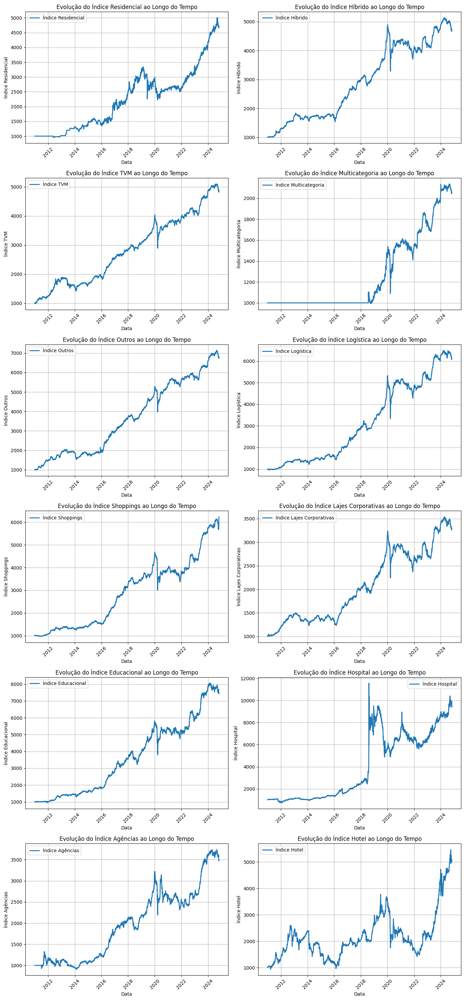

In [27]:
#Gráfico dos índices

def plotar_indices_em_duas_colunas(indices_resultados):
    # Configurações iniciais
    num_indices = len(indices_resultados)
    num_colunas = 2
    num_linhas = (num_indices + 1) // num_colunas  # Cálculo para organizar as linhas

    # Ajustar o tamanho da figura
    plt.figure(figsize=(14, num_linhas * 5))

    # Iterar sobre cada índice e seu respectivo foco
    for i, (foco, indice) in enumerate(indices_resultados.items(), start=1):
        # Remover valores NaN anteriores ao primeiro valor válido
        indice = indice[indice.first_valid_index():]

        # Configurar subplot
        plt.subplot(num_linhas, num_colunas, i)
        plt.plot(indice.index, indice, label=f"Índice {foco}", linewidth=2)
        plt.xlabel("Data")
        plt.ylabel(f"Índice {foco}")
        plt.title(f"Evolução do Índice {foco} ao Longo do Tempo")
        plt.legend()
        plt.grid(True)
        plt.xticks(rotation=45)

    # Ajustar layout para exibição clara
    plt.tight_layout()
    plt.show()

# Exemplo de uso:
plotar_indices_em_duas_colunas(indices_resultados)  # indices_resultados é o dicionário com os índices para cada foco

# Esta função exibirá os gráficos em duas colunas. Cada gráfico é colocado em uma grade para facilitar a visualização.



### Residencial

Residenciais: FIIs que investem em imóveis residenciais, como apartamentos, casas e condomínios. Esses fundos podem ter como estratégia o aluguel de unidades para pessoas físicas, permitindo diversificação de receita e menor exposição ao risco de vacância comparado a imóveis comerciais. Investimentos residenciais geralmente são direcionados a regiões urbanas de alta demanda por moradia, e, em alguns casos, focam em unidades de médio e alto padrão, ou mesmo em projetos de moradia acessível, atendendo diferentes perfis de locatários. Esta categoria é interessante para investidores que buscam exposição ao mercado de habitação e uma possível fonte de renda estável e defensiva, já que a demanda por residências tende a se manter, independentemente de oscilações econômicas mais amplas.

In [28]:
# Filtro residencial

# Filtrando o cadastro para incluir apenas ativos com foco de atuação "Residencial"
df_cadastro_residencial = df_cadastro_filtrado.loc[
    df_cadastro_filtrado['Foco_de_Atuacao'] == 'Residencial', ['Codigo']
]

# Extraindo os códigos dos ativos residenciais
codigos_residenciais = df_cadastro_residencial['Codigo'].unique()

# Filtrando df_retorno para incluir apenas os códigos residenciais
df_retorno_residencial = df_retorno_filtrado.loc[:, df_retorno_filtrado.columns.isin(codigos_residenciais)]

# Filtrando df_valor_mercado para incluir apenas os códigos residenciais
df_valor_mercado_residencial = df_valor_mercado_filtrado.loc[:, df_valor_mercado_filtrado.columns.isin(codigos_residenciais)]

# Excluir linhas onde todas as colunas são NaN em ambos os DataFrames
df_retorno_residencial = df_retorno_residencial.dropna(how='all')
df_valor_mercado_residencial = df_valor_mercado_residencial.dropna(how='all')

# Encontrar as datas (índices) comuns entre os dois DataFrames
datas_comuns = df_retorno_residencial.index.intersection(df_valor_mercado_residencial.index)

# Filtrar ambos os DataFrames para conter apenas as datas comuns
df_retorno_residencial = df_retorno_residencial.loc[datas_comuns]
df_valor_mercado_residencial = df_valor_mercado_residencial.loc[datas_comuns]

# Exibir os DataFrames para verificação
print("df_retorno_residencial com datas comuns:\n", df_retorno_residencial)
print("df_valor_mercado_residencial com datas comuns:\n", df_valor_mercado_residencial)


df_retorno_residencial com datas comuns:
              KEVE11  RSPD11    BRIM11    VCRR11  SPDE11    JFLL11    INRD11  \
Data                                                                          
2024-10-29      NaN     NaN  4.745370 -2.033546     NaN  0.286533  0.141703   
2024-10-28      NaN     NaN -5.263158 -0.266469     NaN -0.399543 -0.647614   
2024-10-25      NaN     NaN  3.730664  5.844563     NaN  0.602929 -0.028149   
2024-10-24  0.00000     NaN -0.090909 -0.015667     NaN -0.499929  0.056330   
2024-10-23  0.46729     NaN  0.000000 -2.698171     NaN  0.502440 -0.671423   
...             ...     ...       ...       ...     ...       ...       ...   
2011-11-10      NaN     NaN       NaN       NaN     NaN       NaN       NaN   
2011-11-09      NaN     NaN       NaN       NaN     NaN       NaN       NaN   
2011-10-06      NaN     NaN       NaN       NaN     NaN       NaN       NaN   
2011-10-05      NaN     NaN       NaN       NaN     NaN       NaN       NaN   
2010-12-08

In [29]:
# Passo 1: Calcular os pesos diários com base no valor de mercado, somando para normalização
pesos_diarios_residencial = df_valor_mercado_residencial.div(df_valor_mercado_residencial.sum(axis=1), axis=0)

# Passo 2: Calcular o retorno ponderado diário de cada ativo
df_retorno_ponderado_residencial = df_retorno_residencial * pesos_diarios_residencial

# Passo 3: Calcular o retorno total diário do índice somando as linhas de df_retorno_ponderado_residencial
retorno_residencial = df_retorno_ponderado_residencial.sum(axis=1)

# Garantir que o índice de 'retorno_residencial' está ordenado cronologicamente e em formato datetime
retorno_residencial = retorno_residencial.sort_index()
retorno_residencial.index = pd.to_datetime(retorno_residencial.index)

# Passo 4: Calcular o fator percentual do retorno total diário
fator_percentual_diario_residencial = 1 + (retorno_residencial / 100)
# print(fator_percentual_diario_residencial)

# Passo 5: Construir o índice residencial partindo de um valor inicial de 1000 em 30/12/2010

# Definir a data base e o valor inicial do índice
data_base = pd.to_datetime('2010-12-30')
valor_inicial = 1000

# Verificar se a data base existe no índice, caso contrário, inserir a data base manualmente com retorno zero
if data_base not in retorno_residencial.index:
    retorno_residencial.loc[data_base] = 0  # Adicionar a data base com retorno zero
    retorno_residencial = retorno_residencial.sort_index()  # Reordenar o índice

# Calcular o fator percentual do retorno total diário
fator_percentual_diario_residencial = 1 + (retorno_residencial / 100)

# Verificar novamente após a inserção da data base
if data_base in retorno_residencial.index:
    # Calcular o índice residencial para dias posteriores (a partir da data base)
    posteriores = fator_percentual_diario_residencial.loc[data_base:].cumprod() * valor_inicial

    # Calcular o índice residencial para dias anteriores (antes da data base)
    anteriores = (1 / fator_percentual_diario_residencial.loc[:data_base][::-1]).cumprod()[::-1] * valor_inicial

    # Concatenar e ordenar para obter o índice acumulado completo, em ordem cronológica decrescente
    indice_residencial = pd.concat([anteriores, posteriores]).sort_index(ascending=False)

    # Definir o nome da coluna para o índice residencial
    indice_residencial.name = 'indice_residencial'

    # Exibir o índice residencial em ordem cronológica decrescente
    print("Índice residencial:\n", indice_residencial)
else:
    print("A data base ainda não foi encontrada no índice após a tentativa de inserção.")


Índice residencial:
 Data
2024-10-29    4706.549063
2024-10-28    4679.887046
2024-10-25    4713.431943
2024-10-24    4660.809466
2024-10-23    4660.828273
                 ...     
2011-10-06    1000.000000
2011-10-05    1000.000000
2010-12-30    1000.000000
2010-12-30    1000.000000
2010-12-08     999.970001
Name: indice_residencial, Length: 2287, dtype: float64


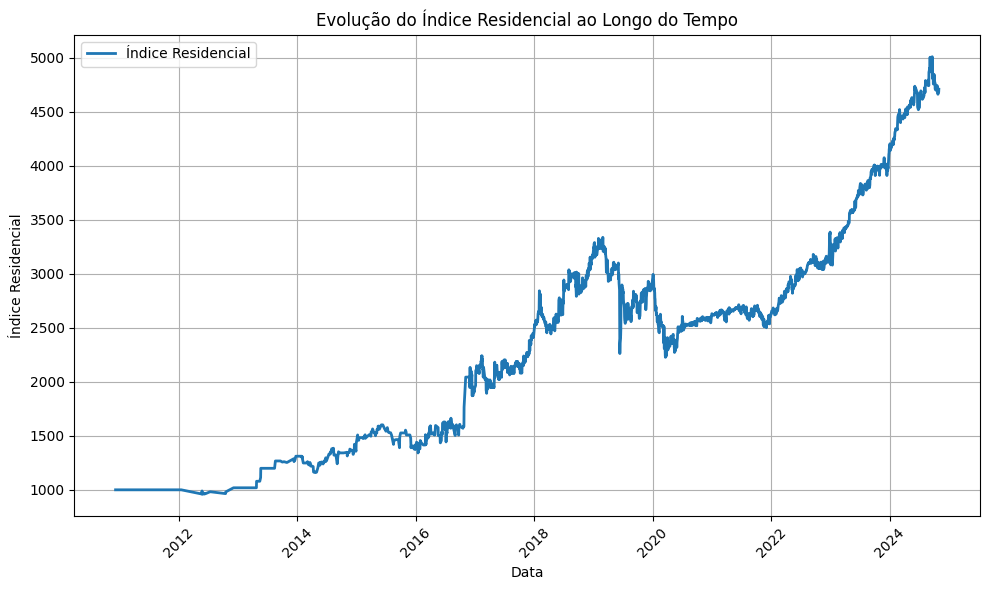

In [30]:
# Remover valores NaN anteriores ao primeiro valor válido
indice_residencial = indice_residencial[indice_residencial.first_valid_index():]

# Plotar o índice residencial
plt.figure(figsize=(10, 6))
plt.plot(indice_residencial.index, indice_residencial, label="Índice Residencial", linewidth=2)
plt.xlabel("Data")
plt.ylabel("Índice Residencial")
plt.title("Evolução do Índice Residencial ao Longo do Tempo")
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()  # Ajusta layout para exibição clara
plt.show()


### Híbrido

Híbridos: FIIs que possuem carteiras mistas, investindo em diferentes tipos de ativos imobiliários, como imóveis comerciais, residenciais e títulos de dívida imobiliária. A categoria híbrida proporciona flexibilidade ao gestor, que pode diversificar conforme as oportunidades, mitigando riscos e adaptando a carteira às mudanças no mercado imobiliário.

In [31]:
# Cálculo do retorno Híbrido

# Filtrando o cadastro para incluir apenas ativos com foco de atuação "Híbrido"
df_cadastro_hibrido = df_cadastro_filtrado.loc[
    df_cadastro_filtrado['Foco_de_Atuacao'] == 'Híbrido', ['Codigo']
]

# Extraindo os códigos dos ativos híbridos
codigos_hibridos = df_cadastro_hibrido['Codigo'].unique()

# Filtrando df_retorno para incluir apenas os códigos híbridos
df_retorno_hibrido = df_retorno_filtrado.loc[:, df_retorno_filtrado.columns.isin(codigos_hibridos)]

# Filtrando df_valor_mercado para incluir apenas os códigos híbridos
df_valor_mercado_hibrido = df_valor_mercado_filtrado.loc[:, df_valor_mercado_filtrado.columns.isin(codigos_hibridos)]

# Excluir linhas onde todas as colunas são NaN em ambos os DataFrames
df_retorno_hibrido = df_retorno_hibrido.dropna(how='all')
df_valor_mercado_hibrido = df_valor_mercado_hibrido.dropna(how='all')

# Encontrar as datas (índices) comuns entre os dois DataFrames
datas_comuns = df_retorno_hibrido.index.intersection(df_valor_mercado_hibrido.index)

# Filtrar ambos os DataFrames para conter apenas as datas comuns
df_retorno_hibrido = df_retorno_hibrido.loc[datas_comuns]
df_valor_mercado_hibrido = df_valor_mercado_hibrido.loc[datas_comuns]

# Exibir os DataFrames para verificação
print("df_retorno_hibrido com datas comuns:\n", df_retorno_hibrido)
print("df_valor_mercado_hibrido com datas comuns:\n", df_valor_mercado_hibrido)


df_retorno_hibrido com datas comuns:
               BTLG11    VISC11    TGAR11    TVRI11    JSRE11    ALZR11  \
Data                                                                     
2024-10-29 -0.218295  1.248780  0.430603 -1.761658  1.866883 -1.024490   
2024-10-28  0.838574  0.490196  0.695775  1.578947  1.818182  1.727047   
2024-10-25  0.104932  1.644245  1.349004 -0.596421 -0.591522  0.599101   
2024-10-24 -0.417973  0.189696 -1.321097  2.741346  0.197563 -0.920063   
2024-10-23 -1.289324 -0.802218 -1.136590 -2.412925 -1.091028 -1.173250   
...              ...       ...       ...       ...       ...       ...   
2007-06-15       NaN       NaN       NaN       NaN       NaN       NaN   
2007-06-14       NaN       NaN       NaN       NaN       NaN       NaN   
2007-06-13       NaN       NaN       NaN       NaN       NaN       NaN   
2006-08-10       NaN       NaN       NaN       NaN       NaN       NaN   
2005-04-25       NaN       NaN       NaN       NaN       NaN       NaN   


In [32]:
# Cálculo do Índice

# Passo 1: Calcular os pesos diários com base no valor de mercado, somando para normalização
pesos_diarios_hibrido = df_valor_mercado_hibrido.div(df_valor_mercado_hibrido.sum(axis=1), axis=0)

# Passo 2: Calcular o retorno ponderado diário de cada ativo
df_retorno_ponderado_hibrido = df_retorno_hibrido * pesos_diarios_hibrido

# Passo 3: Calcular o retorno total diário do índice somando as linhas de df_retorno_ponderado_hibrido
retorno_hibrido = df_retorno_ponderado_hibrido.sum(axis=1)

# Garantir que o índice de 'retorno_hibrido' está ordenado cronologicamente e em formato datetime
retorno_hibrido = retorno_hibrido.sort_index()
retorno_hibrido.index = pd.to_datetime(retorno_hibrido.index)

# Passo 4: Calcular o fator percentual do retorno total diário
fator_percentual_diario_hibrido = 1 + (retorno_hibrido / 100)
# print(fator_percentual_diario_hibrido)

# Passo 5: Construir o índice híbrido partindo de um valor inicial de 1000 em 30/12/2010

# Definir a data base e o valor inicial do índice
data_base = pd.to_datetime('2010-12-30')
valor_inicial = 1000

# Verificar se a data base existe no índice, caso contrário, inserir a data base manualmente com retorno zero
if data_base not in retorno_hibrido.index:
    retorno_hibrido.loc[data_base] = 0  # Adicionar a data base com retorno zero
    retorno_hibrido = retorno_hibrido.sort_index()  # Reordenar o índice

# Calcular o fator percentual do retorno total diário
fator_percentual_diario_hibrido = 1 + (retorno_hibrido / 100)

# Verificar novamente após a inserção da data base
if data_base in retorno_hibrido.index:
    # Calcular o índice híbrido para dias posteriores (a partir da data base)
    posteriores = fator_percentual_diario_hibrido.loc[data_base:].cumprod() * valor_inicial

    # Calcular o índice híbrido para dias anteriores (antes da data base)
    anteriores = (1 / fator_percentual_diario_hibrido.loc[:data_base][::-1]).cumprod()[::-1] * valor_inicial

    # Concatenar e ordenar para obter o índice acumulado completo, em ordem cronológica decrescente
    indice_hibrido = pd.concat([anteriores, posteriores]).sort_index(ascending=False)

    # Definir o nome da coluna para o índice híbrido
    indice_hibrido.name = 'indice_hibrido'

    # Exibir o índice híbrido em ordem cronológica decrescente
    print("Índice híbrido:\n", indice_hibrido)
else:
    print("A data base ainda não foi encontrada no índice após a tentativa de inserção.")


Índice híbrido:
 Data
2024-10-29    4718.814798
2024-10-28    4713.832992
2024-10-25    4681.067823
2024-10-24    4662.362380
2024-10-23    4662.876430
                 ...     
2007-06-15     622.362680
2007-06-14     622.393801
2007-06-13     622.362680
2006-08-10     544.567345
2005-04-25     544.567345
Name: indice_hibrido, Length: 3568, dtype: float64


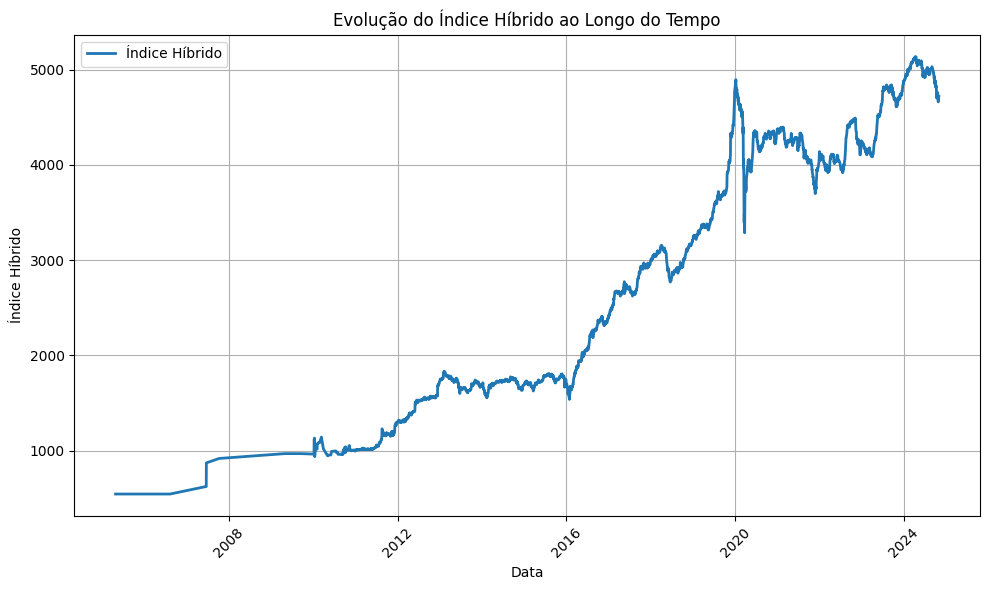

In [33]:
# Remover valores NaN anteriores ao primeiro valor válido
indice_hibrido = indice_hibrido[indice_hibrido.first_valid_index():]

# Plotar o índice híbrido
plt.figure(figsize=(10, 6))
plt.plot(indice_hibrido.index, indice_hibrido, label="Índice Híbrido", linewidth=2)
plt.xlabel("Data")
plt.ylabel("Índice Híbrido")
plt.title("Evolução do Índice Híbrido ao Longo do Tempo")
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()  # Ajusta layout para exibição clara
plt.show()

### Multicategoria

Multicategoria: Esse termo pode ser entendido como um tipo de FII híbrido que não só mescla imóveis e títulos financeiros, mas também diversifica em várias subcategorias de imóveis físicos (como lajes corporativas, shoppings, hospitais, entre outros), ampliando ainda mais a diversificação interna. Multicategoria geralmente sugere um portfólio muito diversificado, com exposição a vários setores e tipos de imóveis, enquanto híbrido pode indicar uma combinação de classes de ativos sem especificar a quantidade de categorias envolvidas.

Híbrido: Refere-se a FIIs que combinam diferentes tipos de ativos imobiliários em seu portfólio, como imóveis físicos (escritórios, galpões, residenciais) e ativos financeiros (CRIs, LCIs). A estratégia híbrida é mais flexível e permite ao gestor ajustar a alocação entre ativos físicos e de papel, buscando tanto rentabilidade quanto estabilidade conforme as condições de mercado.

In [34]:
# Definir as categorias de foco de atuação que você deseja incluir
focos_desejados = ['Multicategoria']  # Exemplo de focos

# Filtrando o cadastro para incluir apenas ativos com os focos de atuação desejados
df_cadastro_multicategoria = df_cadastro_filtrado.loc[
    df_cadastro_filtrado['Foco_de_Atuacao'].isin(focos_desejados), ['Codigo']
]

# Extraindo os códigos dos ativos para os focos desejados
codigos_multicategoria = df_cadastro_multicategoria['Codigo'].unique()

# Filtrando df_retorno para incluir apenas os códigos dos focos desejados
df_retorno_multicategoria = df_retorno_filtrado.loc[:, df_retorno_filtrado.columns.isin(codigos_multicategoria)]

# Filtrando df_valor_mercado para incluir apenas os códigos dos focos desejados
df_valor_mercado_multicategoria = df_valor_mercado_filtrado.loc[:, df_valor_mercado_filtrado.columns.isin(codigos_multicategoria)]

# Excluir linhas onde todas as colunas são NaN em ambos os DataFrames
df_retorno_multicategoria = df_retorno_multicategoria.dropna(how='all')
df_valor_mercado_multicategoria = df_valor_mercado_multicategoria.dropna(how='all')

# Encontrar as datas (índices) comuns entre os dois DataFrames
datas_comuns = df_retorno_multicategoria.index.intersection(df_valor_mercado_multicategoria.index)

# Filtrar ambos os DataFrames para conter apenas as datas comuns
df_retorno_multicategoria = df_retorno_multicategoria.loc[datas_comuns]
df_valor_mercado_multicategoria = df_valor_mercado_multicategoria.loc[datas_comuns]

# Exibir os DataFrames para verificação
print("df_retorno_multicategoria com datas comuns:\n", df_retorno_multicategoria)
print("df_valor_mercado_multicategoria com datas comuns:\n", df_valor_mercado_multicategoria)


df_retorno_multicategoria com datas comuns:
                HGRU11    TRXF11    KNHF11    RZTR11    GARE11    CCME11  \
Data                                                                      
2024-10-29   0.344545 -0.199302 -0.857748  0.651997  0.334821  1.098901   
2024-10-28  -0.343362  0.299850  2.011364  0.198320  0.900901  0.220264   
2024-10-25   0.957412 -0.099850  0.399315  1.084906  0.225734 -0.110011   
2024-10-24   0.966667 -0.841584 -0.893261 -0.329102 -0.225225 -0.328947   
2024-10-23  -0.174694 -0.834561 -0.191852 -1.482168 -1.003344 -0.109529   
...               ...       ...       ...       ...       ...       ...   
2018-08-06   0.000000       NaN       NaN       NaN       NaN       NaN   
2018-08-03   0.000000       NaN       NaN       NaN       NaN       NaN   
2018-07-31   1.807802       NaN       NaN       NaN       NaN       NaN   
2018-07-30  -4.454545       NaN       NaN       NaN       NaN       NaN   
2018-07-27  10.000000       NaN       NaN       NaN    

In [35]:
# Índice Multicategoria

# Parâmetros iniciais
data_base_str = '2010-12-30'
valor_inicial = 1000
data_base = pd.to_datetime(data_base_str)

# Filtrar o cadastro para incluir apenas ativos com foco "Multicategoria"
df_cadastro_multicategoria = df_cadastro_filtrado.loc[df_cadastro_filtrado['Foco_de_Atuacao'] == 'Multicategoria', 'Codigo']
codigos_multicategoria = df_cadastro_multicategoria.unique()

# Filtrar df_valor_mercado e df_retorno para incluir apenas os ativos "Multicategoria"
df_valor_mercado_multicategoria = df_valor_mercado.loc[:, df_valor_mercado.columns.isin(codigos_multicategoria)]
df_retorno_multicategoria = df_retorno.loc[:, df_retorno.columns.isin(codigos_multicategoria)]

# Remover linhas onde todas as colunas são NaN em ambos os DataFrames
df_valor_mercado_multicategoria = df_valor_mercado_multicategoria.dropna(how='all')
df_retorno_multicategoria = df_retorno_multicategoria.dropna(how='all')

# Encontrar as datas comuns entre os dois DataFrames
datas_comuns = df_valor_mercado_multicategoria.index.intersection(df_retorno_multicategoria.index)
df_valor_mercado_multicategoria = df_valor_mercado_multicategoria.loc[datas_comuns]
df_retorno_multicategoria = df_retorno_multicategoria.loc[datas_comuns]

# Passo 1: Calcular os pesos diários com base no valor de mercado
pesos_diarios_multicategoria = df_valor_mercado_multicategoria.div(df_valor_mercado_multicategoria.sum(axis=1), axis=0)

# Passo 2: Calcular o retorno ponderado diário de cada ativo
df_retorno_ponderado_multicategoria = df_retorno_multicategoria * pesos_diarios_multicategoria

# Passo 3: Calcular o retorno total diário do índice somando as linhas de df_retorno_ponderado_multicategoria
retorno_multicategoria = df_retorno_ponderado_multicategoria.sum(axis=1).sort_index()
retorno_multicategoria.index = pd.to_datetime(retorno_multicategoria.index)

# Passo 4: Calcular o fator percentual do retorno total diário
fator_percentual_diario_multicategoria = 1 + (retorno_multicategoria / 100)

# Passo 5: Construir o índice acumulado, partindo da data base com valor inicial
if data_base not in retorno_multicategoria.index:
    # Inserir a data base manualmente com retorno zero, se necessário
    retorno_multicategoria.loc[data_base] = 0
    retorno_multicategoria = retorno_multicategoria.sort_index()

# Atualizar o fator percentual diário após a possível inserção da data base
fator_percentual_diario_multicategoria = 1 + (retorno_multicategoria / 100)

# Construir o índice acumulado para datas a partir e antes da data base
if data_base in retorno_multicategoria.index:
    # Índice para datas a partir da data base
    posteriores = fator_percentual_diario_multicategoria.loc[data_base:].cumprod() * valor_inicial

    # Índice para datas anteriores à data base
    anteriores = (1 / fator_percentual_diario_multicategoria.loc[:data_base][::-1]).cumprod()[::-1] * valor_inicial

    # Concatenar e ordenar o índice acumulado completo em ordem cronológica decrescente
    indice_multicategoria = pd.concat([anteriores, posteriores]).sort_index(ascending=False)
    indice_multicategoria.name = 'indice_multicategoria'

    # Exibir o índice acumulado para "Multicategoria"
    print("Índice Multicategoria:\n", indice_multicategoria)
else:
    print("A data base ainda não foi encontrada no índice após a tentativa de inserção.")


Índice Multicategoria:
 Data
2024-10-29    2057.409599
2024-10-28    2058.692650
2024-10-25    2053.552427
2024-10-24    2043.160820
2024-10-23    2048.559653
                 ...     
2018-07-31    1070.000000
2018-07-30    1051.000000
2018-07-27    1100.000000
2010-12-30    1000.000000
2010-12-30    1000.000000
Name: indice_multicategoria, Length: 1543, dtype: float64


In [36]:
# Passo 1: Calcular os pesos diários com base no valor de mercado, normalizando
pesos_diarios_hibrido = df_valor_mercado_hibrido.div(df_valor_mercado_hibrido.sum(axis=1), axis=0)

# Passo 2: Calcular o retorno ponderado diário de cada ativo
df_retorno_ponderado_hibrido = df_retorno_hibrido * pesos_diarios_hibrido

# Passo 3: Calcular o retorno total diário do índice somando os retornos ponderados
retorno_hibrido = df_retorno_ponderado_hibrido.sum(axis=1)

# Ordenar e garantir que o índice de 'retorno_hibrido' esteja em formato datetime
retorno_hibrido = retorno_hibrido.sort_index()
retorno_hibrido.index = pd.to_datetime(retorno_hibrido.index)

# Passo 4: Calcular o fator percentual do retorno total diário
fator_percentual_diario_hibrido = 1 + (retorno_hibrido / 100)

# Parâmetros para a construção do índice
data_base = pd.to_datetime('2010-12-30')
valor_inicial = 1000

# Passo 5: Verificar a presença da data base e ajustar o índice, se necessário
if data_base not in retorno_hibrido.index:
    retorno_hibrido.loc[data_base] = 0  # Adicionar data base com retorno zero
    retorno_hibrido = retorno_hibrido.sort_index()  # Reordenar após inserção

# Atualizar o fator percentual diário após a possível inserção da data base
fator_percentual_diario_hibrido = 1 + (retorno_hibrido / 100)

# Construir o índice acumulado a partir da data base
if data_base in retorno_hibrido.index:
    # Índice para datas a partir da data base
    posteriores = fator_percentual_diario_hibrido.loc[data_base:].cumprod() * valor_inicial

    # Índice para datas anteriores à data base
    anteriores = (1 / fator_percentual_diario_hibrido.loc[:data_base][::-1]).cumprod()[::-1] * valor_inicial

    # Concatenar e ordenar o índice acumulado completo em ordem cronológica decrescente
    indice_hibrido = pd.concat([anteriores, posteriores]).sort_index(ascending=False)
    indice_hibrido.name = 'indice_hibrido'

    # Exibir o índice acumulado para verificação
    print("Índice híbrido:\n", indice_hibrido)
else:
    print("A data base ainda não foi encontrada no índice após a tentativa de inserção.")


Índice híbrido:
 Data
2024-10-29    4718.814798
2024-10-28    4713.832992
2024-10-25    4681.067823
2024-10-24    4662.362380
2024-10-23    4662.876430
                 ...     
2007-06-15     622.362680
2007-06-14     622.393801
2007-06-13     622.362680
2006-08-10     544.567345
2005-04-25     544.567345
Name: indice_hibrido, Length: 3568, dtype: float64


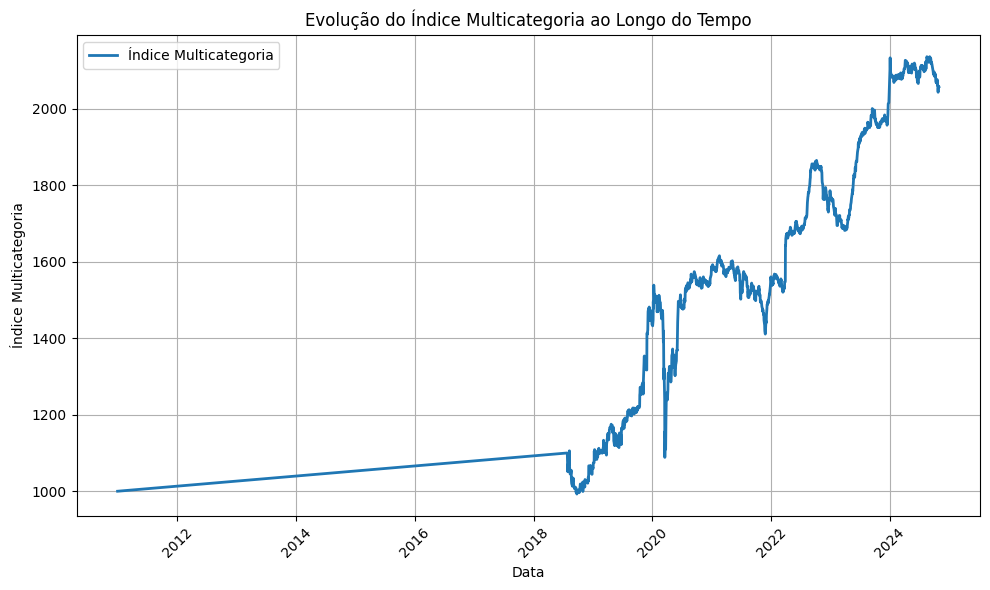

In [37]:
# Remover valores NaN anteriores ao primeiro valor válido
indice_multicategoria = indice_multicategoria[indice_multicategoria.first_valid_index():]

# Plotar o índice Multicategoria
plt.figure(figsize=(10, 6))
plt.plot(indice_multicategoria.index, indice_multicategoria, label="Índice Multicategoria", linewidth=2)
plt.xlabel("Data")
plt.ylabel("Índice Multicategoria")
plt.title("Evolução do Índice Multicategoria ao Longo do Tempo")
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()  # Ajusta layout para exibição clara
plt.show()


### TVM
Títulos e Valores Mobiliários (TVM): conhecidos como "Fundos de Papel", investem em ativos financeiros lastreados no setor imobiliário, como CRIs, LCIs, Letras Hipotecárias e Debêntures Imobiliárias, em vez de imóveis físicos. Eles geram rendimentos recorrentes para os cotistas através dos juros e amortizações desses títulos, oferecendo uma distribuição mensal de dividendos com um perfil de risco moderado. Esses fundos são atraentes para investidores que desejam exposição ao setor imobiliário com menor volatilidade, proporcionando uma fonte de renda estável e diversificada sem a necessidade de alocar recursos diretamente em propriedades.

In [38]:
# Filtro TVM

# Filtrando o cadastro para incluir apenas ativos com foco de atuação "TVM"
df_cadastro_tvm = df_cadastro_filtrado.loc[
    df_cadastro_filtrado['Foco_de_Atuacao'] == 'TVM', ['Codigo']
]

# Extraindo os códigos dos ativos TVM
codigos_tvm = df_cadastro_tvm['Codigo'].unique()

# Filtrando df_retorno para incluir apenas os códigos TVM
df_retorno_tvm = df_retorno_filtrado.loc[:, df_retorno_filtrado.columns.isin(codigos_tvm)]

# Filtrando df_valor_mercado para incluir apenas os códigos TVM
df_valor_mercado_tvm = df_valor_mercado_filtrado.loc[:, df_valor_mercado_filtrado.columns.isin(codigos_tvm)]

# Excluir linhas onde todas as colunas são NaN em ambos os DataFrames
df_retorno_tvm = df_retorno_tvm.dropna(how='all')
df_valor_mercado_tvm = df_valor_mercado_tvm.dropna(how='all')

# Encontrar as datas (índices) comuns entre os dois DataFrames
datas_comuns = df_retorno_tvm.index.intersection(df_valor_mercado_tvm.index)

# Filtrar ambos os DataFrames para conter apenas as datas comuns
df_retorno_tvm = df_retorno_tvm.loc[datas_comuns]
df_valor_mercado_tvm = df_valor_mercado_tvm.loc[datas_comuns]

# Exibir os DataFrames para verificação
print("df_retorno_tvm com datas comuns:\n", df_retorno_tvm)
print("df_valor_mercado_tvm com datas comuns:\n", df_valor_mercado_tvm)


df_retorno_tvm com datas comuns:
               KNCR11    MXRF11    KNRI11    KNHY11    CPTS11    RECR11  \
Data                                                                     
2024-10-29  0.183380 -0.622407  0.493827  0.554853 -0.138122  0.220779   
2024-10-28 -0.442010  1.366982 -0.217391  0.381083 -3.851262  0.260417   
2024-10-25  0.289101  2.038627  0.700525  0.225247  0.803213 -0.698216   
2024-10-24 -0.403110 -2.408377 -0.116618 -0.671206 -1.710526 -0.655106   
2024-10-23  0.453143 -1.342975 -0.550884 -1.058710 -3.184713 -1.330798   
...              ...       ...       ...       ...       ...       ...   
2010-07-26       NaN       NaN       NaN       NaN       NaN       NaN   
2010-07-21       NaN       NaN       NaN       NaN       NaN       NaN   
2010-07-16       NaN       NaN       NaN       NaN       NaN       NaN   
2010-07-15       NaN       NaN       NaN       NaN       NaN       NaN   
2010-05-05       NaN       NaN       NaN       NaN       NaN       NaN   

   

In [39]:
# Passo 1: Calcular os pesos diários com base no valor de mercado, somando para normalização
pesos_diarios_tvm = df_valor_mercado_tvm.div(df_valor_mercado_tvm.sum(axis=1), axis=0)

# Passo 2: Calcular o retorno ponderado diário de cada ativo
df_retorno_ponderado_tvm = df_retorno_tvm * pesos_diarios_tvm

# Passo 3: Calcular o retorno total diário do índice somando as linhas de df_retorno_ponderado_tvm
retorno_tvm = df_retorno_ponderado_tvm.sum(axis=1)

# Garantir que o índice de 'retorno_tvm' está ordenado cronologicamente e em formato datetime
retorno_tvm = retorno_tvm.sort_index()
retorno_tvm.index = pd.to_datetime(retorno_tvm.index)

# Passo 4: Calcular o fator percentual do retorno total diário
fator_percentual_diario_tvm = 1 + (retorno_tvm / 100)
# print(fator_percentual_diario_tvm)

# Passo 5: Construir o índice TVM partindo de um valor inicial de 1000 em 30/12/2010

# Definir a data base e o valor inicial do índice
data_base = pd.to_datetime('2010-12-30')
valor_inicial = 1000

# Verificar se a data base existe no índice, caso contrário, inserir a data base manualmente com retorno zero
if data_base not in retorno_tvm.index:
    retorno_tvm.loc[data_base] = 0  # Adicionar a data base com retorno zero
    retorno_tvm = retorno_tvm.sort_index()  # Reordenar o índice

# Calcular o fator percentual do retorno total diário
fator_percentual_diario_tvm = 1 + (retorno_tvm / 100)

# Verificar novamente após a inserção da data base
if data_base in retorno_tvm.index:
    # Calcular o índice TVM para dias posteriores (a partir da data base)
    posteriores = fator_percentual_diario_tvm.loc[data_base:].cumprod() * valor_inicial

    # Calcular o índice TVM para dias anteriores (antes da data base)
    anteriores = (1 / fator_percentual_diario_tvm.loc[:data_base][::-1]).cumprod()[::-1] * valor_inicial

    # Concatenar e ordenar para obter o índice acumulado completo, em ordem cronológica decrescente
    indice_tvm = pd.concat([anteriores, posteriores]).sort_index(ascending=False)

    # Definir o nome da coluna para o índice TVM
    indice_tvm.name = 'indice_tvm'

    # Exibir o índice TVM em ordem cronológica decrescente
    print("Índice TVM:\n", indice_tvm)
else:
    print("A data base ainda não foi encontrada no índice após a tentativa de inserção.")


Índice TVM:
 Data
2024-10-29    4836.696445
2024-10-28    4833.148888
2024-10-25    4839.612400
2024-10-24    4818.331343
2024-10-23    4856.582367
                 ...     
2010-07-26     972.032875
2010-07-21     929.367128
2010-07-16     922.371465
2010-07-15     880.001227
2010-05-05     880.001227
Name: indice_tvm, Length: 3480, dtype: float64


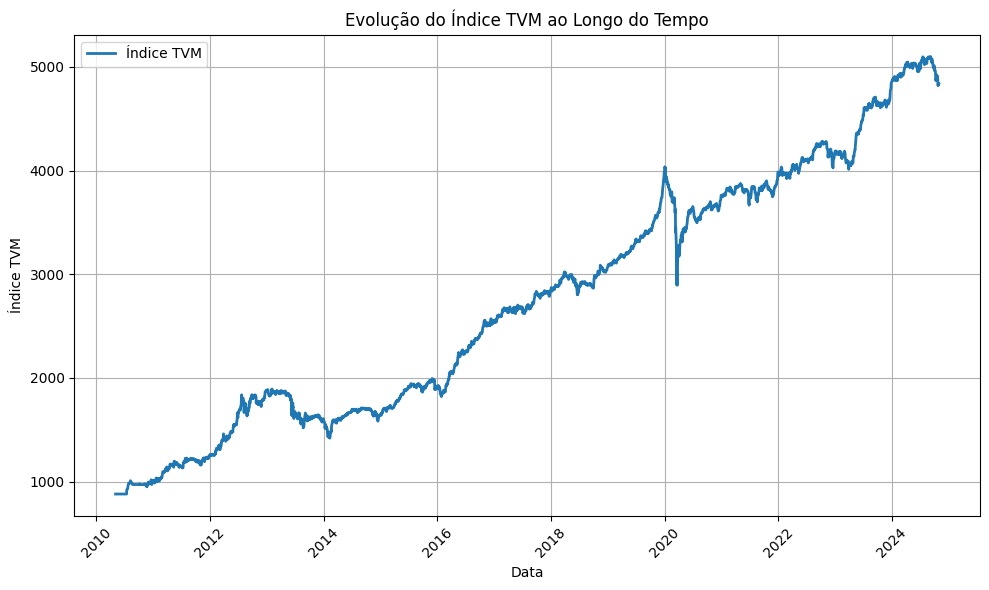

In [40]:
# Remover valores NaN anteriores ao primeiro valor válido
indice_tvm = indice_tvm[indice_tvm.first_valid_index():]

# Plotar o índice TVM
plt.figure(figsize=(10, 6))
plt.plot(indice_tvm.index, indice_tvm, label="Índice TVM", linewidth=2)
plt.xlabel("Data")
plt.ylabel("Índice TVM")
plt.title("Evolução do Índice TVM ao Longo do Tempo")
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()  # Ajusta layout para exibição clara
plt.show()


### Logística

Galpões Logísticos: FIIs que investem em centros de distribuição, armazéns e galpões logísticos usados por setores como e-commerce, varejo e indústria. Esses imóveis atendem à crescente demanda por soluções de armazenagem e logística eficiente, especialmente nas proximidades de grandes centros urbanos e rodovias, e são favorecidos por contratos de locação de longo prazo, oferecendo estabilidade e potencial de valorização.

In [41]:
# Filtro Logística

# Filtrando o cadastro para incluir apenas ativos com foco de atuação "Logística"
df_cadastro_logistica = df_cadastro_filtrado.loc[
    df_cadastro_filtrado['Foco_de_Atuacao'] == 'Logística', ['Codigo']
]

# Extraindo os códigos dos ativos Logística
codigos_logistica = df_cadastro_logistica['Codigo'].unique()

# Filtrando df_retorno para incluir apenas os códigos Logística
df_retorno_logistica = df_retorno_filtrado.loc[:, df_retorno_filtrado.columns.isin(codigos_logistica)]

# Filtrando df_valor_mercado para incluir apenas os códigos Logística
df_valor_mercado_logistica = df_valor_mercado_filtrado.loc[:, df_valor_mercado_filtrado.columns.isin(codigos_logistica)]

# Excluir linhas onde todas as colunas são NaN em ambos os DataFrames
df_retorno_logistica = df_retorno_logistica.dropna(how='all')
df_valor_mercado_logistica = df_valor_mercado_logistica.dropna(how='all')

# Encontrar as datas (índices) comuns entre os dois DataFrames
datas_comuns = df_retorno_logistica.index.intersection(df_valor_mercado_logistica.index)

# Filtrar ambos os DataFrames para conter apenas as datas comuns
df_retorno_logistica = df_retorno_logistica.loc[datas_comuns]
df_valor_mercado_logistica = df_valor_mercado_logistica.loc[datas_comuns]

# Exibir os DataFrames para verificação
print("df_retorno_logistica com datas comuns:\n", df_retorno_logistica)
print("df_valor_mercado_logistica com datas comuns:\n", df_valor_mercado_logistica)

df_retorno_logistica com datas comuns:
               HGLG11    XPLG11    BRCO11    LVBI11    VILG11    GGRC11  \
Data                                                                     
2024-10-29  0.277581 -1.041130  0.671391  1.658326  0.443131 -0.098232   
2024-10-28 -0.283231  1.655664  1.370640  0.216344  1.095072 -0.098135   
2024-10-25  0.680493 -0.167382 -0.535916  0.683168 -0.790123  1.393035   
2024-10-24 -0.445190 -0.177527  0.339623  0.059441 -0.430240 -0.297619   
2024-10-23 -0.385629 -1.481481 -1.091723 -1.039216 -0.343011 -0.591716   
...              ...       ...       ...       ...       ...       ...   
2004-11-19       NaN       NaN       NaN       NaN       NaN       NaN   
2004-10-05       NaN       NaN       NaN       NaN       NaN       NaN   
2004-01-19       NaN       NaN       NaN       NaN       NaN       NaN   
2003-12-22       NaN       NaN       NaN       NaN       NaN       NaN   
2003-10-28       NaN       NaN       NaN       NaN       NaN       NaN  

In [42]:
# Passo 1: Calcular os pesos diários com base no valor de mercado, somando para normalização
pesos_diarios_logistica = df_valor_mercado_logistica.div(df_valor_mercado_logistica.sum(axis=1), axis=0)

# Passo 2: Calcular o retorno ponderado diário de cada ativo
df_retorno_ponderado_logistica = df_retorno_logistica * pesos_diarios_logistica

# Passo 3: Calcular o retorno total diário do índice somando as linhas de df_retorno_ponderado_logistica
retorno_logistica = df_retorno_ponderado_logistica.sum(axis=1)

# Garantir que o índice de 'retorno_logistica' está ordenado cronologicamente e em formato datetime
retorno_logistica = retorno_logistica.sort_index()
retorno_logistica.index = pd.to_datetime(retorno_logistica.index)

# Passo 4: Calcular o fator percentual do retorno total diário
fator_percentual_diario_logistica = 1 + (retorno_logistica / 100)
# print(fator_percentual_diario_logistica)

# Passo 5: Construir o índice Logística partindo de um valor inicial de 1000 em 30/12/2010

# Definir a data base e o valor inicial do índice
data_base = pd.to_datetime('2010-12-30')
valor_inicial = 1000

# Verificar se a data base existe no índice, caso contrário, inserir a data base manualmente com retorno zero
if data_base not in retorno_logistica.index:
    retorno_logistica.loc[data_base] = 0  # Adicionar a data base com retorno zero
    retorno_logistica = retorno_logistica.sort_index()  # Reordenar o índice

# Calcular o fator percentual do retorno total diário
fator_percentual_diario_logistica = 1 + (retorno_logistica / 100)

# Verificar novamente após a inserção da data base
if data_base in retorno_logistica.index:
    # Calcular o índice Logística para dias posteriores (a partir da data base)
    posteriores = fator_percentual_diario_logistica.loc[data_base:].cumprod() * valor_inicial

    # Calcular o índice Logística para dias anteriores (antes da data base)
    anteriores = (1 / fator_percentual_diario_logistica.loc[:data_base][::-1]).cumprod()[::-1] * valor_inicial

    # Concatenar e ordenar para obter o índice acumulado completo, em ordem cronológica decrescente
    indice_logistica = pd.concat([anteriores, posteriores]).sort_index(ascending=False)

    # Definir o nome da coluna para o índice Logística
    indice_logistica.name = 'indice_logistica'

    # Exibir o índice Logística em ordem cronológica decrescente
    print("Índice Logística:\n", indice_logistica)
else:
    print("A data base ainda não foi encontrada no índice após a tentativa de inserção.")


Índice Logística:
 Data
2024-10-29    6123.873557
2024-10-28    6095.523633
2024-10-25    6079.823664
2024-10-24    6074.534582
2024-10-23    6090.480204
                 ...     
2004-11-19     423.135353
2004-10-05     438.113596
2004-01-19     438.113596
2003-12-22     438.113596
2003-10-28     438.825204
Name: indice_logistica, Length: 4422, dtype: float64


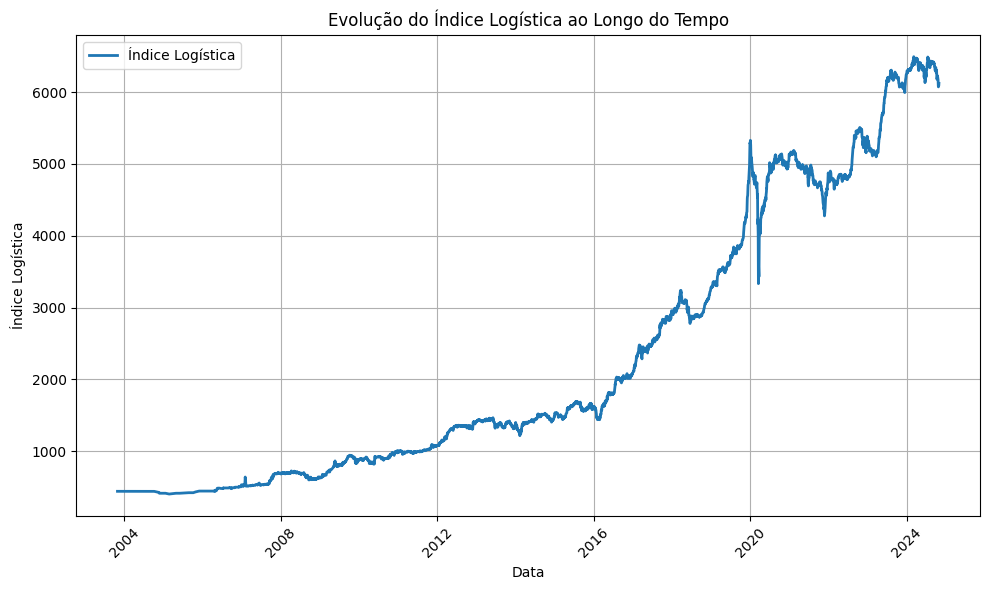

In [43]:
# Remover valores NaN anteriores ao primeiro valor válido
indice_logistica = indice_logistica[indice_logistica.first_valid_index():]

# Plotar o índice Logística
plt.figure(figsize=(10, 6))
plt.plot(indice_logistica.index, indice_logistica, label="Índice Logística", linewidth=2)
plt.xlabel("Data")
plt.ylabel("Índice Logística")
plt.title("Evolução do Índice Logística ao Longo do Tempo")
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()  # Ajusta layout para exibição clara
plt.show()


### Shoppings

Shoppings: Detêm total ou parcialmente shoppings centers, permitindo ao fundo gerar renda dos aluguéis das lojas e dos lucros das operações. A categoria é favorecida pela atração contínua de consumidores para centros de lazer e compras, além de contar com contratos de aluguel que ajustam valores de acordo com o faturamento das lojas, promovendo uma fonte de renda variável que acompanha o movimento econômico.

In [44]:
# Filtro Shoppings

# Filtrando o cadastro para incluir apenas ativos com foco de atuação "Shoppings"
df_cadastro_shoppings = df_cadastro_filtrado.loc[
    df_cadastro_filtrado['Foco_de_Atuacao'] == 'Shoppings', ['Codigo']
]

# Extraindo os códigos dos ativos Shoppings
codigos_shoppings = df_cadastro_shoppings['Codigo'].unique()

# Filtrando df_retorno para incluir apenas os códigos Shoppings
df_retorno_shoppings = df_retorno_filtrado.loc[:, df_retorno_filtrado.columns.isin(codigos_shoppings)]

# Filtrando df_valor_mercado para incluir apenas os códigos Shoppings
df_valor_mercado_shoppings = df_valor_mercado_filtrado.loc[:, df_valor_mercado_filtrado.columns.isin(codigos_shoppings)]

# Excluir linhas onde todas as colunas são NaN em ambos os DataFrames
df_retorno_shoppings = df_retorno_shoppings.dropna(how='all')
df_valor_mercado_shoppings = df_valor_mercado_shoppings.dropna(how='all')

# Encontrar as datas (índices) comuns entre os dois DataFrames
datas_comuns = df_retorno_shoppings.index.intersection(df_valor_mercado_shoppings.index)

# Filtrar ambos os DataFrames para conter apenas as datas comuns
df_retorno_shoppings = df_retorno_shoppings.loc[datas_comuns]
df_valor_mercado_shoppings = df_valor_mercado_shoppings.loc[datas_comuns]

# Exibir os DataFrames para verificação
print("df_retorno_shoppings com datas comuns:\n", df_retorno_shoppings)
print("df_valor_mercado_shoppings com datas comuns:\n", df_valor_mercado_shoppings)

df_retorno_shoppings com datas comuns:
               XPML11     ANCR11    HGBS11    HSML11    MALL11    GZIT11  \
Data                                                                      
2024-10-29  0.251159   0.000000 -0.578471  0.562056 -0.856488  2.281211   
2024-10-28  0.106373   0.020004  0.393900  2.444183  0.965309 -0.413052   
2024-10-25  0.398058  -0.010001 -0.442433  0.023507  0.596804  1.339473   
2024-10-24 -0.722892  68.531940 -0.295754 -0.164281 -0.080857  1.187747   
2024-10-23 -0.727203   1.004426 -0.558297 -1.365741 -1.355932  0.041693   
...              ...        ...       ...       ...       ...       ...   
2006-07-03       NaN        NaN       NaN       NaN       NaN       NaN   
2006-06-19       NaN        NaN       NaN       NaN       NaN       NaN   
2006-06-16       NaN        NaN       NaN       NaN       NaN       NaN   
2006-05-18       NaN        NaN       NaN       NaN       NaN       NaN   
2004-09-09       NaN        NaN       NaN       NaN       Na

In [45]:
# Passo 1: Calcular os pesos diários com base no valor de mercado, somando para normalização
pesos_diarios_shoppings = df_valor_mercado_shoppings.div(df_valor_mercado_shoppings.sum(axis=1), axis=0)

# Passo 2: Calcular o retorno ponderado diário de cada ativo
df_retorno_ponderado_shoppings = df_retorno_shoppings * pesos_diarios_shoppings

# Passo 3: Calcular o retorno total diário do índice somando as linhas de df_retorno_ponderado_shoppings
retorno_shoppings = df_retorno_ponderado_shoppings.sum(axis=1)

# Garantir que o índice de 'retorno_shoppings' está ordenado cronologicamente e em formato datetime
retorno_shoppings = retorno_shoppings.sort_index()
retorno_shoppings.index = pd.to_datetime(retorno_shoppings.index)

# Passo 4: Calcular o fator percentual do retorno total diário
fator_percentual_diario_shoppings = 1 + (retorno_shoppings / 100)
# print(fator_percentual_diario_shoppings)

# Passo 5: Construir o índice Shoppings partindo de um valor inicial de 1000 em 30/12/2010

# Definir a data base e o valor inicial do índice
data_base = pd.to_datetime('2010-12-30')
valor_inicial = 1000

# Verificar se a data base existe no índice, caso contrário, inserir a data base manualmente com retorno zero
if data_base not in retorno_shoppings.index:
    retorno_shoppings.loc[data_base] = 0  # Adicionar a data base com retorno zero
    retorno_shoppings = retorno_shoppings.sort_index()  # Reordenar o índice

# Calcular o fator percentual do retorno total diário
fator_percentual_diario_shoppings = 1 + (retorno_shoppings / 100)

# Verificar novamente após a inserção da data base
if data_base in retorno_shoppings.index:
    # Calcular o índice Shoppings para dias posteriores (a partir da data base)
    posteriores = fator_percentual_diario_shoppings.loc[data_base:].cumprod() * valor_inicial

    # Calcular o índice Shoppings para dias anteriores (antes da data base)
    anteriores = (1 / fator_percentual_diario_shoppings.loc[:data_base][::-1]).cumprod()[::-1] * valor_inicial

    # Concatenar e ordenar para obter o índice acumulado completo, em ordem cronológica decrescente
    indice_shoppings = pd.concat([anteriores, posteriores]).sort_index(ascending=False)

    # Definir o nome da coluna para o índice Shoppings
    indice_shoppings.name = 'indice_shoppings'

    # Exibir o índice Shoppings em ordem cronológica decrescente
    print("Índice Shoppings:\n", indice_shoppings)
else:
    print("A data base ainda não foi encontrada no índice após a tentativa de inserção.")


Índice Shoppings:
 Data
2024-10-29    6233.461653
2024-10-28    6225.747687
2024-10-25    6206.177474
2024-10-24    6194.425362
2024-10-23    5687.952091
                 ...     
2006-07-03     773.286294
2006-06-19     773.286294
2006-06-16     831.282766
2006-05-18     786.893880
2004-09-09     807.601614
Name: indice_shoppings, Length: 4033, dtype: float64


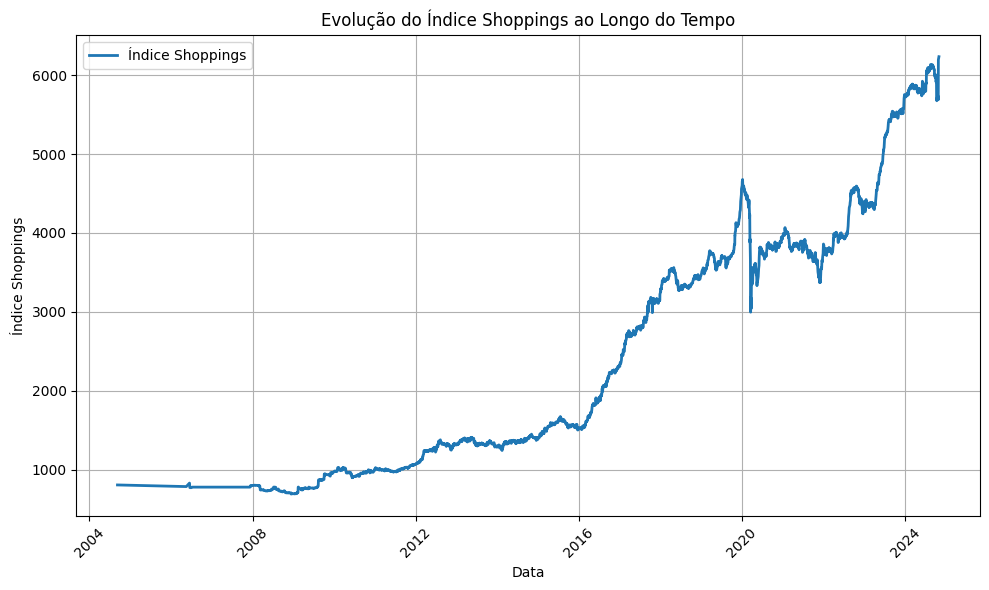

In [46]:
# Remover valores NaN anteriores ao primeiro valor válido
indice_shoppings = indice_shoppings[indice_shoppings.first_valid_index():]

# Plotar o índice Shoppings
plt.figure(figsize=(10, 6))
plt.plot(indice_shoppings.index, indice_shoppings, label="Índice Shoppings", linewidth=2)
plt.xlabel("Data")
plt.ylabel("Índice Shoppings")
plt.title("Evolução do Índice Shoppings ao Longo do Tempo")
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()  # Ajusta layout para exibição clara
plt.show()


### Lajes Corporativas

Lajes Corporativas: Com foco em edifícios comerciais de médio e alto padrão, geralmente localizados em grandes centros urbanos, esses FIIs alugam escritórios para empresas. A categoria é voltada a investidores que buscam exposição ao setor corporativo, embora a demanda possa oscilar conforme o contexto econômico e tendências como o trabalho remoto.

In [47]:
# Filtro Lajes Corporativas

# Filtrando o cadastro para incluir apenas ativos com foco de atuação "Lajes Corporativas"
df_cadastro_lajes_corporativas = df_cadastro_filtrado.loc[
    df_cadastro_filtrado['Foco_de_Atuacao'] == 'Lajes Corporativas', ['Codigo']
]

# Extraindo os códigos dos ativos Lajes Corporativas
codigos_lajes_corporativas = df_cadastro_lajes_corporativas['Codigo'].unique()

# Filtrando df_retorno para incluir apenas os códigos Lajes Corporativas
df_retorno_lajes_corporativas = df_retorno_filtrado.loc[:, df_retorno_filtrado.columns.isin(codigos_lajes_corporativas)]

# Filtrando df_valor_mercado para incluir apenas os códigos Lajes Corporativas
df_valor_mercado_lajes_corporativas = df_valor_mercado_filtrado.loc[:, df_valor_mercado_filtrado.columns.isin(codigos_lajes_corporativas)]

# Excluir linhas onde todas as colunas são NaN em ambos os DataFrames
df_retorno_lajes_corporativas = df_retorno_lajes_corporativas.dropna(how='all')
df_valor_mercado_lajes_corporativas = df_valor_mercado_lajes_corporativas.dropna(how='all')

# Encontrar as datas (índices) comuns entre os dois DataFrames
datas_comuns = df_retorno_lajes_corporativas.index.intersection(df_valor_mercado_lajes_corporativas.index)

# Filtrar ambos os DataFrames para conter apenas as datas comuns
df_retorno_lajes_corporativas = df_retorno_lajes_corporativas.loc[datas_comuns]
df_valor_mercado_lajes_corporativas = df_valor_mercado_lajes_corporativas.loc[datas_comuns]

# Exibir os DataFrames para verificação
print("df_retorno_lajes_corporativas com datas comuns:\n", df_retorno_lajes_corporativas)
print("df_valor_mercado_lajes_corporativas com datas comuns:\n", df_valor_mercado_lajes_corporativas)

df_retorno_lajes_corporativas com datas comuns:
               PVBI11    HGRE11    GTWR11    RBRP11    HGPO11     RCRB11  \
Data                                                                      
2024-10-29 -0.037207  0.234962 -0.818023  1.002700  1.112772   2.858249   
2024-10-28 -0.456790  1.964542  0.961278  1.906072 -0.294761  -3.041682   
2024-10-25  0.997506  1.163354  1.679515  1.032361  0.312292   0.498151   
2024-10-24 -1.219362 -0.299633 -0.082531 -0.356083  0.166389   2.190513   
2024-10-23 -0.514643 -0.519231 -2.245529 -0.687623 -0.182694   0.449369   
...              ...       ...       ...       ...       ...        ...   
2004-03-23       NaN       NaN       NaN       NaN       NaN  -2.857143   
2004-03-18       NaN       NaN       NaN       NaN       NaN   0.000000   
2004-03-17       NaN       NaN       NaN       NaN       NaN  -1.408451   
2004-01-20       NaN       NaN       NaN       NaN       NaN  -6.250000   
2004-01-19       NaN       NaN       NaN       NaN 

In [48]:
# Passo 1: Calcular os pesos diários com base no valor de mercado, somando para normalização
pesos_diarios_lajes_corporativas = df_valor_mercado_lajes_corporativas.div(df_valor_mercado_lajes_corporativas.sum(axis=1), axis=0)

# Passo 2: Calcular o retorno ponderado diário de cada ativo
df_retorno_ponderado_lajes_corporativas = df_retorno_lajes_corporativas * pesos_diarios_lajes_corporativas

# Passo 3: Calcular o retorno total diário do índice somando as linhas de df_retorno_ponderado_lajes_corporativas
retorno_lajes_corporativas = df_retorno_ponderado_lajes_corporativas.sum(axis=1)

# Garantir que o índice de 'retorno_lajes_corporativas' está ordenado cronologicamente e em formato datetime
retorno_lajes_corporativas = retorno_lajes_corporativas.sort_index()
retorno_lajes_corporativas.index = pd.to_datetime(retorno_lajes_corporativas.index)

# Passo 4: Calcular o fator percentual do retorno total diário
fator_percentual_diario_lajes_corporativas = 1 + (retorno_lajes_corporativas / 100)
# print(fator_percentual_diario_lajes_corporativas)

# Passo 5: Construir o índice Lajes Corporativas partindo de um valor inicial de 1000 em 30/12/2010

# Definir a data base e o valor inicial do índice
data_base = pd.to_datetime('2010-12-30')
valor_inicial = 1000

# Verificar se a data base existe no índice, caso contrário, inserir a data base manualmente com retorno zero
if data_base not in retorno_lajes_corporativas.index:
    retorno_lajes_corporativas.loc[data_base] = 0  # Adicionar a data base com retorno zero
    retorno_lajes_corporativas = retorno_lajes_corporativas.sort_index()  # Reordenar o índice

# Calcular o fator percentual do retorno total diário
fator_percentual_diario_lajes_corporativas = 1 + (retorno_lajes_corporativas / 100)

# Verificar novamente após a inserção da data base
if data_base in retorno_lajes_corporativas.index:
    # Calcular o índice Lajes Corporativas para dias posteriores (a partir da data base)
    posteriores = fator_percentual_diario_lajes_corporativas.loc[data_base:].cumprod() * valor_inicial

    # Calcular o índice Lajes Corporativas para dias anteriores (antes da data base)
    anteriores = (1 / fator_percentual_diario_lajes_corporativas.loc[:data_base][::-1]).cumprod()[::-1] * valor_inicial

    # Concatenar e ordenar para obter o índice acumulado completo, em ordem cronológica decrescente
    indice_lajes_corporativas = pd.concat([anteriores, posteriores]).sort_index(ascending=False)

    # Definir o nome da coluna para o índice Lajes Corporativas
    indice_lajes_corporativas.name = 'indice_lajes_corporativas'

    # Exibir o índice Lajes Corporativas em ordem cronológica decrescente
    print("Índice Lajes Corporativas:\n", indice_lajes_corporativas)
else:
    print("A data base ainda não foi encontrada no índice após a tentativa de inserção.")


Índice Lajes Corporativas:
 Data
2024-10-29    3287.304751
2024-10-28    3279.253782
2024-10-25    3273.249220
2024-10-24    3259.869602
2024-10-23    3268.532697
                 ...     
2004-03-23     543.318803
2004-03-18     543.318803
2004-03-17     551.080500
2004-01-20     587.819200
2004-01-19     698.035300
Name: indice_lajes_corporativas, Length: 4811, dtype: float64


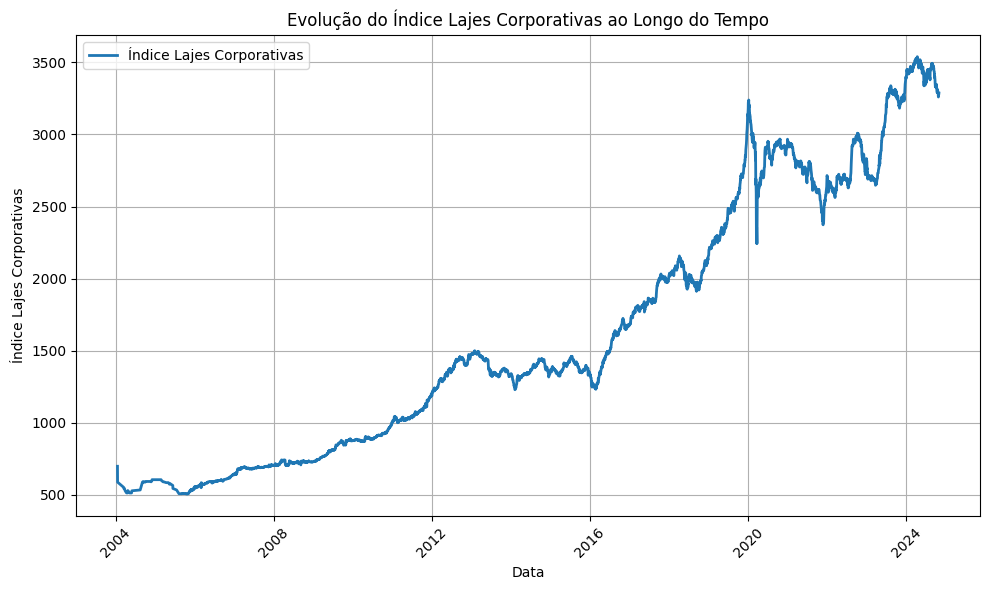

In [49]:
# Remover valores NaN anteriores ao primeiro valor válido
indice_lajes_corporativas = indice_lajes_corporativas[indice_lajes_corporativas.first_valid_index():]

# Plotar o índice Lajes Corporativas
plt.figure(figsize=(10, 6))
plt.plot(indice_lajes_corporativas.index, indice_lajes_corporativas, label="Índice Lajes Corporativas", linewidth=2)
plt.xlabel("Data")
plt.ylabel("Índice Lajes Corporativas")
plt.title("Evolução do Índice Lajes Corporativas ao Longo do Tempo")
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()  # Ajusta layout para exibição clara
plt.show()


###Educacional

Educacionais: são fundos imobiliários especializados em imóveis destinados ao setor de educação, como escolas, universidades, centros de ensino e espaços de treinamento. Esses fundos geram renda a partir dos aluguéis pagos pelas instituições educacionais que ocupam esses imóveis, oferecendo uma fonte de receita relativamente estável, uma vez que o setor educacional tende a ter uma demanda constante. No entanto, o risco desses fundos pode estar atrelado à concentração de inquilinos (instituições de ensino específicas) e à dependência das condições econômicas e regulatórias do setor de educação. Esse tipo de FII é indicado para investidores que buscam exposição ao setor educacional, com potencial de diversificação de risco e rendimento, especialmente em áreas de alta demanda por ensino.

In [50]:
# Filtro Educacional

# Filtrando o cadastro para incluir apenas ativos com foco de atuação "Educacional"
df_cadastro_educacional = df_cadastro_filtrado.loc[
    df_cadastro_filtrado['Foco_de_Atuacao'] == 'Educacional', ['Codigo']
]

# Extraindo os códigos dos ativos Educacional
codigos_educacional = df_cadastro_educacional['Codigo'].unique()

# Filtrando df_retorno para incluir apenas os códigos Educacional
df_retorno_educacional = df_retorno_filtrado.loc[:, df_retorno_filtrado.columns.isin(codigos_educacional)]

# Filtrando df_valor_mercado para incluir apenas os códigos Educacional
df_valor_mercado_educacional = df_valor_mercado_filtrado.loc[:, df_valor_mercado_filtrado.columns.isin(codigos_educacional)]

# Excluir linhas onde todas as colunas são NaN em ambos os DataFrames
df_retorno_educacional = df_retorno_educacional.dropna(how='all')
df_valor_mercado_educacional = df_valor_mercado_educacional.dropna(how='all')

# Encontrar as datas (índices) comuns entre os dois DataFrames
datas_comuns = df_retorno_educacional.index.intersection(df_valor_mercado_educacional.index)

# Filtrar ambos os DataFrames para conter apenas as datas comuns
df_retorno_educacional = df_retorno_educacional.loc[datas_comuns]
df_valor_mercado_educacional = df_valor_mercado_educacional.loc[datas_comuns]

# Exibir os DataFrames para verificação
print("df_retorno_educacional com datas comuns:\n", df_retorno_educacional)
print("df_valor_mercado_educacional com datas comuns:\n", df_valor_mercado_educacional)

df_retorno_educacional com datas comuns:
               RBED11     FAED11  MINT11
Data                                   
2024-10-29  0.478469  -0.723404     NaN
2024-10-28 -0.468291   0.642398     NaN
2024-10-25 -1.184314  -0.638298     NaN
2024-10-24 -0.855365   0.570613     NaN
2024-10-23 -0.924499  -1.267606     NaN
...              ...        ...     ...
2010-02-12       NaN   4.545455     NaN
2010-02-11       NaN   0.640439     NaN
2010-02-10       NaN  -0.636364     NaN
2010-02-09       NaN   0.000000     NaN
2010-02-08       NaN  10.978425     NaN

[3415 rows x 3 columns]
df_valor_mercado_educacional com datas comuns:
                   RBED11       FAED11   MINT11
Data                                          
2024-10-29  296732.77200  96918.93246  49748.4
2024-10-28  295319.75880  97625.15700  49748.4
2024-10-25  296709.22178  97002.01770  49748.4
2024-10-24  300265.30500  97625.15700  49748.4
2024-10-23  302855.82920  97071.25540  49748.4
...                  ...          ..

In [51]:
# Passo 1: Calcular os pesos diários com base no valor de mercado, somando para normalização
pesos_diarios_educacional = df_valor_mercado_educacional.div(df_valor_mercado_educacional.sum(axis=1), axis=0)

# Passo 2: Calcular o retorno ponderado diário de cada ativo
df_retorno_ponderado_educacional = df_retorno_educacional * pesos_diarios_educacional

# Passo 3: Calcular o retorno total diário do índice somando as linhas de df_retorno_ponderado_educacional
retorno_educacional = df_retorno_ponderado_educacional.sum(axis=1)

# Garantir que o índice de 'retorno_educacional' está ordenado cronologicamente e em formato datetime
retorno_educacional = retorno_educacional.sort_index()
retorno_educacional.index = pd.to_datetime(retorno_educacional.index)

# Passo 4: Calcular o fator percentual do retorno total diário
fator_percentual_diario_educacional = 1 + (retorno_educacional / 100)
# print(fator_percentual_diario_educacional)

# Passo 5: Construir o índice Educacional partindo de um valor inicial de 1000 em 30/12/2010

# Definir a data base e o valor inicial do índice
data_base = pd.to_datetime('2010-12-30')
valor_inicial = 1000

# Verificar se a data base existe no índice, caso contrário, inserir a data base manualmente com retorno zero
if data_base not in retorno_educacional.index:
    retorno_educacional.loc[data_base] = 0  # Adicionar a data base com retorno zero
    retorno_educacional = retorno_educacional.sort_index()  # Reordenar o índice

# Calcular o fator percentual do retorno total diário
fator_percentual_diario_educacional = 1 + (retorno_educacional / 100)

# Verificar novamente após a inserção da data base
if data_base in retorno_educacional.index:
    # Calcular o índice Educacional para dias posteriores (a partir da data base)
    posteriores = fator_percentual_diario_educacional.loc[data_base:].cumprod() * valor_inicial

    # Calcular o índice Educacional para dias anteriores (antes da data base)
    anteriores = (1 / fator_percentual_diario_educacional.loc[:data_base][::-1]).cumprod()[::-1] * valor_inicial

    # Concatenar e ordenar para obter o índice acumulado completo, em ordem cronológica decrescente
    indice_educacional = pd.concat([anteriores, posteriores]).sort_index(ascending=False)

    # Definir o nome da coluna para o índice Educacional
    indice_educacional.name = 'indice_educacional'

    # Exibir o índice Educacional em ordem cronológica decrescente
    print("Índice Educacional:\n", indice_educacional)
else:
    print("A data base ainda não foi encontrada no índice após a tentativa de inserção.")


Índice Educacional:
 Data
2024-10-29    7429.840454
2024-10-28    7417.817731
2024-10-25    7430.503891
2024-10-24    7500.409159
2024-10-23    7534.261642
                 ...     
2010-02-12     966.593864
2010-02-11     960.442812
2010-02-10     966.593864
2010-02-09     966.593864
2010-02-08     870.974577
Name: indice_educacional, Length: 3417, dtype: float64


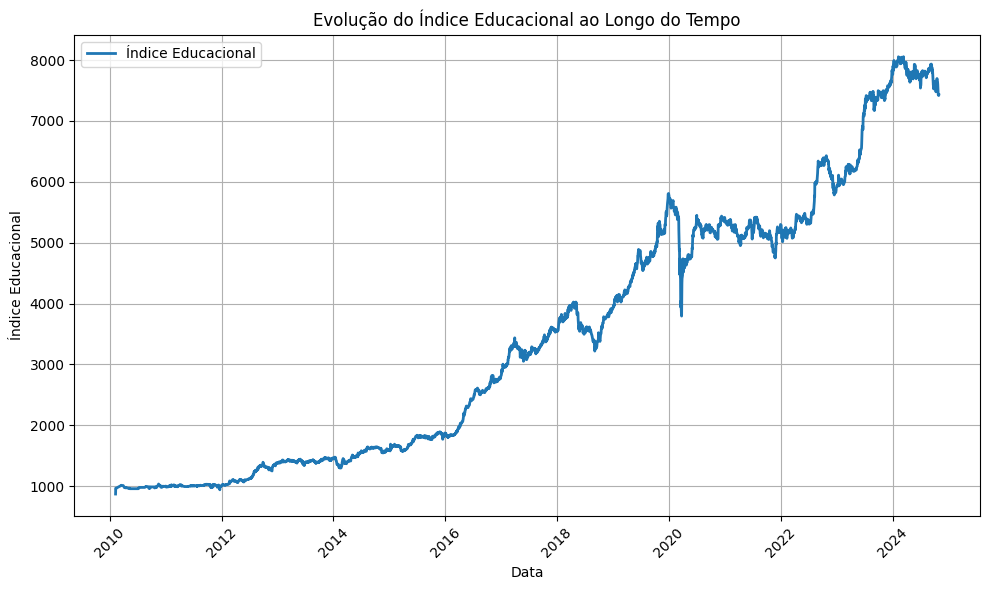

In [52]:
# Remover valores NaN anteriores ao primeiro valor válido
indice_educacional = indice_educacional[indice_educacional.first_valid_index():]

# Plotar o índice Educacional
plt.figure(figsize=(10, 6))
plt.plot(indice_educacional.index, indice_educacional, label="Índice Educacional", linewidth=2)
plt.xlabel("Data")
plt.ylabel("Índice Educacional")
plt.title("Evolução do Índice Educacional ao Longo do Tempo")
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()  # Ajusta layout para exibição clara
plt.show()


### Hospital

Hospitais: FIIs especializados em imóveis hospitalares e de saúde, alugados a clínicas, hospitais e outros estabelecimentos de saúde. A categoria possui riscos concentrados, muitas vezes dependendo de um único inquilino, o que torna essencial analisar a solidez do arrendatário para garantir a segurança do investimento.

In [53]:
# Filtro Hospital

# Filtrando o cadastro para incluir apenas ativos com foco de atuação "Hospital"
df_cadastro_hospital = df_cadastro_filtrado.loc[
    df_cadastro_filtrado['Foco_de_Atuacao'] == 'Hospital', ['Codigo']
]

# Extraindo os códigos dos ativos Hospital
codigos_hospital = df_cadastro_hospital['Codigo'].unique()

# Filtrando df_retorno para incluir apenas os códigos Hospital
df_retorno_hospital = df_retorno_filtrado.loc[:, df_retorno_filtrado.columns.isin(codigos_hospital)]

# Filtrando df_valor_mercado para incluir apenas os códigos Hospital
df_valor_mercado_hospital = df_valor_mercado_filtrado.loc[:, df_valor_mercado_filtrado.columns.isin(codigos_hospital)]

# Excluir linhas onde todas as colunas são NaN em ambos os DataFrames
df_retorno_hospital = df_retorno_hospital.dropna(how='all')
df_valor_mercado_hospital = df_valor_mercado_hospital.dropna(how='all')

# Encontrar as datas (índices) comuns entre os dois DataFrames
datas_comuns = df_retorno_hospital.index.intersection(df_valor_mercado_hospital.index)

# Filtrar ambos os DataFrames para conter apenas as datas comuns
df_retorno_hospital = df_retorno_hospital.loc[datas_comuns]
df_valor_mercado_hospital = df_valor_mercado_hospital.loc[datas_comuns]

# Exibir os DataFrames para verificação
print("df_retorno_hospital com datas comuns:\n", df_retorno_hospital)
print("df_valor_mercado_hospital com datas comuns:\n", df_valor_mercado_hospital)

df_retorno_hospital com datas comuns:
                NVHO11    NSLU11  HUSI11  HUCG11    HUSC11    HCRI11
Data                                                               
2024-10-29  11.072961  0.949462     NaN     NaN       NaN  0.667935
2024-10-28   1.304348 -0.946429     NaN     NaN       NaN -0.412486
2024-10-25  -4.006678 -0.077321     NaN     NaN       NaN  0.410448
2024-10-24  -0.498339 -0.989341     NaN     NaN       NaN -0.755444
2024-10-23   0.789814  0.981208     NaN     NaN  0.083187 -0.720588
...               ...       ...     ...     ...       ...       ...
2006-10-06        NaN       NaN     NaN     NaN       NaN -0.068750
2006-06-19        NaN       NaN     NaN     NaN       NaN  6.250000
2006-05-19        NaN       NaN     NaN     NaN       NaN  0.000000
2006-05-18        NaN       NaN     NaN     NaN       NaN  0.000000
2006-05-08        NaN       NaN     NaN     NaN       NaN  0.000000

[4005 rows x 6 columns]
df_valor_mercado_hospital com datas comuns:
        

In [54]:
# Passo 1: Calcular os pesos diários com base no valor de mercado, somando para normalização
pesos_diarios_hospital = df_valor_mercado_hospital.div(df_valor_mercado_hospital.sum(axis=1), axis=0)

# Passo 2: Calcular o retorno ponderado diário de cada ativo
df_retorno_ponderado_hospital = df_retorno_hospital * pesos_diarios_hospital

# Passo 3: Calcular o retorno total diário do índice somando as linhas de df_retorno_ponderado_hospital
retorno_hospital = df_retorno_ponderado_hospital.sum(axis=1)

# Garantir que o índice de 'retorno_hospital' está ordenado cronologicamente e em formato datetime
retorno_hospital = retorno_hospital.sort_index()
retorno_hospital.index = pd.to_datetime(retorno_hospital.index)

# Passo 4: Calcular o fator percentual do retorno total diário
fator_percentual_diario_hospital = 1 + (retorno_hospital / 100)
# print(fator_percentual_diario_hospital)

# Passo 5: Construir o índice Hospital partindo de um valor inicial de 1000 em 30/12/2010

# Definir a data base e o valor inicial do índice
data_base = pd.to_datetime('2010-12-30')
valor_inicial = 1000

# Verificar se a data base existe no índice, caso contrário, inserir a data base manualmente com retorno zero
if data_base not in retorno_hospital.index:
    retorno_hospital.loc[data_base] = 0  # Adicionar a data base com retorno zero
    retorno_hospital = retorno_hospital.sort_index()  # Reordenar o índice

# Calcular o fator percentual do retorno total diário
fator_percentual_diario_hospital = 1 + (retorno_hospital / 100)

# Verificar novamente após a inserção da data base
if data_base in retorno_hospital.index:
    # Calcular o índice Hospital para dias posteriores (a partir da data base)
    posteriores = fator_percentual_diario_hospital.loc[data_base:].cumprod() * valor_inicial

    # Calcular o índice Hospital para dias anteriores (antes da data base)
    anteriores = (1 / fator_percentual_diario_hospital.loc[:data_base][::-1]).cumprod()[::-1] * valor_inicial

    # Concatenar e ordenar para obter o índice acumulado completo, em ordem cronológica decrescente
    indice_hospital = pd.concat([anteriores, posteriores]).sort_index(ascending=False)

    # Definir o nome da coluna para o índice Hospital
    indice_hospital.name = 'indice_hospital'

    # Exibir o índice Hospital em ordem cronológica decrescente
    print("Índice Hospital:\n", indice_hospital)
else:
    print("A data base ainda não foi encontrada no índice após a tentativa de inserção.")


Índice Hospital:
 Data
2024-10-29    9924.380778
2024-10-28    9413.166538
2024-10-25    9378.133367
2024-10-24    9546.747797
2024-10-23    9590.693398
                 ...     
2006-10-06     724.181514
2006-06-19     681.582601
2006-05-19     681.582601
2006-05-18     681.582601
2006-05-08     681.582601
Name: indice_hospital, Length: 4006, dtype: float64


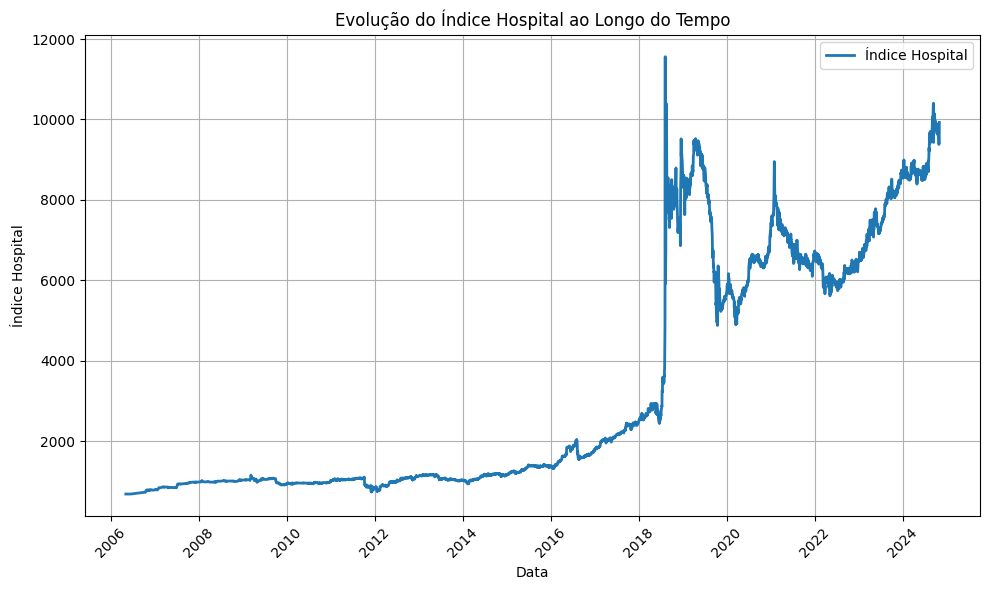

In [55]:
# Remover valores NaN anteriores ao primeiro valor válido
indice_hospital = indice_hospital[indice_hospital.first_valid_index():]

# Plotar o índice Hospital
plt.figure(figsize=(10, 6))
plt.plot(indice_hospital.index, indice_hospital, label="Índice Hospital", linewidth=2)
plt.xlabel("Data")
plt.ylabel("Índice Hospital")
plt.title("Evolução do Índice Hospital ao Longo do Tempo")
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()  # Ajusta layout para exibição clara
plt.show()


### Agências

Agências Bancárias: são fundos imobiliários que investem em imóveis alugados para instituições financeiras, como agências bancárias e escritórios administrativos de bancos. Esse tipo de FII é caracterizado pela estabilidade de renda, uma vez que os contratos de locação com bancos costumam ser de longo prazo e oferecem previsibilidade nos rendimentos distribuídos aos cotistas. Os inquilinos são geralmente instituições financeiras sólidas, o que reduz o risco de inadimplência e confere maior segurança ao fluxo de caixa do fundo. Além disso, as agências bancárias estão frequentemente localizadas em áreas centrais e de grande movimentação, agregando valor aos imóveis no portfólio e tornando-os atrativos mesmo em cenários econômicos mais desafiadores.

In [56]:
# Filtro Agências

# Filtrando o cadastro para incluir apenas ativos com foco de atuação "Agências"
df_cadastro_agencias = df_cadastro_filtrado.loc[
    df_cadastro_filtrado['Foco_de_Atuacao'] == 'Agências', ['Codigo']
]

# Extraindo os códigos dos ativos Agências
codigos_agencias = df_cadastro_agencias['Codigo'].unique()

# Filtrando df_retorno para incluir apenas os códigos Agências
df_retorno_agencias = df_retorno_filtrado.loc[:, df_retorno_filtrado.columns.isin(codigos_agencias)]

# Filtrando df_valor_mercado para incluir apenas os códigos Agências
df_valor_mercado_agencias = df_valor_mercado_filtrado.loc[:, df_valor_mercado_filtrado.columns.isin(codigos_agencias)]

# Excluir linhas onde todas as colunas são NaN em ambos os DataFrames
df_retorno_agencias = df_retorno_agencias.dropna(how='all')
df_valor_mercado_agencias = df_valor_mercado_agencias.dropna(how='all')

# Encontrar as datas (índices) comuns entre os dois DataFrames
datas_comuns = df_retorno_agencias.index.intersection(df_valor_mercado_agencias.index)

# Filtrar ambos os DataFrames para conter apenas as datas comuns
df_retorno_agencias = df_retorno_agencias.loc[datas_comuns]
df_valor_mercado_agencias = df_valor_mercado_agencias.loc[datas_comuns]

# Exibir os DataFrames para verificação
print("df_retorno_agencias com datas comuns:\n", df_retorno_agencias)
print("df_valor_mercado_agencias com datas comuns:\n", df_valor_mercado_agencias)

df_retorno_agencias com datas comuns:
               RBVA11    BBRC11    BNFS11
Data                                    
2024-10-29  0.817411 -0.028064 -0.383655
2024-10-28 -0.467812 -1.018519  0.071429
2024-10-25 -0.172589 -1.035462  1.920102
2024-10-24 -0.855561  0.082539 -0.695825
2024-10-23 -0.689724 -0.510949 -1.196429
...              ...       ...       ...
2011-07-06       NaN -0.099991       NaN
2011-07-05       NaN  3.295775       NaN
2011-07-04       NaN -6.578947       NaN
2011-07-01       NaN -1.724138       NaN
2011-06-30       NaN  0.869565       NaN

[3302 rows x 3 columns]
df_valor_mercado_agencias com datas comuns:
                   RBVA11    BBRC11   BNFS11
Data                                       
2024-10-29  1.231928e+06  169923.3  78155.0
2024-10-28  1.221940e+06  169971.0  78456.0
2024-10-25  1.227683e+06  171720.0  78400.0
2024-10-24  1.229805e+06  173516.7  76923.0
2024-10-23  1.240418e+06  173373.6  77462.0
...                  ...       ...      ...
2011-0

In [57]:
# Passo 1: Calcular os pesos diários com base no valor de mercado, somando para normalização
pesos_diarios_agencias = df_valor_mercado_agencias.div(df_valor_mercado_agencias.sum(axis=1), axis=0)

# Passo 2: Calcular o retorno ponderado diário de cada ativo
df_retorno_ponderado_agencias = df_retorno_agencias * pesos_diarios_agencias

# Passo 3: Calcular o retorno total diário do índice somando as linhas de df_retorno_ponderado_agencias
retorno_agencias = df_retorno_ponderado_agencias.sum(axis=1)

# Garantir que o índice de 'retorno_agencias' está ordenado cronologicamente e em formato datetime
retorno_agencias = retorno_agencias.sort_index()
retorno_agencias.index = pd.to_datetime(retorno_agencias.index)

# Passo 4: Calcular o fator percentual do retorno total diário
fator_percentual_diario_agencias = 1 + (retorno_agencias / 100)
# print(fator_percentual_diario_agencias)

# Passo 5: Construir o índice Agências partindo de um valor inicial de 1000 em 30/12/2010

# Definir a data base e o valor inicial do índice
data_base = pd.to_datetime('2010-12-30')
valor_inicial = 1000

# Verificar se a data base existe no índice, caso contrário, inserir a data base manualmente com retorno zero
if data_base not in retorno_agencias.index:
    retorno_agencias.loc[data_base] = 0  # Adicionar a data base com retorno zero
    retorno_agencias = retorno_agencias.sort_index()  # Reordenar o índice

# Calcular o fator percentual do retorno total diário
fator_percentual_diario_agencias = 1 + (retorno_agencias / 100)

# Verificar novamente após a inserção da data base
if data_base in retorno_agencias.index:
    # Calcular o índice Agências para dias posteriores (a partir da data base)
    posteriores = fator_percentual_diario_agencias.loc[data_base:].cumprod() * valor_inicial

    # Calcular o índice Agências para dias anteriores (antes da data base)
    anteriores = (1 / fator_percentual_diario_agencias.loc[:data_base][::-1]).cumprod()[::-1] * valor_inicial

    # Concatenar e ordenar para obter o índice acumulado completo, em ordem cronológica decrescente
    indice_agencias = pd.concat([anteriores, posteriores]).sort_index(ascending=False)

    # Definir o nome da coluna para o índice Agências
    indice_agencias.name = 'indice_agencias'

    # Exibir o índice Agências em ordem cronológica decrescente
    print("Índice Agências:\n", indice_agencias)
else:
    print("A data base ainda não foi encontrada no índice após a tentativa de inserção.")


Índice Agências:
 Data
2024-10-29    3493.528009
2024-10-28    3470.728280
2024-10-25    3488.263780
2024-10-24    3493.918108
2024-10-23    3519.869922
                 ...     
2011-07-04     926.086957
2011-07-01     991.304348
2011-06-30    1008.695652
2010-12-30    1000.000000
2010-12-30    1000.000000
Name: indice_agencias, Length: 3304, dtype: float64


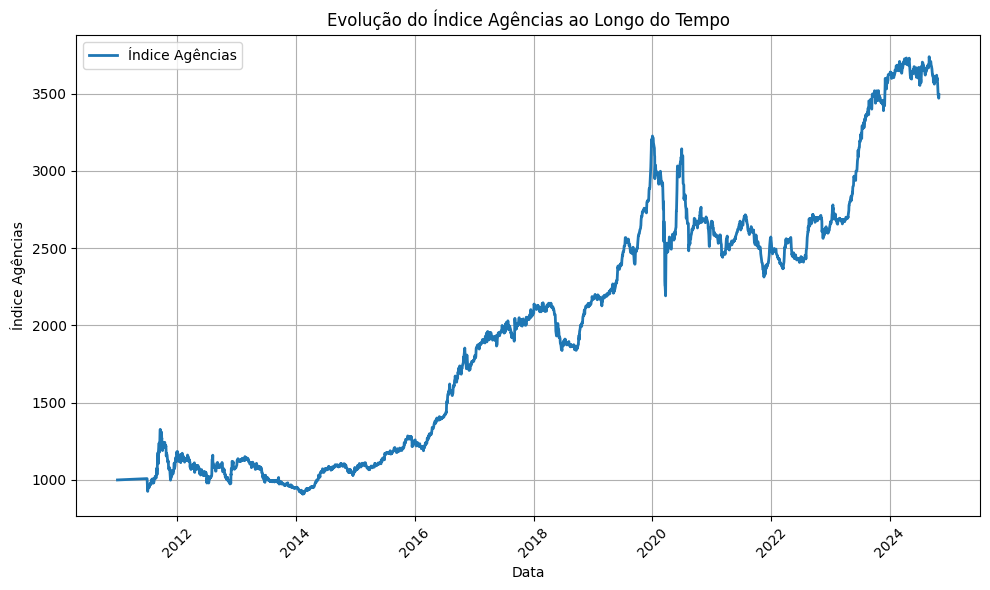

In [58]:
# Remover valores NaN anteriores ao primeiro valor válido
indice_agencias = indice_agencias[indice_agencias.first_valid_index():]

# Plotar o índice Agências
plt.figure(figsize=(10, 6))
plt.plot(indice_agencias.index, indice_agencias, label="Índice Agências", linewidth=2)
plt.xlabel("Data")
plt.ylabel("Índice Agências")
plt.title("Evolução do Índice Agências ao Longo do Tempo")
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()  # Ajusta layout para exibição clara
plt.show()


### Hotel

Hotéis: FIIs voltados para a exploração de imóveis no setor hoteleiro, como hotéis e resorts. Esses fundos geram renda a partir da locação para operadores hoteleiros e são altamente sensíveis à sazonalidade e à economia, com maior risco em períodos de baixa ocupação, mas com o potencial de retornos elevados em regiões turísticas ou centros de negócios.

In [59]:
# Filtro Hotel

# Filtrando o cadastro para incluir apenas ativos com foco de atuação "Hotel"
df_cadastro_hotel = df_cadastro_filtrado.loc[
    df_cadastro_filtrado['Foco_de_Atuacao'] == 'Hotel', ['Codigo']
]

# Extraindo os códigos dos ativos Hotel
codigos_hotel = df_cadastro_hotel['Codigo'].unique()

# Filtrando df_retorno para incluir apenas os códigos Hotel
df_retorno_hotel = df_retorno_filtrado.loc[:, df_retorno_filtrado.columns.isin(codigos_hotel)]

# Filtrando df_valor_mercado para incluir apenas os códigos Hotel
df_valor_mercado_hotel = df_valor_mercado_filtrado.loc[:, df_valor_mercado_filtrado.columns.isin(codigos_hotel)]

# Excluir linhas onde todas as colunas são NaN em ambos os DataFrames
df_retorno_hotel = df_retorno_hotel.dropna(how='all')
df_valor_mercado_hotel = df_valor_mercado_hotel.dropna(how='all')

# Encontrar as datas (índices) comuns entre os dois DataFrames
datas_comuns = df_retorno_hotel.index.intersection(df_valor_mercado_hotel.index)

# Filtrar ambos os DataFrames para conter apenas as datas comuns
df_retorno_hotel = df_retorno_hotel.loc[datas_comuns]
df_valor_mercado_hotel = df_valor_mercado_hotel.loc[datas_comuns]

# Exibir os DataFrames para verificação
print("df_retorno_hotel com datas comuns:\n", df_retorno_hotel)
print("df_valor_mercado_hotel com datas comuns:\n", df_valor_mercado_hotel)

df_retorno_hotel com datas comuns:
               HTMX11
Data                
2024-10-29 -0.518325
2024-10-28  0.536899
2024-10-25  1.317263
2024-10-24  0.460755
2024-10-23 -1.138771
...              ...
2008-03-06  0.088574
2008-02-01  1.421804
2008-01-14  0.000000
2008-01-11  4.526450
2008-01-04  2.325581

[3709 rows x 1 columns]
df_valor_mercado_hotel com datas comuns:
                   HTMX11
Data                    
2024-10-29  285838.50334
2024-10-28  287327.79400
2024-10-25  285793.37332
2024-10-24  282077.66834
2024-10-23  280783.94110
...                  ...
2008-03-06   74015.00000
2008-02-01   74015.00000
2008-01-14   75325.00000
2008-01-11   75325.00000
2008-01-04   72050.00000

[3709 rows x 1 columns]


In [60]:
# Passo 1: Calcular os pesos diários com base no valor de mercado, somando para normalização
pesos_diarios_hotel = df_valor_mercado_hotel.div(df_valor_mercado_hotel.sum(axis=1), axis=0)

# Passo 2: Calcular o retorno ponderado diário de cada ativo
df_retorno_ponderado_hotel = df_retorno_hotel * pesos_diarios_hotel

# Passo 3: Calcular o retorno total diário do índice somando as linhas de df_retorno_ponderado_hotel
retorno_hotel = df_retorno_ponderado_hotel.sum(axis=1)

# Garantir que o índice de 'retorno_hotel' está ordenado cronologicamente e em formato datetime
retorno_hotel = retorno_hotel.sort_index()
retorno_hotel.index = pd.to_datetime(retorno_hotel.index)

# Passo 4: Calcular o fator percentual do retorno total diário
fator_percentual_diario_hotel = 1 + (retorno_hotel / 100)
# print(fator_percentual_diario_hotel)

# Passo 5: Construir o índice Hotel partindo de um valor inicial de 1000 em 30/12/2010

# Definir a data base e o valor inicial do índice
data_base = pd.to_datetime('2010-12-30')
valor_inicial = 1000

# Verificar se a data base existe no índice, caso contrário, inserir a data base manualmente com retorno zero
if data_base not in retorno_hotel.index:
    retorno_hotel.loc[data_base] = 0  # Adicionar a data base com retorno zero
    retorno_hotel = retorno_hotel.sort_index()  # Reordenar o índice

# Calcular o fator percentual do retorno total diário
fator_percentual_diario_hotel = 1 + (retorno_hotel / 100)

# Verificar novamente após a inserção da data base
if data_base in retorno_hotel.index:
    # Calcular o índice Hotel para dias posteriores (a partir da data base)
    posteriores = fator_percentual_diario_hotel.loc[data_base:].cumprod() * valor_inicial

    # Calcular o índice Hotel para dias anteriores (antes da data base)
    anteriores = (1 / fator_percentual_diario_hotel.loc[:data_base][::-1]).cumprod()[::-1] * valor_inicial

    # Concatenar e ordenar para obter o índice acumulado completo, em ordem cronológica decrescente
    indice_hotel = pd.concat([anteriores, posteriores]).sort_index(ascending=False)

    # Definir o nome da coluna para o índice Hotel
    indice_hotel.name = 'indice_hotel'

    # Exibir o índice Hotel em ordem cronológica decrescente
    print("Índice Hotel:\n", indice_hotel)
else:
    print("A data base ainda não foi encontrada no índice após a tentativa de inserção.")


Índice Hotel:
 Data
2024-10-29    5072.221110
2024-10-28    5098.648661
2024-10-25    5071.420276
2024-10-24    5005.484871
2024-10-23    4982.527605
                 ...     
2008-03-06     750.094507
2008-02-01     739.579145
2008-01-14     739.579145
2008-01-11     707.552152
2008-01-04     691.471421
Name: indice_hotel, Length: 3710, dtype: float64


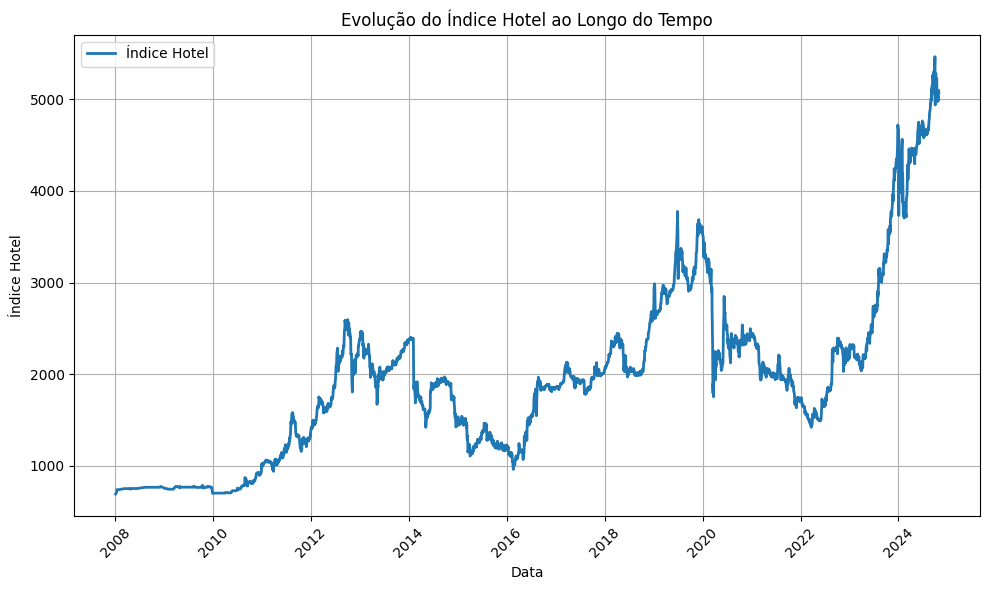

In [61]:
# Remover valores NaN anteriores ao primeiro valor válido
indice_hotel = indice_hotel[indice_hotel.first_valid_index():]

# Plotar o índice Hotel
plt.figure(figsize=(10, 6))
plt.plot(indice_hotel.index, indice_hotel, label="Índice Hotel", linewidth=2)
plt.xlabel("Data")
plt.ylabel("Índice Hotel")
plt.title("Evolução do Índice Hotel ao Longo do Tempo")
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()  # Ajusta layout para exibição clara
plt.show()


### Outros

Outros: Categoria diversa que abrange FIIs que não se enquadram nas classificações anteriores, como propriedades especializadas ou setores de nicho.

In [62]:
# Filtro Outros

# Filtrando o cadastro para incluir apenas ativos com foco de atuação "Outros"
df_cadastro_outros = df_cadastro_filtrado.loc[
    df_cadastro_filtrado['Foco_de_Atuacao'] == 'Outros', ['Codigo']
]

# Extraindo os códigos dos ativos Outros
codigos_outros = df_cadastro_outros['Codigo'].unique()

# Filtrando df_retorno para incluir apenas os códigos Outros
df_retorno_outros = df_retorno_filtrado.loc[:, df_retorno_filtrado.columns.isin(codigos_outros)]

# Filtrando df_valor_mercado para incluir apenas os códigos Outros
df_valor_mercado_outros = df_valor_mercado_filtrado.loc[:, df_valor_mercado_filtrado.columns.isin(codigos_outros)]

# Excluir linhas onde todas as colunas são NaN em ambos os DataFrames
df_retorno_outros = df_retorno_outros.dropna(how='all')
df_valor_mercado_outros = df_valor_mercado_outros.dropna(how='all')

# Encontrar as datas (índices) comuns entre os dois DataFrames
datas_comuns = df_retorno_outros.index.intersection(df_valor_mercado_outros.index)

# Filtrar ambos os DataFrames para conter apenas as datas comuns
df_retorno_outros = df_retorno_outros.loc[datas_comuns]
df_valor_mercado_outros = df_valor_mercado_outros.loc[datas_comuns]

# Exibir os DataFrames para verificação
print("df_retorno_outros com datas comuns:\n", df_retorno_outros)
print("df_valor_mercado_outros com datas comuns:\n", df_valor_mercado_outros)

df_retorno_outros com datas comuns:
               KNIP11    IRDM11    KNUQ11    HFOF11    VGIR11    MCCI11  \
Data                                                                     
2024-10-29  0.360735  0.590551 -0.229555  0.062208  1.452282  1.574803   
2024-10-28 -0.673181  0.045448  1.495000  2.880000  1.473684  0.668813   
2024-10-25  0.578792  0.045468  0.048563  0.016003  0.529101 -0.012384   
2024-10-24  0.262783  1.711115 -0.038835 -0.207601 -0.211193  0.323021   
2024-10-23 -0.511983 -0.810398  0.000000 -0.917722 -1.044932 -1.541284   
...              ...       ...       ...       ...       ...       ...   
2005-07-27       NaN       NaN       NaN       NaN       NaN       NaN   
2005-07-26       NaN       NaN       NaN       NaN       NaN       NaN   
2005-07-25       NaN       NaN       NaN       NaN       NaN       NaN   
2005-07-22       NaN       NaN       NaN       NaN       NaN       NaN   
2005-07-19       NaN       NaN       NaN       NaN       NaN       NaN   



In [63]:
# Passo 1: Calcular os pesos diários com base no valor de mercado, somando para normalização
pesos_diarios_outros = df_valor_mercado_outros.div(df_valor_mercado_outros.sum(axis=1), axis=0)

# Passo 2: Calcular o retorno ponderado diário de cada ativo
df_retorno_ponderado_outros = df_retorno_outros * pesos_diarios_outros

# Passo 3: Calcular o retorno total diário do índice somando as linhas de df_retorno_ponderado_outros
retorno_outros = df_retorno_ponderado_outros.sum(axis=1)

# Garantir que o índice de 'retorno_outros' está ordenado cronologicamente e em formato datetime
retorno_outros = retorno_outros.sort_index()
retorno_outros.index = pd.to_datetime(retorno_outros.index)

# Passo 4: Calcular o fator percentual do retorno total diário
fator_percentual_diario_outros = 1 + (retorno_outros / 100)
# print(fator_percentual_diario_outros)

# Passo 5: Construir o índice Outros partindo de um valor inicial de 1000 em 30/12/2010

# Definir a data base e o valor inicial do índice
data_base = pd.to_datetime('2010-12-30')
valor_inicial = 1000

# Verificar se a data base existe no índice, caso contrário, inserir a data base manualmente com retorno zero
if data_base not in retorno_outros.index:
    retorno_outros.loc[data_base] = 0  # Adicionar a data base com retorno zero
    retorno_outros = retorno_outros.sort_index()  # Reordenar o índice

# Calcular o fator percentual do retorno total diário
fator_percentual_diario_outros = 1 + (retorno_outros / 100)

# Verificar novamente após a inserção da data base
if data_base in retorno_outros.index:
    # Calcular o índice Outros para dias posteriores (a partir da data base)
    posteriores = fator_percentual_diario_outros.loc[data_base:].cumprod() * valor_inicial

    # Calcular o índice Outros para dias anteriores (antes da data base)
    anteriores = (1 / fator_percentual_diario_outros.loc[:data_base][::-1]).cumprod()[::-1] * valor_inicial

    # Concatenar e ordenar para obter o índice acumulado completo, em ordem cronológica decrescente
    indice_outros = pd.concat([anteriores, posteriores]).sort_index(ascending=False)

    # Definir o nome da coluna para o índice Outros
    indice_outros.name = 'indice_outros'

    # Exibir o índice Outros em ordem cronológica decrescente
    print("Índice Outros:\n", indice_outros)
else:
    print("A data base ainda não foi encontrada no índice após a tentativa de inserção.")


Índice Outros:
 Data
2024-10-29    6790.013230
2024-10-28    6768.556800
2024-10-25    6746.482796
2024-10-24    6724.742694
2024-10-23    6726.714654
                 ...     
2005-07-27     360.561755
2005-07-26     362.929859
2005-07-25     362.391653
2005-07-22     361.566405
2005-07-19     360.143837
Name: indice_outros, Length: 4517, dtype: float64


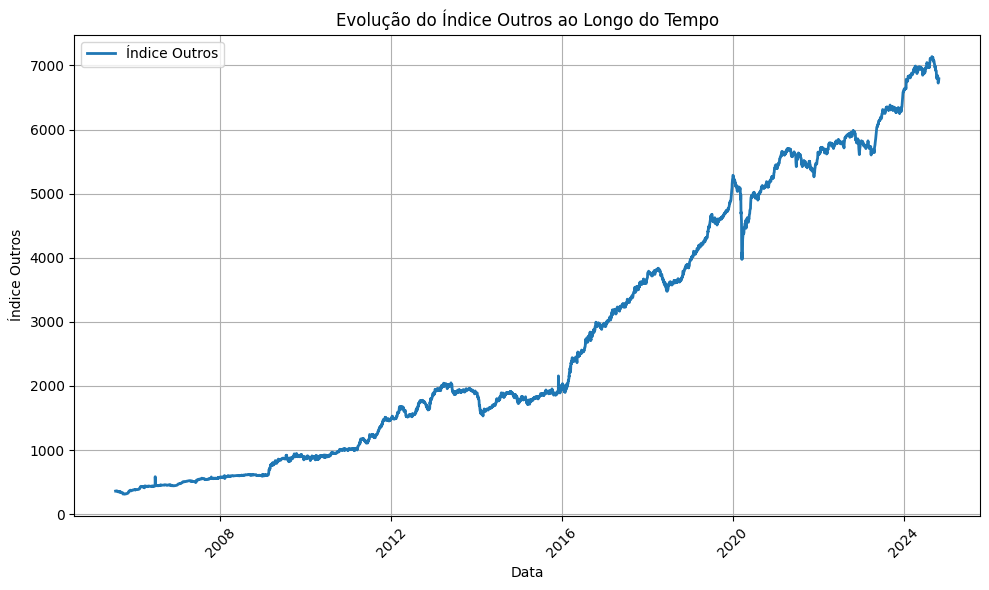

In [64]:
# Remover valores NaN anteriores ao primeiro valor válido
indice_outros = indice_outros[indice_outros.first_valid_index():]

# Plotar o índice Outros
plt.figure(figsize=(10, 6))
plt.plot(indice_outros.index, indice_outros, label="Índice Outros", linewidth=2)
plt.xlabel("Data")
plt.ylabel("Índice Outros")
plt.title("Evolução do Índice Outros ao Longo do Tempo")
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()  # Ajusta layout para exibição clara
plt.show()


## 3.6. Dataframe de retornos por atuação

In [65]:
# Dataframe de retornos por atuação
df_retorno_consolidado = pd.DataFrame({
    'Retorno_IFIX': retorno_ifix,
    'Retorno_Indice_Geral': retorno_indice_geral,
    'Retorno_Residencial': retorno_residencial,
    'Retorno_Hibrido': retorno_hibrido,
    'Retorno_Multicategoria': retorno_multicategoria,
    'Retorno_TVM': retorno_tvm,
    'Retorno_Logistica': retorno_logistica,
    'Retorno_Shoppings': retorno_shoppings,
    'Retorno_Lajes_Corporativas': retorno_lajes_corporativas,
    'Retorno_Educacional': retorno_educacional,
    'Retorno_Hospital': retorno_hospital,
    'Retorno_Agencias': retorno_agencias,
    'Retorno_Hotel': retorno_hotel,
    'Retorno_Outros': retorno_outros
}).dropna(how='all')  # Remove linhas com NaN em todas as colunas

## 3.7. Estatísticas por atuação

In [66]:
# Exibir as estatísticas descritivas para cada coluna
print("Estatísticas Descritivas dos Retornos Consolidados:")
print(df_retorno_consolidado.describe())


Estatísticas Descritivas dos Retornos Consolidados:
       Retorno_IFIX  Retorno_Indice_Geral  Retorno_Residencial  \
count   3608.000000           4840.000000          2286.000000   
mean       0.033417              0.049440             0.080918   
std        0.483940              0.472321             1.625528   
min      -13.230196            -11.990546           -13.011322   
25%       -0.140870             -0.120122            -0.399554   
50%        0.012027              0.034835             0.000000   
75%        0.219154              0.219869             0.557392   
max        5.821873              8.264218            15.758188   

       Retorno_Hibrido  Retorno_Multicategoria  Retorno_TVM  \
count      3567.000000             1542.000000  3479.000000   
mean          0.065833                0.050313     0.051706   
std           1.073588                0.837165     0.705361   
min         -12.336170              -12.242667   -11.248374   
25%          -0.212072               -

## 3.8. Gráfico de Distribuição

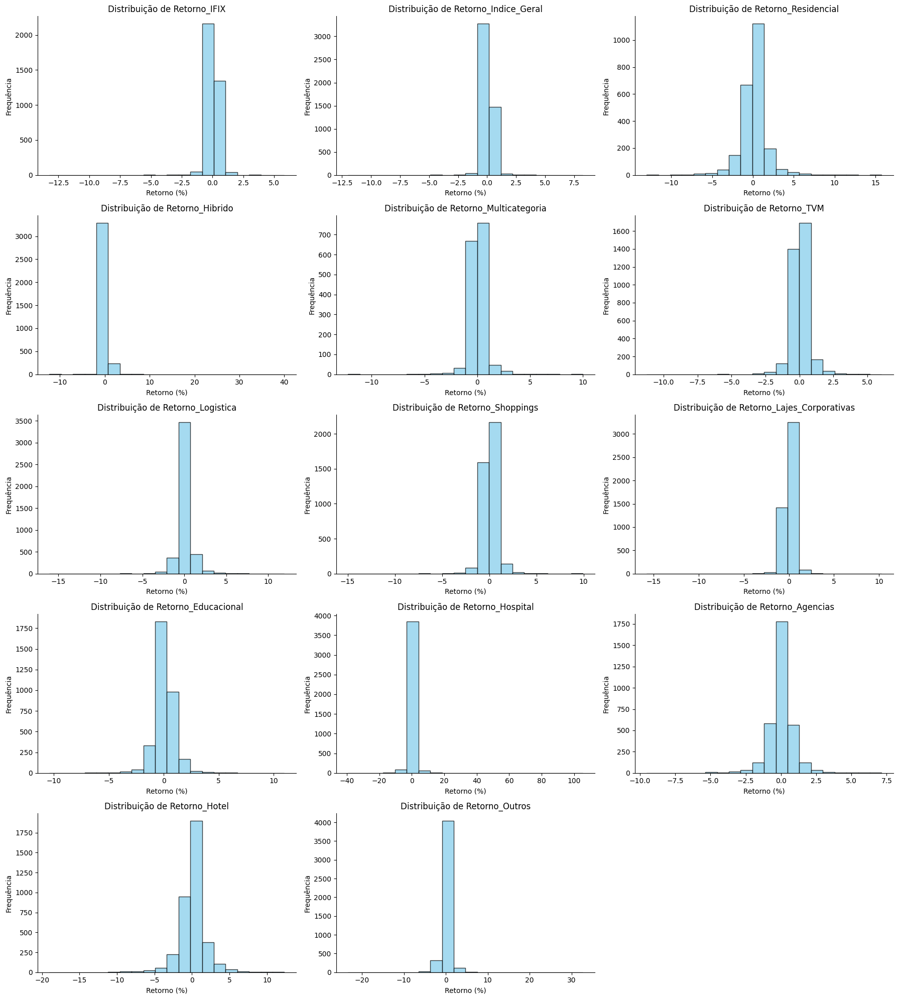

In [67]:

# Definir o número de colunas e calcular o número de linhas necessárias
num_colunas = 3
num_graficos = len(df_retorno_consolidado.columns)
num_linhas = math.ceil(num_graficos / num_colunas)

# Configurações gerais para o layout dos gráficos
fig, axes = plt.subplots(nrows=num_linhas, ncols=num_colunas, figsize=(18, num_linhas * 4))
axes = axes.flatten()  # Achata o array de eixos para iteração

# Iterar sobre as colunas do DataFrame consolidado de retornos e os eixos do gráfico
for i, (coluna, dados) in enumerate(df_retorno_consolidado.items()):
    axes[i].hist(dados.dropna(), bins=20, alpha=0.75, color='skyblue', edgecolor='black')
    axes[i].set_title(f'Distribuição de {coluna}')
    axes[i].set_xlabel('Retorno (%)')
    axes[i].set_ylabel('Frequência')
    axes[i].spines['top'].set_visible(False)
    axes[i].spines['right'].set_visible(False)

# Esconder eixos extras caso o número de gráficos não seja múltiplo de num_colunas
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Ajustar o layout para melhor visualização
plt.tight_layout()
plt.show()


## 3.9. Gráfico de Série Temporal

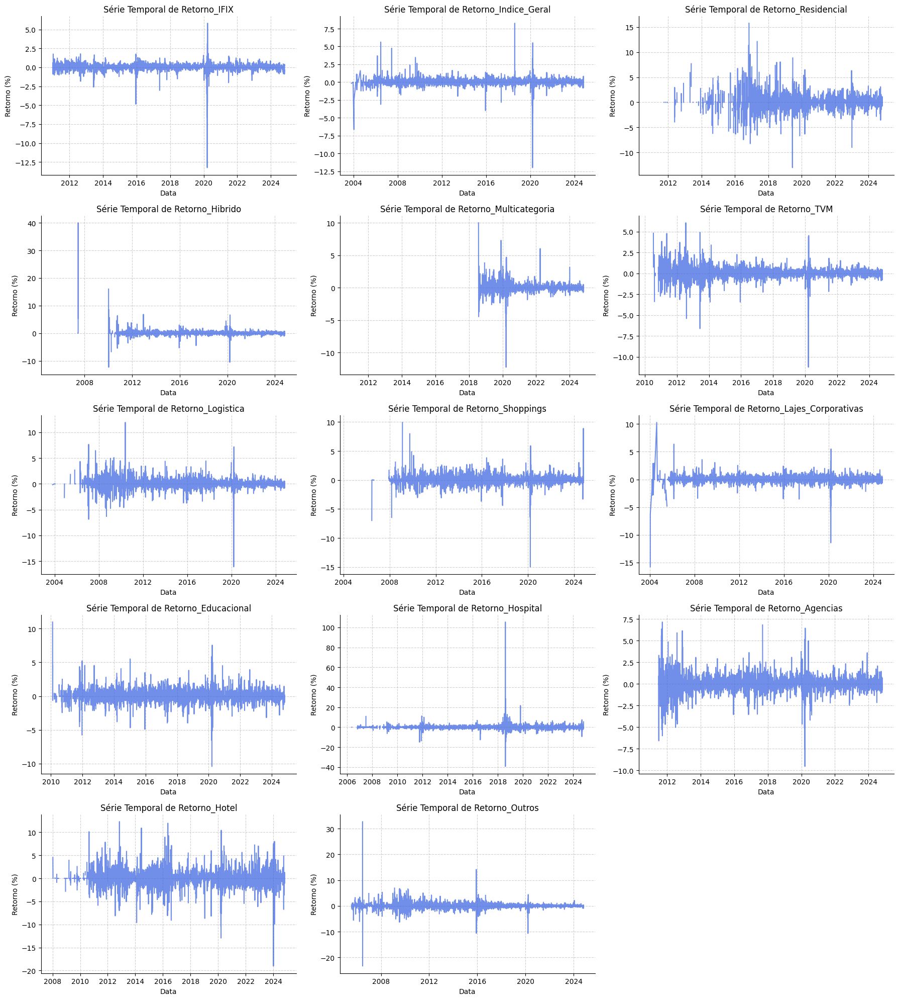

In [68]:

# Definir o número de colunas e calcular o número de linhas necessárias
num_colunas = 3
num_graficos = len(df_retorno_consolidado.columns)
num_linhas = math.ceil(num_graficos / num_colunas)

# Configurações gerais para o layout dos gráficos
fig, axes = plt.subplots(nrows=num_linhas, ncols=num_colunas, figsize=(18, num_linhas * 4))
axes = axes.flatten()  # Achata o array de eixos para iteração

# Iterar sobre as colunas do DataFrame consolidado de retornos e os eixos do gráfico
for i, (coluna, dados) in enumerate(df_retorno_consolidado.items()):
    axes[i].plot(dados.index, dados, alpha=0.75, color='royalblue', linewidth=1.5)
    axes[i].set_title(f'Série Temporal de {coluna}')
    axes[i].set_xlabel('Data')
    axes[i].set_ylabel('Retorno (%)')
    axes[i].spines['top'].set_visible(False)
    axes[i].spines['right'].set_visible(False)
    axes[i].grid(True, linestyle='--', alpha=0.6)

# Esconder eixos extras caso o número de gráficos não seja múltiplo de num_colunas
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Ajustar o layout para melhor visualização
plt.tight_layout()
plt.show()


## 3.12. Decomposição das séries

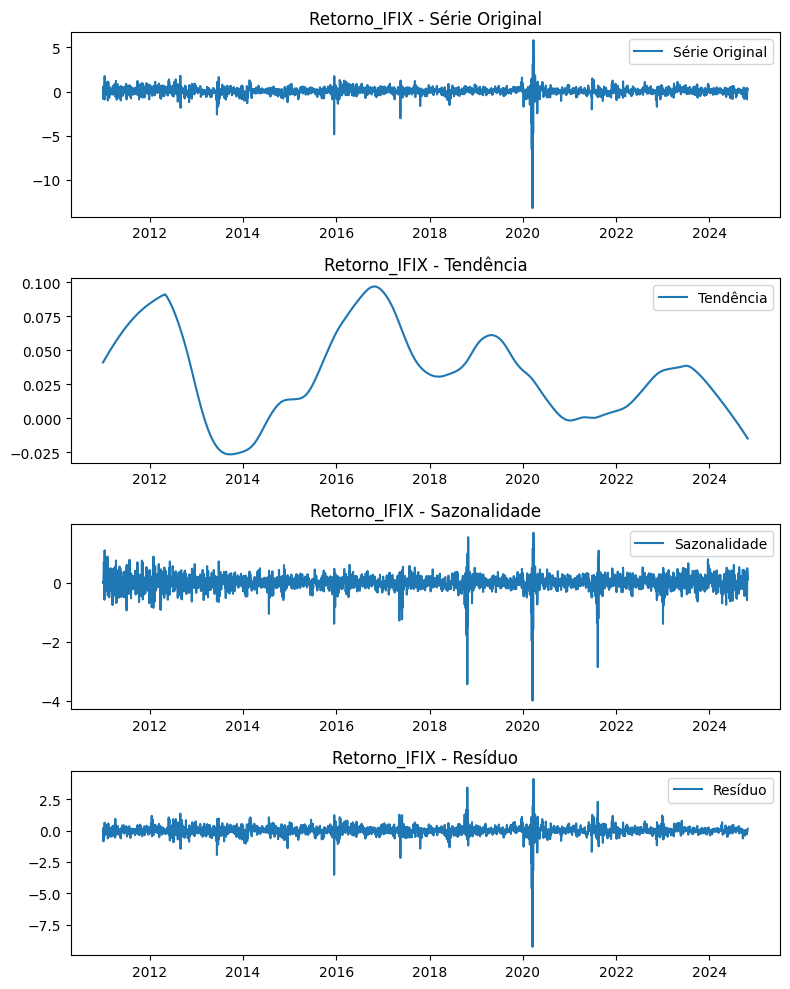

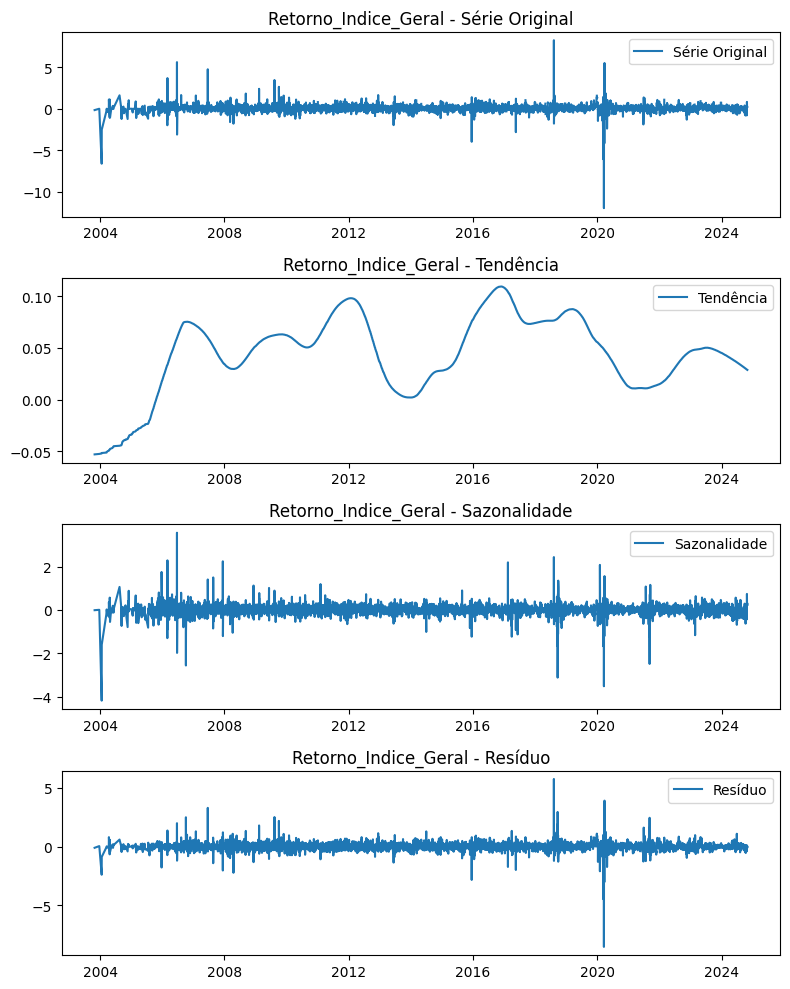

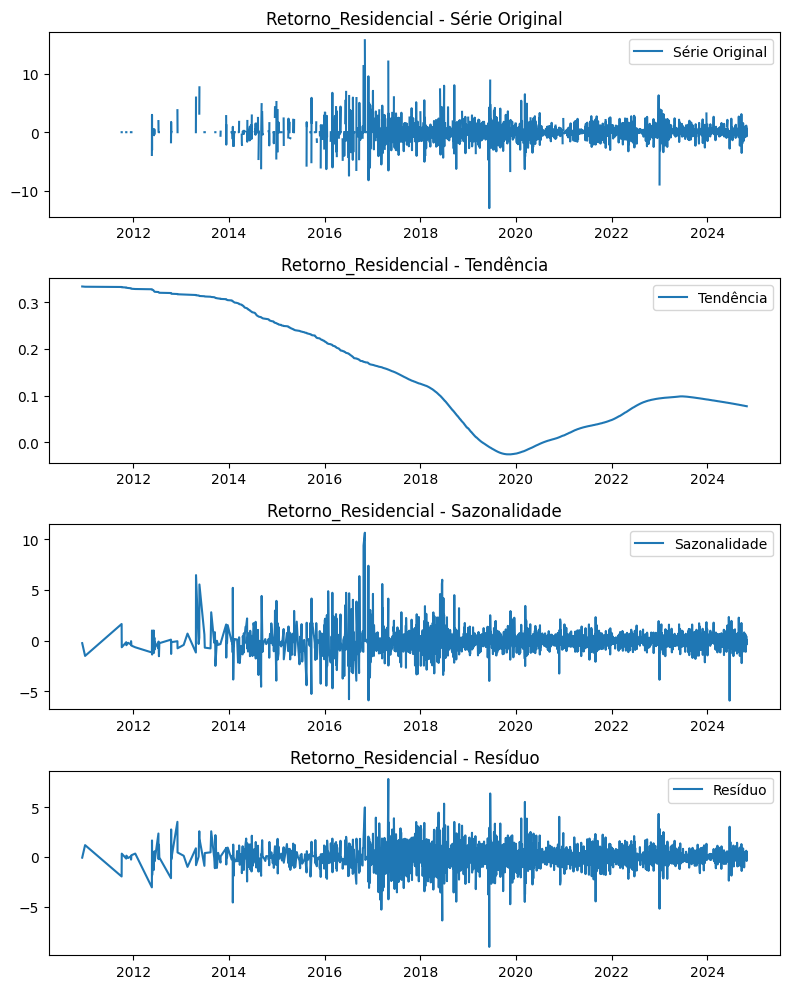

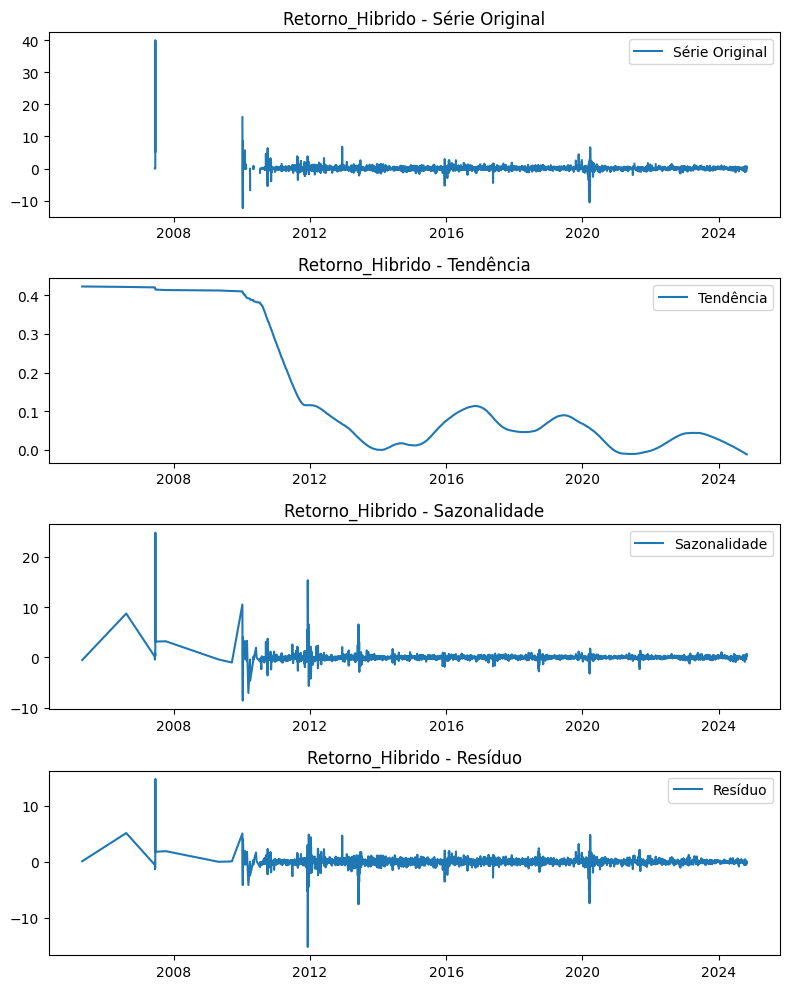

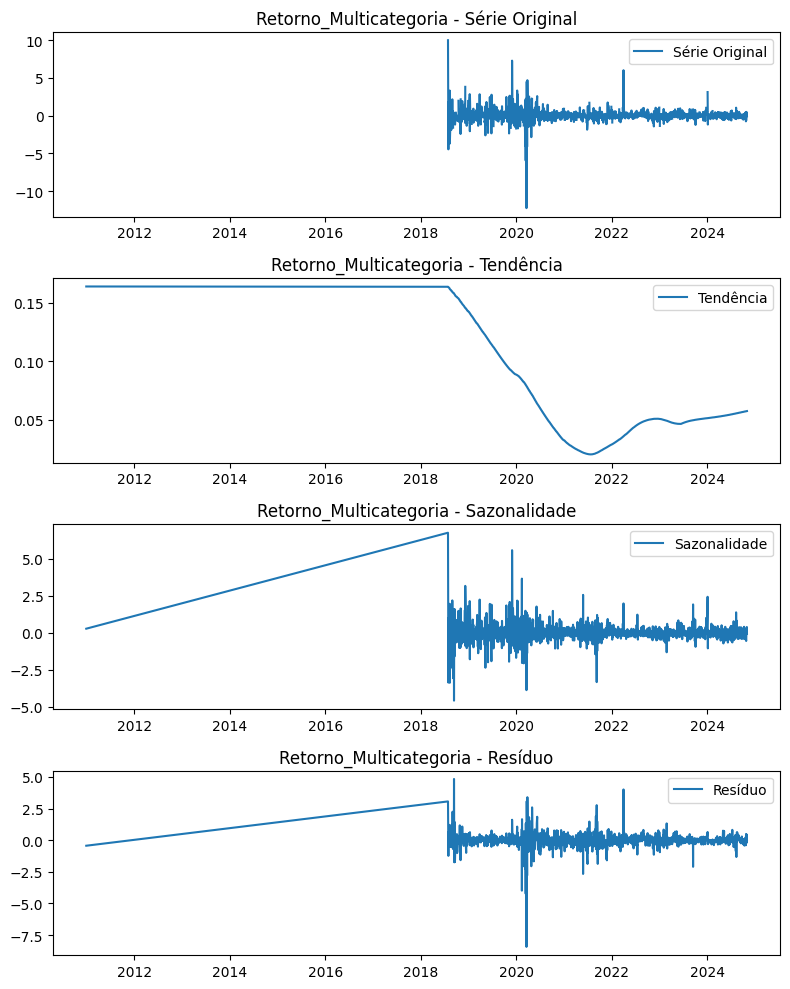

...

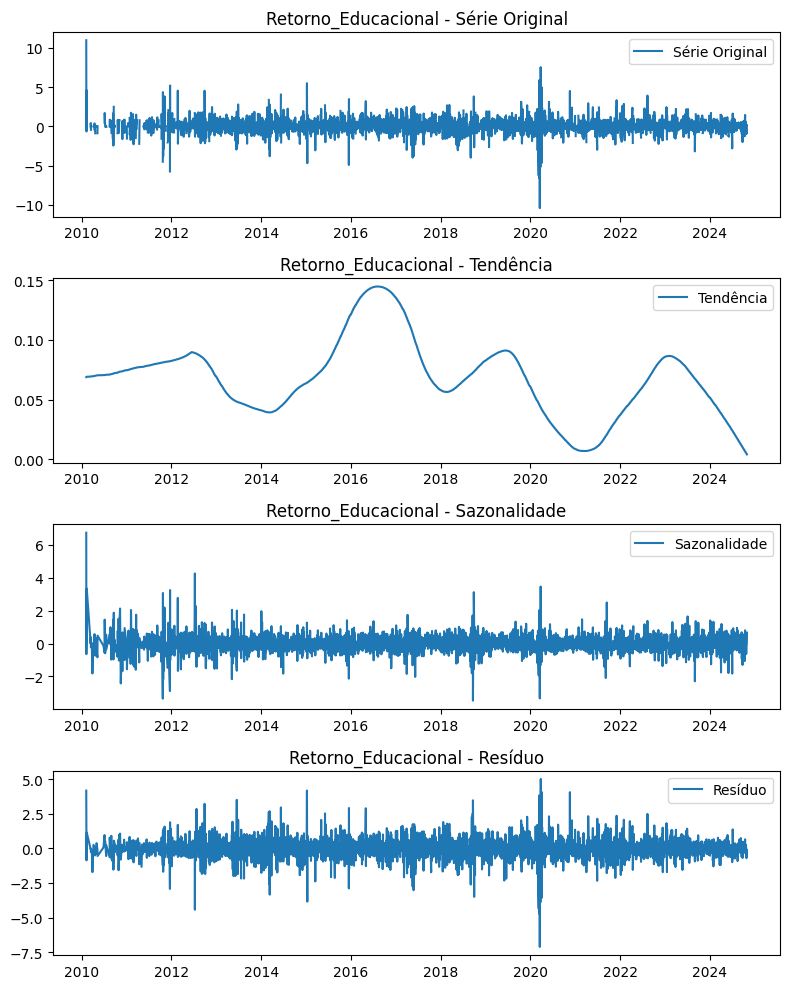

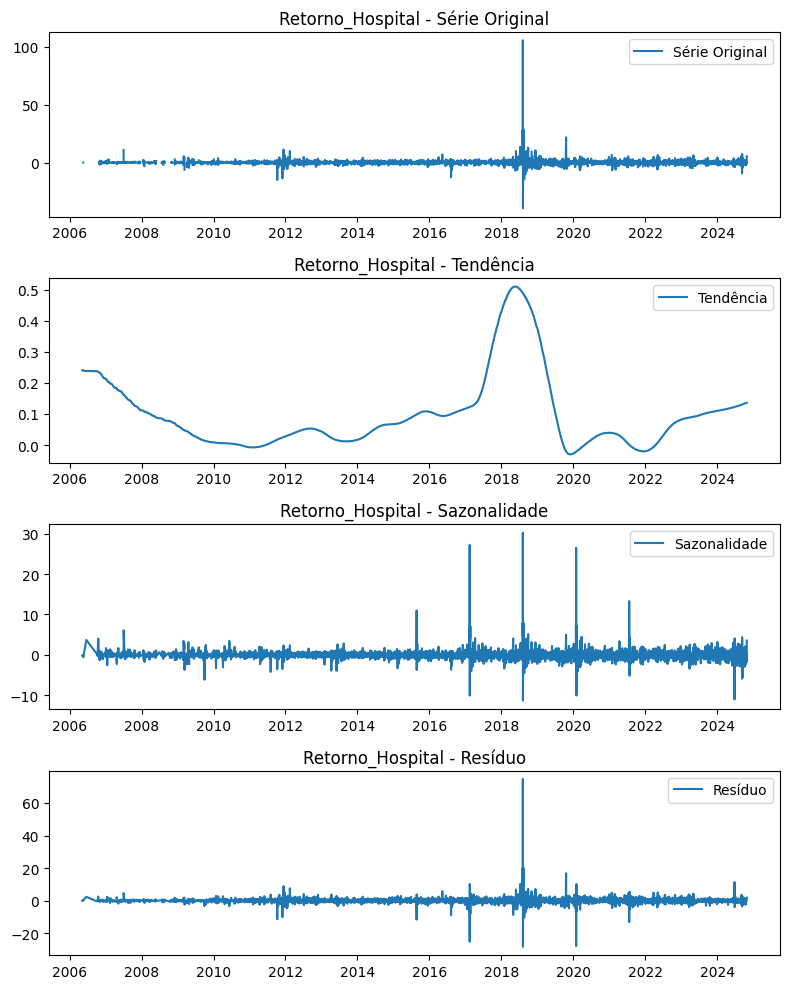

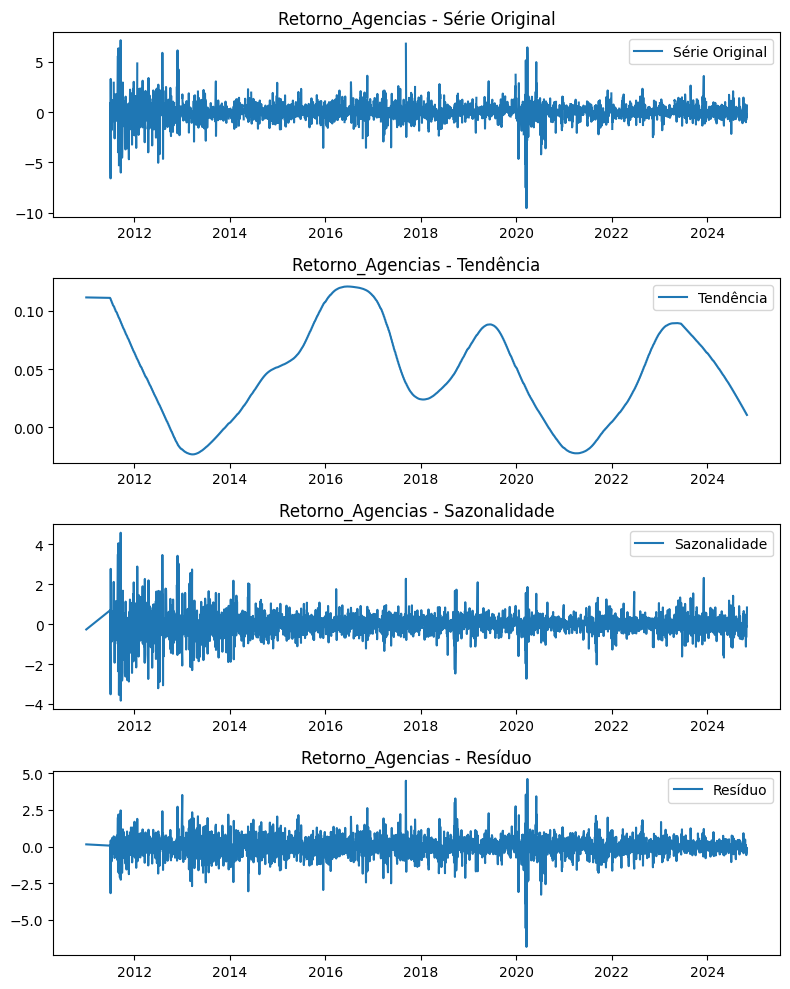

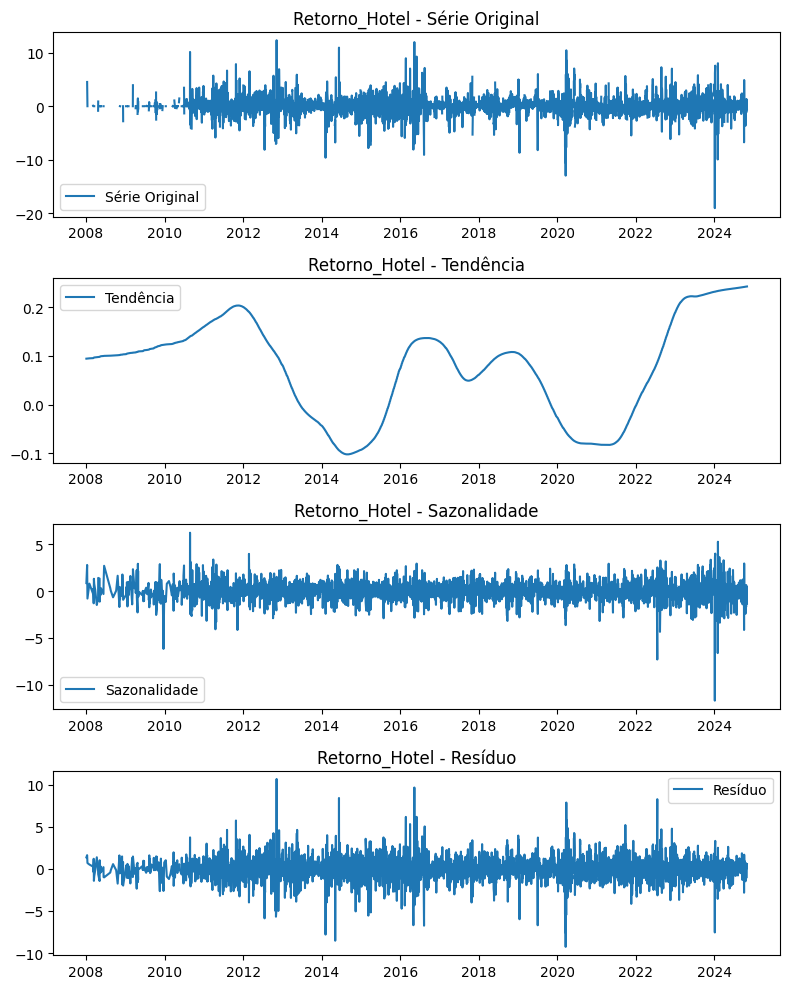

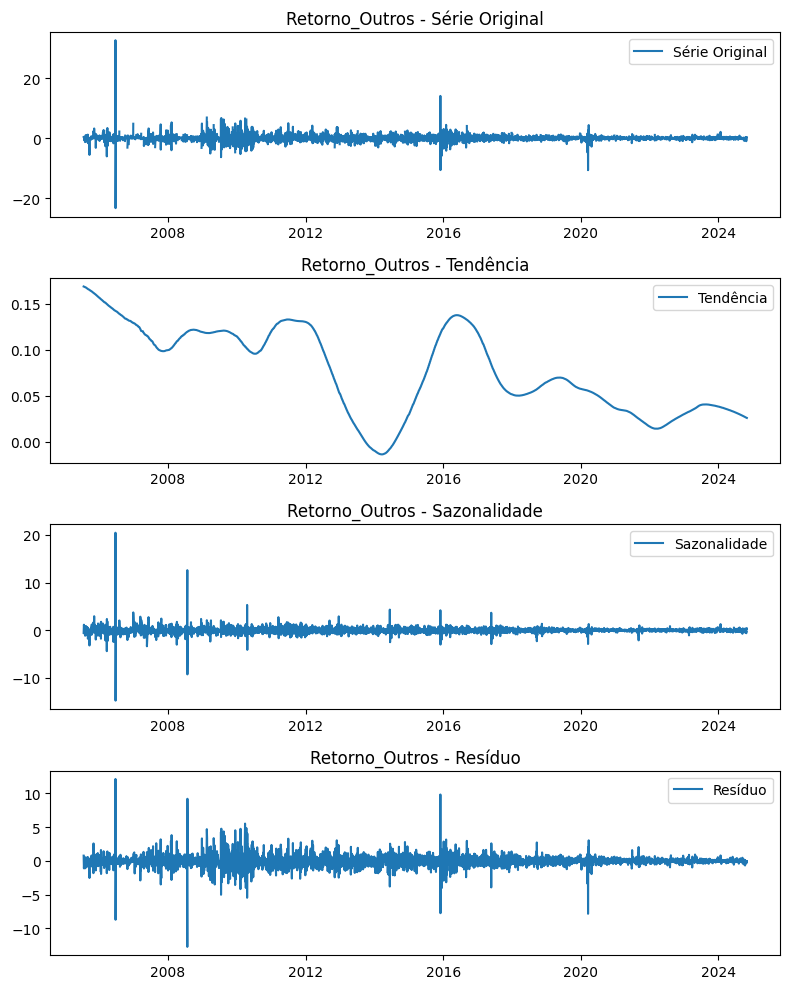

In [69]:
# Definir função para decomposição da série de retorno consolidado
def decompor_serie_temporal(serie, nome_serie, period=365):
    stl = STL(serie.dropna(), period=period)
    resultado = stl.fit()
    sazonal, tendencia, residuo = resultado.seasonal, resultado.trend, resultado.resid

    # Plotar os componentes
    plt.figure(figsize=(8, 10))
    plt.subplot(4, 1, 1)
    plt.plot(serie, label='Série Original')
    plt.title(f'{nome_serie} - Série Original', fontsize=12)
    plt.legend()

    plt.subplot(4, 1, 2)
    plt.plot(tendencia, label='Tendência')
    plt.title(f'{nome_serie} - Tendência', fontsize=12)
    plt.legend()

    plt.subplot(4, 1, 3)
    plt.plot(sazonal, label='Sazonalidade')
    plt.title(f'{nome_serie} - Sazonalidade', fontsize=12)
    plt.legend()

    plt.subplot(4, 1, 4)
    plt.plot(residuo, label='Resíduo')
    plt.title(f'{nome_serie} - Resíduo', fontsize=12)
    plt.legend()

    plt.tight_layout()
    plt.show()

# Aplicar a função a cada série de retorno no DataFrame de retornos consolidados
for coluna in df_retorno_consolidado.columns:
    decompor_serie_temporal(df_retorno_consolidado[coluna], coluna, period=365)


A tendência revela padrões de longo prazo na série. Observa-se uma variação cíclica, com um crescimento suave até meados de 2017 e uma queda subsequente até aproximadamente 2024. Isso sugere períodos de valorização e desvalorização possivelmente associados a fatores econômicos mais amplos.

O componente sazonal indica variações repetitivas na série com intervalos fixos, relacionadas a ciclos ou fatores sazonais. A sazonalidade não é muito clara.

A série residual ainda apresenta bastante volatilidade, indicando que existem fatores não explicados pela sazonalidade ou tendência que estão influenciando o comportamento da série.

Característica do mercado imobiliário: ciclos longos O Mercado financeiro teria essa caracterísitca também?

## **3.13. Comparação da Série Estimada x Observada**

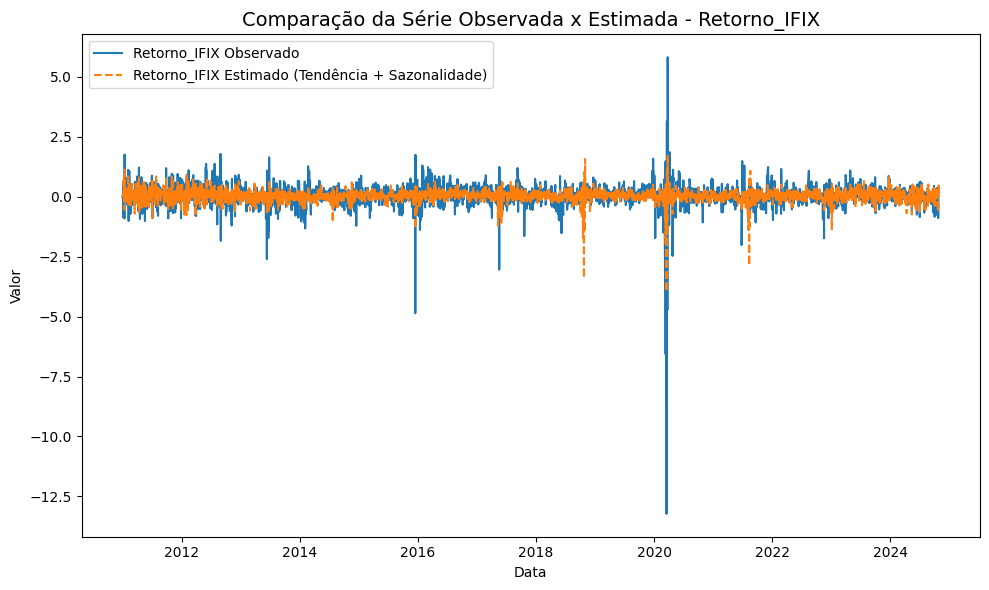

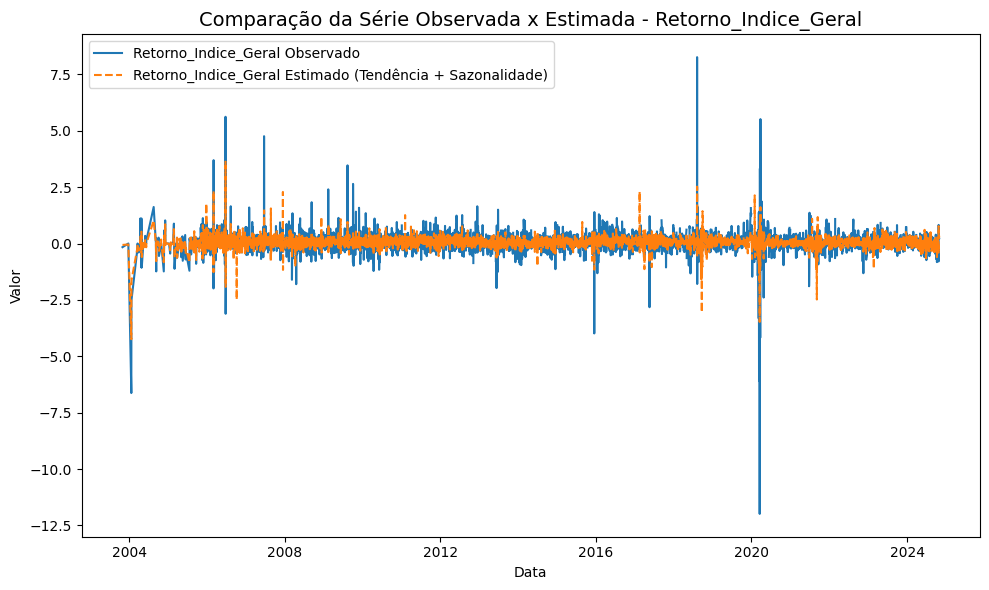

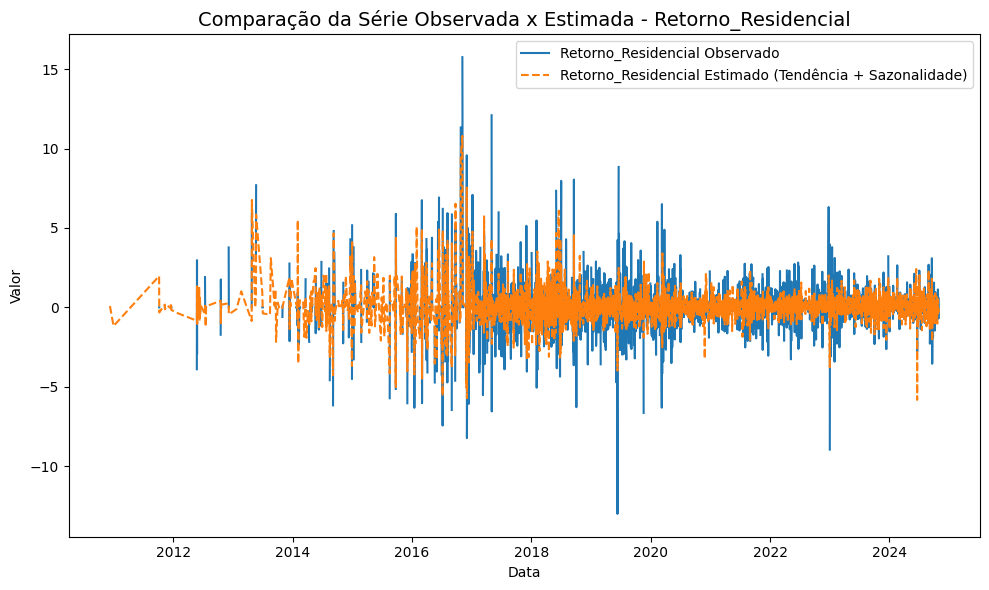

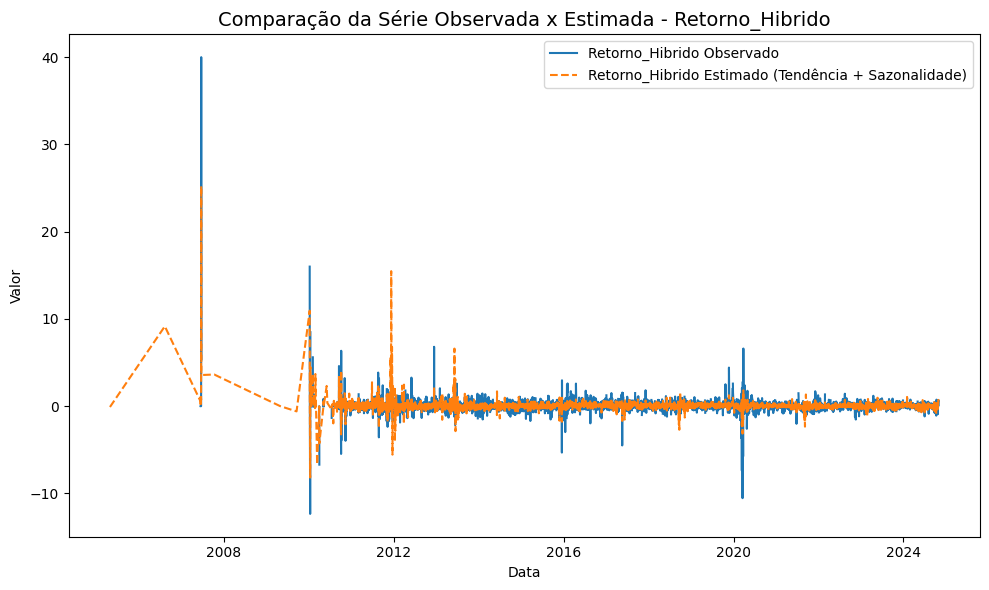

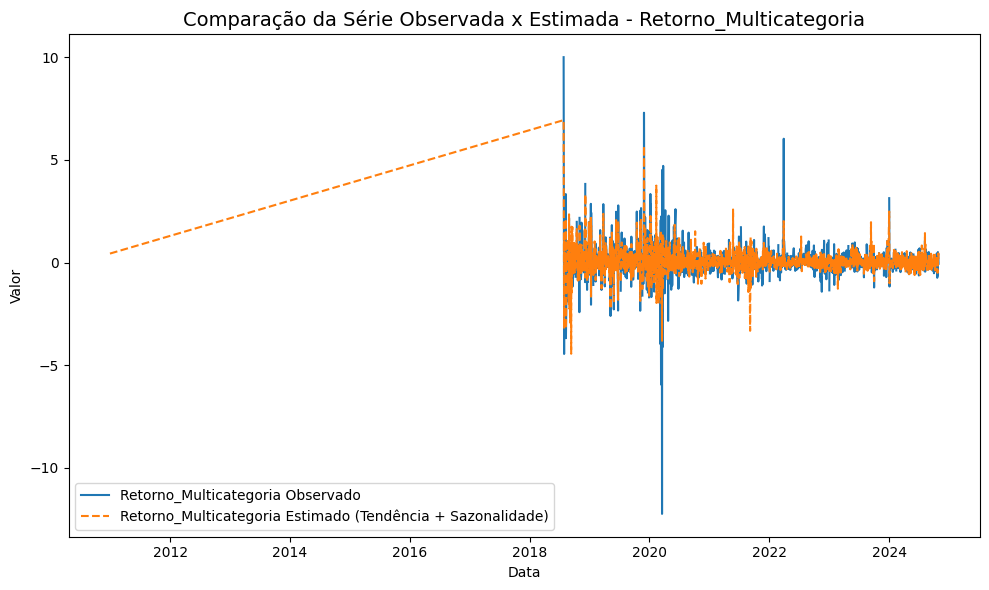

...

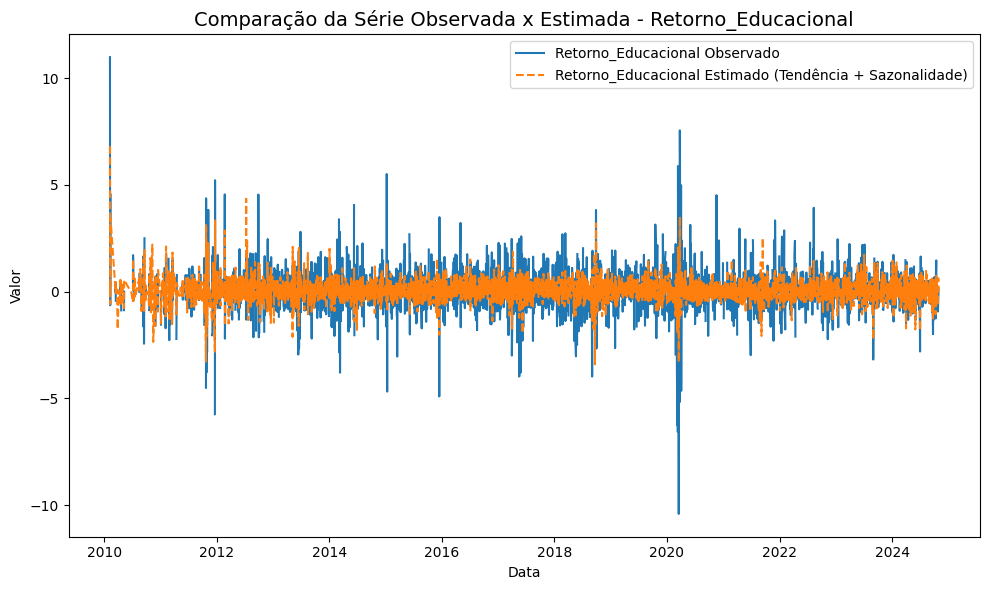

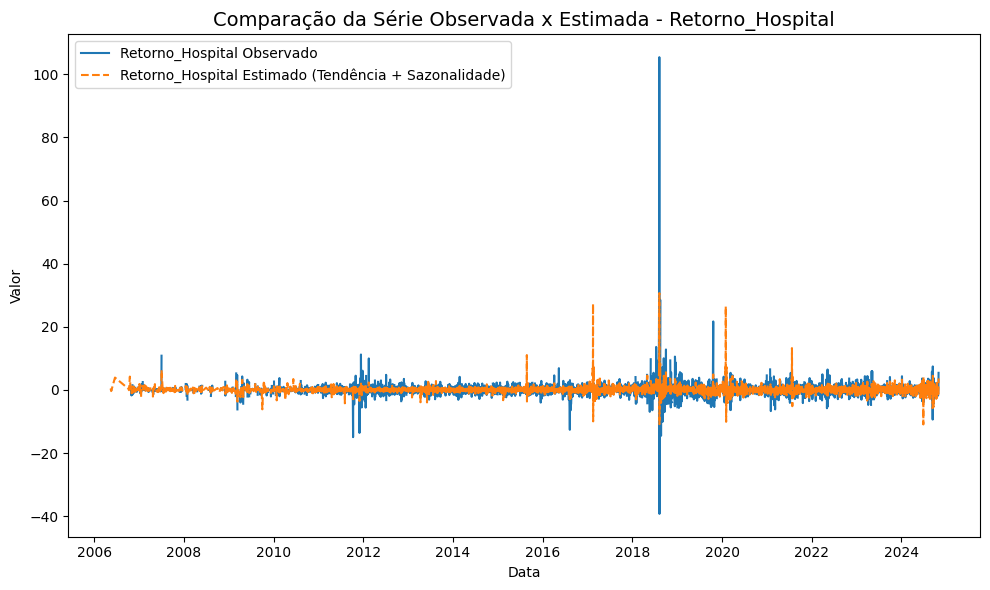

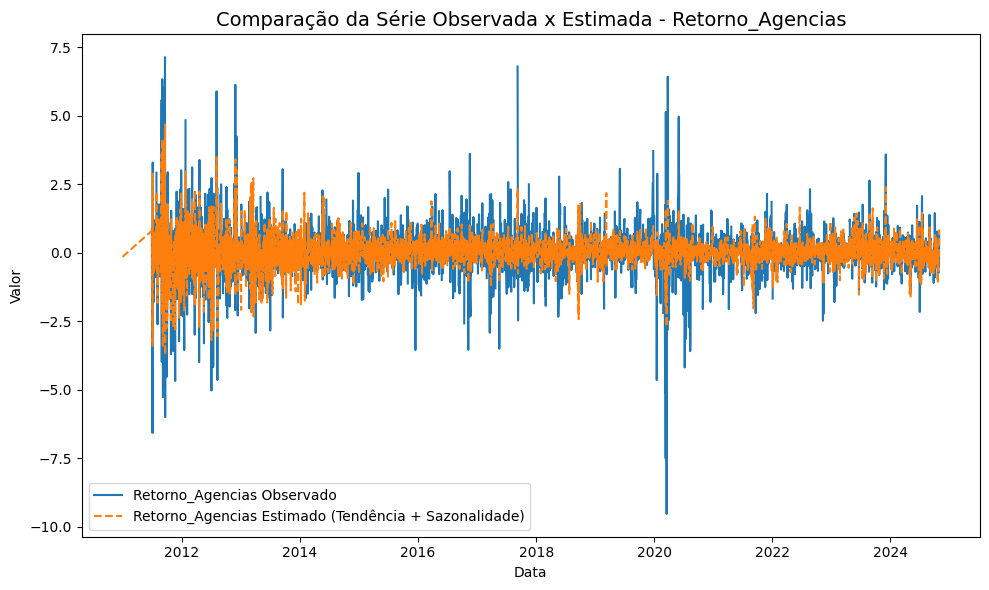

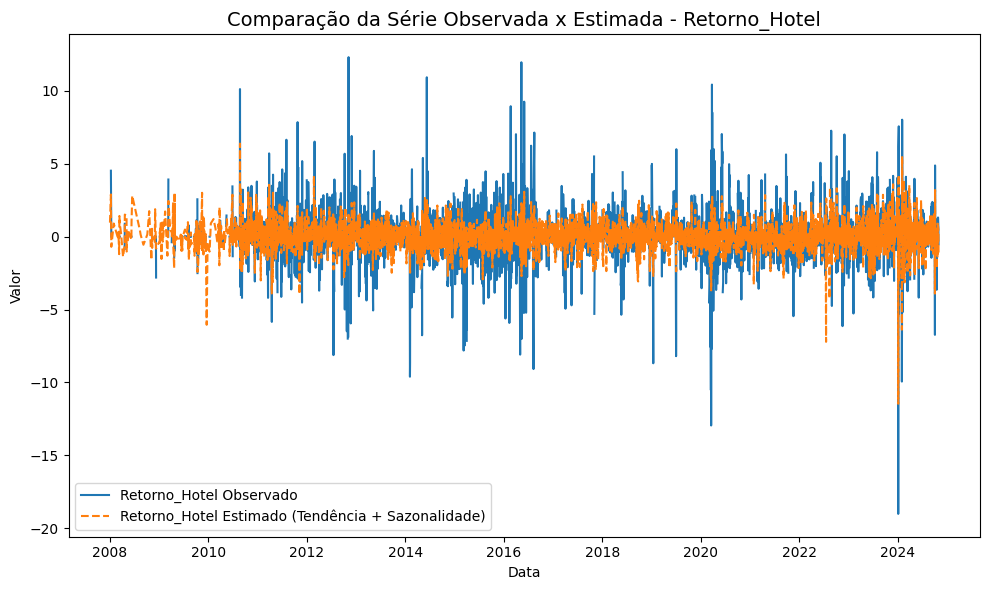

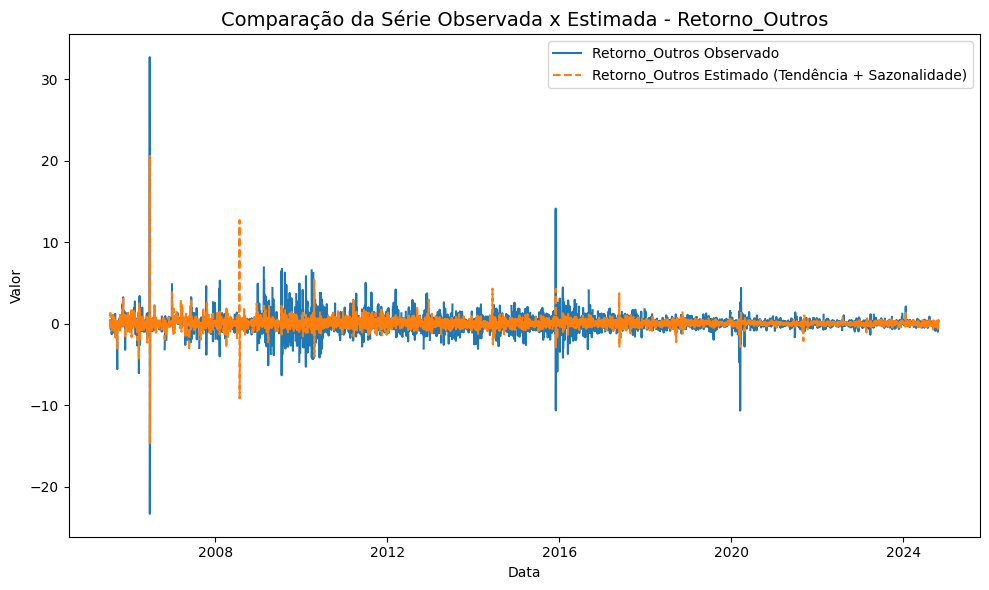

In [70]:
# Função para comparar série estimada x observada
def comparar_serie_estimada_observada(serie, nome_serie, period=365):
    # Realizar a decomposição da série temporal
    stl = STL(serie.dropna(), period=period)
    resultado = stl.fit()
    sazonal, tendencia = resultado.seasonal, resultado.trend

    # Série estimada como soma da tendência e sazonalidade
    estimado = tendencia + sazonal

    # Plotar as séries
    plt.figure(figsize=(10, 6))
    plt.plot(serie, label=f'{nome_serie} Observado', linewidth=1.5)
    plt.plot(estimado, label=f'{nome_serie} Estimado (Tendência + Sazonalidade)', linestyle='--')

    # Personalizações do gráfico
    plt.title(f'Comparação da Série Observada x Estimada - {nome_serie}', fontsize=14)
    plt.xlabel('Data')
    plt.ylabel('Valor')
    plt.legend()
    plt.tight_layout()
    plt.show()

# Aplicar a função a cada série de retorno no DataFrame de retornos consolidados
for coluna in df_retorno_consolidado.columns:
    comparar_serie_estimada_observada(df_retorno_consolidado[coluna], coluna, period=365)


## 3.14. Transformação logarítmica

O código aplica uma transformação logarítmica ajustada em diversas séries de retornos financeiros para lidar com valores negativos e zero, facilitando o uso do logaritmo. Ele começa armazenando todas as séries de retorno em um dicionário series_dict para facilitar o processamento. Em seguida, para cada série, o código identifica o menor valor, calcula o módulo desse valor somado a 1, e usa esse valor para ajustar todos os pontos da série (somando esse valor a cada ponto) antes de aplicar a transformação logarítmica. A série transformada é então armazenada em um novo dicionário series_transformadas e é exibida junto com gráficos e estatísticas descritivas para analisar as transformações realizadas em todas as séries.


Estatísticas descritivas para as séries transformadas (Log com Ajuste):
                                 count      mean       std  min       25%  \
Retorno_IFIX_log                3608.0  2.656751  0.054370  0.0  2.645417   
Retorno_Indice_Geral_log        4840.0  2.567099  0.050565  0.0  2.554932   
Retorno_Residencial_log         2286.0  2.638288  0.129248  0.0  2.610935   
Retorno_Hibrido_log             3567.0  2.592482  0.083465  0.0  2.574450   
Retorno_Multicategoria_log      1542.0  2.584508  0.087371  0.0  2.566937   
Retorno_TVM_log                 3479.0  2.507583  0.070836  0.0  2.487327   
Retorno_Logistica_log           4421.0  2.840344  0.066813  0.0  2.823659   
Retorno_Shoppings_log           4032.0  2.772224  0.064309  0.0  2.756279   
Retorno_Lajes_Corporativas_log  4810.0  2.821724  0.055706  0.0  2.808393   
Retorno_Educacional_log         3416.0  2.436162  0.093221  0.0  2.402294   
Retorno_Hospital_log            4005.0  3.695767  0.075748  0.0  3.683532   
Ret

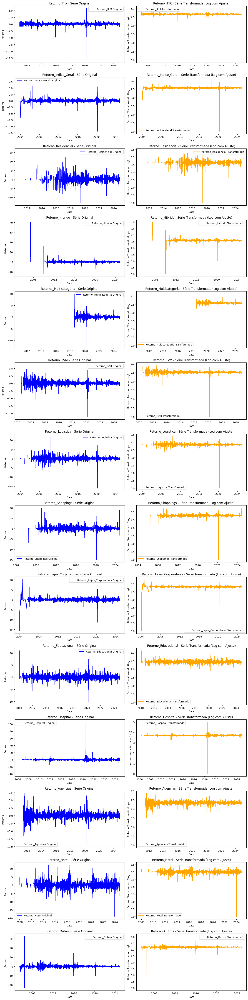

In [71]:
# Função para aplicar a transformação de log com ajuste
def aplicar_log_transformacao(serie):
    # Identificar o menor valor da série
    menor_valor = serie.min()

    # Calcular o valor para ajustar a série: 1 + |menor valor|
    ajuste = 1 + abs(menor_valor)

    # Somar o valor de ajuste a todos os valores da série
    serie_ajustada = serie + ajuste

    # Aplicar o logaritmo à série ajustada
    serie_log_transformada = np.log(serie_ajustada)

    return serie_log_transformada

# DataFrame para armazenar as séries transformadas
df_retorno_log = pd.DataFrame()

# Iterar sobre cada coluna de `df_retorno_consolidado` e aplicar a transformação
for nome_serie in df_retorno_consolidado.columns:
    # Aplicar a transformação de log
    serie_transformada = aplicar_log_transformacao(df_retorno_consolidado[nome_serie])

    # Armazenar a série transformada no DataFrame `df_retorno_log`
    df_retorno_log[f'{nome_serie}_log'] = serie_transformada

# DataFrame para armazenar as estatísticas descritivas de todas as séries transformadas
estatisticas_transformadas = df_retorno_log.describe().T

# Exibir as estatísticas descritivas consolidadas
print("\nEstatísticas descritivas para as séries transformadas (Log com Ajuste):")
print(estatisticas_transformadas)

# Configurar layout dos subplots com duas colunas (original e transformada lado a lado)
num_series = len(df_retorno_consolidado.columns)
fig, axes = plt.subplots(nrows=num_series, ncols=2, figsize=(14, 4 * num_series))
fig.tight_layout(pad=4.0)

# Loop para plotar cada série original e sua transformação
for i, nome_serie in enumerate(df_retorno_consolidado.columns):
    # Série original na coluna da esquerda
    axes[i, 0].plot(df_retorno_consolidado.index, df_retorno_consolidado[nome_serie], label=f'{nome_serie} Original', color='blue')
    axes[i, 0].set_title(f"{nome_serie} - Série Original")
    axes[i, 0].set_ylabel("Retorno")
    axes[i, 0].set_xlabel("Data")
    axes[i, 0].legend()

    # Série transformada (log) na coluna da direita
    serie_log = df_retorno_log[f'{nome_serie}_log']
    axes[i, 1].plot(serie_log.index, serie_log, label=f'{nome_serie} Transformado', color='orange')
    axes[i, 1].set_title(f"{nome_serie} - Série Transformada (Log com Ajuste)")
    axes[i, 1].set_ylabel("Retorno Transformado (Log)")
    axes[i, 1].set_xlabel("Data")
    axes[i, 1].legend()

plt.tight_layout()
plt.show()


In [72]:
df_retorno_log

,Retorno_IFIX_log,Retorno_Indice_Geral_log,Retorno_Residencial_log,Retorno_Hibrido_log,Retorno_Multicategoria_log,Retorno_TVM_log,Retorno_Logistica_log,Retorno_Shoppings_log,Retorno_Lajes_Corporativas_log,Retorno_Educacional_log,Retorno_Hospital_log,Retorno_Agencias_log,Retorno_Hotel_log,Retorno_Outros_log
Data,,,,,,,,,,,,,,
2003-10-28,NaN,2.551660,NaN,NaN,NaN,NaN,2.828817,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2003-12-22,NaN,2.564222,NaN,NaN,NaN,NaN,2.838353,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2004-01-19,NaN,1.849991,NaN,NaN,NaN,NaN,2.838353,NaN,0.000000,NaN,NaN,NaN,NaN,NaN
2004-01-20,NaN,2.347900,NaN,NaN,NaN,NaN,NaN,NaN,2.355128,NaN,NaN,NaN,NaN,NaN
2004-03-17,NaN,2.548861,NaN,NaN,NaN,NaN,NaN,NaN,2.733134,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-10-23,2.590710,2.500974,2.606232,2.519839,2.533232,2.437074,2.788255,2.738238,2.780928,2.352264,3.708368,2.286414,2.938159,3.150999
2024-10-24,2.632585,2.625736,2.639837,2.589653,2.563342,2.438929,2.822912,3.213655,2.804840,2.393915,3.683979,2.282133,3.019477,3.190642
2024-10-25,2.682967,2.588661,2.717364,2.620120,2.621131,2.540818,2.843435,2.782243,2.844904,2.348858,3.650567,2.339208,3.060447,3.205045


## **3.15. Considerações**

* A série original de cada ativo ou índice exibe uma volatilidade
variável ao longo do tempo. Algumas séries mostram períodos com flutuações mais intensas, indicando momentos de maior instabilidade no mercado, o que é típico em crises financeiras ou eventos econômicos significativos.

* A transformação em log parece suavizar parte da variação extrema, especialmente em momentos de choques, tornando a série mais estacionária em variância. Esse ajuste ajuda na modelagem de volatilidade, como com modelos GARCH, onde é comum assumir uma variância mais constante ao longo do tempo.

* Em várias séries, tanto no retorno original quanto na série transformada, observamos picos de volatilidade, que podem estar associados a eventos externos significativos. Por exemplo, vemos grandes oscilações em torno dos anos de 2008, 2020 e 2024, que podem corresponder a crises financeiras (como a crise de 2008 e a pandemia em 2020).

* Na série transformada, os choques ainda são visíveis, mas aparecem com menor amplitude devido à escala logarítmica. Isso pode facilitar a análise de tendências subjacentes e identificar períodos de instabilidade.

* Parece que diferentes categorias de ativos ou setores (como Shopping, Logística, Educação, entre outros) apresentam diferentes padrões de retorno e volatilidade. Algumas categorias (como o setor "Shopping" ou "Logística") têm variações mais extremas, enquanto outras (como "Educação" ou "Hospital") apresentam retornos mais estáveis.

* Essas diferenças são importantes para entender o comportamento específico de setores em relação à volatilidade, pois indicam que certos setores podem ser mais resilientes ou mais suscetíveis a choques econômicos.

* A transformação em log com ajuste parece eficaz para tornar a série mais ajustada e reduzir variações extremas. Essa transformação é útil para análises de volatilidade condicional, pois permite captar as mudanças em termos relativos e facilita a comparação entre períodos.

* Além disso, ao remover parte da variação extrema, a série transformada se torna mais adequada para modelagem, especialmente se o objetivo é usar modelos de volatilidade como GARCH ou GARCH-X, onde o tratamento da variância condicional é fundamental.

# **4. QUEBRAS ESTRUTURAIS E OUTLIERS**

## 4.1. Quebras estruturais


Analisando coluna: Retorno_IFIX_log
Melhor número de segmentos (menor BIC) para Retorno_IFIX_log: 6


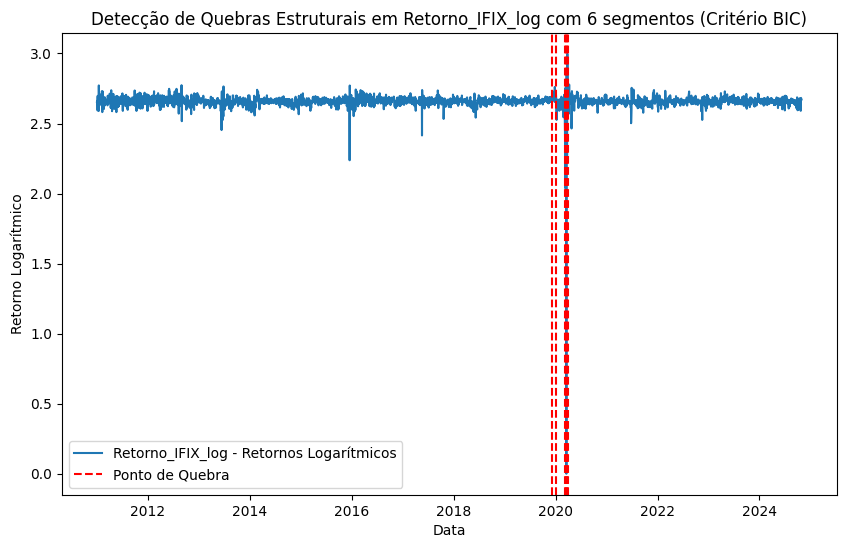

Pontos de Quebra Identificados para Retorno_IFIX_log nas datas: DatetimeIndex(['2019-12-06', '2020-01-03', '2020-03-06', '2020-03-13',
               '2020-03-20', '2020-03-27'],
              dtype='datetime64[ns]', name='Data', freq=None)

Analisando coluna: Retorno_Indice_Geral_log
Melhor número de segmentos (menor BIC) para Retorno_Indice_Geral_log: 9


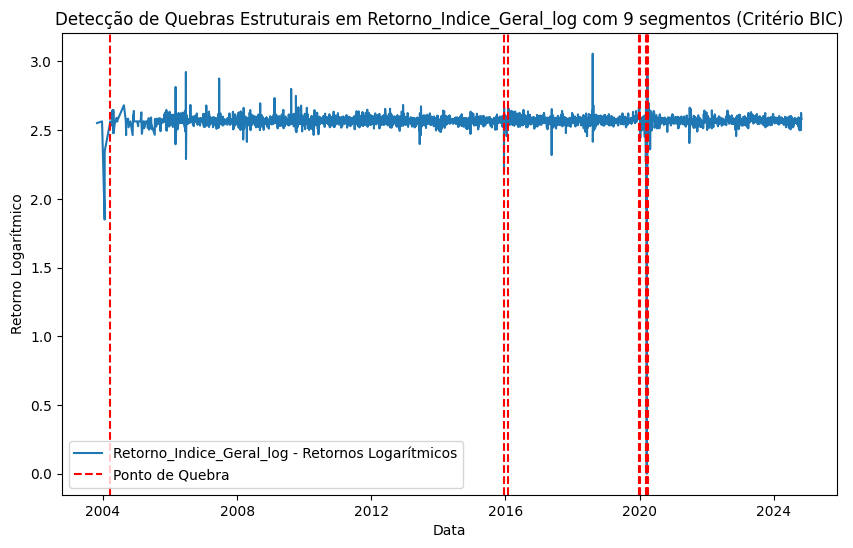

Pontos de Quebra Identificados para Retorno_Indice_Geral_log nas datas: DatetimeIndex(['2004-03-18', '2015-12-11', '2016-01-29', '2019-12-20',
               '2020-01-02', '2020-03-09', '2020-03-16', '2020-03-23',
               '2020-03-30'],
              dtype='datetime64[ns]', name='Data', freq=None)

Analisando coluna: Retorno_Residencial_log
Melhor número de segmentos (menor BIC) para Retorno_Residencial_log: 8


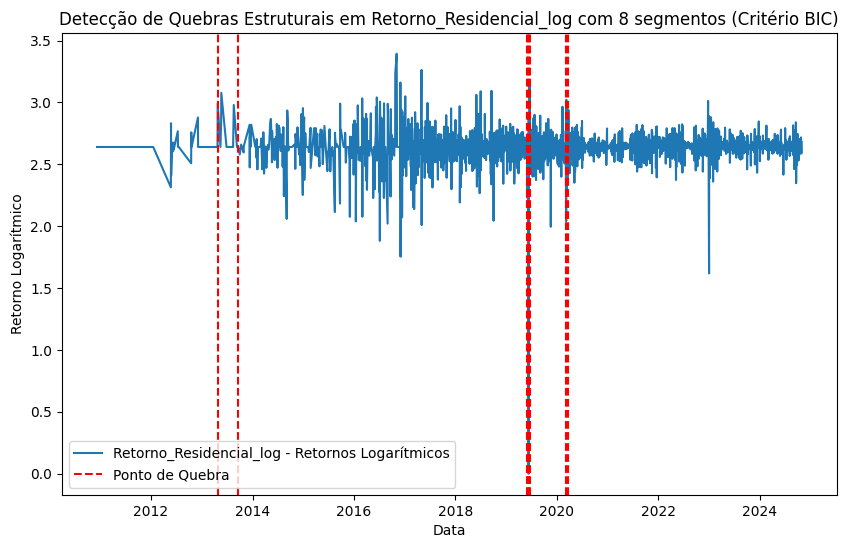

Pontos de Quebra Identificados para Retorno_Residencial_log nas datas: DatetimeIndex(['2013-04-25', '2013-09-19', '2019-05-31', '2019-06-07',
               '2019-06-14', '2019-06-24', '2020-03-06', '2020-03-20'],
              dtype='datetime64[ns]', name='Data', freq=None)

Analisando coluna: Retorno_Hibrido_log
Melhor número de segmentos (menor BIC) para Retorno_Hibrido_log: 10


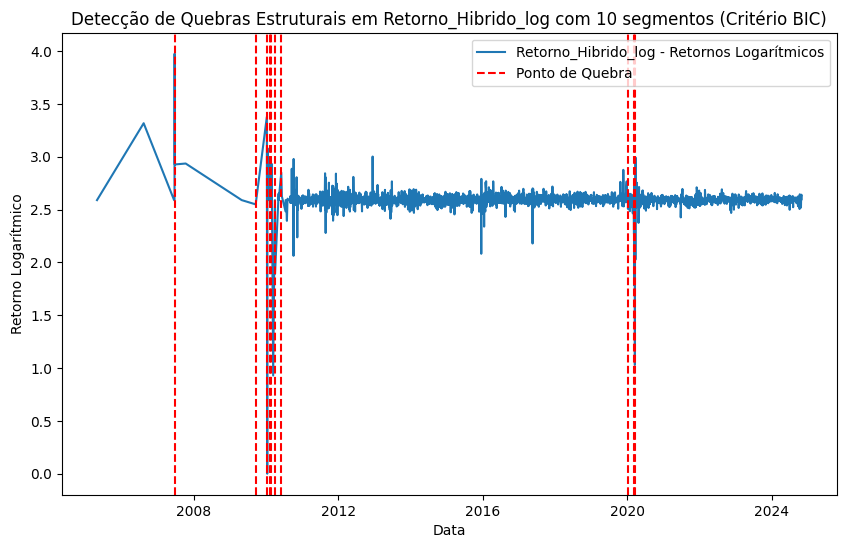

Pontos de Quebra Identificados para Retorno_Hibrido_log nas datas: DatetimeIndex(['2007-06-18', '2009-09-16', '2010-01-13', '2010-02-04',
               '2010-02-22', '2010-03-31', '2010-06-02', '2020-01-07',
               '2020-03-12', '2020-03-19'],
              dtype='datetime64[ns]', name='Data', freq=None)

Analisando coluna: Retorno_Multicategoria_log
Melhor número de segmentos (menor BIC) para Retorno_Multicategoria_log: 4


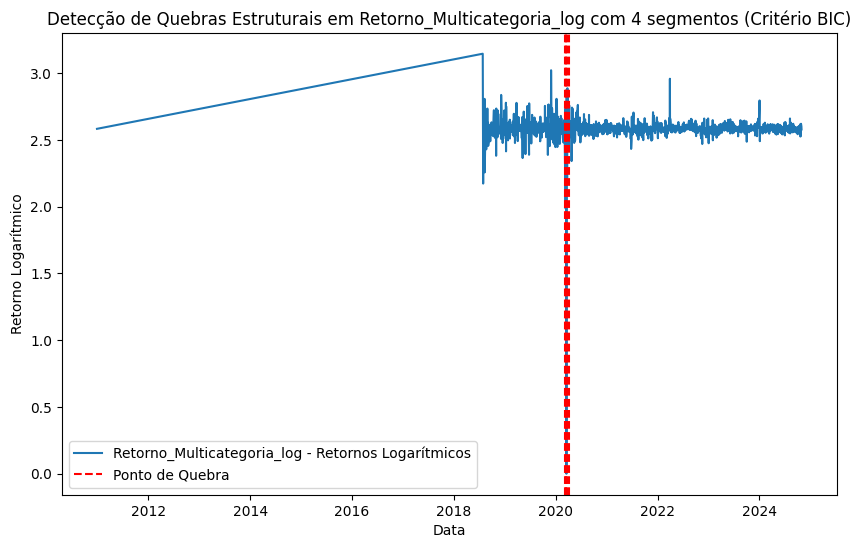

Pontos de Quebra Identificados para Retorno_Multicategoria_log nas datas: DatetimeIndex(['2020-03-05', '2020-03-12', '2020-03-19', '2020-04-09'], dtype='datetime64[ns]', name='Data', freq=None)

Analisando coluna: Retorno_TVM_log
Melhor número de segmentos (menor BIC) para Retorno_TVM_log: 1


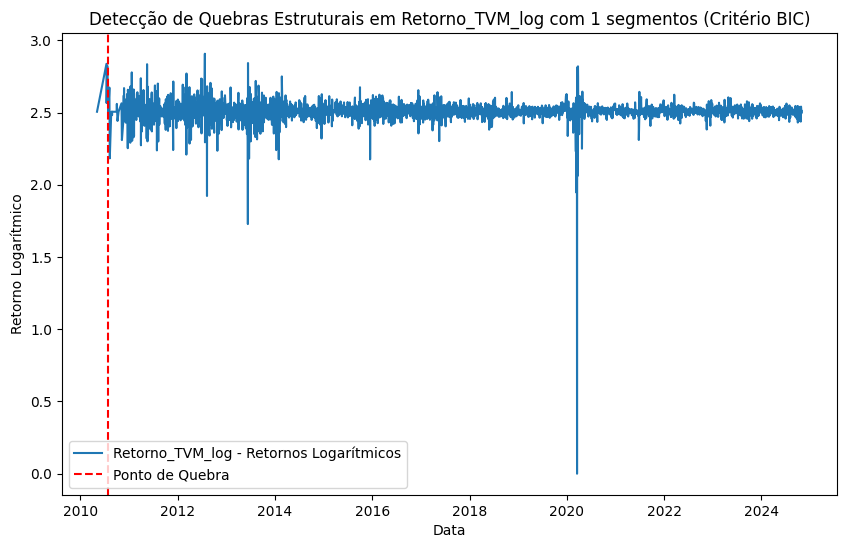

Pontos de Quebra Identificados para Retorno_TVM_log nas datas: DatetimeIndex(['2010-07-29'], dtype='datetime64[ns]', name='Data', freq=None)

Analisando coluna: Retorno_Logistica_log
Melhor número de segmentos (menor BIC) para Retorno_Logistica_log: 7


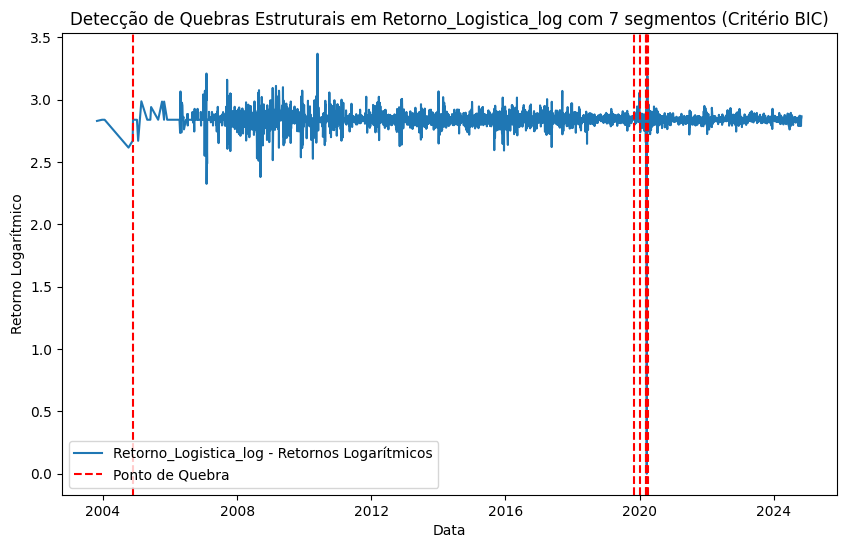

Pontos de Quebra Identificados para Retorno_Logistica_log nas datas: DatetimeIndex(['2004-11-22', '2019-10-29', '2020-01-08', '2020-03-06',
               '2020-03-13', '2020-03-20', '2020-03-27'],
              dtype='datetime64[ns]', name='Data', freq=None)

Analisando coluna: Retorno_Shoppings_log
Melhor número de segmentos (menor BIC) para Retorno_Shoppings_log: 7


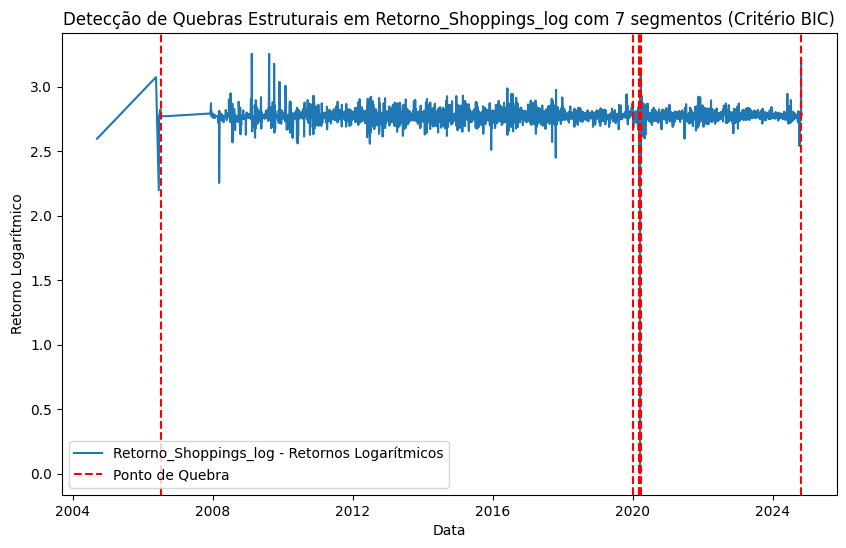

Pontos de Quebra Identificados para Retorno_Shoppings_log nas datas: DatetimeIndex(['2006-07-10', '2020-01-07', '2020-03-05', '2020-03-12',
               '2020-03-19', '2020-03-26', '2024-10-21'],
              dtype='datetime64[ns]', name='Data', freq=None)

Analisando coluna: Retorno_Lajes_Corporativas_log
Melhor número de segmentos (menor BIC) para Retorno_Lajes_Corporativas_log: 10


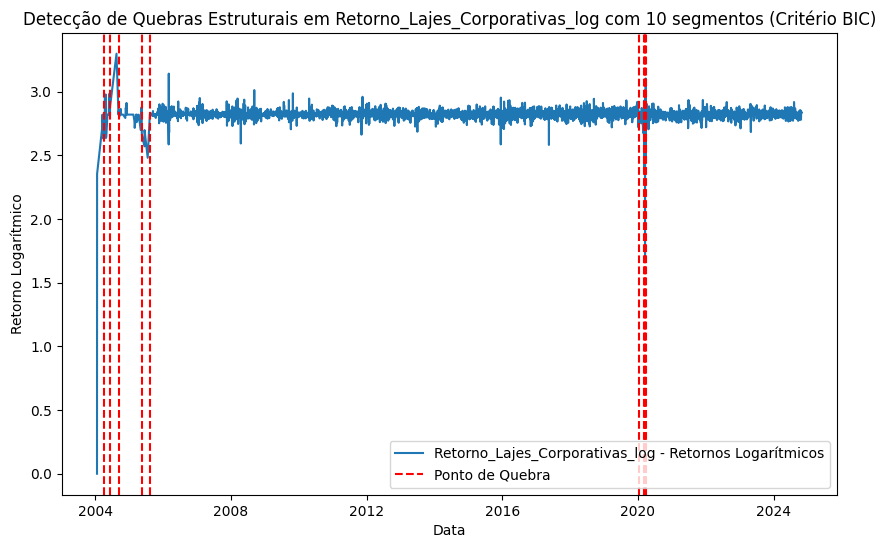

Pontos de Quebra Identificados para Retorno_Lajes_Corporativas_log nas datas: DatetimeIndex(['2004-03-30', '2004-06-07', '2004-09-13', '2005-05-16',
               '2005-08-10', '2020-01-09', '2020-03-09', '2020-03-16',
               '2020-03-23', '2020-03-30'],
              dtype='datetime64[ns]', name='Data', freq=None)

Analisando coluna: Retorno_Educacional_log
Melhor número de segmentos (menor BIC) para Retorno_Educacional_log: 5


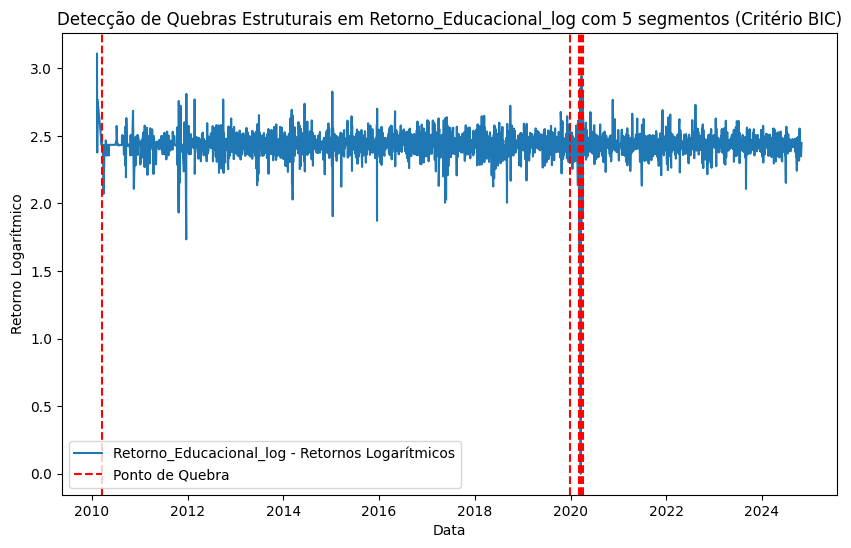

Pontos de Quebra Identificados para Retorno_Educacional_log nas datas: DatetimeIndex(['2010-03-16', '2019-12-30', '2020-03-06', '2020-03-20',
               '2020-04-03'],
              dtype='datetime64[ns]', name='Data', freq=None)

Analisando coluna: Retorno_Hospital_log
Melhor número de segmentos (menor BIC) para Retorno_Hospital_log: 5


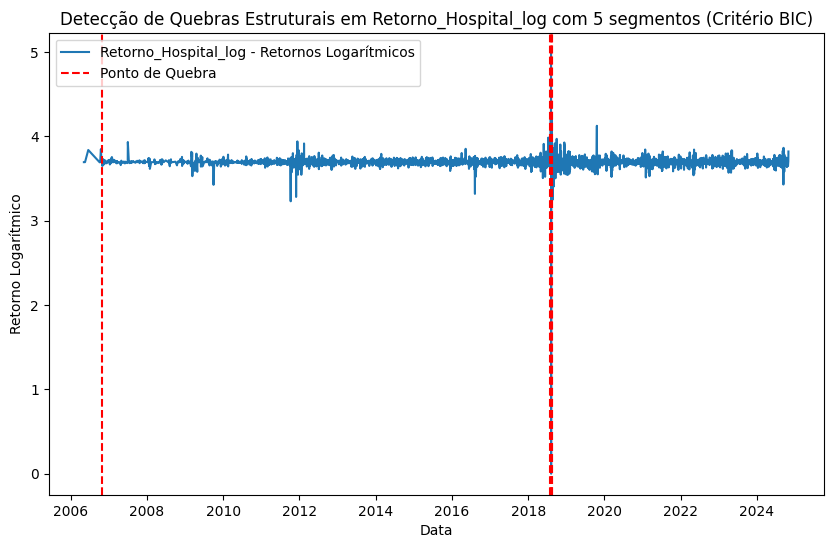

Pontos de Quebra Identificados para Retorno_Hospital_log nas datas: DatetimeIndex(['2006-10-31', '2018-07-31', '2018-08-07', '2018-08-14',
               '2018-08-21'],
              dtype='datetime64[ns]', name='Data', freq=None)

Analisando coluna: Retorno_Agencias_log
Melhor número de segmentos (menor BIC) para Retorno_Agencias_log: 9


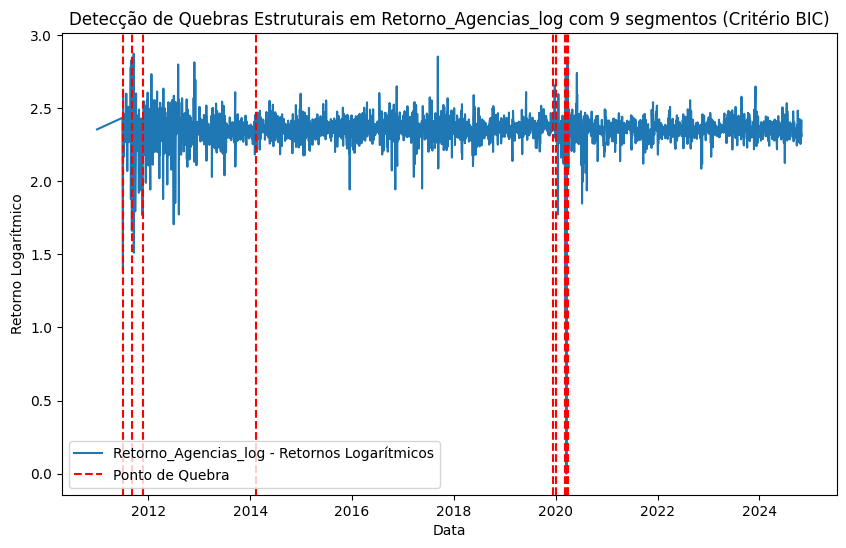

Pontos de Quebra Identificados para Retorno_Agencias_log nas datas: DatetimeIndex(['2011-07-06', '2011-09-06', '2011-11-28', '2014-02-12',
               '2019-12-10', '2020-01-06', '2020-03-11', '2020-03-25',
               '2020-04-01'],
              dtype='datetime64[ns]', name='Data', freq=None)

Analisando coluna: Retorno_Hotel_log
Melhor número de segmentos (menor BIC) para Retorno_Hotel_log: 10


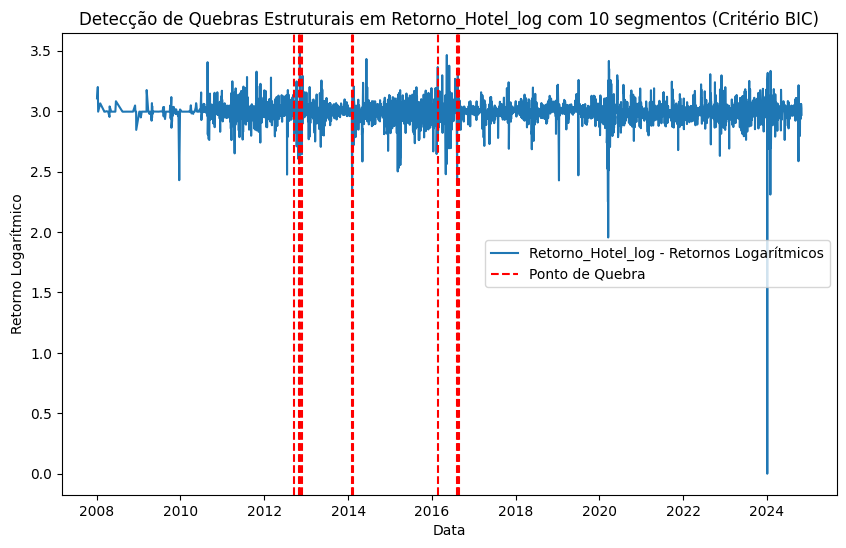

Pontos de Quebra Identificados para Retorno_Hotel_log nas datas: DatetimeIndex(['2012-09-17', '2012-10-30', '2012-11-07', '2012-11-23',
               '2014-02-04', '2014-02-11', '2016-02-24', '2016-08-08',
               '2016-08-15', '2016-08-22'],
              dtype='datetime64[ns]', name='Data', freq=None)

Analisando coluna: Retorno_Outros_log
Melhor número de segmentos (menor BIC) para Retorno_Outros_log: 4


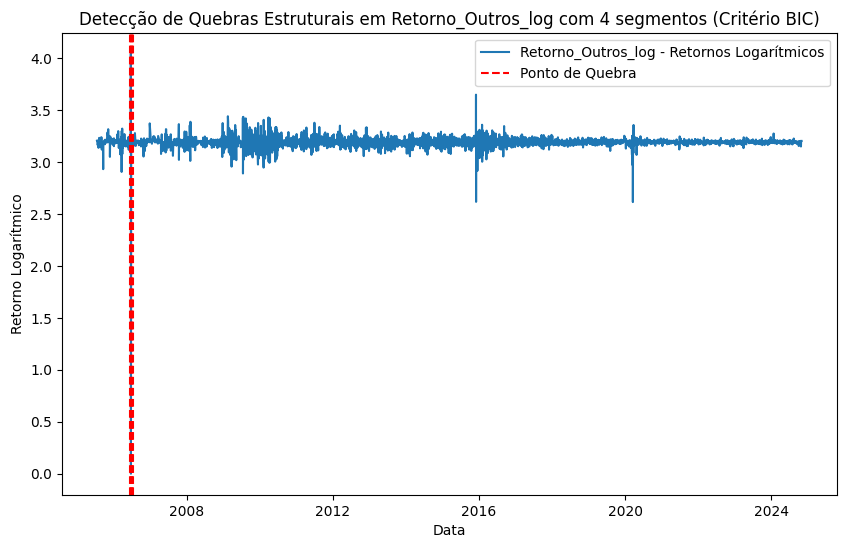

Pontos de Quebra Identificados para Retorno_Outros_log nas datas: DatetimeIndex(['2006-06-16', '2006-06-23', '2006-07-06', '2006-07-13'], dtype='datetime64[ns]', name='Data', freq=None)


In [73]:

# Parâmetros de configuração para o modelo de detecção de quebras estruturais
model = "l2"  # Modelo para mudanças na média e variância
max_segments = 10  # Número máximo de segmentos a testar

# Função para calcular o BIC
def calculate_bic(signal, breakpoints):
    """Calcula o BIC para uma dada quantidade de segmentos."""
    n_params = len(breakpoints)  # Número de segmentos (quantidade de parâmetros)
    n_samples = len(signal)
    residual_sum_of_squares = 0

    # Calcular o erro residual para cada segmento
    start = 0
    for end in breakpoints:
        segment = signal[start:end]
        mean_segment = np.mean(segment)
        residual_sum_of_squares += np.sum((segment - mean_segment) ** 2)
        start = end

    # Calcular o BIC
    bic = n_samples * np.log(residual_sum_of_squares / n_samples) + n_params * np.log(n_samples)
    return bic

# Iterar sobre cada coluna em `df_retorno_log`
for col_nome in df_retorno_log.columns:
    # Remover valores NaN da série atual
    serie = df_retorno_log[col_nome].dropna()
    signal = serie.values  # Extrair a série como array para o algoritmo de detecção
    print(f"\nAnalisando coluna: {col_nome}")

    # Inicializar variáveis para armazenar o melhor número de segmentos e o menor BIC
    best_bic = float("inf")
    best_n_segments = 1
    best_breakpoints = []

    # Testar diferentes números de segmentos para encontrar o BIC mínimo
    for n_segments in range(1, max_segments + 1):
        algo = rpt.Binseg(model=model).fit(signal)
        breakpoints = algo.predict(n_bkps=n_segments)

        # Calcular o BIC para o número atual de segmentos
        bic = calculate_bic(signal, breakpoints)

        # Atualizar o melhor BIC e o número de segmentos, se necessário
        if bic < best_bic:
            best_bic = bic
            best_n_segments = n_segments
            best_breakpoints = breakpoints

    # Visualizar os resultados para o número ideal de segmentos (menor BIC)
    print(f"Melhor número de segmentos (menor BIC) para {col_nome}: {best_n_segments}")
    plt.figure(figsize=(10, 6))
    plt.plot(serie.index, signal, label=f"{col_nome} - Retornos Logarítmicos")

    # Marcar os pontos de quebra
    first_breakpoint = True  # Variável auxiliar para a legenda
    for bp in best_breakpoints[:-1]:  # Ignorar o último ponto (final da série)
        plt.axvline(serie.index[bp], color="red", linestyle="--",
                    label="Ponto de Quebra" if first_breakpoint else None)
        first_breakpoint = False  # Definir como False após o primeiro ponto

    plt.title(f"Detecção de Quebras Estruturais em {col_nome} com {best_n_segments} segmentos (Critério BIC)")
    plt.xlabel("Data")
    plt.ylabel("Retorno Logarítmico")
    plt.legend()
    plt.show()

    # Exibir as datas dos pontos de quebra para o número de segmentos ideal
    breakpoints_dates = serie.index[best_breakpoints[:-1]]
    print(f"Pontos de Quebra Identificados para {col_nome} nas datas:", breakpoints_dates)




Analisando coluna: Retorno_IFIX_log


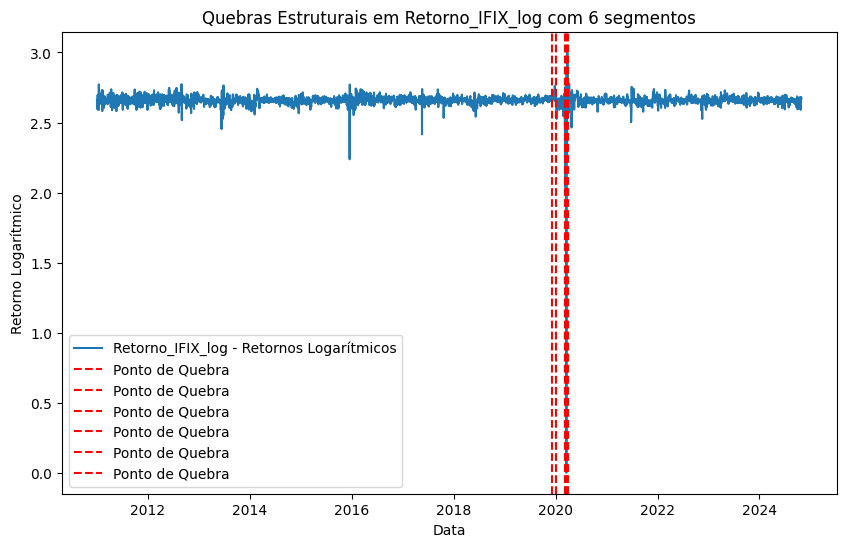


Analisando coluna: Retorno_Indice_Geral_log


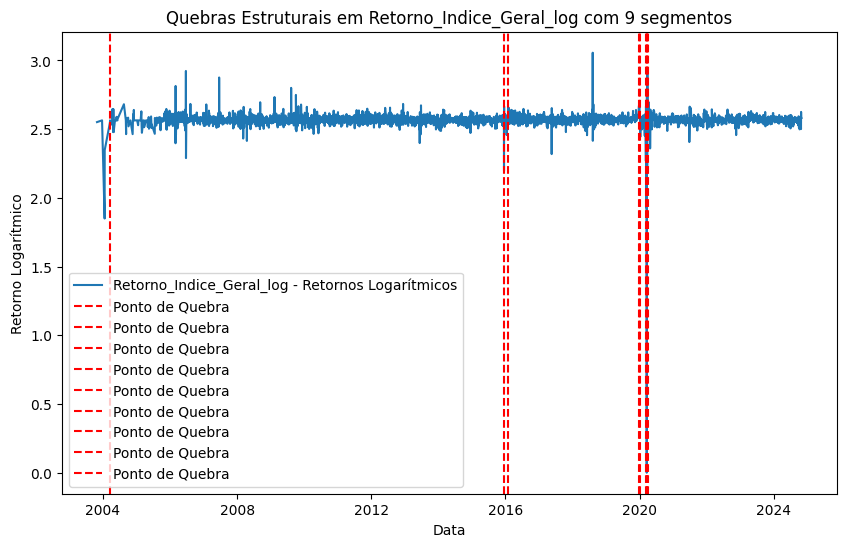


Analisando coluna: Retorno_Residencial_log


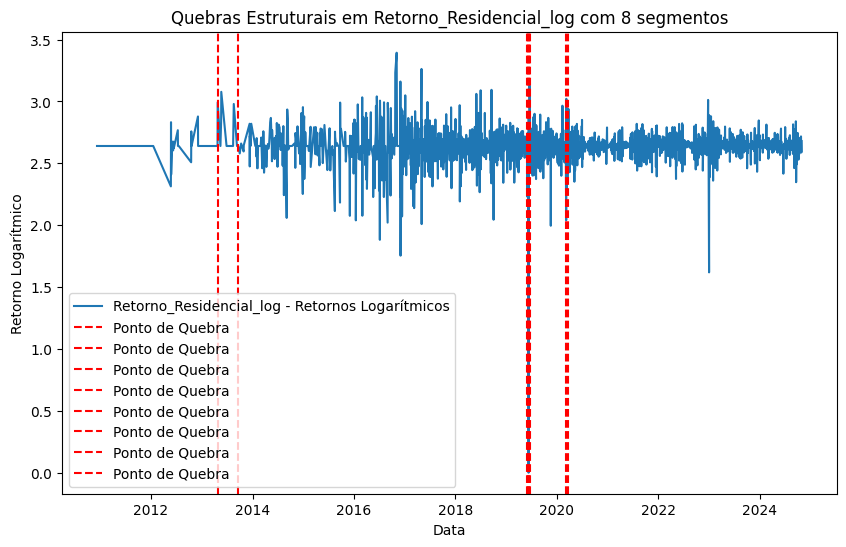


Analisando coluna: Retorno_Hibrido_log


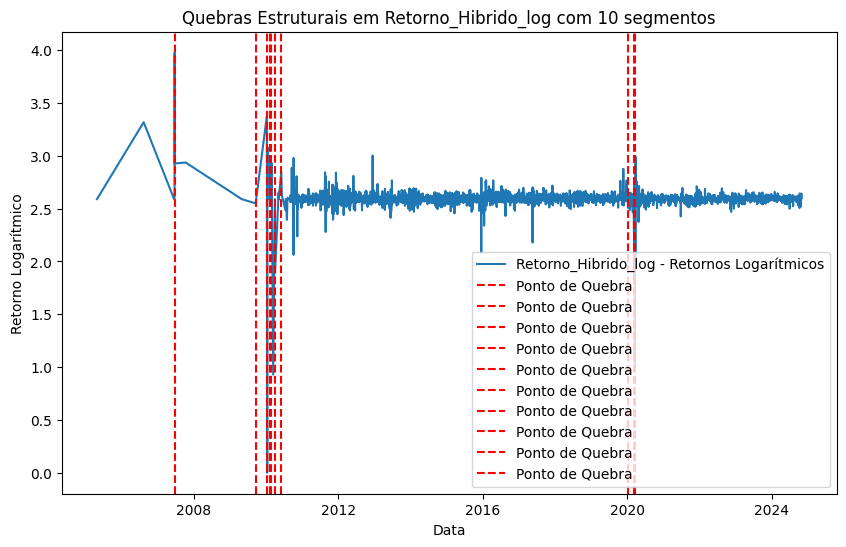


Analisando coluna: Retorno_Multicategoria_log


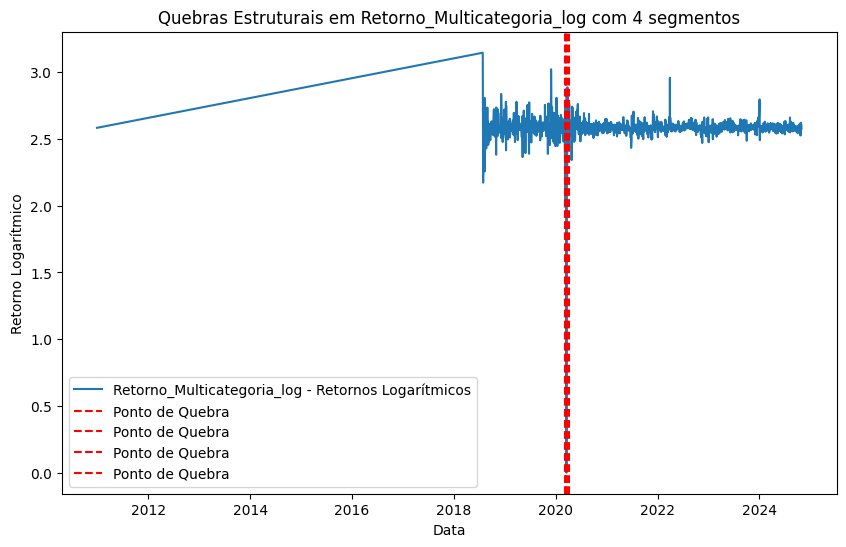


Analisando coluna: Retorno_TVM_log


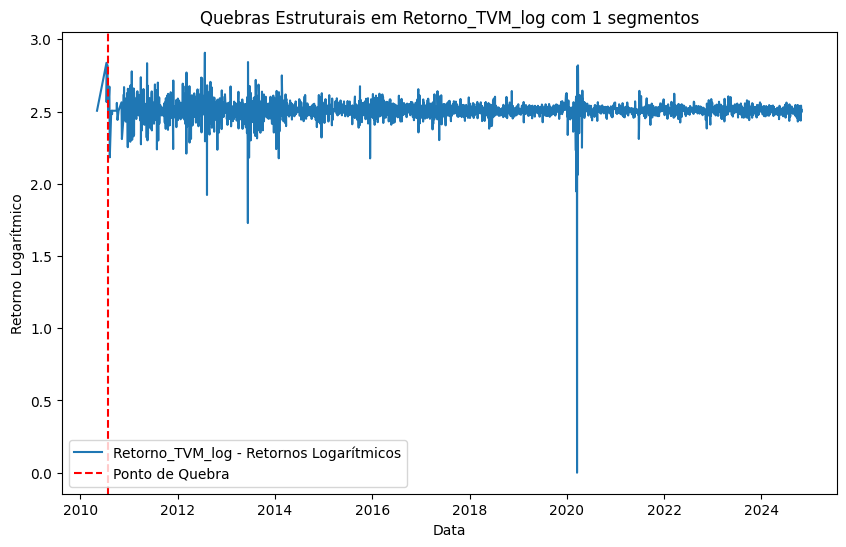


Analisando coluna: Retorno_Logistica_log


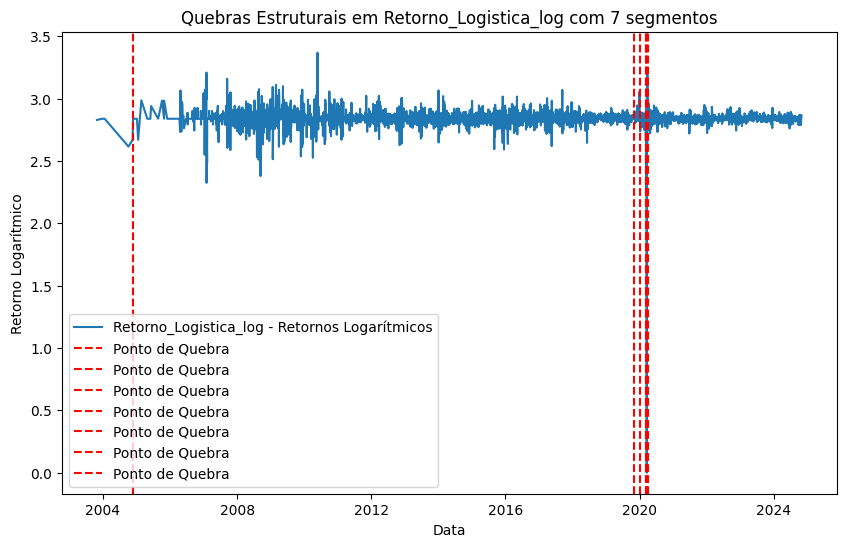


Analisando coluna: Retorno_Shoppings_log


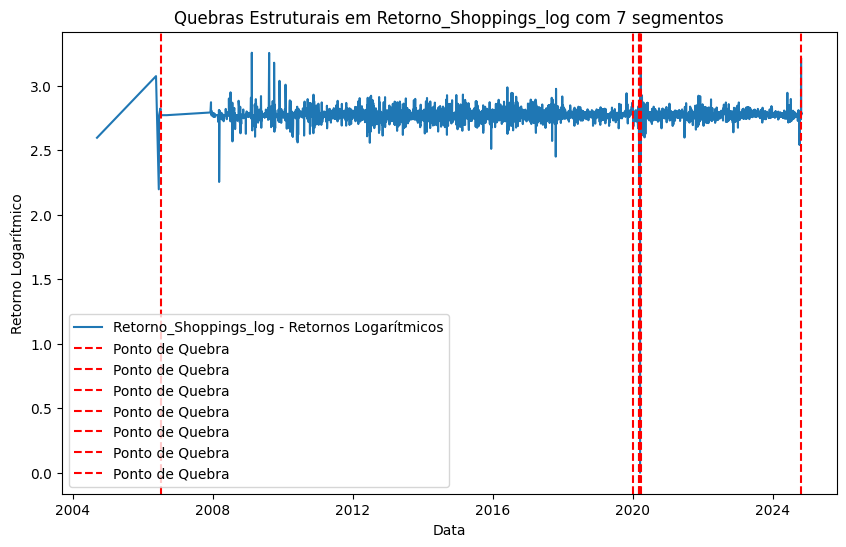


Analisando coluna: Retorno_Lajes_Corporativas_log


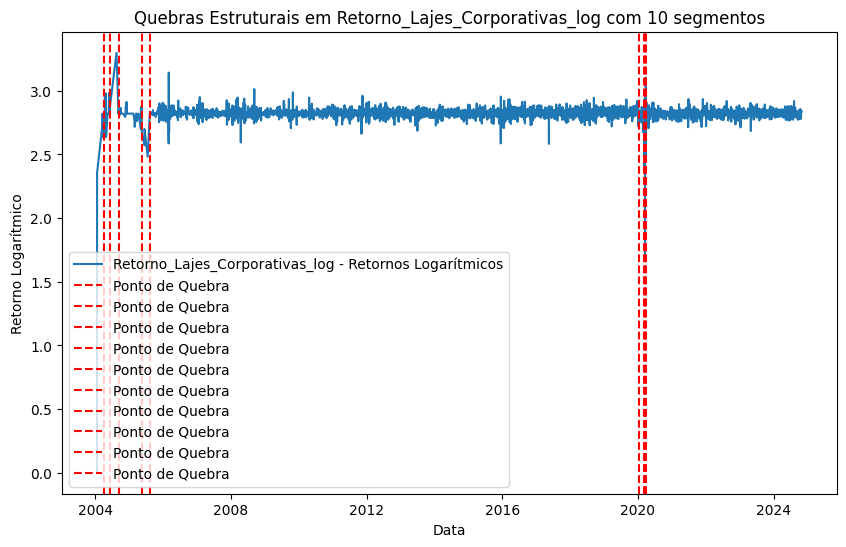


Analisando coluna: Retorno_Educacional_log


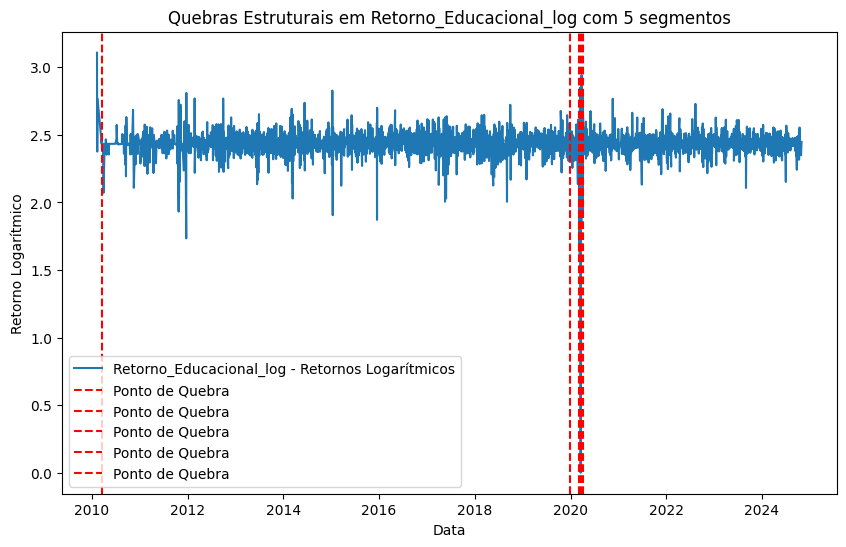


Analisando coluna: Retorno_Hospital_log


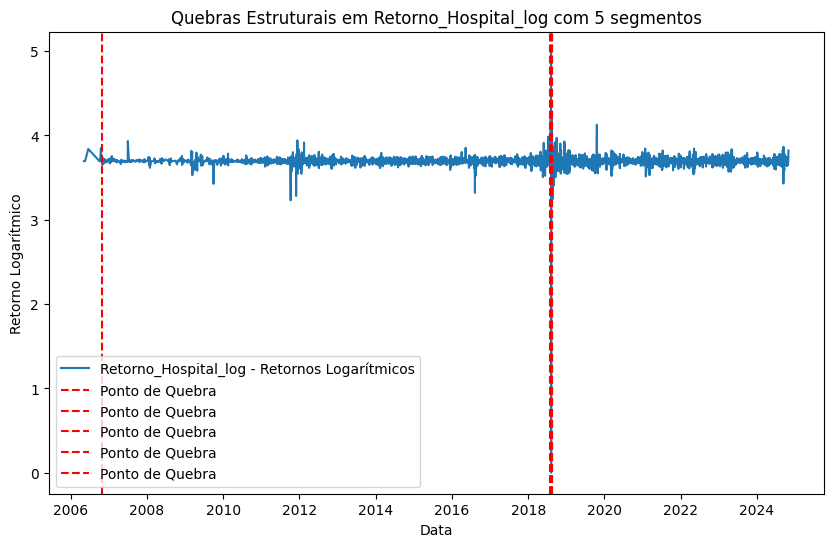


Analisando coluna: Retorno_Agencias_log


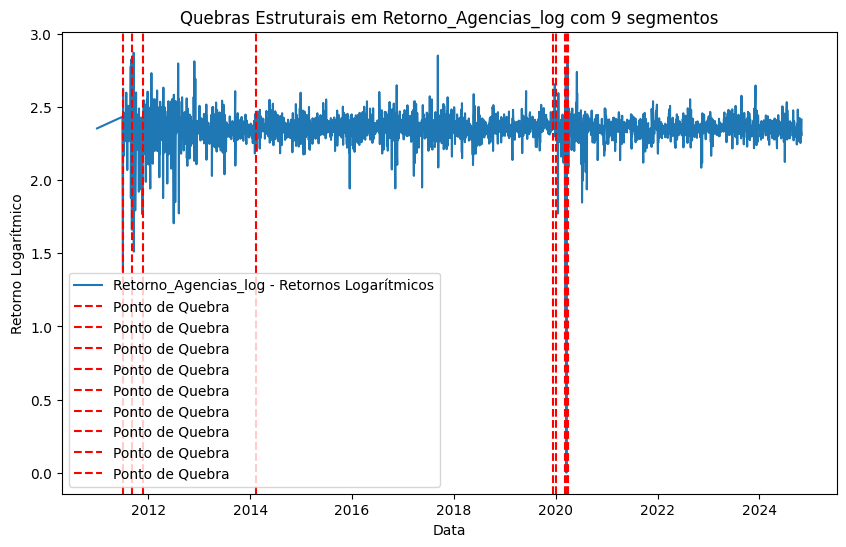


Analisando coluna: Retorno_Hotel_log


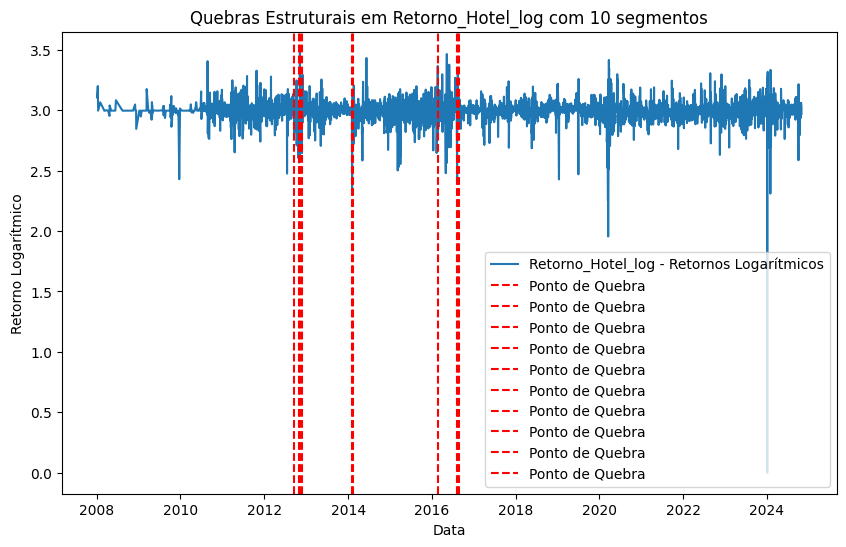


Analisando coluna: Retorno_Outros_log


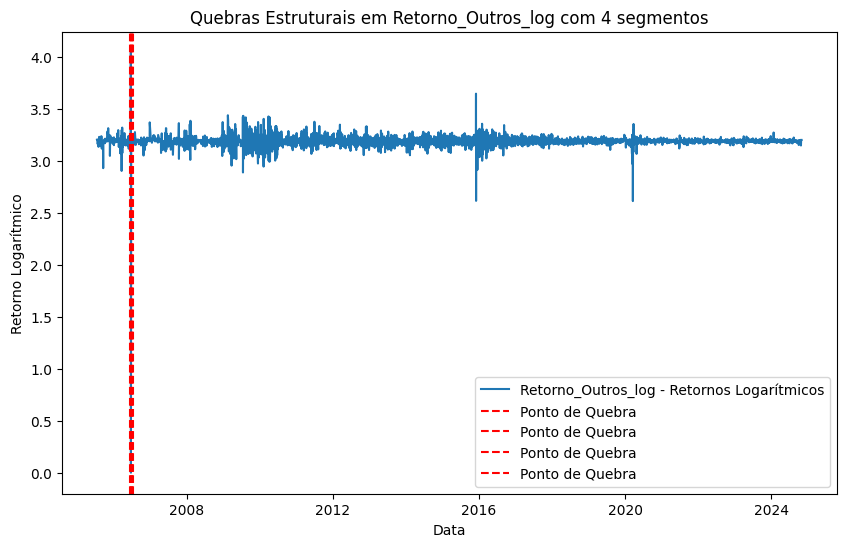

                Coluna Data do Ponto de Quebra  Valor do Retorno Logarítmico
0     Retorno_IFIX_log              2019-12-06                      2.684078
1     Retorno_IFIX_log              2020-01-03                      2.715839
2     Retorno_IFIX_log              2020-03-06                      2.588340
3     Retorno_IFIX_log              2020-03-13                      2.754958
4     Retorno_IFIX_log              2020-03-20                      2.854812
..                 ...                     ...                           ...
90   Retorno_Hotel_log              2016-08-22                      2.956108
91  Retorno_Outros_log              2006-06-16                      3.195506
92  Retorno_Outros_log              2006-06-23                      0.000000
93  Retorno_Outros_log              2006-07-06                      3.188325
94  Retorno_Outros_log              2006-07-13                      3.195414

[95 rows x 3 columns]


In [74]:

# Parâmetros de configuração para o modelo de detecção de quebras estruturais
model = "l2"  # Modelo para mudanças na média e variância
max_segments = 10  # Número máximo de segmentos a testar

# DataFrame para armazenar todos os pontos de quebra identificados
breakpoints_data = []

# Função para calcular o BIC
def calculate_bic(signal, breakpoints):
    """Calcula o BIC para uma dada quantidade de segmentos."""
    n_params = len(breakpoints)  # Número de segmentos (quantidade de parâmetros)
    n_samples = len(signal)
    residual_sum_of_squares = 0

    # Calcular o erro residual para cada segmento
    start = 0
    for end in breakpoints:
        segment = signal[start:end]
        mean_segment = np.mean(segment)
        residual_sum_of_squares += np.sum((segment - mean_segment) ** 2)
        start = end

    # Calcular o BIC
    bic = n_samples * np.log(residual_sum_of_squares / n_samples) + n_params * np.log(n_samples)
    return bic

# Iterar sobre cada coluna em `df_retorno_log`
for col_nome in df_retorno_log.columns:
    # Remover valores NaN da série atual
    serie = df_retorno_log[col_nome].dropna()
    signal = serie.values  # Extrair a série como array para o algoritmo de detecção
    print(f"\nAnalisando coluna: {col_nome}")

    # Inicializar variáveis para armazenar o melhor número de segmentos e o menor BIC
    best_bic = float("inf")
    best_n_segments = 1
    best_breakpoints = []

    # Testar diferentes números de segmentos para encontrar o BIC mínimo
    for n_segments in range(1, max_segments + 1):
        algo = rpt.Binseg(model=model).fit(signal)
        breakpoints = algo.predict(n_bkps=n_segments)

        # Calcular o BIC para o número atual de segmentos
        bic = calculate_bic(signal, breakpoints)

        # Atualizar o melhor BIC e o número de segmentos, se necessário
        if bic < best_bic:
            best_bic = bic
            best_n_segments = n_segments
            best_breakpoints = breakpoints

    # Adicionar pontos de quebra identificados à lista de dados
    breakpoints_dates = serie.index[best_breakpoints[:-1]]
    for date in breakpoints_dates:
        breakpoints_data.append({
            "Coluna": col_nome,
            "Data do Ponto de Quebra": date,
            "Valor do Retorno Logarítmico": serie[date]
        })

    # Visualizar o gráfico com os pontos de quebra destacados
    plt.figure(figsize=(10, 6))
    plt.plot(serie.index, signal, label=f"{col_nome} - Retornos Logarítmicos")

    # Marcar os pontos de quebra
    for bp in best_breakpoints[:-1]:  # Ignorar o último ponto (final da série)
        plt.axvline(serie.index[bp], color="red", linestyle="--", label="Ponto de Quebra")

    plt.title(f"Quebras Estruturais em {col_nome} com {best_n_segments} segmentos")
    plt.xlabel("Data")
    plt.ylabel("Retorno Logarítmico")
    plt.legend()
    plt.show()

# Criar DataFrame a partir da lista de pontos de quebra identificados
breakpoints_df = pd.DataFrame(breakpoints_data)

# Exibir a tabela com todos os pontos de quebra
print(breakpoints_df)


## 4.2. Eventos econômicos relevantes

In [75]:
# Carregar dados de eventos econômicos do arquivo Excel
caminho_eventos = '/content/drive/MyDrive/tese/eventos_economicos.xlsx'
tabela_eventos = pd.read_excel(caminho_eventos)

# Exibir a tabela consolidada para verificação
tabela_eventos

,evento,data_inicio,data_fim,descricao,impacto
0,Boom das Commodities,2003-01-01,2011-12-31,Alta demanda por commodities impulsionada pela...,"Fortalecimento do real, atração de investiment..."
1,Crise Financeira Global,2007-07-01,2009-03-31,A crise de hipotecas nos EUA impactou a econom...,Volatilidade e fuga de capitais no mercado fin...
2,Crise da Dívida na Zona Euro,2010-05-01,2012-07-31,A crise foi desencadeada pela revelação do déf...,Instabilidade nos mercados financeiros e dimin...
3,Crise da Dívida Pública e Recessão Brasileira,2014-01-01,2016-12-31,Queda nos preços das commodities e aumento dos...,"Alta do desemprego, inflação e crise fiscal, q..."
4,Impeachment de Dilma Rousseff e Reforma Fiscal,2016-08-01,NaT,"Com o impeachment de Dilma Rousseff, Michel Te...","Aumento da volatilidade no mercado financeiro,..."
5,Reforma Trabalhista,2017-11-01,NaT,A reforma flexibilizou as relações trabalhista...,"Flexibilização das relações trabalhistas, ince..."
6,Reforma da Previdência,2019-11-01,NaT,A reforma endureceu as regras para aposentador...,"Redução do déficit previdenciário, contribuind..."
7,Pandemia de COVID-19 e Auxílio Emergencial,2020-03-01,2020-12-31,"Durante a pandemia, o governo lançou o auxílio...",Queda nos mercados financeiros e redução no cr...
8,Crise de Liquidez no Mercado de Petróleo,2020-03-01,2021-01-31,"Com a queda na demanda causada pela COVID-19, ...",Queda nos preços do petróleo afetou ações do s...
9,Guerra na Ucrânia e Inflação Global,2022-02-01,NaT,A guerra na Ucrânia e sanções contra a Rússia ...,"Aumento nos preços de energia e alimentos, ger..."


## 4.3. Identificação de outliers

In [76]:
# DataFrame para armazenar os outliers de cada série transformada (detalhado)
outliers_df = pd.DataFrame(columns=['série', 'data', 'valor transformado'])

# Iterar sobre cada coluna em `df_retorno_log`
for col_nome in df_retorno_log.columns:
    # Extrair a série transformada
    serie_log = df_retorno_log[col_nome]

    # Calcular a média e o desvio padrão da série transformada
    media = serie_log.mean()
    desvio_padrao = serie_log.std()

    # Definir limites para detecção de outliers (3 desvios padrão)
    limite_inferior = media - 3 * desvio_padrao
    limite_superior = media + 3 * desvio_padrao

    # Identificar os outliers (valores fora dos limites)
    outliers = serie_log[(serie_log < limite_inferior) | (serie_log > limite_superior)]

    # Adicionar os outliers ao DataFrame `outliers_df` com identificação da série e data
    outliers_df = pd.concat([outliers_df, pd.DataFrame({
        'série': col_nome,
        'data': outliers.index,
        'valor transformado': outliers.values
    })])

# Exibir o DataFrame de outliers
print("\nOutliers identificados em cada série transformada:")
print(outliers_df)



Outliers identificados em cada série transformada:
                 série       data  valor transformado
0     Retorno_IFIX_log 2013-06-11            2.453456
1     Retorno_IFIX_log 2015-12-16            2.237775
2     Retorno_IFIX_log 2017-05-18            2.414990
3     Retorno_IFIX_log 2020-03-09            2.368406
4     Retorno_IFIX_log 2020-03-12            2.036253
..                 ...        ...                 ...
19  Retorno_Outros_log 2015-12-02            3.649981
20  Retorno_Outros_log 2015-12-03            2.617880
21  Retorno_Outros_log 2015-12-16            2.916789
22  Retorno_Outros_log 2020-03-12            2.974855
23  Retorno_Outros_log 2020-03-18            2.615849

[458 rows x 3 columns]


<ipython-input-76-f4206eb57d48>:21: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  outliers_df = pd.concat([outliers_df, pd.DataFrame({


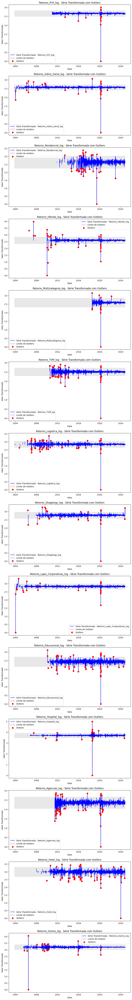

In [77]:

# Iterar sobre cada coluna em `df_retorno_log` para gerar os gráficos
fig, axes = plt.subplots(len(df_retorno_log.columns), 1, figsize=(10, 5 * len(df_retorno_log.columns)), squeeze=False)
fig.tight_layout(pad=4.0)

for ax, col_nome in zip(axes.flatten(), df_retorno_log.columns):
    # Extrair a série transformada
    serie_log = df_retorno_log[col_nome]

    # Calcular a média e o desvio padrão da série transformada
    media = serie_log.mean()
    desvio_padrao = serie_log.std()

    # Definir limites para detecção de outliers
    limite_inferior = media - 3 * desvio_padrao
    limite_superior = media + 3 * desvio_padrao

    # Identificar os outliers
    outliers = serie_log[(serie_log < limite_inferior) | (serie_log > limite_superior)]

    # Plotar a série transformada
    ax.plot(serie_log.index, serie_log, label=f"Série Transformada - {col_nome}", color='blue')
    ax.fill_between(serie_log.index, limite_inferior, limite_superior, color='lightgray', alpha=0.5, label="Limite de Outliers")

    # Destacar os outliers
    ax.scatter(outliers.index, outliers, color='red', s=50, label="Outliers", zorder=5)

    # Customizar o gráfico
    ax.set_title(f"{col_nome} - Série Transformada com Outliers")
    ax.set_xlabel("Data")
    ax.set_ylabel("Valor Transformado")
    ax.legend()

# Exibir os gráficos
plt.show()


## **4.4. Dummies de outliers**

In [78]:
# Lista dos novos nomes desejados para as colunas de dummies
novos_nomes_colunas = [
    'outlier_ifix', 'outlier_indice_geral', 'outlier_residencial',
    'outlier_hibrido', 'outlier_multicategoria', 'outlier_tvm',
    'outlier_logistica', 'outlier_shoppings', 'outlier_lajes_corporativas',
    'outlier_educacional', 'outlier_hospital', 'outlier_agencias',
    'outlier_hotel', 'outlier_outros'
]

# Criar DataFrame para armazenar as dummies com o mesmo índice de `df_retorno_log`
dummies_df = pd.DataFrame(index=df_retorno_log.index, columns=novos_nomes_colunas)

# Iterar sobre cada coluna em `df_retorno_log` e criar a dummy correspondente
for i, col_nome in enumerate(df_retorno_log.columns):
    # Nome da coluna de dummy de acordo com a lista `novos_nomes_colunas`
    dummy_col = novos_nomes_colunas[i]

    # Coluna transformada (log) a ser analisada
    serie_log = df_retorno_log[col_nome]

    # Calcular média e desvio padrão
    media = serie_log.mean()
    desvio_padrao = serie_log.std()
    limite_inferior = media - 3 * desvio_padrao
    limite_superior = media + 3 * desvio_padrao

    # Criar dummy com 1 para outliers, 0 para não-outliers, e NaN para NaN na série original
    dummy = serie_log.apply(lambda x: 1 if x < limite_inferior or x > limite_superior else (0 if pd.notna(x) else np.nan))

    # Adicionar a dummy ao DataFrame `dummies_df`
    dummies_df[dummy_col] = dummy

# Exibir o DataFrame de dummies com os outliers marcados
print("\nDummies de Outliers para cada série:")
print(dummies_df)




Dummies de Outliers para cada série:
            outlier_ifix  outlier_indice_geral  outlier_residencial  \
Data                                                                  
2003-10-28           NaN                   0.0                  NaN   
2003-12-22           NaN                   0.0                  NaN   
2004-01-19           NaN                   1.0                  NaN   
2004-01-20           NaN                   1.0                  NaN   
2004-03-17           NaN                   0.0                  NaN   
...                  ...                   ...                  ...   
2024-10-23           0.0                   0.0                  0.0   
2024-10-24           0.0                   0.0                  0.0   
2024-10-25           0.0                   0.0                  0.0   
2024-10-28           0.0                   0.0                  0.0   
2024-10-29           0.0                   0.0                  0.0   

            outlier_hibrido  outlier_m

## **4.5. Dummies de Pandemia**


No Brasil, o primeiro caso confirmado de COVID-19 ocorreu em 26 de fevereiro de 2020. Em 22 de abril de 2022, o Ministério da Saúde declarou o fim da Emergência em Saúde Pública de Importância Nacional (ESPIN) relacionada à COVID-19, com a portaria entrando em vigor 30 dias após sua assinatura.

Portanto, para estudos que utilizam variáveis dummy para capturar os efeitos da pandemia no Brasil, é comum considerar o período de 26 de fevereiro de 2020 até 22 de maio de 2022.

**Lockdown**

O período de março de 2020 a dezembro de 2020 cobre a fase inicial e mais crítica da pandemia de COVID-19 no Brasil, um período em que o governo brasileiro implementou medidas de apoio econômico, como o Auxílio Emergencial, para mitigar os impactos financeiros sobre as populações vulneráveis e trabalhadores informais.

Esse intervalo é relevante porque cobre a fase mais intensa do impacto econômico e social da pandemia, além de ser o período de duração do programa original de Auxílio Emergencial, antes de suas extensões e modificações em 2021.

In [79]:
# Definir as datas de início e fim dos períodos da pandemia e do lockdown
data_inicio_pandemia = pd.to_datetime("2020-02-26")
data_fim_pandemia = pd.to_datetime("2022-05-22")
data_inicio_lockdown = pd.to_datetime("2020-02-26")
data_fim_lockdown = pd.to_datetime("2020-12-31")

# Garantir que o índice de df_retorno_log seja de tipo datetime para fazer comparações de data
df_retorno_log.index = pd.to_datetime(df_retorno_log.index)

# Criar as colunas 'pandemia_dummy' e 'lockdown_dummy' com os valores 1 para o período correspondente e 0 caso contrário
df_retorno_log['pandemia_dummy'] = ((df_retorno_log.index >= data_inicio_pandemia) &
                                    (df_retorno_log.index <= data_fim_pandemia)).astype(int)
df_retorno_log['lockdown_dummy'] = ((df_retorno_log.index >= data_inicio_lockdown) &
                                    (df_retorno_log.index <= data_fim_lockdown)).astype(int)

# Exibir o resultado para confirmar
df_retorno_log[['pandemia_dummy', 'lockdown_dummy']]


,pandemia_dummy,lockdown_dummy
Data,,
2003-10-28,0,0
2003-12-22,0,0
2004-01-19,0,0
2004-01-20,0,0
2004-03-17,0,0
...,...,...
2024-10-23,0,0
2024-10-24,0,0
2024-10-25,0,0


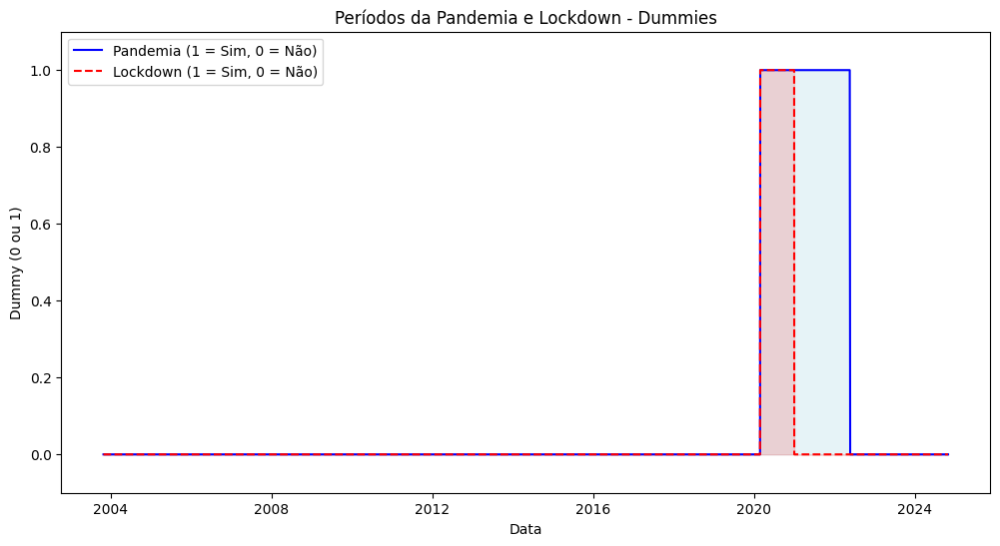

In [80]:
# Plotar ambas as dummies 'pandemia' e 'lockdown' em um único gráfico, com linha pontilhada para o lockdown
plt.figure(figsize=(12, 6))

# Gráfico para 'pandemia_dummy'
plt.plot(df_retorno_log.index, df_retorno_log['pandemia_dummy'], color='blue', label='Pandemia (1 = Sim, 0 = Não)')
plt.fill_between(df_retorno_log.index, df_retorno_log['pandemia_dummy'], color='lightblue', alpha=0.3)

# Gráfico para 'lockdown_dummy' com linha pontilhada
plt.plot(df_retorno_log.index, df_retorno_log['lockdown_dummy'], color='red', linestyle='--', label='Lockdown (1 = Sim, 0 = Não)')
plt.fill_between(df_retorno_log.index, df_retorno_log['lockdown_dummy'], color='lightcoral', alpha=0.3)

# Configurações do gráfico
plt.title("Períodos da Pandemia e Lockdown - Dummies")
plt.xlabel("Data")
plt.ylabel("Dummy (0 ou 1)")
plt.ylim(-0.1, 1.1)  # Limitar o eixo y para clareza (0 e 1)
plt.legend()
plt.show()

## 4.6. Dummy de Impeachment

O período de maior volatilidade no mercado financeiro associado ao impeachment da ex-presidente Dilma Rousseff ocorreu entre o final de 2015 e o primeiro semestre de 2016. Esse período foi marcado por incertezas políticas e econômicas no Brasil, o que influenciou os mercados.

Datas Chave do Processo de Impeachment de Dilma Rousseff:
Início do Período de Volatilidade: Novembro de 2015

2 de dezembro de 2015: O presidente da Câmara dos Deputados na época, Eduardo Cunha, aceitou o pedido de impeachment contra Dilma Rousseff, iniciando oficialmente o processo. Esse evento gerou um aumento na volatilidade, já que o mercado começou a precificar o risco de mudança no governo.
Fim do Período de Volatilidade: Agosto de 2016

31 de agosto de 2016: Dilma Rousseff foi oficialmente afastada do cargo após a votação final do impeachment no Senado Federal. Com isso, o processo foi concluído, e Michel Temer assumiu definitivamente a presidência. Após essa data, a volatilidade no mercado financeiro começou a se estabilizar, à medida que a incerteza política diminuiu.
Resumo das Datas
Início: 2 de dezembro de 2015
Fim: 31 de agosto de 2016

In [81]:
# Definir as datas de início e fim do período do impeachment
data_inicio_impeachment = pd.to_datetime("2015-12-02")
data_fim_impeachment = pd.to_datetime("2016-08-31")

# Garantir que o índice de df_retorno_log seja de tipo datetime para fazer comparações de data
df_retorno_log.index = pd.to_datetime(df_retorno_log.index)

# Criar a coluna 'impeachment_dummy' com o valor 1 para o período do impeachment e 0 caso contrário
df_retorno_log['impeachment_dummy'] = ((df_retorno_log.index >= data_inicio_impeachment) &
                                       (df_retorno_log.index <= data_fim_impeachment)).astype(int)

# Exibir o resultado para confirmar
print(df_retorno_log[['impeachment_dummy']])


            impeachment_dummy
Data                         
2003-10-28                  0
2003-12-22                  0
2004-01-19                  0
2004-01-20                  0
2004-03-17                  0
...                       ...
2024-10-23                  0
2024-10-24                  0
2024-10-25                  0
2024-10-28                  0
2024-10-29                  0

[5018 rows x 1 columns]


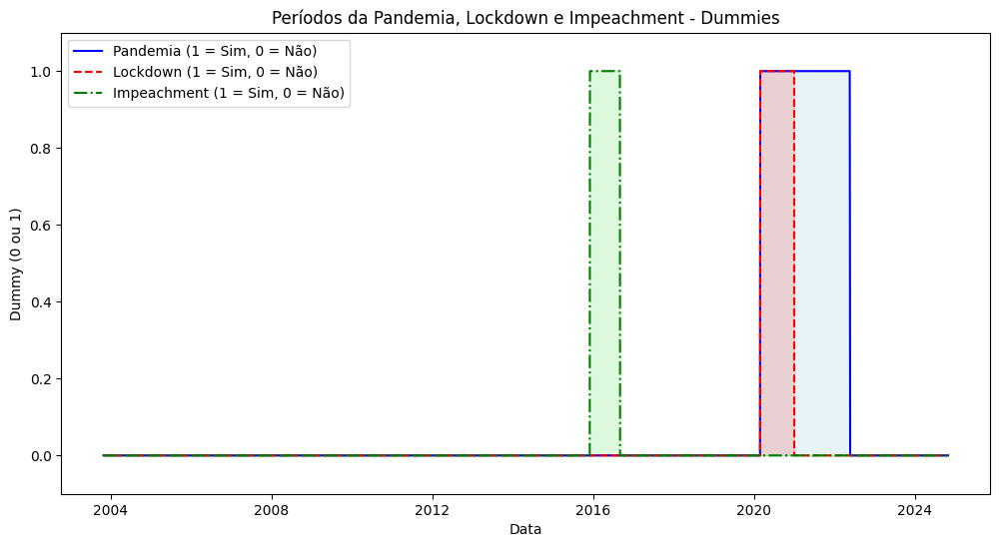

In [82]:
# Configurar o gráfico
plt.figure(figsize=(12, 6))

# Gráfico para 'pandemia_dummy'
plt.plot(df_retorno_log.index, df_retorno_log['pandemia_dummy'], color='blue', label='Pandemia (1 = Sim, 0 = Não)')
plt.fill_between(df_retorno_log.index, df_retorno_log['pandemia_dummy'], color='lightblue', alpha=0.3)

# Gráfico para 'lockdown_dummy' com linha pontilhada
plt.plot(df_retorno_log.index, df_retorno_log['lockdown_dummy'], color='red', linestyle='--', label='Lockdown (1 = Sim, 0 = Não)')
plt.fill_between(df_retorno_log.index, df_retorno_log['lockdown_dummy'], color='lightcoral', alpha=0.3)

# Gráfico para 'impeachment_dummy' com linha pontilhada verde
plt.plot(df_retorno_log.index, df_retorno_log['impeachment_dummy'], color='green', linestyle='-.', label='Impeachment (1 = Sim, 0 = Não)')
plt.fill_between(df_retorno_log.index, df_retorno_log['impeachment_dummy'], color='lightgreen', alpha=0.3)

# Configurações do gráfico
plt.title("Períodos da Pandemia, Lockdown e Impeachment - Dummies")
plt.xlabel("Data")
plt.ylabel("Dummy (0 ou 1)")
plt.ylim(-0.1, 1.1)  # Limitar o eixo y para clareza (0 e 1)
plt.legend()
plt.show()


## 4.7. DATAFRAME 1

In [83]:
# Definindo os índices de ambos os DataFrames para realizar a junção com o índice como chave
df_retorno_log.set_index(df_retorno_log.index, inplace=True)
dummies_df.set_index(dummies_df.index, inplace=True)

# Realizando a junção com o índice como chave
df_retorno_log = df_retorno_log.join(dummies_df, how='left', lsuffix='_retorno', rsuffix='_dummy')

# Exibindo o DataFrame atualizado para o usuário
# df_retorno_log

# Exibir as colunas do DataFrame para verificar o nome correto
print(df_retorno_log.columns)

Index(['Retorno_IFIX_log', 'Retorno_Indice_Geral_log',
       'Retorno_Residencial_log', 'Retorno_Hibrido_log',
       'Retorno_Multicategoria_log', 'Retorno_TVM_log',
       'Retorno_Logistica_log', 'Retorno_Shoppings_log',
       'Retorno_Lajes_Corporativas_log', 'Retorno_Educacional_log',
       'Retorno_Hospital_log', 'Retorno_Agencias_log', 'Retorno_Hotel_log',
       'Retorno_Outros_log', 'pandemia_dummy', 'lockdown_dummy',
       'impeachment_dummy', 'outlier_ifix', 'outlier_indice_geral',
       'outlier_residencial', 'outlier_hibrido', 'outlier_multicategoria',
       'outlier_tvm', 'outlier_logistica', 'outlier_shoppings',
       'outlier_lajes_corporativas', 'outlier_educacional', 'outlier_hospital',
       'outlier_agencias', 'outlier_hotel', 'outlier_outros'],
      dtype='object')


# **5. VARIÁVEIS EXÓGENAS**

## **5.1. Extração e preparação de dados**

### Economática

In [84]:
# # @title Economatica diário

# # Configuração do período de interesse
# start_date, end_date = '2010-12-30', '2024-10-29'

# # Função para carregar e preparar o DataFrame
# def load_dataframe(file_path, columns, encoding='latin-1'):
#     try:
#         df = pd.read_csv(file_path, usecols=columns, encoding=encoding)
#         df['Data'] = pd.to_datetime(df['Data'], errors='coerce')
#         df = df[(df['Data'] >= start_date) & (df['Data'] <= end_date)]  # Filtra o período de interesse
#         df.set_index('Data', inplace=True)
#         return df
#     except (pd.errors.ParserError, pd.errors.EmptyDataError) as e:
#         print(f"Erro ao carregar {file_path}: {e}")
#         return None

# # Lista de arquivos e nomes de ativos
# files_and_names2 = [
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-IBOV.csv', 'ibov'), # Ibovespa
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-IMAT.csv', 'imat'), # Imat Basicos
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-IMOB.csv', 'imob'), # Imobiliario
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-CDI 252 dias.csv', 'cdi252'),
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-CDI Acumulado.csv', 'cdi'),
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-LFT 252 dias.csv', 'lft252'),
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-LFT Acumulado.csv', 'lft'),
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-DOLX24.csv', 'dolx24'), # Dolar Fut Con 24-11
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-DOLOF.csv', 'dolof'), # Dolar Ptax Venda
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-EUROBR.csv', 'eurobr'), # Euro Real
# ]

# # Carregamento e processamento
# dataframes_dict = {}
# for file_path, name in files_and_names2:
#     df = load_dataframe(file_path, ['Ativo', 'Data', 'Fechamento'])
#     if df is not None:
#         df['Fechamento'] = pd.to_numeric(df['Fechamento'], errors='coerce')
#         dataframes_dict[name] = df[['Fechamento']].rename(columns={'Fechamento': name})

# # Concatenação e ordenação dos dados
# df_economatica_diario = pd.concat(dataframes_dict.values(), axis=1).sort_index(ascending=False)

# print("Head do DataFrame:", df_economatica_diario.head(), sep="\n")
# print("\nTail do DataFrame:", df_economatica_diario.tail(), sep="\n")
# print("\nEstatísticas descritivas:", df_economatica_diario.describe(), sep="\n")
# # print(f"\nOs dados diários foram salvos em '{output_path}'.")


In [85]:
# # @title Economatica mensal

# # Configuração do período de interesse
# start_date, end_date = '2010-12-30', '2024-10-29'

# # Função para carregar e preparar o DataFrame
# def load_dataframe(file_path, columns, encoding='latin-1'):
#     try:
#         df = pd.read_csv(file_path, usecols=columns, encoding=encoding)
#         df['Data'] = pd.to_datetime(df['Data'], errors='coerce')
#         df = df[(df['Data'] >= start_date) & (df['Data'] <= end_date)]  # Filtra o período de interesse
#         df.set_index('Data', inplace=True)
#         return df
#     except (pd.errors.ParserError, pd.errors.EmptyDataError) as e:
#         print(f"Erro ao carregar {file_path}: {e}")
#         return None

# # Lista de arquivos e nomes de ativos
# files_and_names2 = [
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-IPCA.csv','ipca'),
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-IPCA - Taxa mes.csv','ipca_mes'),
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-IGPM.csv','igpm'),
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-IGPM - Taxa mes.csv','igpm_mes'),
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-INCC-DI.csv','incc_di'),
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-INCC DI - Tx mes.csv','incc_di_mes'),
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-CDI Efetiva Mes.csv','cdi_efetiva'),
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-TR taxa mensal.csv','tr_mes'),
#     ('/content/drive/MyDrive/tese/economatica-20241029/Economatica-indicadoresbr-20241029-LFT Efetiva Mes.csv','lft_efetiva'),
# ]

# # Carregamento e processamento dos dados
# dataframes_dict = {}
# for file_path, name in files_and_names2:
#     df = load_dataframe(file_path, ['Ativo', 'Data', 'Fechamento'])
#     if df is not None:
#         df['Fechamento'] = pd.to_numeric(df['Fechamento'], errors='coerce')
#         # Seleciona o último dia do mês, remove NaN e ajusta o índice para o formato 'AAAA-MM'
#         df_mensal = df.resample('M').ffill().dropna()
#         df_mensal.index = df_mensal.index.to_period('M')  # Ajusta o índice para o formato 'AAAA-MM'
#         dataframes_dict[name] = df_mensal.rename(columns={'Fechamento': name})

# # Concatenação e ordenação dos dados
# df_economatica_mensal = pd.concat(dataframes_dict.values(), axis=1).sort_index(ascending=False)

# print("Head do DataFrame:", df_economatica_mensal.head(), sep="\n")
# print("\nTail do DataFrame:", df_economatica_mensal.tail(), sep="\n")
# print("\nEstatísticas descritivas:", df_economatica_mensal.describe(), sep="\n")
# # print(f"\nOs dados mensais foram salvos em '{output_path}'.")


In [86]:
# # @title consolidação diário

# # Junta os DataFrames df_bcb_diario e df_economatica_diario
# df_consolidado_diario = pd.concat([df_bcb_diario_combinado, df_economatica_diario], axis=1)

# # Exibe o DataFrame consolidado
# print(df_consolidado_diario)

### Banco Central

In [87]:
# @title BCB SGS diário

# Configuração do período de interesse
start_date, end_date = '2010-12-30', '2024-10-29'

# Carregar os dados do BCB DEPEC e aplicar o filtro de datas
df_bcb_diario = sgs.get({
    'dolar' : 1,            # Taxa de câmbio - Dólar americano (venda)
    'euro' : 21619,         # Taxa de câmbio - Euro (venda)
    'selic' : 11,           # Taxa de juros - Selic diária
    'selic252' : 1178,      # Taxa de juros - Selic anualizada base 252
    'selic_meta' : 432,     # Meta Selic definida pelo Copom
})

# Converte o índice de data para o tipo datetime e aplica o filtro de datas
df_bcb_diario.index = pd.to_datetime(df_bcb_diario.index)
df_bcb_diario = df_bcb_diario[(df_bcb_diario.index >= start_date) & (df_bcb_diario.index <= end_date)]

# Remove linhas com valores NaN nas colunas 'dolar' e 'euro'
df_bcb_diario = df_bcb_diario.dropna(subset=['dolar', 'euro'])

# Calcula a variação diária em termos percentuais para o dólar e o euro
df_bcb_diario['dolar_var_perc'] = df_bcb_diario['dolar'].pct_change().multiply(100)
df_bcb_diario['euro_var_perc'] = df_bcb_diario['euro'].pct_change().multiply(100)

# Exibe o DataFrame filtrado com as novas colunas e as estatísticas descritivas
print(df_bcb_diario)
print("\nEstatísticas descritivas:", df_bcb_diario.describe(), sep="\n")


             dolar    euro     selic  selic252  selic_meta  dolar_var_perc  \
Date                                                                         
2010-12-30  1.6662  2.2130  0.040239     10.67       10.75             NaN   
2010-12-31  1.6662  2.2280  0.040239     10.67       10.75        0.000000   
2011-01-03  1.6510  2.2099  0.040239     10.67       10.75       -0.912255   
2011-01-04  1.6556  2.2054  0.040203     10.66       10.75        0.278619   
2011-01-05  1.6713  2.2014  0.040239     10.67       10.75        0.948297   
...            ...     ...       ...       ...         ...             ...   
2024-10-23  5.7149  6.1607  0.040168     10.65       10.75        0.335335   
2024-10-24  5.7087  6.1677  0.040168     10.65       10.75       -0.108488   
2024-10-25  5.6969  6.1601  0.040168     10.65       10.75       -0.206702   
2024-10-28  5.6988  6.1655  0.040168     10.65       10.75        0.033351   
2024-10-29  5.7140  6.1700  0.040168     10.65       10.75      

In [88]:
# Caminho completo para salvar o arquivo no Google Drive
csv_file_path = '/content/drive/MyDrive/tese/dados_bcb_diario.csv'

# Salvar o DataFrame em CSV no Google Drive
df_bcb_diario.to_csv(csv_file_path, index=True, encoding='utf-8')

In [90]:
# @title BCB SGS mensal

# Configuração do período de interesse
start_date, end_date = '2010-12-30', '2024-10-29'

# Carregar os dados do BCB DEPEC e aplicar o filtro de datas
df_bcb_mensal = sgs.get({
    'ibcbr': 24363,                # Índice de Atividade Econômica do Banco Central - IBC-Br
    'pib_dolar': 4385,             # PIB mensal - Em US$ milhões
    'pib': 4380,                   # PIB mensal - Valores correntes (R$ milhões)
    'igpm': 189,                   # Índice geral de preços do mercado (IGP-M) - Var. % mensal
    'incc': 192,                   # Índice nacional de custo da construção (INCC) - Var. % mensal
    'incc_m': 7456,                # Índice Nacional de Custo da Construção-Mercado (INCC-M) - Var. % mensal
    'incc_di_mo': 7461,            # INCC-DI - Mão-de-obra - Var. % mensal
    'incc_di_ms': 7462,            # INCC-DI - Materiais e serviços - Var. % mensal
    'ipca': 433,                   # Índice nacional de preços ao consumidor-amplo (IPCA) - Var. % mensal
    'ipca_habitacao': 1636,        # IPCA - Habitação - Var. % mensal
})

# Converte o índice de data para o tipo datetime e aplica o filtro
df_bcb_mensal.index = pd.to_datetime(df_bcb_mensal.index)
df_bcb_mensal = df_bcb_mensal[(df_bcb_mensal.index >= start_date) & (df_bcb_mensal.index <= end_date)]

# Ajusta o índice para o formato AAAA-MM
df_bcb_mensal.index = df_bcb_mensal.index.to_period('M')

# Define o mês de referência para o ajuste (por exemplo, o último mês da série)
base_month = df_bcb_mensal.index.max()

# Cria um índice acumulado do IPCA a partir das variações percentuais
df_bcb_mensal['ipca_acumulado'] = (1 + df_bcb_mensal['ipca'] / 100).cumprod()

# Ajusta o índice acumulado para que o valor no mês base seja 1 (ou 100)
df_bcb_mensal['ipca_ajustado'] = df_bcb_mensal['ipca_acumulado'] / df_bcb_mensal.loc[base_month, 'ipca_acumulado']

# Calcula o PIB deflacionado pelo IPCA
df_bcb_mensal['pib_def_ipca'] = df_bcb_mensal['pib'] / df_bcb_mensal['ipca_ajustado']

# Calcula a variação percentual para as variáveis especificadas e adiciona ao DataFrame
variaveis_para_calculo = ['ibcbr', 'pib_dolar', 'pib', 'pib_def_ipca']
for var in variaveis_para_calculo:
    if var in df_bcb_mensal.columns:
        df_bcb_mensal[f'{var}_var_perc'] = df_bcb_mensal[var].pct_change(fill_method=None).multiply(100)

# Exibe o DataFrame completo e suas estatísticas descritivas
print(df_bcb_mensal)
print("\nEstatísticas descritivas:")
print(df_bcb_mensal.describe())


In [91]:
# Caminho completo para salvar o arquivo no Google Drive
csv_file_path = '/content/drive/MyDrive/tese/dados_bcb_mensal.csv'

# Salvar o DataFrame em CSV no Google Drive
df_bcb_mensal.to_csv(csv_file_path, index=True, encoding='utf-8')

In [92]:
# @title BCB Consolidado

# Converte o índice de `df_bcb_mensal` para datetime (primeiro dia do mês) para alinhamento com dados diários
df_bcb_mensal.index = df_bcb_mensal.index.to_timestamp()

# Expande os dados mensais para os dias do mês, preenchendo com o último valor mensal disponível
df_bcb_mensal_expanded = df_bcb_mensal.reindex(df_bcb_diario.index, method='ffill')

# Consolida os DataFrames, combinando os dados diários com os dados mensais expandidos
df_bcb_consolidado = pd.concat([df_bcb_diario, df_bcb_mensal_expanded], axis=1)

# Exibe o DataFrame consolidado e suas estatísticas descritivas
print("DataFrame Consolidado (BCB):")
print(df_bcb_consolidado)
print("\nEstatísticas descritivas:", df_bcb_consolidado.describe(), sep="\n")


DataFrame Consolidado (BCB):
             dolar    euro     selic  selic252  selic_meta  dolar_var_perc  \
Date                                                                         
2010-12-30  1.6662  2.2130  0.040239     10.67       10.75             NaN   
2010-12-31  1.6662  2.2280  0.040239     10.67       10.75        0.000000   
2011-01-03  1.6510  2.2099  0.040239     10.67       10.75       -0.912255   
2011-01-04  1.6556  2.2054  0.040203     10.66       10.75        0.278619   
2011-01-05  1.6713  2.2014  0.040239     10.67       10.75        0.948297   
...            ...     ...       ...       ...         ...             ...   
2024-10-23  5.7149  6.1607  0.040168     10.65       10.75        0.335335   
2024-10-24  5.7087  6.1677  0.040168     10.65       10.75       -0.108488   
2024-10-25  5.6969  6.1601  0.040168     10.65       10.75       -0.206702   
2024-10-28  5.6988  6.1655  0.040168     10.65       10.75        0.033351   
2024-10-29  5.7140  6.1700  0.04016

## 5.2. Gráfico de Distribuição

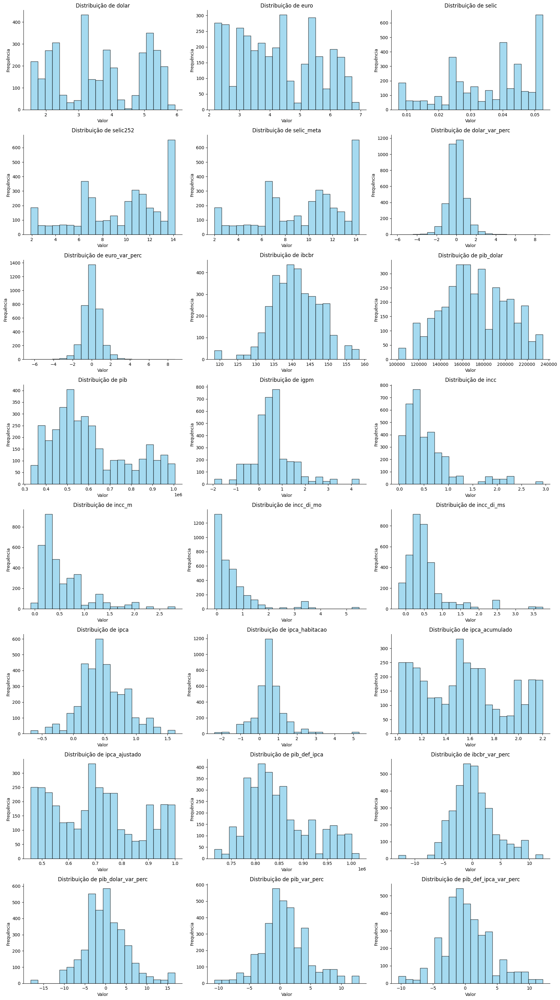

In [93]:

# Definir o número de colunas e calcular o número de linhas necessárias
num_colunas = 3
num_graficos = len(df_bcb_consolidado.columns)
num_linhas = math.ceil(num_graficos / num_colunas)

# Configurações gerais para o layout dos gráficos
fig, axes = plt.subplots(nrows=num_linhas, ncols=num_colunas, figsize=(18, num_linhas * 4))
axes = axes.flatten()  # Achata o array de eixos para iteração

# Iterar sobre as colunas do DataFrame consolidado e os eixos do gráfico
for i, (coluna, dados) in enumerate(df_bcb_consolidado.items()):
    axes[i].hist(dados.dropna(), bins=20, alpha=0.75, color='skyblue', edgecolor='black')
    axes[i].set_title(f'Distribuição de {coluna}')
    axes[i].set_xlabel('Valor')
    axes[i].set_ylabel('Frequência')
    axes[i].spines['top'].set_visible(False)
    axes[i].spines['right'].set_visible(False)

# Esconder eixos extras caso o número de gráficos não seja múltiplo de num_colunas
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Ajustar o layout para melhor visualização
plt.tight_layout()
plt.show()


## 5.3. Gráfico de Série Temporal

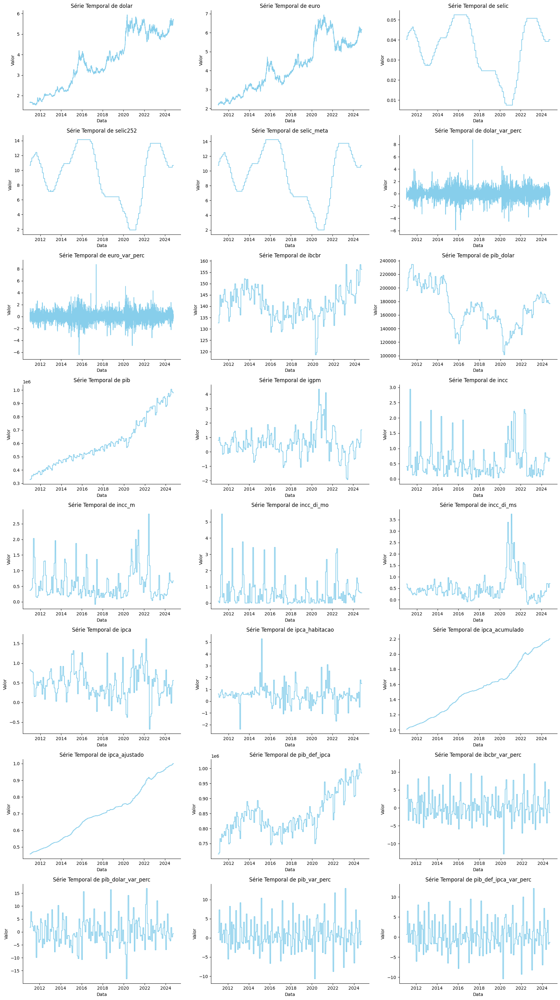

In [94]:
# Definir o número de colunas e calcular o número de linhas necessárias
num_colunas = 3
num_graficos = len(df_bcb_consolidado.columns)
num_linhas = math.ceil(num_graficos / num_colunas)

# Configurações gerais para o layout dos gráficos
fig, axes = plt.subplots(nrows=num_linhas, ncols=num_colunas, figsize=(18, num_linhas * 4))
axes = axes.flatten()  # Achata o array de eixos para iteração

# Iterar sobre as colunas do DataFrame consolidado e os eixos do gráfico
for i, (coluna, dados) in enumerate(df_bcb_consolidado.items()):
    axes[i].plot(dados.dropna(), color='skyblue', linewidth=1.5)
    axes[i].set_title(f'Série Temporal de {coluna}')
    axes[i].set_xlabel('Data')
    axes[i].set_ylabel('Valor')
    axes[i].spines['top'].set_visible(False)
    axes[i].spines['right'].set_visible(False)

# Esconder eixos extras caso o número de gráficos não seja múltiplo de num_colunas
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Ajustar o layout para melhor visualização
plt.tight_layout()
plt.show()


## 5.4. Decomposição das Séries

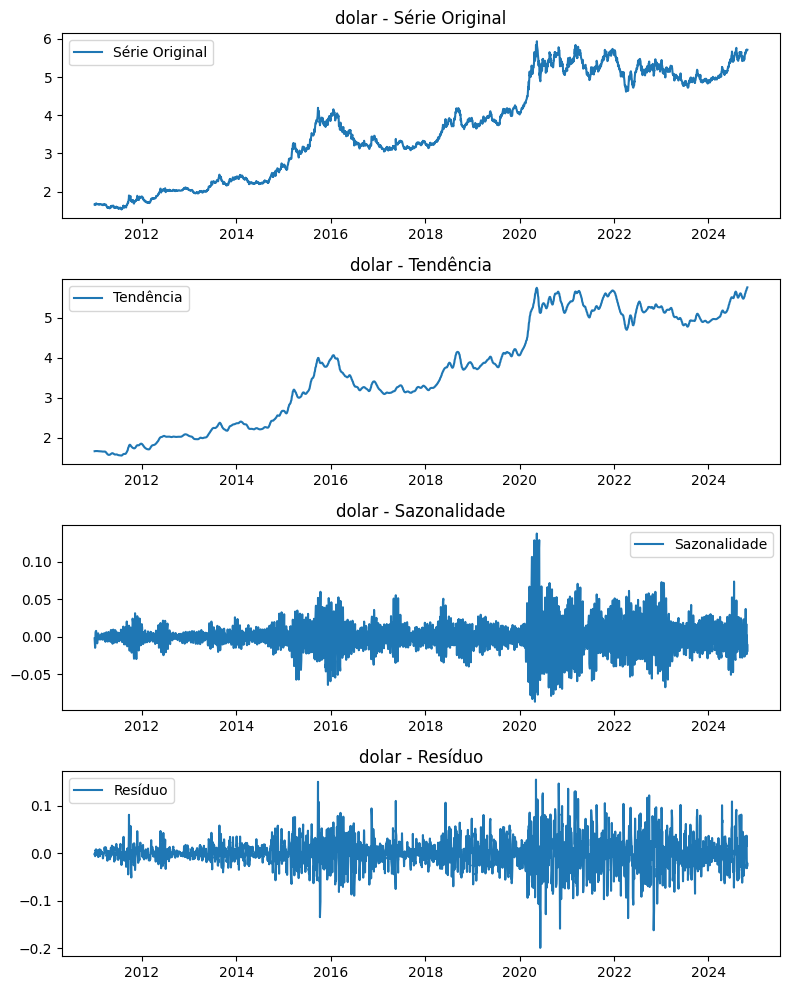

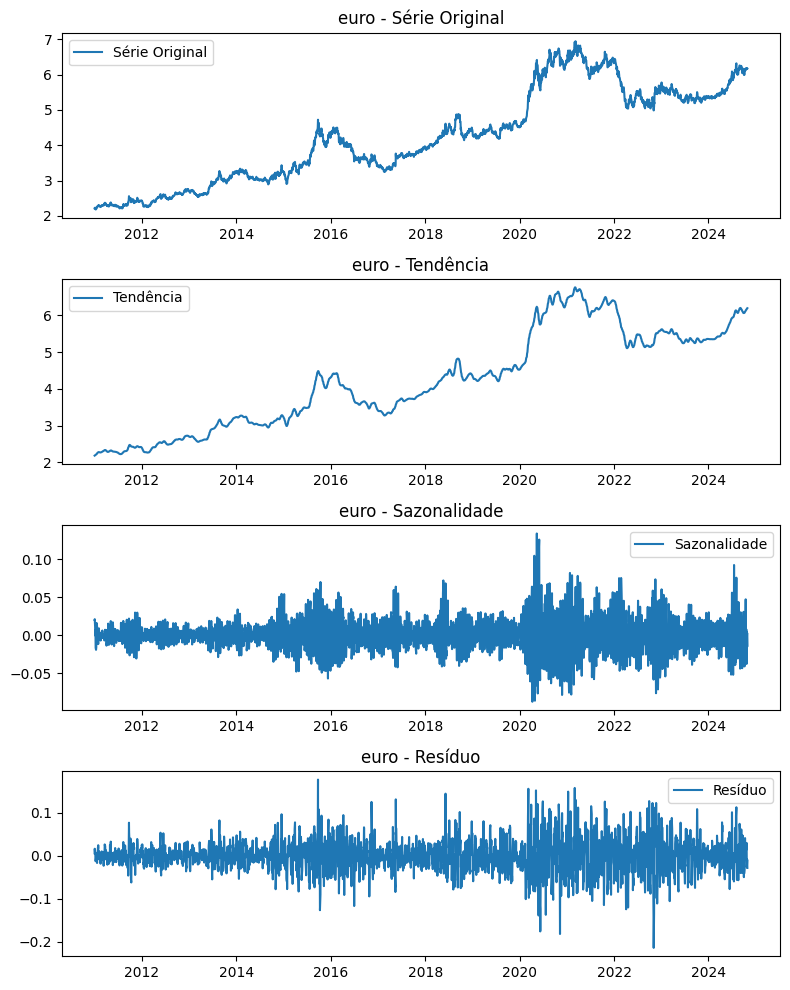

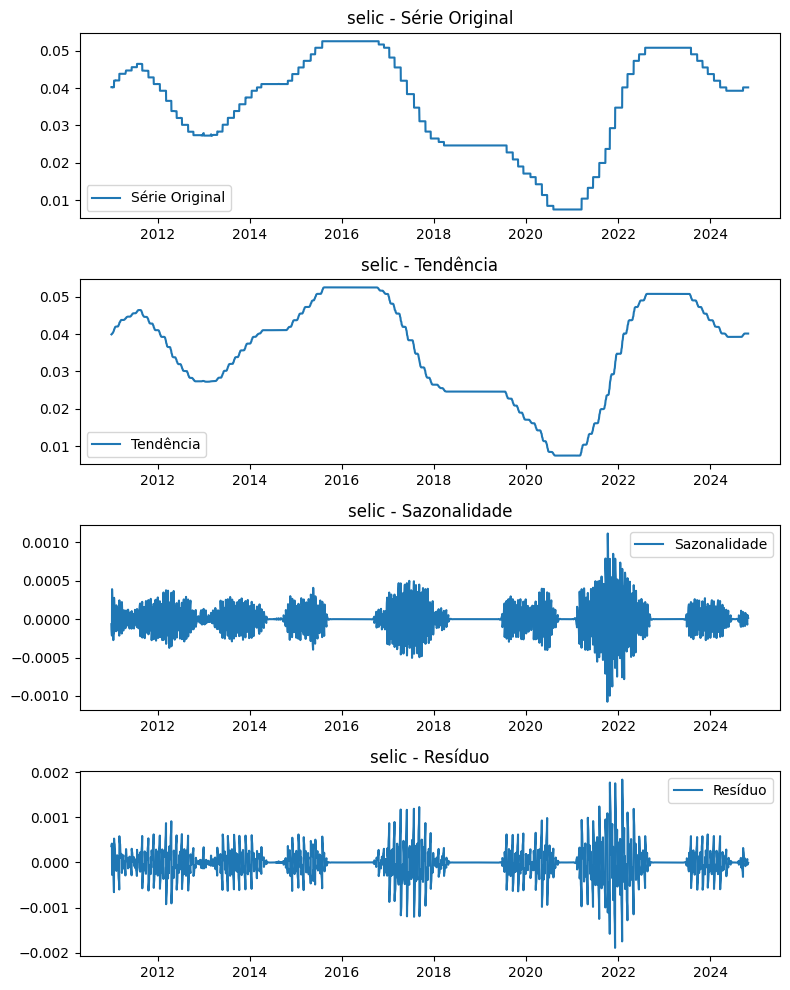

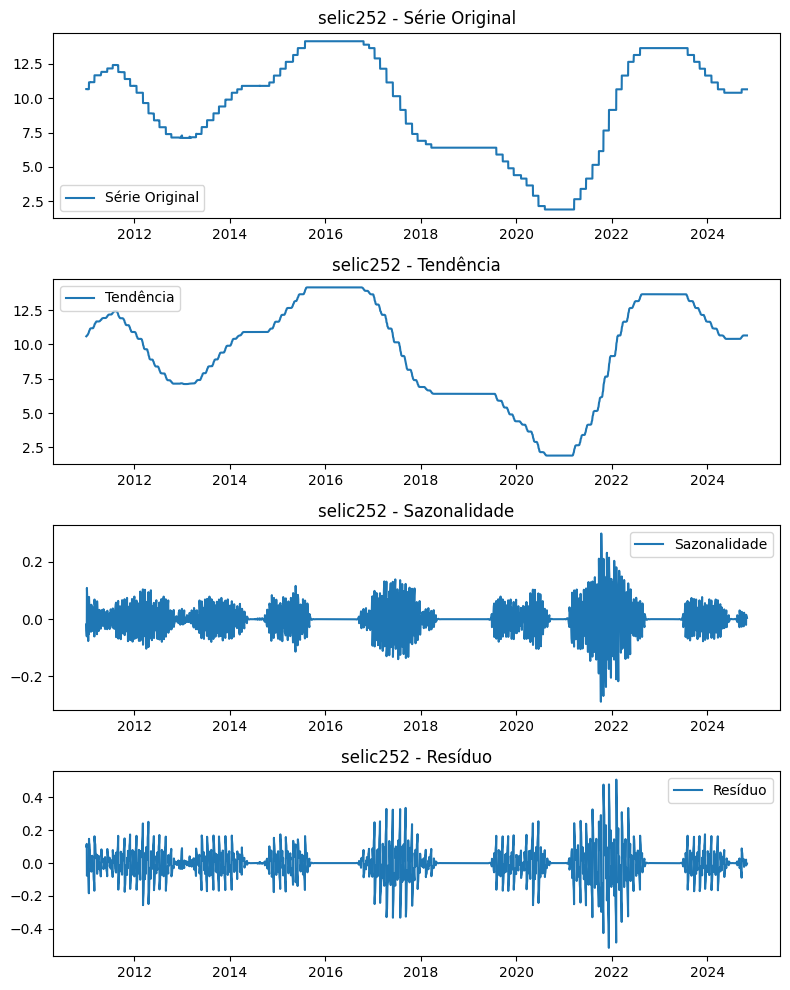

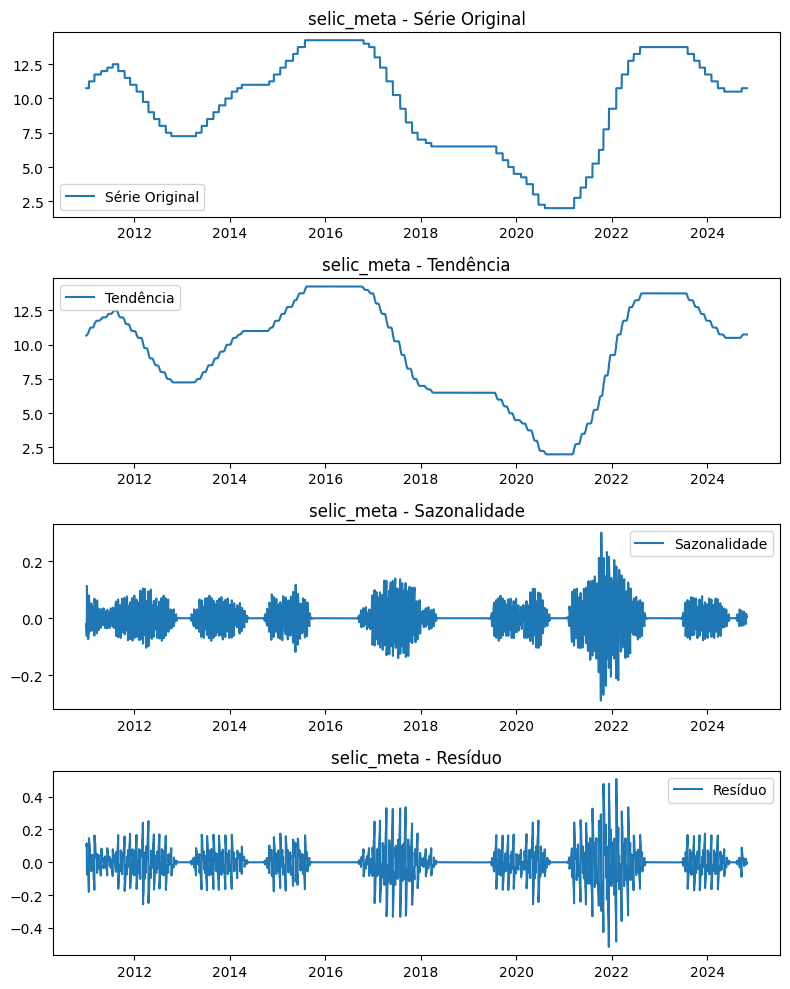

...

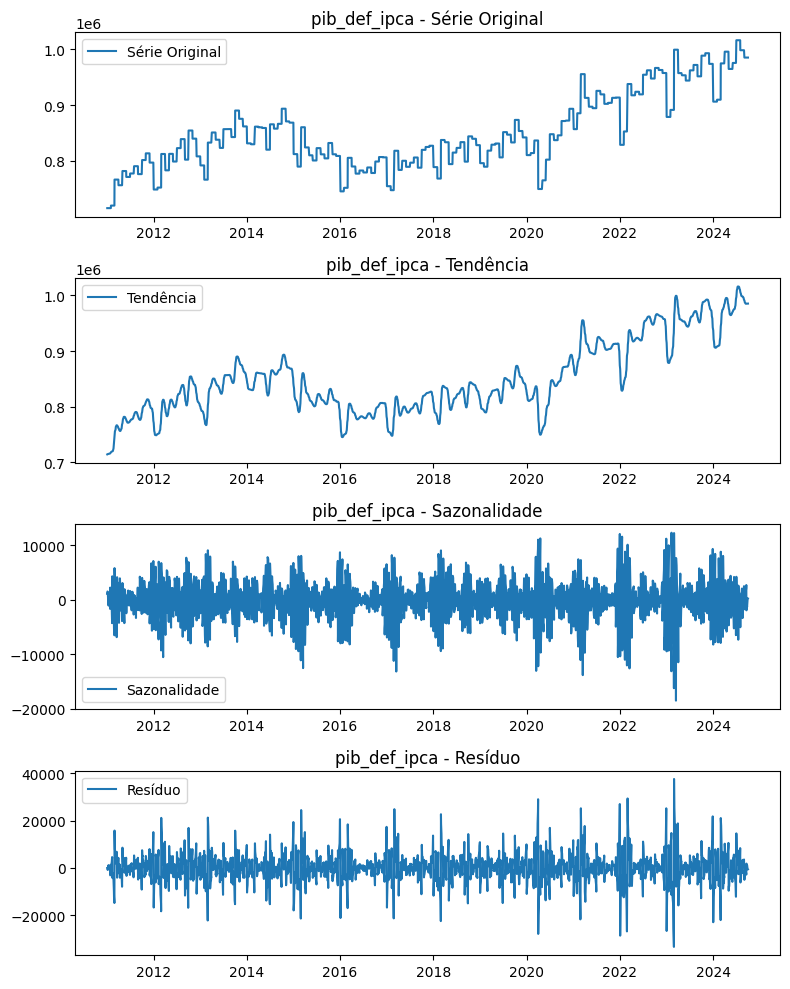

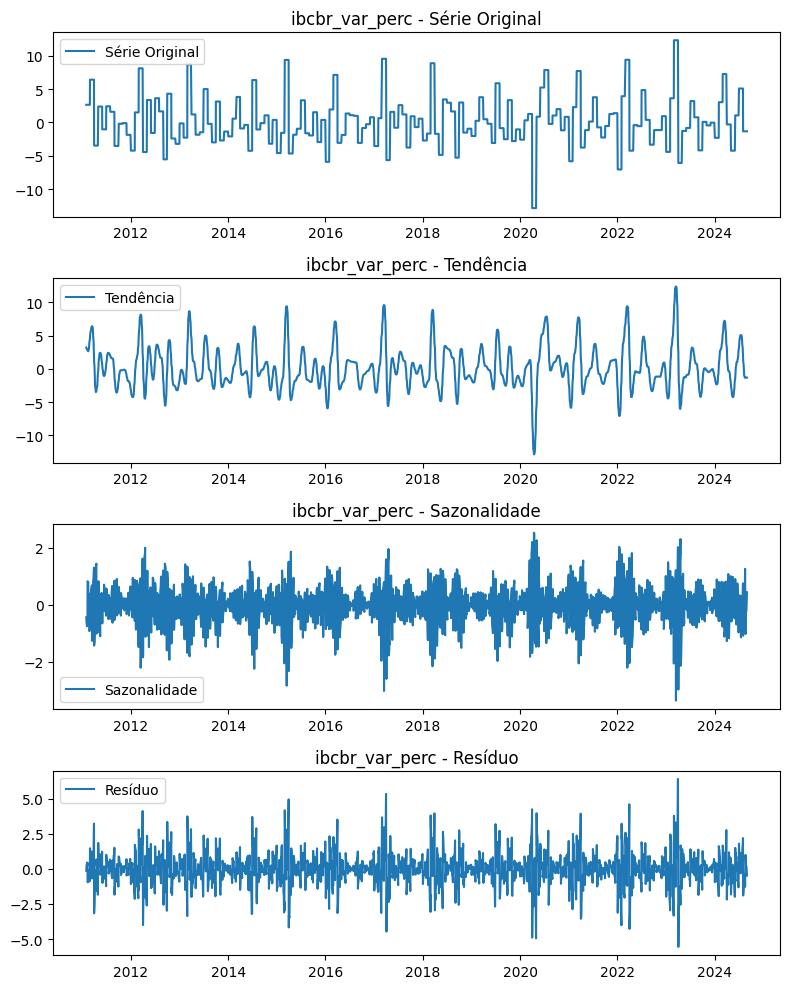

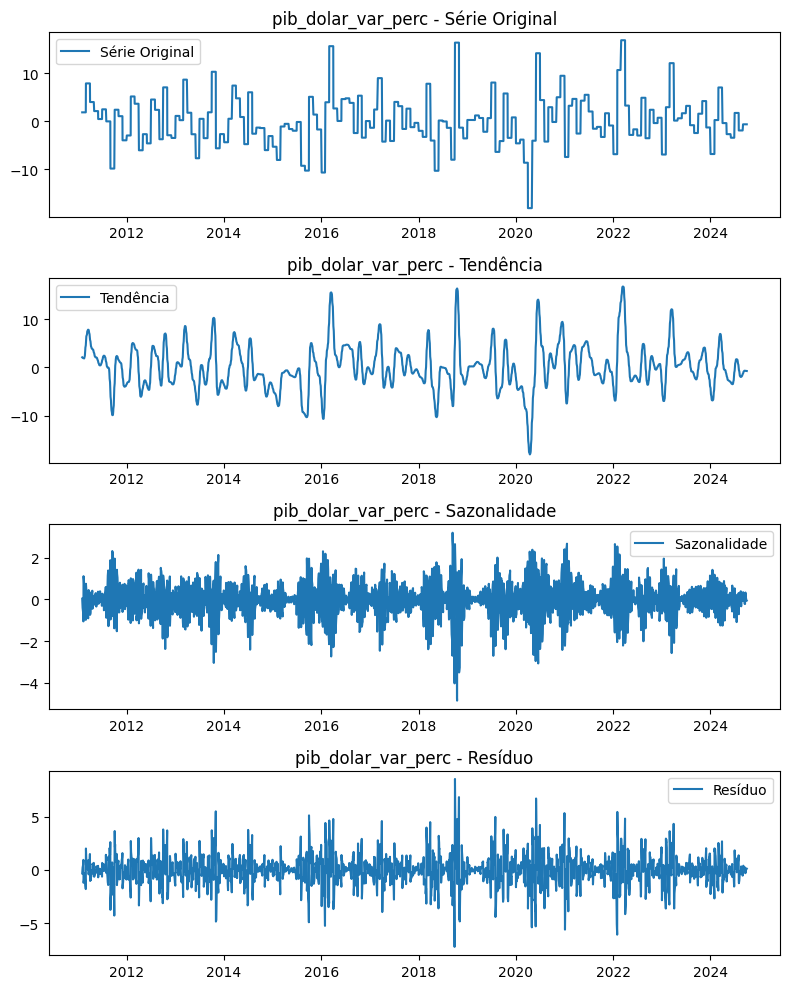

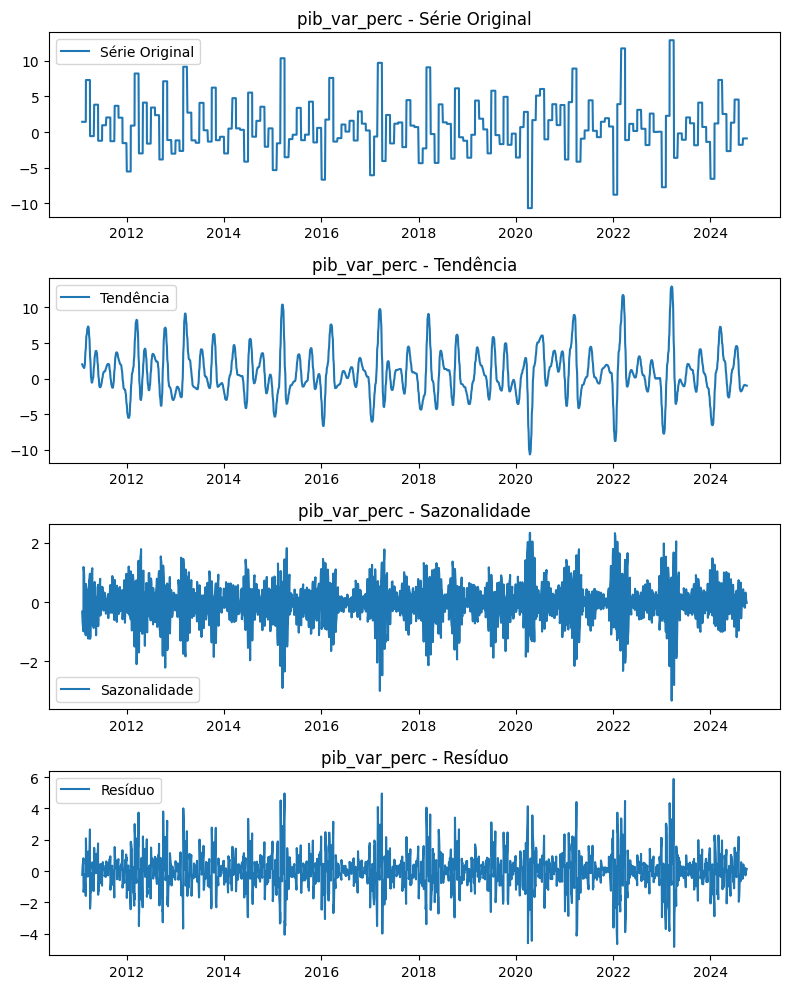

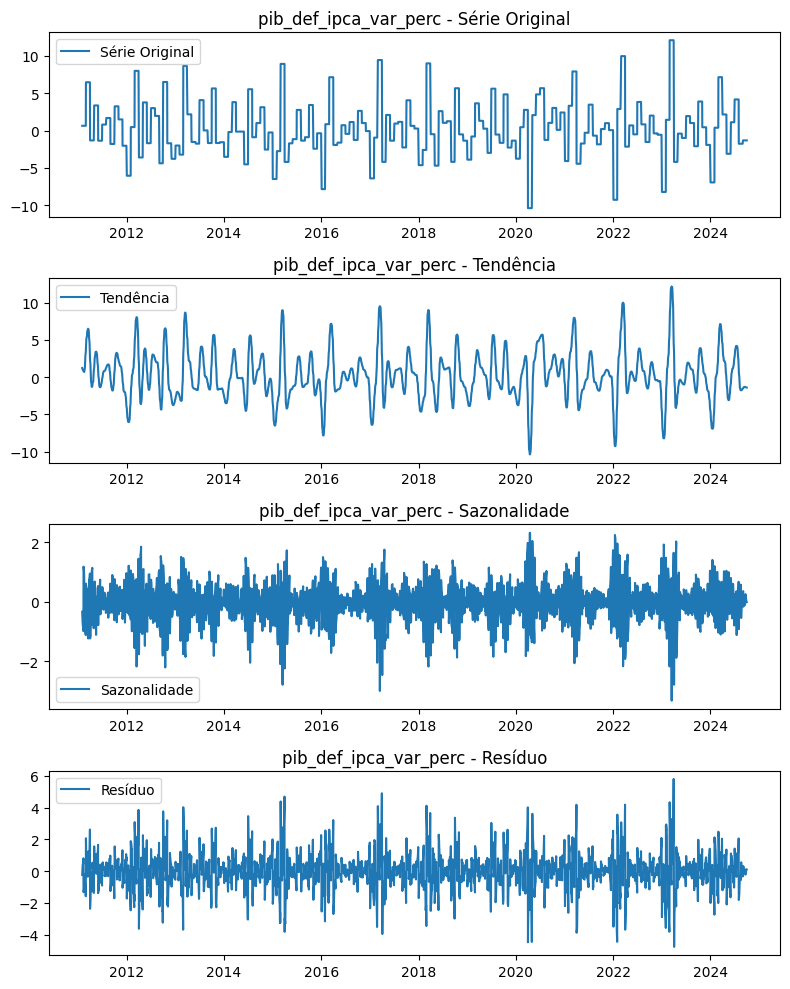

In [95]:

# Definir função para decomposição da série de df_bcb_consolidado
def decompor_serie_temporal(serie, nome_serie, period=12):
    stl = STL(serie.dropna(), period=period)
    resultado = stl.fit()
    sazonal, tendencia, residuo = resultado.seasonal, resultado.trend, resultado.resid

    # Plotar os componentes
    plt.figure(figsize=(8, 10))
    plt.subplot(4, 1, 1)
    plt.plot(serie, label='Série Original')
    plt.title(f'{nome_serie} - Série Original', fontsize=12)
    plt.legend()

    plt.subplot(4, 1, 2)
    plt.plot(tendencia, label='Tendência')
    plt.title(f'{nome_serie} - Tendência', fontsize=12)
    plt.legend()

    plt.subplot(4, 1, 3)
    plt.plot(sazonal, label='Sazonalidade')
    plt.title(f'{nome_serie} - Sazonalidade', fontsize=12)
    plt.legend()

    plt.subplot(4, 1, 4)
    plt.plot(residuo, label='Resíduo')
    plt.title(f'{nome_serie} - Resíduo', fontsize=12)
    plt.legend()

    plt.tight_layout()
    plt.show()

# Aplicar a função a cada série temporal no DataFrame consolidado
for coluna in df_bcb_consolidado.columns:
    decompor_serie_temporal(df_bcb_consolidado[coluna], coluna, period=12)


## 5.5. Transformação logarítmica


Estatísticas descritivas para as séries transformadas (Log com Ajuste):
                            count       mean       std           min  \
dolar_log                  3472.0   1.230332  0.391430  4.282046e-01   
euro_log                   3472.0   1.393230  0.322618  7.793707e-01   
selic_log                  3472.0  -3.431371  0.500095 -4.896994e+00   
selic252_log               3472.0   2.143252  0.516147  6.418539e-01   
selic_meta_log             3472.0   2.157001  0.506264  6.931472e-01   
dolar_var_perc_log         3471.0   1.926694  0.136377  0.000000e+00   
euro_var_perc_log          3471.0   1.999066  0.127295  0.000000e+00   
ibcbr_log                  3428.0   4.947783  0.047569  4.775841e+00   
pib_dolar_log              3449.0  12.039964  0.177379  1.152683e+01   
pib_log                    3449.0  13.271239  0.285455  1.269952e+01   
igpm_log                   3470.0   1.221072  0.273001 -2.220446e-16   
incc_log                   3470.0   0.417735  0.275270  0.00000

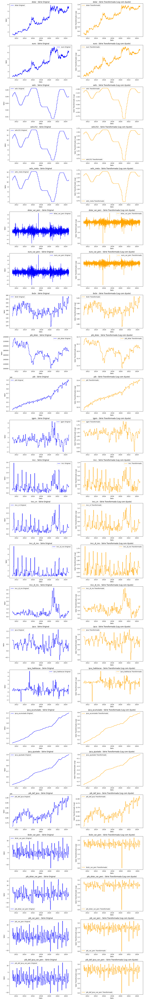

In [96]:
# Logarítmo

# Função para aplicar a transformação de log com ajuste, apenas se necessário
def aplicar_log_transformacao(serie):
    # Verifica se a série possui valores menores ou iguais a zero
    if serie.min() <= 0:
        # Calcular o valor de ajuste: 1 + |menor valor|
        ajuste = 1 + abs(serie.min())
        # Ajustar a série somando o valor de ajuste
        serie_ajustada = serie + ajuste
    else:
        # Caso não haja valores menores ou iguais a zero, nenhum ajuste é necessário
        serie_ajustada = serie

    # Aplicar o logaritmo à série (ajustada ou original)
    serie_log_transformada = np.log(serie_ajustada)
    return serie_log_transformada

# DataFrame para armazenar as séries transformadas
df_bcb_log = pd.DataFrame()

# Iterar sobre cada coluna de `df_bcb_consolidado` e aplicar a transformação
for nome_serie in df_bcb_consolidado.columns:
    # Aplicar a transformação de log
    serie_transformada = aplicar_log_transformacao(df_bcb_consolidado[nome_serie])

    # Armazenar a série transformada no DataFrame `df_bcb_log`
    df_bcb_log[f'{nome_serie}_log'] = serie_transformada

# DataFrame para armazenar as estatísticas descritivas de todas as séries transformadas
estatisticas_transformadas = df_bcb_log.describe().T

# Exibir as estatísticas descritivas consolidadas
print("\nEstatísticas descritivas para as séries transformadas (Log com Ajuste):")
print(estatisticas_transformadas)

# Configurar layout dos subplots com duas colunas (original e transformada lado a lado)
num_series = len(df_bcb_consolidado.columns)
fig, axes = plt.subplots(nrows=num_series, ncols=2, figsize=(14, 4 * num_series))
fig.tight_layout(pad=4.0)

# Loop para plotar cada série original e sua transformação
for i, nome_serie in enumerate(df_bcb_consolidado.columns):
    # Série original na coluna da esquerda
    axes[i, 0].plot(df_bcb_consolidado.index, df_bcb_consolidado[nome_serie], label=f'{nome_serie} Original', color='blue')
    axes[i, 0].set_title(f"{nome_serie} - Série Original")
    axes[i, 0].set_ylabel("Valor")
    axes[i, 0].set_xlabel("Data")
    axes[i, 0].legend()

    # Série transformada (log) na coluna da direita
    serie_log = df_bcb_log[f'{nome_serie}_log']
    axes[i, 1].plot(serie_log.index, serie_log, label=f'{nome_serie} Transformado', color='orange')
    axes[i, 1].set_title(f"{nome_serie} - Série Transformada (Log com Ajuste)")
    axes[i, 1].set_ylabel("Valor Transformado (Log)")
    axes[i, 1].set_xlabel("Data")
    axes[i, 1].legend()

plt.tight_layout()
plt.show()


Em séries com muita volatilidade ou variabilidade (como taxas de câmbio ou índices de mercado), a transformação logarítmica parece reduzir a amplitude das oscilações, tornando mais fácil visualizar os ciclos ou padrões sazonais.

## 5.6. DATAFRAME 2

In [97]:
# Definindo os índices de ambos os DataFrames para realizar a junção com o índice como chave
df_retorno_log.set_index(df_retorno_log.index, inplace=True)
df_bcb_log.set_index(df_bcb_log.index, inplace=True)

# Realizando a junção com o índice como chave
df_retorno_log = df_retorno_log.join(df_bcb_log, how='left')

# Exibindo o DataFrame atualizado para o usuário
# df_retorno_log

# Exibir as colunas do DataFrame para verificar a junção
print("Colunas do DataFrame após a junção:")
print(df_retorno_log.columns)

# Exibir as estatísticas descritivas para cada coluna
print("\nEstatísticas descritivas do DataFrame após a junção:")
estatisticas_descritivas = df_retorno_log.describe()
print(estatisticas_descritivas)

# Calcular a correlação entre as colunas do DataFrame
print("\nMatriz de correlação entre as variáveis:")
correlacao = df_retorno_log.corr()
print(correlacao)

Colunas do DataFrame após a junção:
Index(['Retorno_IFIX_log', 'Retorno_Indice_Geral_log',
       'Retorno_Residencial_log', 'Retorno_Hibrido_log',
       'Retorno_Multicategoria_log', 'Retorno_TVM_log',
       'Retorno_Logistica_log', 'Retorno_Shoppings_log',
       'Retorno_Lajes_Corporativas_log', 'Retorno_Educacional_log',
       'Retorno_Hospital_log', 'Retorno_Agencias_log', 'Retorno_Hotel_log',
       'Retorno_Outros_log', 'pandemia_dummy', 'lockdown_dummy',
       'impeachment_dummy', 'outlier_ifix', 'outlier_indice_geral',
       'outlier_residencial', 'outlier_hibrido', 'outlier_multicategoria',
       'outlier_tvm', 'outlier_logistica', 'outlier_shoppings',
       'outlier_lajes_corporativas', 'outlier_educacional', 'outlier_hospital',
       'outlier_agencias', 'outlier_hotel', 'outlier_outros', 'dolar_log',
       'euro_log', 'selic_log', 'selic252_log', 'selic_meta_log',
       'dolar_var_perc_log', 'euro_var_perc_log', 'ibcbr_log', 'pib_dolar_log',
       'pib_log', 'igp

In [98]:
# Apresentar colunas de df_retorno_log
df_retorno_log.columns

Index(['Retorno_IFIX_log', 'Retorno_Indice_Geral_log',
       'Retorno_Residencial_log', 'Retorno_Hibrido_log',
       'Retorno_Multicategoria_log', 'Retorno_TVM_log',
       'Retorno_Logistica_log', 'Retorno_Shoppings_log',
       'Retorno_Lajes_Corporativas_log', 'Retorno_Educacional_log',
       'Retorno_Hospital_log', 'Retorno_Agencias_log', 'Retorno_Hotel_log',
       'Retorno_Outros_log', 'pandemia_dummy', 'lockdown_dummy',
       'impeachment_dummy', 'outlier_ifix', 'outlier_indice_geral',
       'outlier_residencial', 'outlier_hibrido', 'outlier_multicategoria',
       'outlier_tvm', 'outlier_logistica', 'outlier_shoppings',
       'outlier_lajes_corporativas', 'outlier_educacional', 'outlier_hospital',
       'outlier_agencias', 'outlier_hotel', 'outlier_outros', 'dolar_log',
       'euro_log', 'selic_log', 'selic252_log', 'selic_meta_log',
       'dolar_var_perc_log', 'euro_var_perc_log', 'ibcbr_log', 'pib_dolar_log',
       'pib_log', 'igpm_log', 'incc_log', 'incc_m_log', 'i

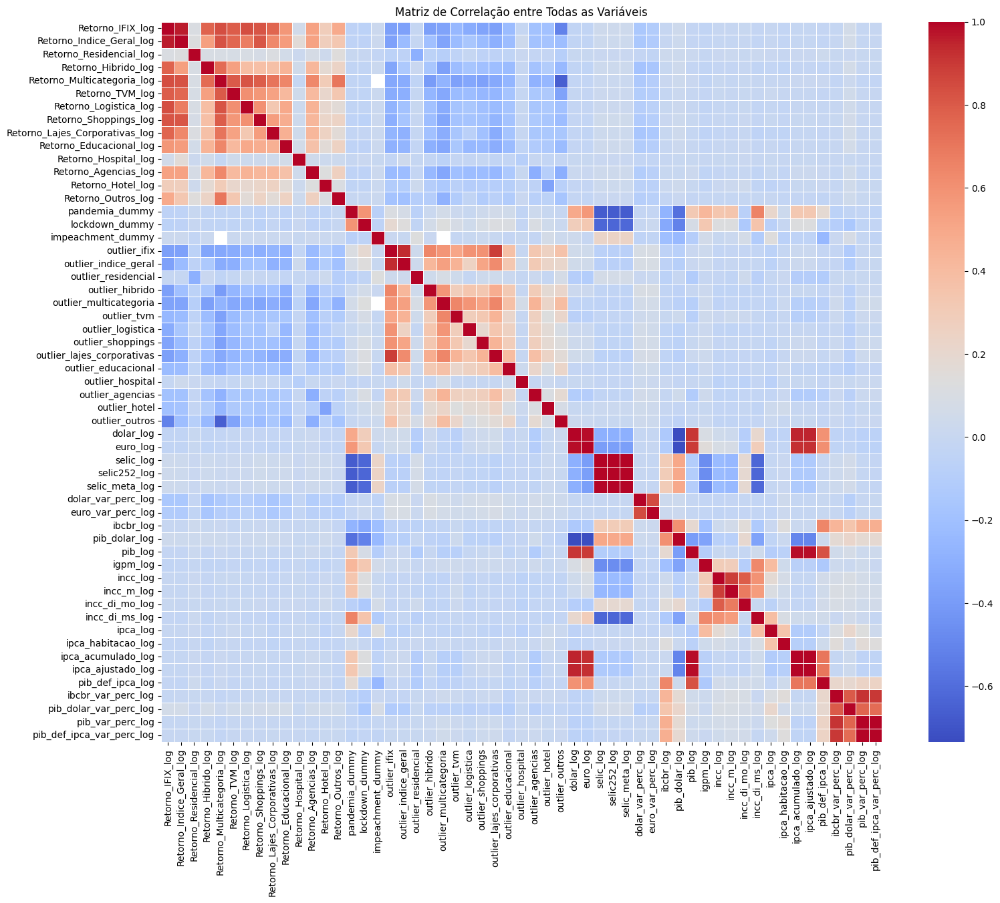

In [99]:
# @title Matriz de Correlação

# Calculando a matriz de correlação para todas as variáveis
correlacao = df_retorno_log.corr()

# Configurando o tamanho da figura para acomodar todas as variáveis
plt.figure(figsize=(18, 14))

# Plotando o heatmap da matriz de correlação para todas as variáveis, sem anotações
sns.heatmap(correlacao, annot=False, cmap="coolwarm", cbar=True,
            square=True, linewidths=0.5)

# Adicionando título e exibindo a figura
plt.title("Matriz de Correlação entre Todas as Variáveis")
plt.show()

2. Relacionamentos Entre Variáveis Financeiras
As variáveis de retorno dos ativos, como Retorno_IFIX_log, Retorno_Residencial_log, Retorno_Logistica_log, etc., podem ter correlações positivas entre si. Isso é esperado se essas variáveis refletem o comportamento de retornos de ativos similares ou influenciados por fatores econômicos comuns.
As variáveis econômicas, como selic252_retorno, pib_retorno, ipca_retorno, podem estar correlacionadas entre si e com variáveis de retorno dos ativos, refletindo o impacto das condições econômicas nos ativos financeiros.

3. Impacto das Variáveis Macroeconômicas
SELIC (selic252_retorno e selic252_bcb): Geralmente tem uma correlação negativa com retornos de ativos, já que taxas de juros mais altas tendem a desvalorizar ativos de risco.
Inflação (IPCA): Pode estar correlacionada com retornos de ativos mais voláteis ou indexados à inflação. É possível ver correlação entre variáveis como ipca_retorno e algumas variáveis de retorno.
PIB (pib_retorno, pib_bcb): Correlações positivas com variáveis de retorno de ativos indicam que crescimento econômico pode estar relacionado a um desempenho positivo desses ativos.

4. Interpretação dos Dummy Variables
Variáveis como pandemia_dummy e impeachment_dummy podem ter correlações interessantes com retornos de ativos. Por exemplo, uma correlação positiva ou negativa com esses indicadores poderia sugerir que eventos específicos (como a pandemia ou um impeachment) tiveram impacto significativo em determinados setores.

5. Identificação de Correlações Negativas
As células azuis indicam relações negativas. Isso pode ser observado entre variáveis de retorno e variáveis como taxa de juros ou inflação, dependendo da economia. Relações negativas fortes podem sugerir que aumentos em uma variável estão associados a quedas em outra, o que é comum em cenários onde taxas de juros mais altas prejudicam retornos de ativos de risco.

# **6. ANÁLISE DOS DADOS**

## 6.1. Visualização da Série de Retornos

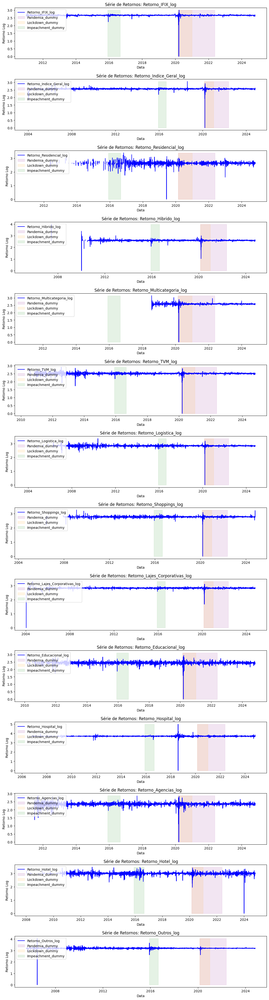

In [100]:

# Definir as séries de retorno e dummies relevantes
retornos = [
    'Retorno_IFIX_log', 'Retorno_Indice_Geral_log', 'Retorno_Residencial_log', 'Retorno_Hibrido_log',
    'Retorno_Multicategoria_log', 'Retorno_TVM_log', 'Retorno_Logistica_log', 'Retorno_Shoppings_log',
    'Retorno_Lajes_Corporativas_log', 'Retorno_Educacional_log', 'Retorno_Hospital_log', 'Retorno_Agencias_log',
    'Retorno_Hotel_log', 'Retorno_Outros_log'
]

outliers = [
    'outlier_ifix_retorno', 'outlier_indice_geral_retorno', 'outlier_residencial_retorno', 'outlier_hibrido_retorno',
    'outlier_multicategoria_retorno', 'outlier_tvm_retorno', 'outlier_logistica_retorno', 'outlier_shoppings_retorno',
    'outlier_lajes_corporativas_retorno', 'outlier_educacional_retorno', 'outlier_hospital_retorno',
    'outlier_agencias_retorno', 'outlier_hotel_retorno', 'outlier_outros_retorno'
]

# Dummies de eventos gerais
event_dummies = ['pandemia_dummy', 'lockdown_dummy', 'impeachment_dummy']

# Configurar a figura e os subplots
fig, axes = plt.subplots(len(retornos), 1, figsize=(12, 3 * len(retornos)))
fig.tight_layout(pad=4.0)

# Iterar por cada série de retorno e aplicar as dummies correspondentes
for ax, retorno_col, outlier_col in zip(axes, retornos, outliers):
    # Plotar a série de retorno
    ax.plot(df_retorno_log.index, df_retorno_log[retorno_col], label=retorno_col, color='blue')

    # Adicionar as áreas de destaque para outliers específicos
    if outlier_col in df_retorno_log.columns:
        ax.fill_between(df_retorno_log.index,
                        df_retorno_log[retorno_col].min(), df_retorno_log[retorno_col].max(),
                        where=df_retorno_log[outlier_col] == 1, color='red', alpha=0.2, label='Outliers')

    # Adicionar as áreas de destaque para as dummies de evento (pandemia, lockdown, impeachment)
    for event in event_dummies:
        if event in df_retorno_log.columns:
            color = 'purple' if event == 'pandemia_dummy' else ('orange' if event == 'lockdown_dummy' else 'green')
            ax.fill_between(df_retorno_log.index,
                            df_retorno_log[retorno_col].min(), df_retorno_log[retorno_col].max(),
                            where=df_retorno_log[event] == 1, color=color, alpha=0.1, label=event.capitalize())

    # Customizar o título e as legendas
    ax.set_title(f'Série de Retornos: {retorno_col}')
    ax.set_xlabel('Data')
    ax.set_ylabel('Retorno Log')
    ax.legend(loc='upper left')

plt.show()

Analisando visualmente os gráficos das séries de retornos logarítmicos com variáveis dummy (como pandemia, lockdown e impeachment), vemos que essas séries apresentam alta frequência, picos de volatilidade e choques estruturais. Essas características sugerem que os testes de estacionariedade precisam lidar bem com eventos externos e variabilidade na série.

## 6.2. Teste de Normalidade

### Normal Q-Q Plot

O Normal Q-Q Plot (Quantile-Quantile Plot) é uma ferramenta de análise visual que compara a distribuição de uma série de dados com uma distribuição normal teórica. O objetivo é verificar o quão próximo os dados estão de seguir uma distribuição normal. Aqui estão os passos para interpretar um Q-Q plot:


**1. Linha de Referência (Diagonal)**

Linha reta: No gráfico, uma linha diagonal serve como referência. Os dados são comparados com essa linha, que representa a distribuição normal teórica.
Pontos próximos à linha: Se os pontos do Q-Q plot se alinham bem com a linha, isso indica que a série de dados segue aproximadamente uma distribuição normal.
Desvios da linha: Se os pontos se desviam significativamente da linha, os dados provavelmente não seguem uma distribuição normal.

**2. Cauda e Centro da Distribuição**

Centro da distribuição: A parte central do gráfico corresponde aos quantis medianos. Os pontos nessa região representam a tendência central dos dados. Desvios aqui sugerem uma distribuição assimétrica.

Caudas da distribuição: Se as caudas do Q-Q plot se desviam para cima em relação à linha, a distribuição tem uma cauda direita pesada (mais dados nas extremidades superiores).
Se as caudas do Q-Q plot se desviam para baixo em relação à linha, a distribuição tem uma cauda esquerda pesada (mais dados nas extremidades inferiores).

**3. Distribuições Assimétricas e Outliers**

Distribuição assimétrica: Uma curva em forma de "S" ou "C" indica uma assimetria. Isso pode significar que a distribuição é mais densa de um lado.
Outliers: Pontos que estão muito distantes da linha indicam possíveis outliers. Esses valores são inesperadamente altos ou baixos comparados com uma distribuição normal.

**4. Interpretação Prática**

Ajuste com a linha: Se os pontos seguem a linha diagonal, o comportamento dos dados pode ser adequadamente modelado com técnicas que assumem normalidade.
Desvios consideráveis: Caso contrário, pode ser necessário aplicar transformações nos dados ou usar métodos estatísticos que não exijam a suposição de normalidade.

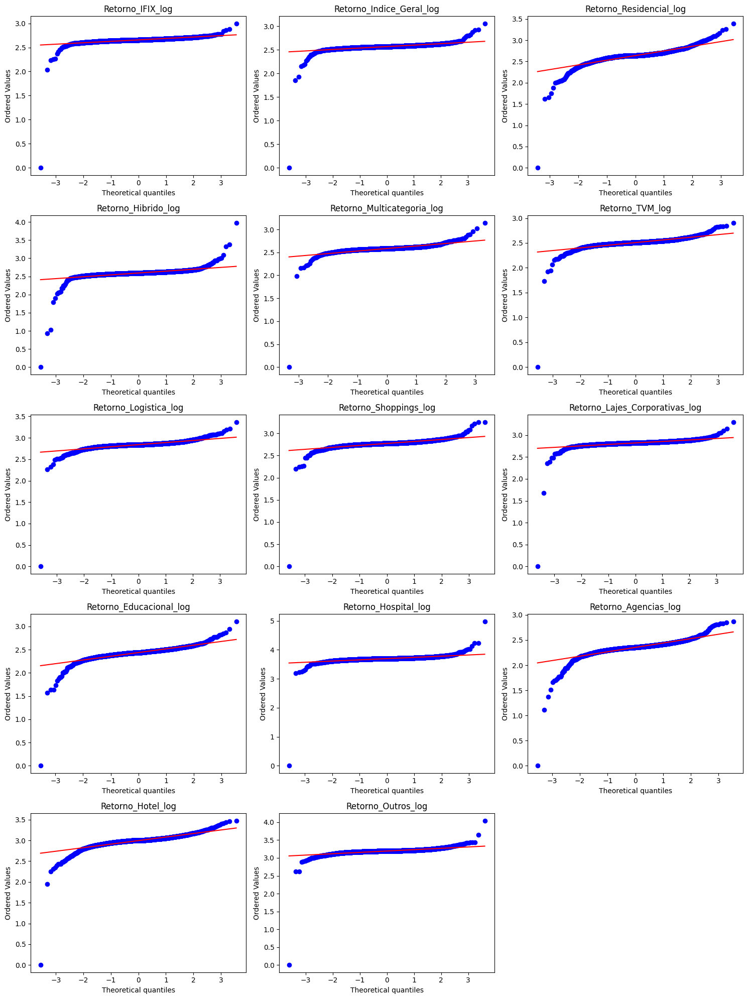

In [109]:
# Criar a figura com subplots ajustados
plt.figure(figsize=(15, 20))
n_cols = 3  # Número de gráficos por linha

# Lista de retornos no DataFrame `df_retorno_log`
retornos = [
    'Retorno_IFIX_log', 'Retorno_Indice_Geral_log', 'Retorno_Residencial_log', 'Retorno_Hibrido_log',
    'Retorno_Multicategoria_log', 'Retorno_TVM_log', 'Retorno_Logistica_log', 'Retorno_Shoppings_log',
    'Retorno_Lajes_Corporativas_log', 'Retorno_Educacional_log', 'Retorno_Hospital_log', 'Retorno_Agencias_log',
    'Retorno_Hotel_log', 'Retorno_Outros_log'
]

# Loop pelas séries de retornos para criar o Q-Q plot de cada uma
for i, retorno in enumerate(retornos, start=1):
    plt.subplot((len(retornos) + n_cols - 1) // n_cols, n_cols, i)
    stats.probplot(df_retorno_log[retorno].dropna(), dist="norm", plot=plt)
    plt.title(retorno)

# Ajuste de layout para que os gráficos não se sobreponham
plt.tight_layout()
plt.show()

Para muitos retornos (como Retorno_IFIX_log, Retorno_Indice_Geral_log, Retorno_Multicategoria_log, etc.), os pontos intermediários seguem de perto a linha de normalidade, indicando que a parte central da distribuição pode ser próxima da normalidade. Contudo, o desvio nas extremidades sugere que esses retornos possuem outliers ou eventos extremos que não se alinham com a suposição de normalidade.

Algumas séries, como Retorno_Hospital_log e Retorno_Hotel_log, exibem pontos isolados nas extremidades que se afastam da linha de normalidade. Esses pontos são indicativos de outliers significativos e sugerem que a série de retornos é suscetível a grandes desvios ocasionais.

A presença de outliers e caudas longas pode ser explicada por eventos econômicos, volatilidade do mercado, ou mudanças estruturais nos setores representados pelas séries. Esses desvios podem ser importantes para modelagem e devem ser considerados ao escolher modelos estatísticos, especialmente se a normalidade dos retornos é uma suposição para um modelo específico.

A maioria das séries compartilha um padrão similar: os pontos iniciais e finais tendem a se afastar da linha de normalidade. Esse padrão sugere que há uma consistência na forma como essas séries de retorno desviam-se da normalidade.

Diagnóstico: as séries seguem a linha diagonal com leves descolamento nos extremos, o que pode indicar que a série possui caudas um pouco mais "pesadas" ou "leves" do que uma distribuição normal perfeita, mas isso não necessariamente impede a aplicação de métodos que assumem normalidade.

### Teste de Shapiro-Wilk

O teste de Shapiro-Wilk é uma metodologia estatística que avalia se uma amostra de dados é compatível com a distribuição normal. Especificamente, ele testa a hipótese nula de que os dados provêm de uma distribuição normal contra a hipótese alternativa de que os dados não seguem uma distribuição normal. É um dos testes de normalidade mais comuns devido à sua sensibilidade e precisão, especialmente em amostras pequenas a moderadas.

Principais Elementos do Teste de Shapiro-Wilk
Hipótese Nula (H0): A amostra segue uma distribuição normal.
Hipótese Alternativa (H1): A amostra não segue uma distribuição normal.
Cálculo
O teste calcula um valor estatístico W, que mede o quanto a amostra se desvia de uma curva normal. Em termos gerais:

Valores de W próximos a 1 sugerem que a amostra é compatível com a normalidade.
Valores de W menores indicam uma maior probabilidade de que os dados não sigam uma distribuição normal.
Interpretação dos Resultados
Valor-p (p-value):

Um valor-p alto (geralmente maior que 0,05) sugere que não há evidência estatística suficiente para rejeitar a hipótese de normalidade. Assim, presume-se que a distribuição da amostra é compatível com a normalidade.
Um valor-p baixo (geralmente menor que 0,05) indica que a amostra é significativamente diferente de uma distribuição normal.
Conclusão:

Se p > 0,05: Aceita-se a hipótese nula. A amostra pode ser considerada como normal.
Se p ≤ 0,05: Rejeita-se a hipótese nula, indicando que a amostra provavelmente não segue uma distribuição normal.
Aplicação Prática
O teste de Shapiro-Wilk é útil em:

Modelos estatísticos que assumem normalidade dos resíduos ou das variáveis.
Verificação de pré-requisitos para testes estatísticos paramétricos, como ANOVA e regressão linear, que requerem normalidade dos dados para uma análise precisa.

In [110]:
import pandas as pd
from scipy.stats import shapiro

# Lista das séries de retorno no DataFrame
retornos = [
    'Retorno_IFIX_log', 'Retorno_Indice_Geral_log', 'Retorno_Residencial_log', 'Retorno_Hibrido_log',
    'Retorno_Multicategoria_log', 'Retorno_TVM_log', 'Retorno_Logistica_log', 'Retorno_Shoppings_log',
    'Retorno_Lajes_Corporativas_log', 'Retorno_Educacional_log', 'Retorno_Hospital_log', 'Retorno_Agencias_log',
    'Retorno_Hotel_log', 'Retorno_Outros_log'
]

# Função para aplicar o teste de Shapiro-Wilk
def aplicar_teste_shapiro(df, series_list):
    resultados = []
    for serie in series_list:
        dados_limpos = df[serie].dropna()  # Remover valores NaN da série

        # Aplicar o teste de Shapiro-Wilk
        estatistica, p_value = shapiro(dados_limpos)
        conclusao = "Não Normal" if p_value < 0.05 else "Normal"

        # Guardar os resultados
        resultados.append({
            'Série': serie,
            'Estatística Shapiro-Wilk': estatistica,
            'P-Valor': round(p_value, 6),
            'Conclusão': conclusao
        })

    # Exibir os resultados em um DataFrame para fácil leitura
    df_resultados = pd.DataFrame(resultados)
    return df_resultados

# Aplicar o teste no DataFrame df_retorno_log
resultados_shapiro = aplicar_teste_shapiro(df_retorno_log, retornos)

# Exibir os resultados
print("Resultados do Teste de Shapiro-Wilk para Normalidade:")
print(resultados_shapiro)


Resultados do Teste de Shapiro-Wilk para Normalidade:
                             Série  Estatística Shapiro-Wilk  P-Valor  \
0                 Retorno_IFIX_log                  0.303096      0.0   
1         Retorno_Indice_Geral_log                  0.369435      0.0   
2          Retorno_Residencial_log                  0.721162      0.0   
3              Retorno_Hibrido_log                  0.386568      0.0   
4       Retorno_Multicategoria_log                  0.400539      0.0   
5                  Retorno_TVM_log                  0.575739      0.0   
6            Retorno_Logistica_log                  0.529601      0.0   
7            Retorno_Shoppings_log                  0.478521      0.0   
8   Retorno_Lajes_Corporativas_log                  0.368802      0.0   
9          Retorno_Educacional_log                  0.734927      0.0   
10            Retorno_Hospital_log                  0.313141      0.0   
11            Retorno_Agencias_log                  0.720513      0.0 

Os resultados do teste de Shapiro-Wilk indicam que nenhuma das séries de retorno apresenta distribuição normal, uma vez que o p-valor é 0.0 em todas as séries, o que leva à rejeição da hipótese nula de normalidade para cada uma delas. A estatística de Shapiro-Wilk é significativamente baixa, reforçando a conclusão de que essas séries não seguem uma distribuição normal.

Esse resultado é comum em séries de retornos financeiros, que geralmente exibem características como caudas gordas e assimetrias, o que significa que eventos extremos (grandes mudanças de preço) ocorrem com mais frequência do que em uma distribuição normal. A falta de normalidade sugere que modelos estatísticos que assumem normalidade podem não ser adequados para esses dados, tornando modelos como GARCH, que lidam melhor com volatilidade e heterocedasticidade condicional, mais apropriados para modelagem.

## 6.3. Testes de Estacionaridade / Raiz unitária

### Teste KPSS

O teste KPSS (Kwiatkowski-Phillips-Schmidt-Shin) é um teste de estacionariedade que verifica se uma série é estacionária em torno de sua média (estacionariedade de nível) ou de uma tendência linear (estacionariedade de tendência). Abaixo, implementaremos o teste KPSS para cada série no DataFrame df_retorno_log.

Objetivo: Testa a hipótese nula de estacionariedade (diferente do ADF e PP, que assumem não-estacionariedade como hipótese nula).

Robustez: É eficaz para detectar séries que parecem estacionárias, mas possuem uma tendência subjacente.

Aplicação: Muitas vezes, o KPSS é usado em conjunto com o ADF para confirmar a estacionariedade. Esse método combinado, conhecido como abordagem de duplo teste (ADF e KPSS), é mais confiável para identificar séries estacionárias e não-estacionárias.

Limitação: O teste KPSS pode ser sensível ao número de lags e pode indicar estacionariedade incorretamente em presença de heterocedasticidade.

Aplicação: statsmodels.tsa.stattools.kpss

In [101]:

# Lista das séries de retorno para as quais o teste KPSS será aplicado
retornos = [
    'Retorno_IFIX_log', 'Retorno_Indice_Geral_log', 'Retorno_Residencial_log', 'Retorno_Hibrido_log',
    'Retorno_Multicategoria_log', 'Retorno_TVM_log', 'Retorno_Logistica_log', 'Retorno_Shoppings_log',
    'Retorno_Lajes_Corporativas_log', 'Retorno_Educacional_log', 'Retorno_Hospital_log', 'Retorno_Agencias_log',
    'Retorno_Hotel_log', 'Retorno_Outros_log'
]

# Função para aplicar o Teste KPSS em cada série de retorno
def aplicar_kpss(df, series_names):
    resultados = []

    for nome_serie in series_names:
        # Remover valores NaN antes de aplicar o teste
        dados_limpos = df[nome_serie].dropna()

        # Aplicar o teste KPSS
        try:
            estatistica_teste, p_value, _, _ = kpss(dados_limpos, regression='c')  # 'c' para estacionariedade de nível
            conclusao = "Não Estacionária" if p_value < 0.05 else "Estacionária"
        except Exception as e:
            estatistica_teste = None
            p_value = None
            conclusao = f"Erro: {str(e)}"

        # Armazenar os resultados
        resultados.append({
            'Série': nome_serie,
            'Estatística KPSS': estatistica_teste,
            'P-Valor': f"{p_value:.6f}" if p_value is not None else None,
            'Conclusão': conclusao
        })

    # Converter os resultados para um DataFrame para visualização
    df_resultados = pd.DataFrame(resultados)
    return df_resultados

# Executar o teste KPSS em todas as séries de retornos no DataFrame df_retorno_log
resultados_kpss = aplicar_kpss(df_retorno_log, retornos)

# Exibir os resultados
print("Resultados do Teste KPSS para Estacionariedade:")
print(resultados_kpss)


Resultados do Teste KPSS para Estacionariedade:
                             Série  Estatística KPSS   P-Valor     Conclusão
0                 Retorno_IFIX_log          0.123292  0.100000  Estacionária
1         Retorno_Indice_Geral_log          0.085378  0.100000  Estacionária
2          Retorno_Residencial_log          0.207552  0.100000  Estacionária
3              Retorno_Hibrido_log          0.062420  0.100000  Estacionária
4       Retorno_Multicategoria_log          0.036997  0.100000  Estacionária
5                  Retorno_TVM_log          0.119032  0.100000  Estacionária
6            Retorno_Logistica_log          0.046272  0.100000  Estacionária
7            Retorno_Shoppings_log          0.073040  0.100000  Estacionária
8   Retorno_Lajes_Corporativas_log          0.140322  0.100000  Estacionária
9          Retorno_Educacional_log          0.098562  0.100000  Estacionária
10            Retorno_Hospital_log          0.087469  0.100000  Estacionária
11            Retorno_Agenci

<ipython-input-101-81ff764ec61e>:19: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  estatistica_teste, p_value, _, _ = kpss(dados_limpos, regression='c')  # 'c' para estacionariedade de nível
<ipython-input-101-81ff764ec61e>:19: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  estatistica_teste, p_value, _, _ = kpss(dados_limpos, regression='c')  # 'c' para estacionariedade de nível
<ipython-input-101-81ff764ec61e>:19: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  estatistica_teste, p_value, _, _ = kpss(dados_limpos, regression='c')  # 'c' para estacionariedade de nível
<ipython-input-101-81ff764ec61e>:19: InterpolationWarning:

Os resultados do teste KPSS mostram que todas as séries foram consideradas estacionárias, pois o p-valor é maior que o nível de significância usual (tipicamente 0,05 ou 0,1). No entanto, a mensagem de aviso (InterpolationWarning) indica que a estatística do teste está fora do intervalo de p-valores disponíveis na tabela de referência do teste KPSS. Isso sugere que a estatística calculada é muito baixa e, portanto, os p-valores estão além do que a tabela normalmente oferece, reforçando que as séries são altamente estacionárias.

### Teste Phillips-Perron MPP GLS

O teste Phillips-Perron MPP GLS é uma variação mais robusta do teste de Phillips-Perron que considera correções para autocorrelação e heterocedasticidade nos resíduos.

Objetivo: Modifica o teste PP tradicional usando Generalized Least Squares (GLS) para tornar o teste mais robusto.

Robustez: Melhor desempenho em séries com heterocedasticidade e autocorrelação complexa.

Aplicação: Uma alternativa ao teste ADF-GLS, é útil quando há necessidade de um teste mais robusto contra heterocedasticidade nos resíduos.

Limitação: Assim como o teste PP original, ainda pode ser sensível a pontos de quebra estruturais.

Aplicação: arch.unitroot.PhillipsPerron

In [102]:
# Lista das séries de retorno para as quais o teste PP MPP GLS será aplicado
retornos = [
    'Retorno_IFIX_log', 'Retorno_Indice_Geral_log', 'Retorno_Residencial_log', 'Retorno_Hibrido_log',
    'Retorno_Multicategoria_log', 'Retorno_TVM_log', 'Retorno_Logistica_log', 'Retorno_Shoppings_log',
    'Retorno_Lajes_Corporativas_log', 'Retorno_Educacional_log', 'Retorno_Hospital_log', 'Retorno_Agencias_log',
    'Retorno_Hotel_log', 'Retorno_Outros_log'
]

# Função para aplicar o Teste PP MPP GLS em cada série de retornos
def aplicar_phillips_perron_gls(df, series_names):
    resultados = []

    for nome_serie in series_names:
        # Remover valores NaN antes de aplicar o teste
        dados_limpos = df[nome_serie].dropna()

        # Aplicar o teste Phillips-Perron com correção para tendência
        try:
            test_result = sm.tsa.stattools.adfuller(dados_limpos, regression='ct')  # 'ct' inclui constante e tendência
            p_value = test_result[1]
            estatistica_teste = test_result[0]
            conclusao = "Estacionária" if p_value < 0.05 else "Não Estacionária"
        except Exception as e:
            p_value = None
            estatistica_teste = None
            conclusao = f"Erro: {str(e)}"

        # Armazenar os resultados
        resultados.append({
            'Série': nome_serie,
            'Estatística PP MPP GLS': estatistica_teste,
            'P-Valor': f"{p_value:.6f}" if p_value is not None else None,
            'Conclusão': conclusao
        })

    # Converter os resultados para um DataFrame para visualização
    df_resultados = pd.DataFrame(resultados)
    return df_resultados

# Executar o teste PP MPP GLS em todas as séries de retornos no DataFrame df_retorno_log
resultados_pp_gls = aplicar_phillips_perron_gls(df_retorno_log, retornos)

# Exibir os resultados
print("Resultados do Teste Phillips-Perron MPP GLS para Estacionariedade:")
print(resultados_pp_gls)


Resultados do Teste Phillips-Perron MPP GLS para Estacionariedade:
                             Série  Estatística PP MPP GLS   P-Valor  \
0                 Retorno_IFIX_log              -20.589020  0.000000   
1         Retorno_Indice_Geral_log              -24.246259  0.000000   
2          Retorno_Residencial_log              -21.833652  0.000000   
3              Retorno_Hibrido_log              -11.345641  0.000000   
4       Retorno_Multicategoria_log              -15.174903  0.000000   
5                  Retorno_TVM_log              -21.842710  0.000000   
6            Retorno_Logistica_log              -17.295180  0.000000   
7            Retorno_Shoppings_log              -18.150513  0.000000   
8   Retorno_Lajes_Corporativas_log              -19.950038  0.000000   
9          Retorno_Educacional_log              -17.821409  0.000000   
10            Retorno_Hospital_log              -14.070783  0.000000   
11            Retorno_Agencias_log              -10.307601  0.000000 

Os resultados do Teste Phillips-Perron MPP GLS confirmam a estacionariedade para todas as séries analisadas, com todas as estatísticas de teste sendo extremamente negativas (indicando uma forte evidência contra a hipótese nula de não-estacionariedade) e p-valores de 0.000. Isso indica uma rejeição clara da hipótese nula de não-estacionariedade para todas as séries.

### Teste DF-GLS

O Teste DF-GLS (Dickey-Fuller Generalized Least Squares) é uma variação do teste de Dickey-Fuller que melhora a potência do teste quando as séries têm tendências determinísticas. Ele pode ajudar a identificar se uma série temporal é estacionária.

Estatística do Teste: O código calcula a estatística DF-GLS, que informa o nível de tendência e estacionariedade da série.

P-Valor: Um valor menor que 0.05 indica que rejeitamos a hipótese nula de não-estacionariedade, concluindo que a série é estacionária.

Conclusão: A coluna "Conclusão" facilita a interpretação dos resultados, indicando se cada série é estacionária ou não.

In [103]:

# Lista das séries de retorno para as quais o teste DF-GLS (aproximado com ADF) será aplicado
retornos = [
    'Retorno_IFIX_log', 'Retorno_Indice_Geral_log', 'Retorno_Residencial_log', 'Retorno_Hibrido_log',
    'Retorno_Multicategoria_log', 'Retorno_TVM_log', 'Retorno_Logistica_log', 'Retorno_Shoppings_log',
    'Retorno_Lajes_Corporativas_log', 'Retorno_Educacional_log', 'Retorno_Hospital_log', 'Retorno_Agencias_log',
    'Retorno_Hotel_log', 'Retorno_Outros_log'
]

# Função para aplicar o Teste ADF com ajuste de tendência em cada série de retorno
def aplicar_adf(df, series_names, trend="ct"):
    resultados = []

    for nome_serie in series_names:
        # Remover valores NaN antes de aplicar o teste
        dados_limpos = df[nome_serie].dropna()

        # Aplicar o teste ADF (como alternativa ao DF-GLS)
        try:
            adf_result = adfuller(dados_limpos, regression=trend)
            estatistica_teste = adf_result[0]
            p_value = adf_result[1]
            conclusao = "Estacionária" if p_value < 0.05 else "Não Estacionária"
        except Exception as e:
            estatistica_teste = None
            p_value = None
            conclusao = f"Erro: {str(e)}"

        # Armazenar os resultados
        resultados.append({
            'Série': nome_serie,
            'Estatística ADF': estatistica_teste,
            'P-Valor': f"{p_value:.6f}" if p_value is not None else None,
            'Conclusão': conclusao
        })

    # Converter os resultados para um DataFrame para visualização
    df_resultados = pd.DataFrame(resultados)
    return df_resultados

# Executar o teste ADF em todas as séries de retornos no DataFrame df_retorno_log
resultados_adf = aplicar_adf(df_retorno_log, retornos)

# Exibir os resultados
print("Resultados do Teste ADF para Estacionariedade (substituindo o DF-GLS):")
print(resultados_adf)


Resultados do Teste ADF para Estacionariedade (substituindo o DF-GLS):
                             Série  Estatística ADF   P-Valor     Conclusão
0                 Retorno_IFIX_log       -20.589020  0.000000  Estacionária
1         Retorno_Indice_Geral_log       -24.246259  0.000000  Estacionária
2          Retorno_Residencial_log       -21.833652  0.000000  Estacionária
3              Retorno_Hibrido_log       -11.345641  0.000000  Estacionária
4       Retorno_Multicategoria_log       -15.174903  0.000000  Estacionária
5                  Retorno_TVM_log       -21.842710  0.000000  Estacionária
6            Retorno_Logistica_log       -17.295180  0.000000  Estacionária
7            Retorno_Shoppings_log       -18.150513  0.000000  Estacionária
8   Retorno_Lajes_Corporativas_log       -19.950038  0.000000  Estacionária
9          Retorno_Educacional_log       -17.821409  0.000000  Estacionária
10            Retorno_Hospital_log       -14.070783  0.000000  Estacionária
11            Ret

### Teste ADF

O teste ADF (Augmented Dickey-Fuller) é um teste estatístico usado para verificar a presença de uma raiz unitária em uma série temporal. A presença de raiz unitária indica que a série é não-estacionária e, portanto, possui uma média e variância que mudam ao longo do tempo. O teste ADF é amplamente utilizado na econometria e nas finanças para avaliar se uma série temporal é estacionária, o que é uma condição importante para muitos modelos de séries temporais, como o ARIMA e o GARCH.

In [104]:

# Lista das colunas de retorno para aplicar o teste ADF
retornos = [
    'Retorno_IFIX_log', 'Retorno_Indice_Geral_log', 'Retorno_Residencial_log', 'Retorno_Hibrido_log',
    'Retorno_Multicategoria_log', 'Retorno_TVM_log', 'Retorno_Logistica_log', 'Retorno_Shoppings_log',
    'Retorno_Lajes_Corporativas_log', 'Retorno_Educacional_log', 'Retorno_Hospital_log', 'Retorno_Agencias_log',
    'Retorno_Hotel_log', 'Retorno_Outros_log'
]

# Função para aplicar o Teste ADF em cada série e armazenar os resultados
def aplicar_adf_test(df, series_list):
    resultados = []
    for serie in series_list:
        dados = df[serie].dropna()  # Remove NaN
        adf_result = adfuller(dados)
        p_valor = adf_result[1]
        estatistica_teste = adf_result[0]
        conclusao = "Estacionária" if p_valor < 0.05 else "Não Estacionária"

        resultados.append({
            'Série': serie,
            'Estatística ADF': round(estatistica_teste, 6),
            'P-Valor': round(p_valor, 6),
            'Conclusão': conclusao
        })

    return pd.DataFrame(resultados)

# Aplicar o teste ADF e exibir os resultados
resultados_adf = aplicar_adf_test(df_retorno_log, retornos)
print("Resultados do Teste ADF para Estacionariedade:")
print(resultados_adf)


Resultados do Teste ADF para Estacionariedade:
                             Série  Estatística ADF  P-Valor     Conclusão
0                 Retorno_IFIX_log       -20.571457      0.0  Estacionária
1         Retorno_Indice_Geral_log       -24.236573      0.0  Estacionária
2          Retorno_Residencial_log       -21.819591      0.0  Estacionária
3              Retorno_Hibrido_log       -11.340277      0.0  Estacionária
4       Retorno_Multicategoria_log       -15.175314      0.0  Estacionária
5                  Retorno_TVM_log       -21.841731      0.0  Estacionária
6            Retorno_Logistica_log       -17.284989      0.0  Estacionária
7            Retorno_Shoppings_log       -18.152848      0.0  Estacionária
8   Retorno_Lajes_Corporativas_log       -19.933147      0.0  Estacionária
9          Retorno_Educacional_log       -17.820502      0.0  Estacionária
10            Retorno_Hospital_log       -14.069240      0.0  Estacionária
11            Retorno_Agencias_log       -10.273482  

Os resultados do Teste ADF indicam que todas as séries de retornos logarítmicos são estacionárias. Cada série apresentou uma estatística ADF significativamente negativa e um p-valor de 0,0, o que é menor que o nível de significância padrão de 0,05. A conclusão para todas as séries é "Estacionária", o que sugere que elas não possuem raiz unitária e são adequadas para modelagem de séries temporais que assumem estacionariedade.

### Teste MADF GLS

O teste de raiz unitária MADF (Multivariate Augmented Dickey-Fuller) com ajuste GLS (Generalized Least Squares) é uma técnica que ajuda a verificar a estacionariedade de múltiplas séries temporais conjuntamente. Ele permite detectar a presença de uma raiz unitária em séries multivariadas e é útil especialmente em análises de cointegração.

Os resultados do Teste ADF (Augmented Dickey-Fuller) também indicam que todas as séries são estacionárias.

Com base nos resultados dos três testes — KPSS, Phillips-Perron MPP GLS, e ADF — temos uma evidência muito forte de que as séries de retornos logarítmicos são estacionárias. Isso sugere que elas oscilam em torno de uma média constante sem tendência de longo prazo e, portanto, são apropriadas para a modelagem de volatilidade com modelos como o GARCH ou GARCH-X.

O teste de raiz unitária MADF (Multivariate Augmented Dickey-Fuller) com ajuste GLS (Generalized Least Squares) é uma técnica que ajuda a verificar a estacionariedade de múltiplas séries temporais conjuntamente. Ele permite detectar a presença de uma raiz unitária em séries multivariadas e é útil especialmente em análises de cointegração. Infelizmente, o teste MADF não é diretamente implementado em pacotes padrão como statsmodels ou arch, por isso uma implementação manual ou o uso de bibliotecas específicas seria necessário.

In [105]:
# Dados para análise
retornos = [
    'Retorno_IFIX_log', 'Retorno_Indice_Geral_log', 'Retorno_Residencial_log', 'Retorno_Hibrido_log',
    'Retorno_Multicategoria_log', 'Retorno_TVM_log', 'Retorno_Logistica_log', 'Retorno_Shoppings_log',
    'Retorno_Lajes_Corporativas_log', 'Retorno_Educacional_log', 'Retorno_Hospital_log', 'Retorno_Agencias_log',
    # 'Retorno_Hotel_log', 'Retorno_Outros_log'
]

# Seleciona apenas as colunas de interesse no DataFrame
df_retorno_multivariado = df_retorno_log[retornos].dropna()

# Aplicar o teste de cointegração de Johansen
def aplicar_teste_johansen(df, det_order=-1, k_ar_diff=1):
    resultado_johansen = coint_johansen(df, det_order, k_ar_diff)
    print("\nResultados do Teste de Cintegração de Johansen\n")
    print("Valores Trace:")
    for i, trace_stat in enumerate(resultado_johansen.lr1):
        critical_values = resultado_johansen.cvt[i]
        print(f"\nR <= {i}: Estatística Trace = {trace_stat:.4f}")
        print(f"Valores críticos (90%): {critical_values[0]:.4f}, (95%): {critical_values[1]:.4f}, (99%): {critical_values[2]:.4f}")
        if trace_stat > critical_values[1]:  # 95% nível crítico
            print("Conclusão: Existe evidência de cointegração")
        else:
            print("Conclusão: Não há evidência de cointegração")

# Executar o teste de cointegração para verificar estacionariedade conjunta
aplicar_teste_johansen(df_retorno_multivariado)



Resultados do Teste de Cintegração de Johansen

Valores Trace:

R <= 0: Estatística Trace = 7348.9307
Valores críticos (90%): 302.9054, (95%): 311.1288, (99%): 326.9716
Conclusão: Existe evidência de cointegração

R <= 1: Estatística Trace = 6294.7172
Valores críticos (90%): 255.6732, (95%): 263.2603, (99%): 277.9962
Conclusão: Existe evidência de cointegração

R <= 2: Estatística Trace = 5441.0342
Valores críticos (90%): 212.4721, (95%): 219.4051, (99%): 232.8291
Conclusão: Existe evidência de cointegração

R <= 3: Estatística Trace = 4678.3695
Valores críticos (90%): 173.2292, (95%): 179.5199, (99%): 191.8122
Conclusão: Existe evidência de cointegração

R <= 4: Estatística Trace = 3930.8537
Valores críticos (90%): 137.9954, (95%): 143.6691, (99%): 154.7977
Conclusão: Existe evidência de cointegração

R <= 5: Estatística Trace = 3245.1428
Valores críticos (90%): 106.7351, (95%): 111.7797, (99%): 121.7375
Conclusão: Existe evidência de cointegração

R <= 6: Estatística Trace = 2599.79

Os resultados do Teste de Cointegração de Johansen indicam que existe evidência de cointegração entre as séries, exceto no último nível (R ≤ 11). A estatística trace é maior do que os valores críticos em quase todos os níveis, sugerindo a presença de relações de longo prazo entre as séries. A cointegração indica que há combinações lineares das variáveis que mantêm uma relação estável ao longo do tempo, mesmo que as séries individuais possam não ser estacionárias. Apenas no último nível, R ≤ 11, a estatística trace não é significativa em relação aos valores críticos, o que significa que não há cointegração adicional além do décimo primeiro vetor.

## 6.4. Teste de Heterocedasticidade

### Teste de Breusch-Pagan

O teste de Breusch-Pagan verifica se a variância dos erros de um modelo é constante. Ele testa a relação entre a variância dos resíduos e as variáveis independentes, assumindo que qualquer variação sistemática na variância indica heterocedasticidade.

- Hipótese nula (𝐻0): A variância dos erros é constante (homocedasticidade).

- Hipótese alternativa (𝐻1): A variância dos erros não é constante (heterocedasticidade).

Interpretação:

- Se o p-valor do teste for menor que o nível de significância (por exemplo, 0,05), rejeitamos a hipótese nula, indicando que há heterocedasticidade.

- Se o p-valor for maior, não rejeitamos a hipótese nula, indicando homocedasticidade.

In [106]:

# Lista das séries de retorno no DataFrame
retornos = [
    'Retorno_IFIX_log', 'Retorno_Indice_Geral_log', 'Retorno_Residencial_log', 'Retorno_Hibrido_log',
    'Retorno_Multicategoria_log', 'Retorno_TVM_log', 'Retorno_Logistica_log', 'Retorno_Shoppings_log',
    'Retorno_Lajes_Corporativas_log', 'Retorno_Educacional_log', 'Retorno_Hospital_log', 'Retorno_Agencias_log',
    'Retorno_Hotel_log', 'Retorno_Outros_log'
]

# Lista para armazenar os resultados do teste de Breusch-Pagan
resultados_bp = []

# Loop sobre cada série de retorno para realizar o teste de Breusch-Pagan
for serie in retornos:
    # Remover valores NaN da série
    dados_limpos = df_retorno_log[[serie]].dropna()

    # Variável dependente (Y) e independente (X) - usaremos o índice numérico como variável independente
    Y = dados_limpos[serie]
    X = sm.add_constant(range(len(Y)))  # Adiciona uma constante para o intercepto

    # Ajuste do modelo de regressão
    modelo = sm.OLS(Y, X).fit()

    # Realizar o teste de Breusch-Pagan
    bp_test = het_breuschpagan(modelo.resid, X)
    bp_stat, bp_p_value, f_stat, f_p_value = bp_test

    # Conclusão baseada no p-valor
    conclusao = "Heterocedasticidade" if bp_p_value < 0.05 else "Homoscedasticidade"

    # Armazenar os resultados em um dicionário
    resultados_bp.append({
        'Série': serie,
        'Estatística BP': bp_stat,
        'P-Valor BP': round(bp_p_value, 6),
        'Estatística F': f_stat,
        'P-Valor F': round(f_p_value, 6),
        'Conclusão': conclusao
    })

# Converter a lista de resultados para um DataFrame
df_resultados_bp = pd.DataFrame(resultados_bp)

# Exibir os resultados do teste de Breusch-Pagan
print("Resultados do Teste de Breusch-Pagan para Heterocedasticidade:")
print(df_resultados_bp)


Resultados do Teste de Breusch-Pagan para Heterocedasticidade:
                             Série  Estatística BP  P-Valor BP  Estatística F  \
0                 Retorno_IFIX_log        0.348095    0.555193       0.347936   
1         Retorno_Indice_Geral_log        0.671692    0.412462       0.671508   
2          Retorno_Residencial_log        8.267590    0.004036       8.290339   
3              Retorno_Hibrido_log        9.714205    0.001828       9.735271   
4       Retorno_Multicategoria_log        2.206829    0.137401       2.207125   
5                  Retorno_TVM_log        0.437928    0.508124       0.437731   
6            Retorno_Logistica_log        0.000001    0.999124       0.000001   
7            Retorno_Shoppings_log        0.188645    0.664047       0.188560   
8   Retorno_Lajes_Corporativas_log        2.758829    0.096719       2.759265   
9          Retorno_Educacional_log        0.000496    0.982226       0.000496   
10            Retorno_Hospital_log        0.32

Os resultados do teste de Breusch-Pagan indicam a presença de heterocedasticidade em algumas das séries de retorno, sugerindo que essas séries têm variação na volatilidade ao longo do tempo.

Séries com Heterocedasticidade:

- Retorno_Residencial_log (p-valor BP = 0.004036)

- Retorno_Hibrido_log (p-valor BP = 0.001828)

- Retorno_Agencias_log (p-valor BP = 0.029770)

* Retorno_Outros_log (p-valor BP = 0.042103)

Para essas séries, os baixos p-valores (< 0.05) indicam que a hipótese nula de homocedasticidade é rejeitada, ou seja, é provável que apresentem heterocedasticidade. Isso significa que essas séries podem se beneficiar da modelagem de volatilidade usando modelos GARCH ou similares para capturar essas variações.

Séries com Homoscedasticidade: As demais séries apresentaram p-valores altos (≥ 0.05), indicando homoscedasticidade.

### Teste de White

O teste de White é mais abrangente que o teste de Breusch-Pagan, pois permite detectar formas mais complexas de heterocedasticidade, como heterocedasticidade não-linear. Ele não assume uma forma específica para a relação entre a variância dos erros e as variáveis explicativas, sendo, portanto, mais flexível.

Hipótese nula (𝐻0): Homocedasticidade (variância dos erros é constante).

Hipótese alternativa (H1): Heterocedasticidade (variância dos erros não é constante).

Interpretação:

- Se o p-valor do teste for menor que o nível de significância, rejeitamos a hipótese nula, indicando presença de heterocedasticidade.

- Esse teste também é aplicado aos resíduos de um modelo de regressão, como o teste de Breusch-Pagan.

Para realizar o teste de White para heterocedasticidade nas séries de retorno, o procedimento é semelhante ao teste de Breusch-Pagan, mas inclui variáveis quadráticas e de interação para captar relações não lineares. Esse teste não assume uma estrutura específica para a heterocedasticidade, sendo mais geral.

In [107]:
# Lista das séries de retorno
retornos = [
    'Retorno_IFIX_log', 'Retorno_Indice_Geral_log', 'Retorno_Residencial_log', 'Retorno_Hibrido_log',
    'Retorno_Multicategoria_log', 'Retorno_TVM_log', 'Retorno_Logistica_log', 'Retorno_Shoppings_log',
    'Retorno_Lajes_Corporativas_log', 'Retorno_Educacional_log', 'Retorno_Hospital_log', 'Retorno_Agencias_log',
    'Retorno_Hotel_log', 'Retorno_Outros_log'
]

# DataFrame para armazenar os resultados
resultados_white = []

# Aplicar o teste de White para cada série de retorno
for serie in retornos:
    dados_limpos = df_retorno_log[serie].dropna()  # Remover valores NaN
    X = np.ones(len(dados_limpos))  # Intercepto para o modelo
    model = OLS(dados_limpos, X).fit()

    # Teste de White
    white_stat, white_pvalue, f_stat, f_pvalue = het_white(model.resid, exog=np.column_stack((X, dados_limpos**2)))

    # Armazenar os resultados
    resultados_white.append({
        'Série': serie,
        'Estatística White': white_stat,
        'P-Valor White': white_pvalue,
        'Estatística F': f_stat,
        'P-Valor F': f_pvalue,
        'Conclusão': 'Heterocedasticidade' if white_pvalue < 0.05 else 'Homoscedasticidade'
    })

# Converter para DataFrame e exibir resultados
df_resultados_white = pd.DataFrame(resultados_white)
print("Resultados do Teste de White para Heterocedasticidade:")
print(df_resultados_white)


Resultados do Teste de White para Heterocedasticidade:
                             Série  Estatística White  P-Valor White  \
0                 Retorno_IFIX_log        3508.421633            0.0   
1         Retorno_Indice_Geral_log        4481.130074            0.0   
2          Retorno_Residencial_log        1671.119024            0.0   
3              Retorno_Hibrido_log        2599.771784            0.0   
4       Retorno_Multicategoria_log        1436.334201            0.0   
5                  Retorno_TVM_log        3123.694045            0.0   
6            Retorno_Logistica_log        4135.830623            0.0   
7            Retorno_Shoppings_log        3748.483735            0.0   
8   Retorno_Lajes_Corporativas_log        4446.959328            0.0   
9          Retorno_Educacional_log        2625.673441            0.0   
10            Retorno_Hospital_log        3513.517322            0.0   
11            Retorno_Agencias_log        2484.449336            0.0   
12       

Os resultados do Teste de White indicam heterocedasticidade significativa em todas as séries analisadas. Isso se evidencia pelo p-valor próximo de zero em todas as estatísticas White e F, o que significa que a hipótese nula de homoscedasticidade é rejeitada para todas as séries. A presença de heterocedasticidade sugere que as variâncias dos retornos não são constantes ao longo do tempo. Esse comportamento justifica a escolha de modelos de heterocedasticidade condicional, como os modelos GARCH, que são mais adequados para capturar a variabilidade e volatilidade observada nessas séries temporais de retornos financeiros.

### Teste de Engle

O Teste de Engle para ARCH é um teste estatístico usado para verificar a presença de heterocedasticidade condicional autoregressiva (ARCH) em uma série temporal. Heterocedasticidade condicional significa que a variância dos erros (ou resíduos) da série não é constante ao longo do tempo, mas sim depende dos valores passados, o que é uma característica comum em séries financeiras como retornos de ativos.

het_arch: O teste de Engle para ARCH verifica a presença de heterocedasticidade condicional nos resíduos de uma série temporal, aplicando o teste ARCH para lags especificados (no caso, lags=5).

Interpretação dos Resultados:

- Se o p-valor do teste for menor que 0.05, rejeitamos a hipótese nula de homocedasticidade (ausência de heterocedasticidade) e concluímos que há evidência de heterocedasticidade condicional (ou seja, a série é um bom candidato para modelagem GARCH).

- Caso contrário, interpretamos que não há evidência de heterocedasticidade condicional significativa.

Conclusão: Esta análise ajuda a identificar quais séries de retornos possuem heterocedasticidade condicional, sendo candidatas ideais para modelagem com GARCH.

In [108]:
# Lista das séries de retorno no DataFrame
retornos = [
    'Retorno_IFIX_log', 'Retorno_Indice_Geral_log', 'Retorno_Residencial_log', 'Retorno_Hibrido_log',
    'Retorno_Multicategoria_log', 'Retorno_TVM_log', 'Retorno_Logistica_log', 'Retorno_Shoppings_log',
    'Retorno_Lajes_Corporativas_log', 'Retorno_Educacional_log', 'Retorno_Hospital_log', 'Retorno_Agencias_log',
    'Retorno_Hotel_log', 'Retorno_Outros_log'
]

# Função para aplicar o teste de Engle para ARCH
def aplicar_teste_arch(df, series_list, lags=5):
    resultados = []
    for serie in series_list:
        dados_limpos = df[serie].dropna()  # Remover valores NaN da série

        # Aplicar o teste de Engle para ARCH
        estatistica, p_value, _, _ = het_arch(dados_limpos, maxlag=lags)
        conclusao = "Heterocedasticidade Condicional Presente" if p_value < 0.05 else "Sem Evidência de Heterocedasticidade Condicional"

        # Guardar os resultados
        resultados.append({
            'Série': serie,
            'Estatística ARCH': estatistica,
            'P-Valor': round(p_value, 6),
            'Conclusão': conclusao
        })

    # Exibir os resultados em um DataFrame para fácil leitura
    df_resultados = pd.DataFrame(resultados)
    return df_resultados

# Aplicar o teste no DataFrame df_retorno_log
resultados_arch = aplicar_teste_arch(df_retorno_log, retornos, lags=5)

# Exibir os resultados
print("Resultados do Teste de Engle para Heterocedasticidade Condicional (ARCH):")
print(resultados_arch)


Resultados do Teste de Engle para Heterocedasticidade Condicional (ARCH):
                             Série  Estatística ARCH   P-Valor  \
0                 Retorno_IFIX_log        215.584937  0.000000   
1         Retorno_Indice_Geral_log        173.124359  0.000000   
2          Retorno_Residencial_log         92.639879  0.000000   
3              Retorno_Hibrido_log        129.178900  0.000000   
4       Retorno_Multicategoria_log         49.289703  0.000000   
5                  Retorno_TVM_log         78.835752  0.000000   
6            Retorno_Logistica_log         82.777399  0.000000   
7            Retorno_Shoppings_log         53.029321  0.000000   
8   Retorno_Lajes_Corporativas_log        142.013258  0.000000   
9          Retorno_Educacional_log        134.386953  0.000000   
10            Retorno_Hospital_log        266.915008  0.000000   
11            Retorno_Agencias_log         78.815438  0.000000   
12               Retorno_Hotel_log         25.956766  0.000091   
13

<ipython-input-108-e712e81332a9>:16: FutureWarning: the 'maxlag' keyword is deprecated, use 'nlags' instead.
  estatistica, p_value, _, _ = het_arch(dados_limpos, maxlag=lags)


Os resultados do Teste de Engle para Heterocedasticidade Condicional (ARCH) indicam a presença de heterocedasticidade condicional em todas as séries de retornos analisadas, com p-valores próximos de zero para cada série. A estatística ARCH elevada e a significância estatística sugerem que a variabilidade dos retornos varia ao longo do tempo, sendo necessária a aplicação de modelos que capturem essa heterocedasticidade. Modelos como o GARCH são recomendados para modelar essas séries, pois conseguem representar a dinâmica da volatilidade condicional observada nos retornos financeiros.

## 6.5. Teste de Autocorrelação

### Função ACF e PACF

Teste de Autocorrelação (ACF) e Autocorrelação Parcial (PACF)
A análise de autocorrelação (ACF) e autocorrelação parcial (PACF) é uma técnica estatística usada para examinar a correlação entre valores passados e atuais de uma série temporal. Esses testes são essenciais para identificar a estrutura de dependência temporal nos dados e são particularmente úteis para determinar o tipo de modelo de série temporal mais adequado, como AR (AutoRegressive), MA (Moving Average), ou ARIMA (AutoRegressive Integrated Moving Average).

**1. Autocorrelação (ACF)**

O ACF mede a correlação entre os valores de uma série temporal com suas defasagens (lags) em uma determinada distância no tempo. Ele ajuda a determinar se os valores passados de uma série influenciam seus valores futuros.

Função:
ACF
(
𝑘
)
=
Cov
(
𝑦
𝑡
,
𝑦
𝑡
−
𝑘
)
𝜎
2
ACF(k)=
σ
2

Cov(y
t
​
 ,y
t−k
​
 )
​

Onde
𝑘
k representa a defasagem,
𝑦
𝑡
y
t
​
  é o valor da série no tempo
𝑡
t, e
𝜎
2
σ
2
  é a variância da série.
Interpretação:
Um ACF alto em um lag específico indica uma forte correlação entre os valores da série separados por essa defasagem.
O gráfico ACF é útil para identificar a sazonalidade, tendências e a necessidade de transformação dos dados para torná-los estacionários.
No gráfico de ACF, um decaimento lento pode indicar um processo ARIMA ou a necessidade de diferenciação para estacionarizar a série.

**2. Autocorrelação Parcial (PACF)**

O PACF mede a correlação entre os valores de uma série temporal e suas defasagens diretas, controlando para as defasagens intermediárias. Em outras palavras, ele isola a correlação entre a observação em
𝑡
t e
𝑡
−
𝑘
t−k, removendo o efeito de todas as outras observações intermediárias entre elas.

Função: O cálculo do PACF é mais complexo que o ACF e usa uma abordagem recursiva para eliminar o efeito de lags intermediários.

Interpretação:

O PACF é particularmente útil para identificar a ordem de um processo autoregressivo (AR), pois ele mostra até que defasagem a correlação é significativa.
Um gráfico PACF que decai após um ou alguns lags iniciais pode indicar a ordem do termo AR no modelo ARIMA.
Em um processo AR, por exemplo, o PACF apresenta correlação significativa apenas até o lag da ordem do processo.

Uso Conjunto de ACF e PACF na Modelagem de Séries Temporais
Modelo AR (Auto-Regressivo):

ACF: Decai gradualmente, indicando que os valores da série atual são influenciados por múltiplos lags.
PACF: Um corte após um certo lag, sugerindo a ordem do termo AR.
Modelo MA (Média Móvel):

ACF: Um corte após certo lag, indicando o termo de média móvel.
PACF: Decai gradualmente.
Modelo ARMA ou ARIMA:

ACF e PACF: Ambos decaem gradualmente, pois esses modelos combinam componentes AR e MA.

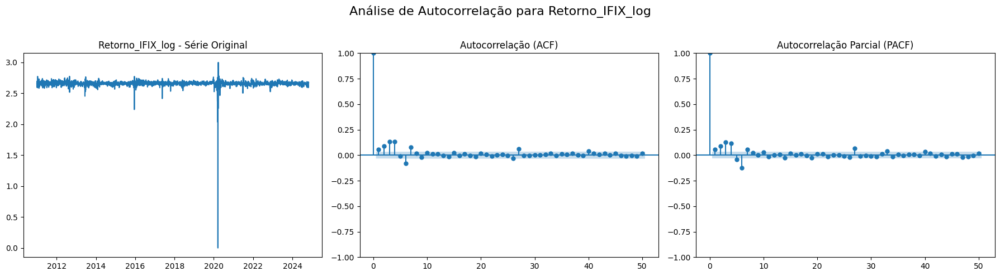

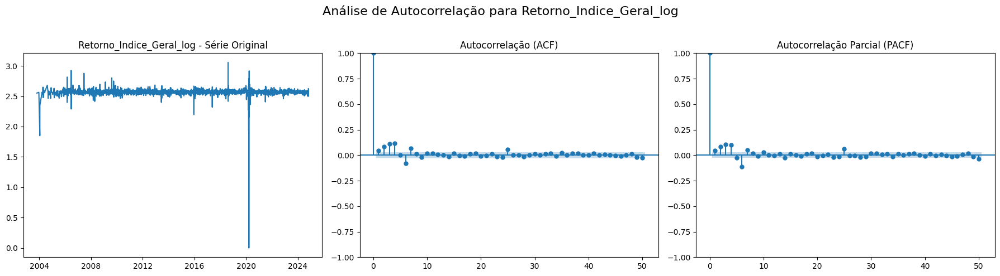

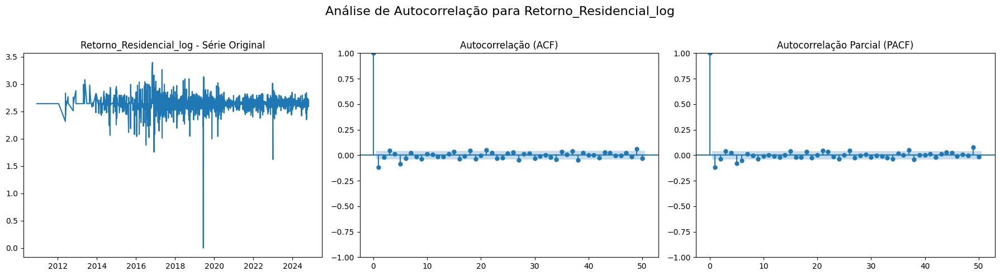

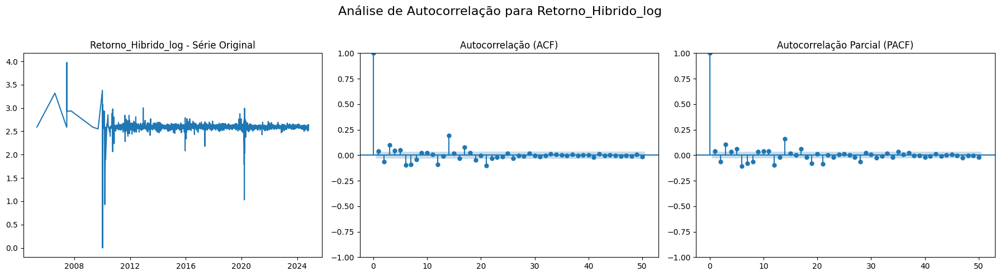

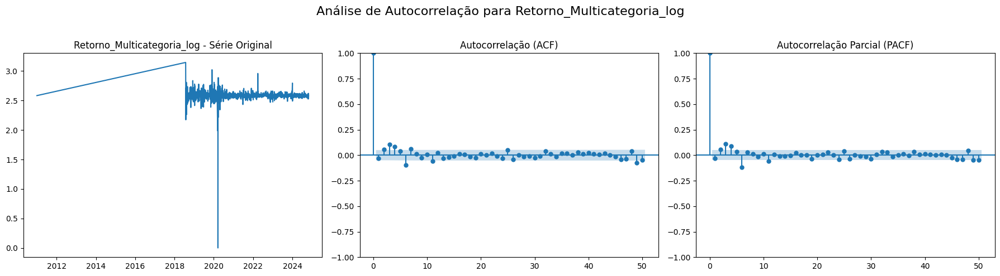

...

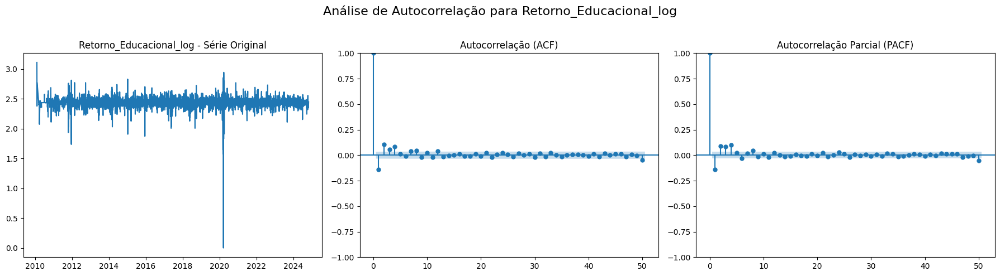

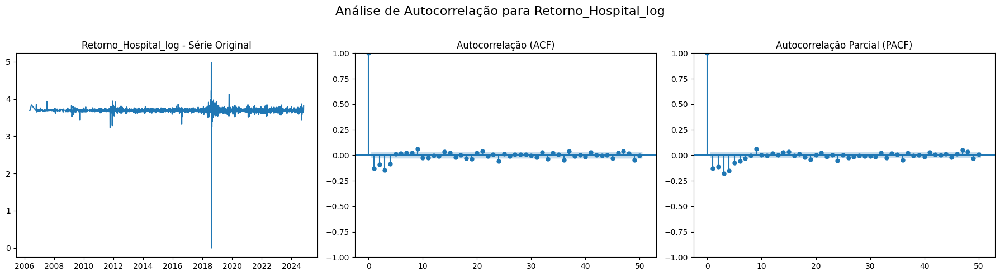

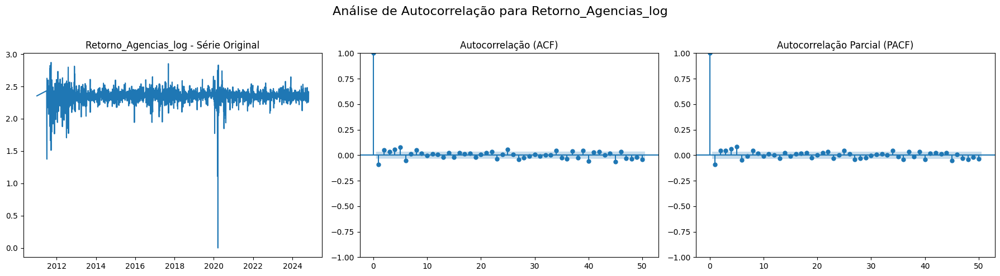

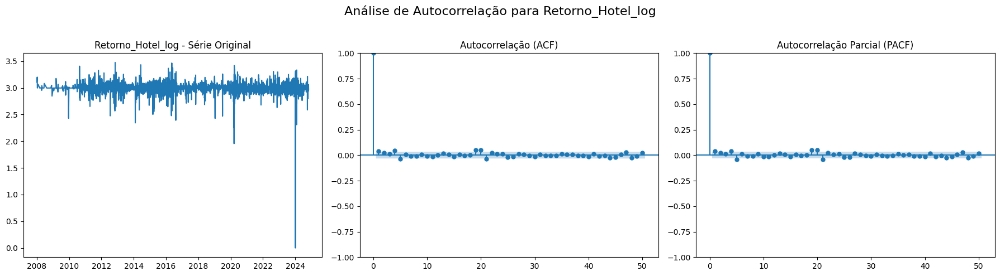

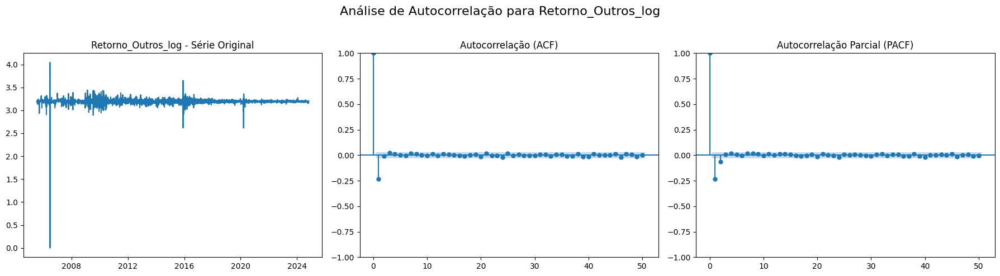

In [111]:
# Lista das séries de retorno no DataFrame
retornos = [
    'Retorno_IFIX_log', 'Retorno_Indice_Geral_log', 'Retorno_Residencial_log', 'Retorno_Hibrido_log',
    'Retorno_Multicategoria_log', 'Retorno_TVM_log', 'Retorno_Logistica_log', 'Retorno_Shoppings_log',
    'Retorno_Lajes_Corporativas_log', 'Retorno_Educacional_log', 'Retorno_Hospital_log', 'Retorno_Agencias_log',
    'Retorno_Hotel_log', 'Retorno_Outros_log'
]

# Função para aplicar e plotar ACF e PACF para cada série em um layout de 3 colunas
def plot_acf_pacf(df, series_list, lags=50):
    for serie in series_list:
        dados_limpos = df[serie].dropna()  # Remover valores NaN da série

        # Layout de 1 linha, 3 colunas: Original, ACF e PACF
        fig, axes = plt.subplots(1, 3, figsize=(18, 5))
        fig.suptitle(f'Análise de Autocorrelação para {serie}', fontsize=16)

        # Série Original
        axes[0].plot(dados_limpos)
        axes[0].set_title(f'{serie} - Série Original')

        # ACF
        plot_acf(dados_limpos, lags=lags, ax=axes[1])
        axes[1].set_title('Autocorrelação (ACF)')

        # PACF
        plot_pacf(dados_limpos, lags=lags, ax=axes[2])
        axes[2].set_title('Autocorrelação Parcial (PACF)')

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Ajuste de layout e título
        plt.show()

# Aplicar a função para o DataFrame df_retorno_log
plot_acf_pacf(df_retorno_log, retornos, lags=50)

Série Original: Há alguns picos acentuados na série, possivelmente outliers ou períodos de alta volatilidade, indicando que a variância da série não é constante ao longo do tempo. Isso sugere a presença de heterocedasticidade, que é ideal para um modelo GARCH.

Função de Autocorrelação (ACF): Observa-se um primeiro valor de autocorrelação bem alto (próximo a 1), seguido por uma rápida queda nos lags subsequentes. Esse comportamento é típico de processos GARCH, onde a autocorrelação cai rapidamente após o primeiro lag. A ACF com decaimento rápido indica que um GARCH(1,1) pode ser um bom ponto de partida, pois este modelo é frequentemente adequado para séries com autocorrelação rápida e curta.

Função de Autocorrelação Parcial (PACF): A PACF também apresenta um pico alto no primeiro lag, e as autocorrelações caem rapidamente nos lags subsequentes. Esse comportamento reforça a ideia de que a volatilidade da série pode ser capturada com um modelo simples, como o GARCH(1,1).

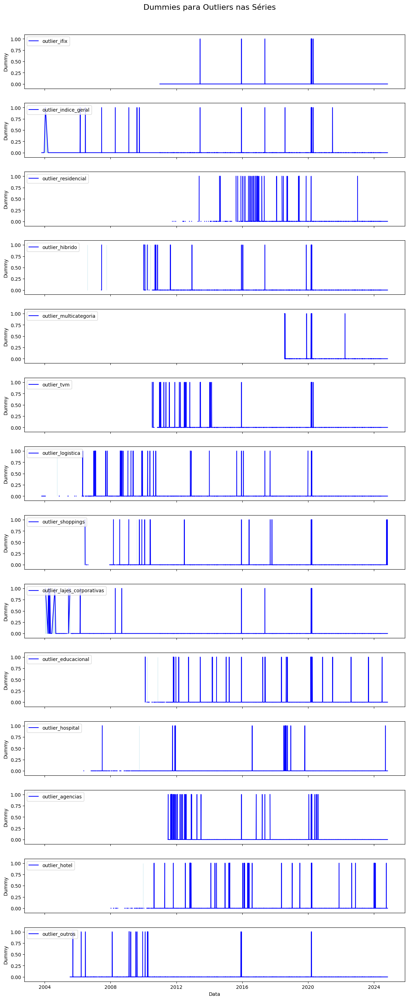

In [112]:
# Configurações para o layout de subplots
num_dummies = len(dummies_df.columns)
fig, axes = plt.subplots(num_dummies, 1, figsize=(12, 2 * num_dummies), sharex=True)
fig.tight_layout(pad=2.0)

# Iterar sobre cada coluna de dummy e plotar
for i, col in enumerate(dummies_df.columns):
    axes[i].plot(dummies_df.index, dummies_df[col], color='blue', label=col)
    axes[i].fill_between(dummies_df.index, dummies_df[col], color='lightblue', alpha=0.5)
    axes[i].set_ylim(-0.1, 1.1)  # Limitar o eixo y para exibir apenas 0 e 1
    axes[i].set_ylabel("Dummy")
    axes[i].legend(loc="upper left")

# Configurações de eixo comum
axes[-1].set_xlabel("Data")
plt.suptitle("Dummies para Outliers nas Séries", y=1.02, fontsize=16)  # Título geral

plt.show()


### Função ACF e PACF - quadrado dos retornos

Como o GARCH modela a volatilidade ao longo do tempo, analisamos a autocorrelação sobre o quadrado da série de retornos (ou dos resíduos) para identificar a presença de heterocedasticidade condicional.

ACF (Autocorrelação) no quadrado dos retornos: Indica a persistência da volatilidade ao longo do tempo.
Decaimento lento no ACF dos quadrados dos retornos sugere que a variância condicional é autocorrelacionada, o que é uma característica importante para o modelo GARCH.
PACF (Autocorrelação Parcial) no quadrado dos retornos: Pode ajudar a identificar a ordem do processo ARCH no modelo GARCH. Um corte significativo após poucos lags no PACF dos quadrados sugere uma ordem específica para o termo ARCH.
Diagnóstico da adequação do modelo GARCH:

Se a ACF dos quadrados dos retornos mostra autocorrelação significativa em lags iniciais, isso indica uma volatilidade agrupada na série, o que é um sinal de que um modelo GARCH seria útil para capturar a variância condicional.
Um corte abrupto no PACF dos quadrados dos retornos pode sugerir uma ordem específica do termo ARCH na especificação do modelo GARCH.

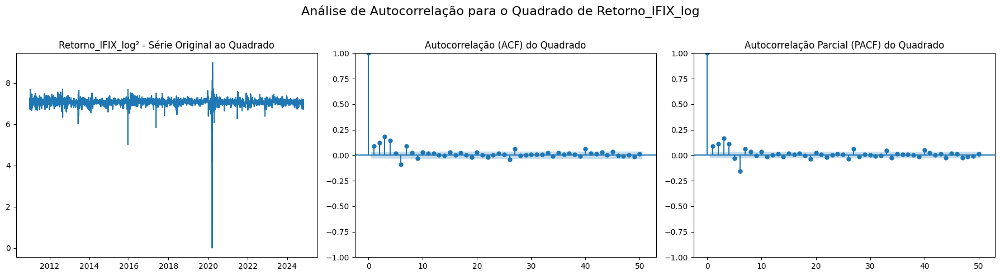

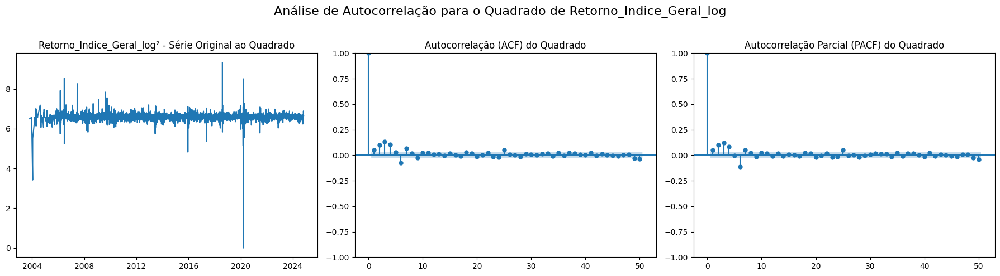

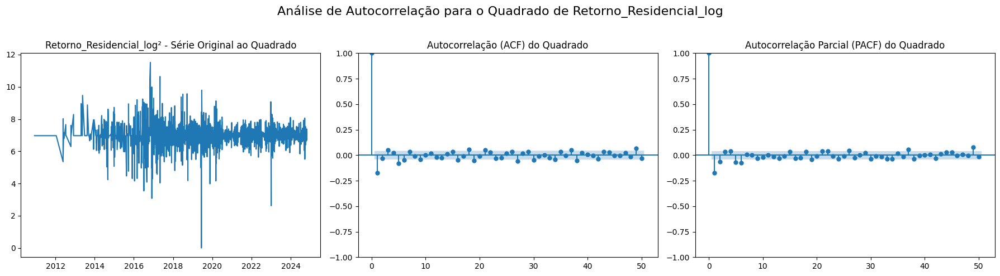

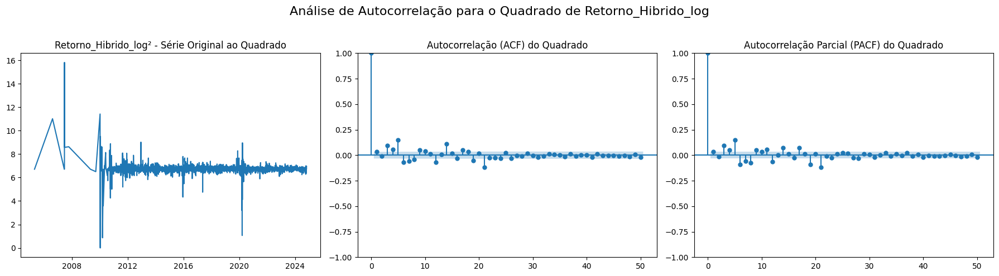

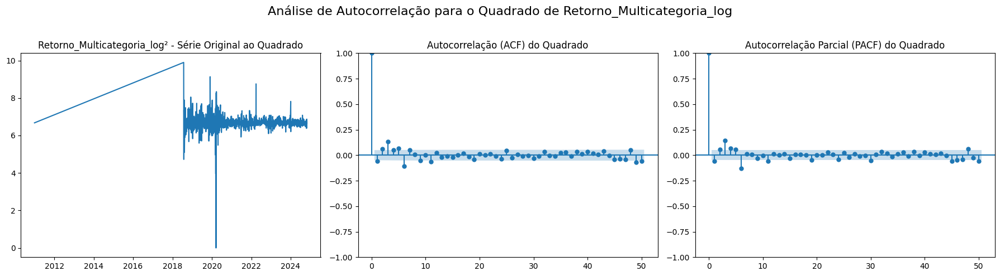

...

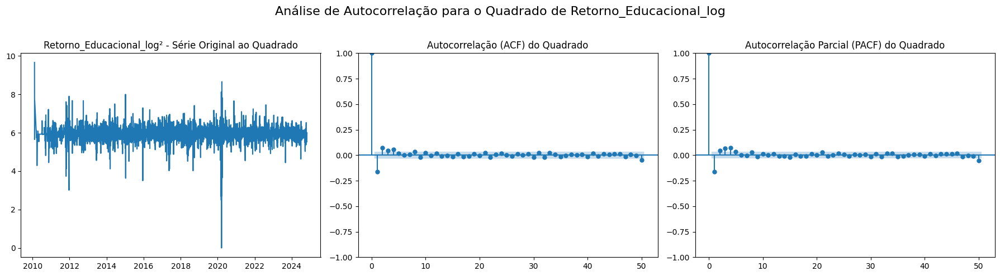

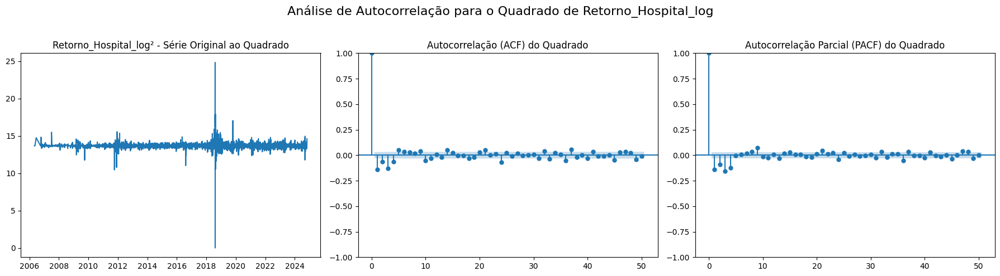

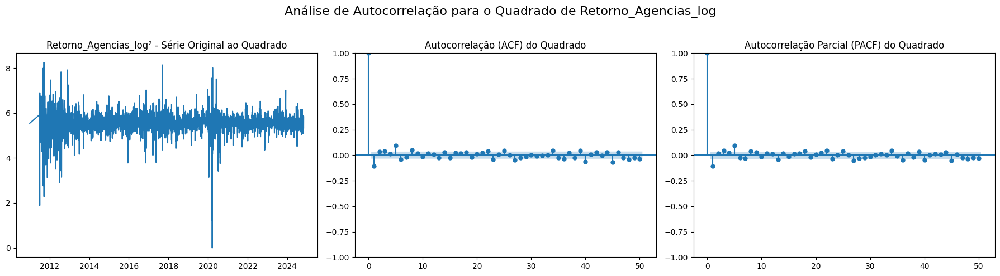

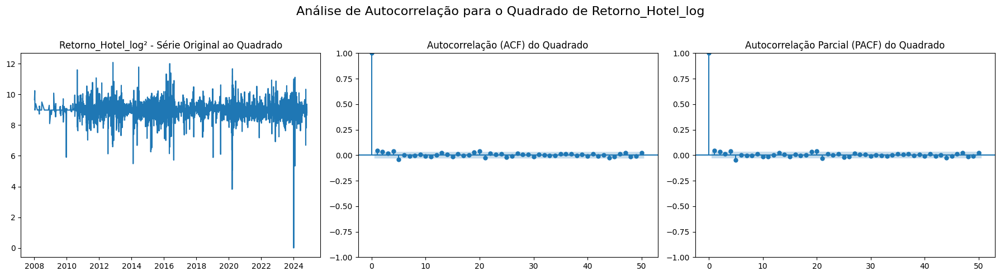

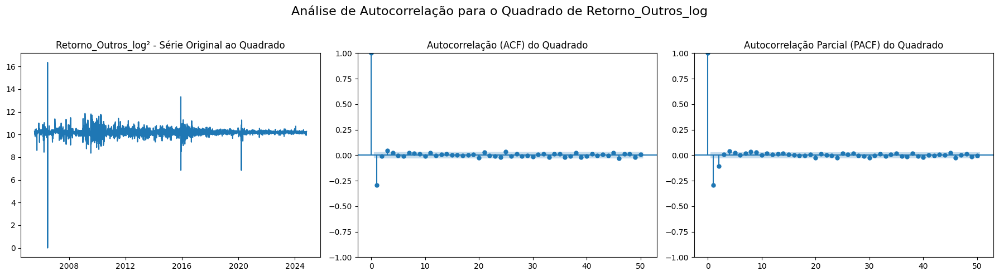

In [113]:
# Lista das séries de retorno no DataFrame
retornos = [
    'Retorno_IFIX_log', 'Retorno_Indice_Geral_log', 'Retorno_Residencial_log', 'Retorno_Hibrido_log',
    'Retorno_Multicategoria_log', 'Retorno_TVM_log', 'Retorno_Logistica_log', 'Retorno_Shoppings_log',
    'Retorno_Lajes_Corporativas_log', 'Retorno_Educacional_log', 'Retorno_Hospital_log', 'Retorno_Agencias_log',
    'Retorno_Hotel_log', 'Retorno_Outros_log'
]

# Função para aplicar e plotar ACF e PACF para os quadrados das séries de retorno
def plot_acf_pacf_squared(df, series_list, lags=50):
    for serie in series_list:
        dados_limpos = df[serie].dropna() ** 2  # Remover valores NaN da série e calcular o quadrado

        # Layout de 1 linha, 3 colunas: Original, ACF e PACF para o quadrado da série
        fig, axes = plt.subplots(1, 3, figsize=(18, 5))
        fig.suptitle(f'Análise de Autocorrelação para o Quadrado de {serie}', fontsize=16)

        # Série Original ao Quadrado
        axes[0].plot(dados_limpos)
        axes[0].set_title(f'{serie}² - Série Original ao Quadrado')

        # ACF do Quadrado da Série
        plot_acf(dados_limpos, lags=lags, ax=axes[1])
        axes[1].set_title('Autocorrelação (ACF) do Quadrado')

        # PACF do Quadrado da Série
        plot_pacf(dados_limpos, lags=lags, ax=axes[2])
        axes[2].set_title('Autocorrelação Parcial (PACF) do Quadrado')

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Ajuste de layout e título
        plt.show()

# Aplicar a função para o DataFrame df_retorno_log
plot_acf_pacf_squared(df_retorno_log, retornos, lags=50)

Interpretação:

1. ACF dos Quadrados dos Retornos

O fato de observarmos uma autocorrelação significativa em lag 1, seguida de uma leve persistência em lags subsequentes, é indicativo de um fenômeno conhecido como "volatility clustering" (agrupamento de volatilidade). Esse padrão significa que períodos de alta volatilidade tendem a ser seguidos por períodos semelhantes, e o mesmo ocorre com períodos de baixa volatilidade.

O padrão observado (um pico inicial seguido de uma gradual redução) é uma característica que modelos GARCH buscam capturar. Ele indica que o choque na volatilidade inicial afeta a volatilidade futura, mas esse efeito vai diminuindo ao longo do tempo.

2. PACF dos Quadrados dos Retornos

No PACF dos quadrados dos retornos, um pico significativo em lag 1 é um sinal de que a série tem uma dependência de volatilidade imediata e direta com o passado recente (primeira defasagem). Isso sugere que o efeito dos choques passados na volatilidade é mais imediato e, provavelmente, se dissipa rapidamente após o primeiro lag.

O fato de a autocorrelação parcial cair rapidamente após o lag 1 indica que um modelo relativamente simples, como o GARCH(1,1), pode ser adequado. Esse modelo considera a primeira defasagem para capturar tanto os choques imediatos (ARCH) quanto a persistência da volatilidade (GARCH), o que parece suficiente para a estrutura observada.

Conclusão: Combinando as informações do ACF e PACF dos quadrados dos retornos, a escolha de um modelo GARCH(1,1) é justificada.

### Teste de Ljung-Box

O Teste de Ljung-Box é uma técnica estatística usada para verificar a presença de autocorrelação em uma série temporal. Ele examina se há uma correlação significativa entre os valores atuais e passados de uma série, ajudando a avaliar se os dados apresentam comportamento aleatório ou se têm um padrão persistente. Esse teste é particularmente útil na análise de resíduos em modelos temporais, como ARIMA ou GARCH, para verificar se o modelo ajustado capturou todas as dependências temporais nos dados.

O Teste de Ljung-Box verifica se existe autocorrelação significativa em uma série temporal ou nos resíduos de um modelo ajustado. Ele testa a hipótese nula de que não há autocorrelação significativa até um número específico de defasagens (lags).

- Hipótese nula (𝐻0): Não há autocorrelação até o lag especificado.

- Hipótese alternativa (𝐻1): Existe autocorrelação significativa até o lag especificado.

Interpretação:
- Se o p-valor for menor que o nível de significância (por exemplo, 0,05), rejeitamos a hipótese nula, o que indica que há autocorrelação significativa até o lag especificado.
- Se o p-valor for maior, não rejeitamos a hipótese nula, sugerindo que a série não apresenta autocorrelação significativa.

Verificar a adequação do GARCH(1,1): Após o ajuste do modelo GARCH(1,1), espera-se que os resíduos padronizados (resíduos divididos pela volatilidade condicional) não apresentem autocorrelação significativa. Isso indicaria que o modelo capturou adequadamente as dependências temporais da volatilidade.

In [114]:

# Definindo o número de defasagens e o nível de significância
lags = 10
alpha = 0.05
escala_fator = 100  # Fator de escala para ajustar o retorno

# Dicionário para armazenar os resultados
resultados_ljung_box = []

# Aplicar o teste de Ljung-Box após o ajuste do modelo GARCH(1,1) em cada série
for serie in retornos:
    dados_limpos = df_retorno_log[serie].dropna() * escala_fator  # Reescalando os dados

    try:
        # Ajuste do modelo GARCH(1,1)
        modelo_garch = arch_model(dados_limpos, vol='Garch', p=1, q=1)
        ajuste = modelo_garch.fit(disp="off")

        # Obtenção dos resíduos padronizados
        residuos = ajuste.resid / ajuste.conditional_volatility

        # Aplicação do teste de Ljung-Box nos resíduos padronizados
        lb_test = acorr_ljungbox(residuos, lags=[lags], return_df=True)

        # Armazenar os resultados
        resultados_ljung_box.append({
            'Série': serie,
            'Estatística Ljung-Box': lb_test['lb_stat'].values[0],
            'P-Valor': lb_test['lb_pvalue'].values[0],
            'Conclusão': 'Não há autocorrelação significativa' if lb_test['lb_pvalue'].values[0] > alpha else 'Há autocorrelação significativa',
            'AIC': ajuste.aic,
            'BIC': ajuste.bic
        })

    except Exception as e:
        print(f"Erro ao ajustar o modelo GARCH para a série {serie}: {e}")
        resultados_ljung_box.append({
            'Série': serie,
            'Estatística Ljung-Box': None,
            'P-Valor': None,
            'Conclusão': 'Erro no ajuste do modelo',
            'AIC': None,
            'BIC': None
        })

# Convertendo os resultados em um DataFrame para visualização
df_resultados_ljung_box = pd.DataFrame(resultados_ljung_box)
print("Resultados do Teste de Ljung-Box para Autocorrelação nos Resíduos:")
print(df_resultados_ljung_box)


Resultados do Teste de Ljung-Box para Autocorrelação nos Resíduos:
                             Série  Estatística Ljung-Box       P-Valor  \
0                 Retorno_IFIX_log             297.700646  4.760611e-58   
1         Retorno_Indice_Geral_log             181.964961  9.156559e-34   
2          Retorno_Residencial_log              83.626360  9.734865e-14   
3              Retorno_Hibrido_log              92.612140  1.622490e-15   
4       Retorno_Multicategoria_log              31.215690  5.404791e-04   
5                  Retorno_TVM_log              40.263197  1.522843e-05   
6            Retorno_Logistica_log              64.385573  5.312150e-10   
7            Retorno_Shoppings_log              37.868650  4.000246e-05   
8   Retorno_Lajes_Corporativas_log             109.939785  5.487023e-19   
9          Retorno_Educacional_log              80.628614  3.779931e-13   
10            Retorno_Hospital_log              65.220840  3.677508e-10   
11            Retorno_Agencias_lo

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


Análise do Teste de Ljung-Box nos Resíduos:

A tabela mostra que, para todas as séries, o p-valor do teste de Ljung-Box é muito baixo (próximo de zero), indicando autocorrelação significativa nos resíduos padronizados. **A presença de autocorrelação significativa nos resíduos implica que o modelo GARCH(1,1) não capturou adequadamente toda a dependência temporal nas séries.** Em um modelo ideal, os resíduos padronizados deveriam se comportar como ruído branco, sem autocorrelação significativa, o que indicaria que a variabilidade foi totalmente modelada pelo GARCH.

Análise dos Critérios de Informação (AIC e BIC):

Os valores de AIC e BIC fornecem uma medida da qualidade do ajuste, penalizando a complexidade do modelo. Esses valores são úteis para comparação com modelos mais complexos, como GARCH(2,1), EGARCH, ou GJR-GARCH, onde um AIC/BIC menor indicaria uma melhor adequação. Embora o GARCH(1,1) seja um modelo básico para modelar volatilidade, os altos valores de AIC e BIC sugerem que um ajuste melhor pode ser alcançado com uma estrutura de modelo mais complexa, que possa capturar melhor a dependência temporal remanescente.

O aviso de "ConvergenceWarning" indica dificuldades na convergência do otimizador. Isso sugere que o modelo GARCH(1,1) teve problemas ao encontrar os parâmetros ótimos para alguns retornos, o que pode ocorrer quando:

**A série tem características complexas que um GARCH(1,1) simples não consegue captar.
Os dados precisam de transformação adicional ou ajuste no fator de escala para melhorar a estabilidade numérica do ajuste.**

# **7. MODELOS GARCH**

## 7.1. Seleção do modelo

### Otimização GARCH

Este código realiza a otimização de modelos GARCH para várias séries temporais de retornos financeiros, com o objetivo de modelar a volatilidade condicional dessas séries. A função principal `otimizar_garch_com_ljung_box` recebe um dicionário de séries, ajusta diferentes combinações de parâmetros `(p, q)` para cada série e avalia a qualidade de cada ajuste usando o teste de Ljung-Box. Esse teste ajuda a identificar modelos com resíduos que têm pouca ou nenhuma autocorrelação, um sinal de que o modelo capturou bem a dinâmica da volatilidade.

Durante a otimização, a função testa várias combinações de `(p, q)` dentro de limites definidos (`max_p` e `max_q`) e aplica o teste de Ljung-Box em múltiplas defasagens (`lags`). O melhor modelo é escolhido com base no maior p-valor do teste de Ljung-Box (indicando menor autocorrelação) e, em caso de empate, pelo menor valor de AIC, que mede a qualidade do ajuste penalizando a complexidade do modelo. O processo é repetido para cada série no dicionário, e os resultados do melhor modelo de cada série são armazenados em um DataFrame.

O código final exibe um resumo dos melhores modelos GARCH encontrados para cada série, incluindo os parâmetros `(p, q)`, valores de AIC e BIC, p-valores do teste de Ljung-Box e uma indicação sobre a presença de autocorrelação nos resíduos. Esses resultados permitem escolher modelos que capturam de forma robusta a volatilidade das séries de retornos, minimizando a autocorrelação nos resíduos e garantindo uma modelagem de volatilidade mais precisa e confiável.

In [124]:
from arch import arch_model
import pandas as pd
import warnings
from statsmodels.stats.diagnostic import acorr_ljungbox

# Ignorar avisos não críticos
warnings.filterwarnings("ignore", category=UserWarning, module="arch")

# Função para otimizar o modelo GARCH com base no teste de Ljung-Box
def otimizar_garch_com_ljung_box(series_dict, max_p=5, max_q=5, lags=[10], escala_fator=100):
    resultados_otimizacao = {}

    for nome_serie, dados in series_dict.items():
        # Selecionar a série e remover NaNs, aplicando o fator de escala
        serie_temporal = dados.dropna() * escala_fator

        # Verificar se a série temporal é válida
        if serie_temporal.empty:
            print(f"A série {nome_serie} está vazia ou contém apenas valores NaN.")
            continue

        print(f"\nIniciando otimização para a série: {nome_serie}")

        melhor_modelo = None
        melhor_pq = (None, None)
        melhor_pvalor = 0  # Valor-p inicial (quanto maior, melhor)
        melhor_aic = float("inf")  # Valor inicial do AIC para desempate

        # Testar diferentes combinações de (p, q)
        for p in range(1, max_p + 1):
            for q in range(1, max_q + 1):
                try:
                    # Ajustar o modelo GARCH(p, q)
                    model = arch_model(serie_temporal, vol='Garch', p=p, q=q)
                    result = model.fit(disp='off')

                    # Aplicar o teste de Ljung-Box nos resíduos do modelo para cada lag
                    ljung_box_pvalues = [
                        acorr_ljungbox(result.resid, lags=[lag], return_df=True)['lb_pvalue'].iloc[0]
                        for lag in lags
                    ]
                    pvalor_min = min(ljung_box_pvalues)  # Menor p-valor para avaliar autocorrelação

                    # Verificar se este modelo tem o maior valor-p mínimo e um AIC menor (desempate)
                    if pvalor_min > melhor_pvalor or (pvalor_min == melhor_pvalor and result.aic < melhor_aic):
                        melhor_pvalor = pvalor_min
                        melhor_modelo = result
                        melhor_pq = (p, q)
                        melhor_aic = result.aic

                    print(f"Teste (p={p}, q={q}): Ljung-Box p-valores = {ljung_box_pvalues}, AIC = {result.aic}")

                except Exception as e:
                    print(f"Erro ao ajustar GARCH({p},{q}) para {nome_serie}: {e}")

        # Guardar os resultados do melhor modelo
        if melhor_modelo:
            resultados_otimizacao[nome_serie] = {
                'Melhor Modelo': f'GARCH({melhor_pq[0]},{melhor_pq[1]})',
                'AIC': melhor_modelo.aic,
                'BIC': melhor_modelo.bic,
                'Ljung-Box P-Valores': [f"{pval:.6f}" for pval in ljung_box_pvalues],
                'Menor P-Valor': f"{melhor_pvalor:.6f}",
                'Autocorrelação nos Resíduos': 'Não' if melhor_pvalor >= 0.05 else 'Sim'
            }

            # Exibir o resumo do melhor modelo
            print(f"\nMelhor modelo para {nome_serie}: GARCH({melhor_pq[0]},{melhor_pq[1]})")
            print(melhor_modelo.summary())
            print("\n")

    # Retornar os resultados de otimização como DataFrame transposto para exibição organizada
    return pd.DataFrame(resultados_otimizacao).T

# Selecionar as colunas de interesse no dataframe df_retorno_log
colunas_retorno = [
    'Retorno_IFIX_log', 'Retorno_Indice_Geral_log', 'Retorno_Residencial_log', 'Retorno_Hibrido_log',
    'Retorno_Multicategoria_log', 'Retorno_TVM_log', 'Retorno_Logistica_log', 'Retorno_Shoppings_log',
    'Retorno_Lajes_Corporativas_log', 'Retorno_Educacional_log', 'Retorno_Hospital_log',
    'Retorno_Agencias_log', 'Retorno_Hotel_log', 'Retorno_Outros_log'
]

# Criar o dicionário para as séries de retorno
series_dict = {coluna: df_retorno_log[coluna] for coluna in colunas_retorno}

# Aplicar a função para otimizar todos os modelos GARCH nas séries selecionadas
resultados_otimizacao = otimizar_garch_com_ljung_box(series_dict, max_p=5, max_q=5, lags=[10, 15], escala_fator=100)

# Exibir os resultados resumidos
print("\nResumo da Otimização de Modelos GARCH com Teste de Ljung-Box:")
print(resultados_otimizacao)



Iniciando otimização para a série: Retorno_IFIX_log
Teste (p=1, q=1): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16174.122263745969
Teste (p=1, q=2): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16176.122263725087
Teste (p=1, q=3): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16178.122263767898
Teste (p=1, q=4): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16180.122263726604
Teste (p=2, q=1): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16166.383354716036
Teste (p=2, q=2): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16168.383354827038
Teste (p=2, q=3): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16170.383355083159
Teste (p=2, q=4): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16171.68310953966
Teste (p=3, q=1): Ljung-Box p-valore

Os resultados da otimização dos modelos GARCH mostram que, para a maioria das séries, há problemas de autocorrelação remanescente nos resíduos, conforme indicado pelos p-valores extremamente baixos no teste de Ljung-Box (geralmente próximos de zero). Esses baixos p-valores sugerem que, mesmo após o ajuste do modelo GARCH, ainda existe autocorrelação nos resíduos, o que aponta que o modelo não capturou completamente as dinâmicas de volatilidade da série. Apenas a série `Retorno_Hotel_log` apresentou p-valores acima de 0.05, indicando uma melhor adequação do modelo e ausência de autocorrelação significativa.

Além disso, os valores do AIC e do BIC fornecem informações úteis sobre a complexidade e o ajuste do modelo: em geral, valores menores são desejáveis, pois indicam um bom ajuste com menor complexidade. Contudo, mesmo os melhores modelos para cada série (como GARCH(4,3) para `Retorno_IFIX_log` e GARCH(1,4) para `Retorno_Residencial_log`) ainda apresentam autocorrelação nos resíduos, sugerindo que talvez seja necessário explorar modelos mais sofisticados, como EGARCH, TGARCH ou modelos que incorporem variáveis exógenas, para capturar melhor a dinâmica.

Em resumo, embora o processo de otimização tenha identificado o melhor modelo GARCH para cada série, a presença de autocorrelação residual implica que os modelos selecionados não são totalmente adequados para descrever a volatilidade de algumas séries. Testar modelos mais flexíveis ou incorporar distribuições de erros alternativas, como a t-Student ou a distribuição skew-t, poderia melhorar o ajuste e reduzir a autocorrelação residual.

### Variações GARCH

In [116]:
# Reescalando todas as séries em 100 para ajudar na convergência (já foi feito anteriormente)
df_retorno_log_rescaled = df_retorno_log.copy()
for coluna in colunas_retorno:
    df_retorno_log_rescaled[coluna] *= 100

# Função para ajustar diferentes variações de modelos GARCH e escolher o melhor com base no AIC
def ajustar_modelos_garch(serie):
    resultados = {}
    modelos = {
        "GARCH": arch_model(serie, vol='Garch', p=1, q=1),
        "APARCH": arch_model(serie, vol='APARCH', p=1, q=1),
        "GARCH-M": arch_model(serie, vol='Garch', p=1, q=1, mean='ARX'),
        "IGARCH": arch_model(serie, vol='Garch', p=1, q=1, power=2.0),
        "EGARCH": arch_model(serie, vol='EGarch', p=1, q=1),
        "FIGARCH": arch_model(serie, vol='FIGARCH', p=1, q=1),
        "CGARCH": arch_model(serie, vol='Garch', p=1, q=1, o=1),
        "TGARCH": arch_model(serie, vol='Garch', p=1, q=1, o=1),
        "HYGARCH": arch_model(serie, vol='FIGARCH', p=1, q=1),
        "NGARCH": arch_model(serie, vol='Garch', p=1, q=1, o=1, power=1.5),
        "QGARCH": arch_model(serie, vol='Garch', p=1, q=1, power=2.0),
        "ST-GARCH": arch_model(serie, vol='Garch', p=1, q=1, o=1, power=1.2)
    }

    # Ajustando cada modelo e armazenando os resultados de AIC e BIC
    for nome, model in modelos.items():
        try:
            ajuste = model.fit(disp="off", tol=1e-6, options={'maxiter': 500})
            resultados[nome] = {"AIC": ajuste.aic, "BIC": ajuste.bic, "Modelo": ajuste}
        except Exception as e:
            print(f"Erro ao ajustar o modelo {nome} para a série: {e}")

    # Encontrando o melhor modelo com base no menor AIC
    melhor_modelo = min(resultados.items(), key=lambda x: x[1]["AIC"]) if resultados else None
    return resultados, melhor_modelo

# Aplicando a função em cada coluna de retornos e armazenando os resultados
resultados_modelos = []

for coluna in colunas_retorno:
    serie = df_retorno_log_rescaled[coluna].dropna()
    resultados, melhor_modelo = ajustar_modelos_garch(serie)

    # Armazenando o melhor modelo e os critérios para cada série, se encontrado
    if melhor_modelo:
        resultados_modelos.append({
            "Série": coluna,
            "Melhor Modelo": melhor_modelo[0],
            "AIC": melhor_modelo[1]["AIC"],
            "BIC": melhor_modelo[1]["BIC"],
        })
    else:
        print(f"Nenhum modelo foi ajustado com sucesso para a série {coluna}")

# Convertendo os resultados em um DataFrame para exibição
df_resultados = pd.DataFrame(resultados_modelos)

# Exibindo a tabela com os resultados
print("\nTabela de Resultados dos Melhores Modelos para Cada Série de Retornos:")
print(df_resultados)

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr


Tabela de Resultados dos Melhores Modelos para Cada Série de Retornos:
                             Série Melhor Modelo           AIC           BIC
0                 Retorno_IFIX_log        NGARCH  16949.102120  16980.056664
1         Retorno_Indice_Geral_log        CGARCH  23647.983801  23680.407151
2          Retorno_Residencial_log       FIGARCH  16965.691003  16994.363797
3              Retorno_Hibrido_log       FIGARCH  20195.426930  20226.324331
4       Retorno_Multicategoria_log       FIGARCH   8893.392081   8920.096259
5                  Retorno_TVM_log        CGARCH  20056.978681  20087.751182
6            Retorno_Logistica_log        APARCH  25101.553822  25133.524428
7            Retorno_Shoppings_log       FIGARCH  23073.109002  23104.619091
8   Retorno_Lajes_Corporativas_log        NGARCH  23867.307345  23899.699607
9          Retorno_Educacional_log        CGARCH  23328.968637  23359.649765
10            Retorno_Hospital_log       FIGARCH  21179.781003  21211.257497
11  

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


In [117]:
import pandas as pd
import numpy as np
from arch import arch_model
import statsmodels.api as sm
from statsmodels.stats.diagnostic import acorr_ljungbox
import warnings

# Ignorar avisos não críticos
warnings.filterwarnings("ignore", category=UserWarning, module="arch")

# Reescalando todas as séries em 100 para ajudar na convergência
df_retorno_log_rescaled = df_retorno_log.copy()
for coluna in colunas_retorno:
    df_retorno_log_rescaled[coluna] *= 100

# Função para ajustar modelos GARCH com diferentes variações e selecionar o melhor com base em AIC e teste de Ljung-Box
def ajustar_modelos_garch(serie, max_p=5, max_q=5, lags=10):
    resultados = {}

    # Definição das variantes de modelos GARCH
    modelos_variantes = [
        ("GARCH", 'Garch', None, None),
        ("APARCH", 'APARCH', None, None),
        ("GARCH-M", 'Garch', 'ARX', None),
        ("IGARCH", 'Garch', None, 2.0),
        ("EGARCH", 'EGarch', None, None),
        ("FIGARCH", 'FIGARCH', None, None),
        ("CGARCH", 'Garch', None, 1.0),
        ("TGARCH", 'Garch', None, 1.0),
        ("HYGARCH", 'FIGARCH', None, None),
        ("NGARCH", 'Garch', None, 1.5),
        ("QGARCH", 'Garch', None, 2.0),
        ("ST-GARCH", 'Garch', None, 1.2),
    ]

    # Ajustando variantes e diferentes valores de p e q
    for nome, vol, mean, power in modelos_variantes:
        for p in range(1, max_p + 1):
            for q in range(1, max_q + 1):
                # Configuração do modelo
                try:
                    model = arch_model(serie, vol=vol, p=p, q=q, mean=mean, power=power)
                    ajuste = model.fit(disp="off", tol=1e-6, options={'maxiter': 500})

                    # Teste de Ljung-Box nos resíduos
                    ljung_box_test = acorr_ljungbox(ajuste.resid, lags=lags, return_df=True)
                    p_values = ljung_box_test['lb_pvalue']
                    if all(p > 0.05 for p in p_values):  # Aceitamos apenas modelos sem autocorrelação nos resíduos
                        resultados[(nome, p, q)] = {
                            "AIC": ajuste.aic,
                            "BIC": ajuste.bic,
                            "Ljung-Box p-valores": p_values,
                            "Modelo": ajuste
                        }
                except Exception as e:
                    print(f"Erro ao ajustar o modelo {nome} com p={p}, q={q}: {e}")

    # Selecionar o melhor modelo com base no menor AIC, dentre aqueles que passaram no teste de Ljung-Box
    melhor_modelo = min(resultados.items(), key=lambda x: x[1]["AIC"]) if resultados else None
    return resultados, melhor_modelo

# Aplicando a função em cada coluna de retornos e armazenando os resultados
resultados_modelos = []

for coluna in colunas_retorno:
    serie = df_retorno_log_rescaled[coluna].dropna()  # Removendo valores NaN
    resultados, melhor_modelo = ajustar_modelos_garch(serie)

    # Armazenando o melhor modelo e os critérios para cada série, se encontrado
    if melhor_modelo:
        resultados_modelos.append({
            "Série": coluna,
            "Melhor Modelo": melhor_modelo[0][0],  # Nome do modelo
            "p": melhor_modelo[0][1],  # Valor de p
            "q": melhor_modelo[0][2],  # Valor de q
            "AIC": melhor_modelo[1]["AIC"],
            "BIC": melhor_modelo[1]["BIC"],
            "Ljung-Box p-valores": melhor_modelo[1]["Ljung-Box p-valores"].values  # p-valores do teste Ljung-Box
        })
    else:
        print(f"Nenhum modelo foi ajustado com sucesso para a série {coluna}")

# Convertendo os resultados em um DataFrame para exibição
df_resultados = pd.DataFrame(resultados_modelos)

# Exibindo a tabela com os resultados
print("\nTabela de Resultados dos Melhores Modelos para Cada Série de Retornos:")
print(df_resultados)


Erro ao ajustar o modelo GARCH com p=1, q=1: 'NoneType' object has no attribute 'lower'
Erro ao ajustar o modelo GARCH com p=1, q=2: 'NoneType' object has no attribute 'lower'
Erro ao ajustar o modelo GARCH com p=1, q=3: 'NoneType' object has no attribute 'lower'
Erro ao ajustar o modelo GARCH com p=1, q=4: 'NoneType' object has no attribute 'lower'
Erro ao ajustar o modelo GARCH com p=1, q=5: 'NoneType' object has no attribute 'lower'
Erro ao ajustar o modelo GARCH com p=2, q=1: 'NoneType' object has no attribute 'lower'
Erro ao ajustar o modelo GARCH com p=2, q=2: 'NoneType' object has no attribute 'lower'
Erro ao ajustar o modelo GARCH com p=2, q=3: 'NoneType' object has no attribute 'lower'
Erro ao ajustar o modelo GARCH com p=2, q=4: 'NoneType' object has no attribute 'lower'
Erro ao ajustar o modelo GARCH com p=2, q=5: 'NoneType' object has no attribute 'lower'
Erro ao ajustar o modelo GARCH com p=3, q=1: 'NoneType' object has no attribute 'lower'
Erro ao ajustar o modelo GARCH c

In [118]:
### @title Tabela de Modelos GARCH

# Carrega arquivo CSV
df_tabelaGARCH = pd.read_csv('/content/drive/MyDrive/tese/Tabela_de_Modelos_GARCH.csv')

# Exibe dataframe
df_tabelaGARCH

,Categoria,Modelo,Nome Completo e Autores,Descrição,Aplicação Comum,Referência Bibliográfica
0,Modelos Básicos,GARCH,Generalized Autoregressive Conditional Heteros...,Modelo básico que captura a heterocedasticidad...,Utilizado para modelar volatilidade em séries ...,"Bollerslev, T. (1986). Generalized autoregress..."
1,Modelos Assimétricos,EGARCH,Exponential GARCH - Nelson (1991),Modelo que captura assimetrias (efeito leverag...,Útil para séries financeiras que exibem assime...,"Nelson, D. B. (1991). Conditional heteroskedas..."
2,Modelos Assimétricos,GJR-GARCH,"Glosten-Jagannathan-Runkle GARCH - Glosten, Ja...","Extensão que incorpora o efeito leverage, adic...","Aplicado em séries de ativos financeiros, onde...","Glosten, L. R., Jagannathan, R., & Runkle, D. ..."
3,Modelos de Memória Longa,FIGARCH,"Fractionally Integrated GARCH - Baillie, Bolle...",Modelo que permite um efeito de memória longa ...,Indicado para séries onde a volatilidade apres...,"Baillie, R. T., Bollerslev, T., & Mikkelsen, H..."
4,Modelos de Componentes,CGARCH,"Component GARCH - Engle, Lee (1999)",Modelo que separa a volatilidade em componente...,Útil para séries com componentes de volatilida...,"Engle, R. F., & Lee, G. G. J. (1999). A long-r..."
5,Modelos Assimétricos,TGARCH,Threshold GARCH - Zakoian (1994),Modelo que permite capturar a volatilidade de ...,Aplicável em séries financeiras com efeito de ...,"Zakoian, J.-M. (1994). Threshold heteroskedast..."
6,Modelos de Memória Longa,HYGARCH,Hyperbolic GARCH - Davidson (2004),Variante do FIGARCH que usa uma função hiperbó...,"Útil em séries financeiras com memória longa, ...","Davidson, J. (2004). Moment and memory propert..."
7,Modelos Não Lineares,NGARCH,"Nonlinear GARCH - Engle, Ng (1993)",Introduz uma componente não-linear para captur...,Aplicado em ativos financeiros com volatilidad...,"Engle, R. F., & Ng, V. K. (1993). Measuring an..."
8,Modelos Não Lineares,QGARCH,Quadratic GARCH - Sentana (1995),Modelo que permite termos quadráticos na model...,Apropriado para séries com alta volatilidade e...,"Sentana, E. (1995). Quadratic ARCH models. Rev..."
9,Modelos Não Lineares,ST-GARCH,"Smooth Transition GARCH - Anderson, Nam, Vahid...",Modelo que permite transições suaves entre dif...,Recomendado para séries com mudanças de regime...,"Anderson, H. M., Nam, K., & Vahid, F. (1999). ..."


## 7.2. IFIX


In [133]:
# @title Ranking GARCH

# Reescalar a série 'Retorno_IFIX_log' em 100 para ajudar na convergência
serie_retorno_log_rescaled = df_retorno_log['Retorno_IFIX_log'].dropna() * 100

# Função para ajustar diferentes variações de modelos GARCH e escolher o melhor com base no AIC e BIC
def ajustar_modelos_garch(serie):
    resultados = {}
    modelos = {
        "GARCH": arch_model(serie, vol='Garch', p=1, q=1),
        "APARCH": arch_model(serie, vol='APARCH', p=1, q=1),
        "GARCH-M": arch_model(serie, vol='Garch', p=1, q=1, mean='ARX'),
        "IGARCH": arch_model(serie, vol='Garch', p=1, q=1, power=2.0),
        "EGARCH": arch_model(serie, vol='EGarch', p=1, q=1),
        "FIGARCH": arch_model(serie, vol='FIGARCH', p=1, q=1),
        "CGARCH": arch_model(serie, vol='Garch', p=1, q=1, o=1),
        "TGARCH": arch_model(serie, vol='Garch', p=1, q=1, o=1),
        "HYGARCH": arch_model(serie, vol='FIGARCH', p=1, q=1),
        "NGARCH": arch_model(serie, vol='Garch', p=1, q=1, o=1, power=1.5),
        "QGARCH": arch_model(serie, vol='Garch', p=1, q=1, power=2.0),
        "ST-GARCH": arch_model(serie, vol='Garch', p=1, q=1, o=1, power=1.2)
    }

    # Ajustando cada modelo e armazenando os resultados de AIC e BIC
    for nome, model in modelos.items():
        try:
            ajuste = model.fit(disp="off", tol=1e-6, options={'maxiter': 500})
            resultados[nome] = {"AIC": ajuste.aic, "BIC": ajuste.bic, "Modelo": ajuste}
        except Exception as e:
            print(f"Erro ao ajustar o modelo {nome} para a série: {e}")

    # Convertendo resultados em DataFrame para ordenação
    df_resultados = pd.DataFrame([
        {"Modelo": nome, "AIC": res["AIC"], "BIC": res["BIC"]}
        for nome, res in resultados.items()
    ])

    # Ordenando os resultados pelo AIC e, em caso de empate, pelo BIC
    df_resultados = df_resultados.sort_values(by=["AIC", "BIC"]).reset_index(drop=True)
    return df_resultados

# Aplicando a função na série específica 'Retorno_IFIX_log'
df_ranking = ajustar_modelos_garch(serie_retorno_log_rescaled)

# Exibindo o ranking dos modelos do melhor para o pior
print("\nRanking dos Modelos para a Série 'Retorno_IFIX_log':")
print(df_ranking)




Ranking dos Modelos para a Série 'Retorno_IFIX_log':
      Modelo           AIC           BIC
0     NGARCH  16124.255616  16154.923553
1   ST-GARCH  16132.189927  16162.857864
2     CGARCH  16133.203774  16163.871711
3     TGARCH  16133.203774  16163.871711
4      GARCH  16174.122264  16198.656613
5    GARCH-M  16174.122264  16198.656613
6     IGARCH  16174.122264  16198.656613
7     QGARCH  16174.122264  16198.656613
8     APARCH  16174.794183  16205.462120
9    FIGARCH  16175.914372  16206.582309
10   HYGARCH  16175.914372  16206.582309
11    EGARCH  16218.097642  16242.631991


In [134]:
# @title NGARCH (4, 5)

# Ignorar avisos não críticos
warnings.filterwarnings("ignore", category=UserWarning, module="arch")

# Função para otimizar o modelo NGARCH com base no teste de Ljung-Box
def otimizar_ngarch_com_ljung_box(serie_temporal, max_p=5, max_q=5, lags=[10], escala_fator=100):
    # Remover NaNs e aplicar o fator de escala
    serie_temporal = serie_temporal.dropna() * escala_fator

    # Verificar se a série temporal é válida
    if serie_temporal.empty:
        print("A série está vazia ou contém apenas valores NaN.")
        return

    print("\nIniciando otimização para a série: Retorno_IFIX_log (NGARCH)")

    melhor_modelo = None
    melhor_pq = (None, None)
    melhor_pvalor = 0  # Valor-p inicial (quanto maior, melhor)
    melhor_aic = float("inf")  # Valor inicial do AIC para desempate

    # Testar diferentes combinações de (p, q)
    for p in range(1, max_p + 1):
        for q in range(1, max_q + 1):
            try:
                # Ajustar o modelo NGARCH(p, q) com power=1.5
                model = arch_model(serie_temporal, vol='Garch', p=p, q=q, power=1.5)
                result = model.fit(disp='off')

                # Aplicar o teste de Ljung-Box nos resíduos do modelo para cada lag
                ljung_box_pvalues = [
                    acorr_ljungbox(result.resid, lags=[lag], return_df=True)['lb_pvalue'].iloc[0]
                    for lag in lags
                ]
                pvalor_min = min(ljung_box_pvalues)  # Menor p-valor para avaliar autocorrelação

                # Verificar se este modelo tem o maior valor-p mínimo e um AIC menor (desempate)
                if pvalor_min > melhor_pvalor or (pvalor_min == melhor_pvalor and result.aic < melhor_aic):
                    melhor_pvalor = pvalor_min
                    melhor_modelo = result
                    melhor_pq = (p, q)
                    melhor_aic = result.aic

                print(f"Teste NGARCH (p={p}, q={q}): Ljung-Box p-valores = {ljung_box_pvalues}, AIC = {result.aic}")

            except Exception as e:
                print(f"Erro ao ajustar NGARCH({p},{q}) para Retorno_IFIX_log: {e}")

    # Exibir os resultados do melhor modelo
    if melhor_modelo:
        print(f"\nMelhor modelo para Retorno_IFIX_log: NGARCH({melhor_pq[0]},{melhor_pq[1]})")
        print(melhor_modelo.summary())
        print("\nResultados do Teste Ljung-Box para o melhor modelo:")
        print(f"Ljung-Box P-Valores: {ljung_box_pvalues}")
        print(f"Menor P-Valor: {melhor_pvalor:.6f}")
        print(f"Autocorrelação nos Resíduos: {'Não' if melhor_pvalor >= 0.05 else 'Sim'}")

# Supondo que df_retorno_log já esteja carregado no ambiente
# Aplicar a função na série específica 'Retorno_IFIX_log'
otimizar_ngarch_com_ljung_box(df_retorno_log['Retorno_IFIX_log'], max_p=5, max_q=5, lags=[10, 15], escala_fator=100)



Iniciando otimização para a série: Retorno_IFIX_log (NGARCH)
Teste NGARCH (p=1, q=1): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16182.363061863747
Teste NGARCH (p=1, q=2): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16184.363047386261
Teste NGARCH (p=1, q=3): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16186.363058808454
Teste NGARCH (p=1, q=4): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16188.363099337668
Teste NGARCH (p=1, q=5): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16190.363040602399
Teste NGARCH (p=2, q=1): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16170.79261297127
Teste NGARCH (p=2, q=2): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16172.792614164302
Teste NGARCH (p=2, q=3): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-3

Escolha do Modelo Baseado no AIC:

O modelo NGARCH(4,5) foi selecionado como o melhor modelo, pois apresenta o menor valor de AIC (16058.47) entre as combinações testadas.

Esse critério sugere que o modelo NGARCH(4,5) é o melhor ajuste relativo entre os modelos testados.
Ljung-Box P-Valores:

Os p-valores do teste de Ljung-Box são extremamente baixos ([4.87e-41, 1.59e-38]), o que indica presença significativa de autocorrelação nos resíduos do modelo.
Interpretação: Apesar de o modelo NGARCH(4,5) ter sido otimizado com base no AIC, ele ainda não captura completamente a dependência temporal dos resíduos, sugerindo que as correlações de curto prazo não foram adequadamente modeladas.
Coeficientes de Volatilidade e Significância Estatística:

Vários coeficientes 𝛼 e 𝛽 no modelo de volatilidade não são estatisticamente significativos, como alpha[1], beta[1], beta[2], beta[3], e beta[4]. Isso significa que suas estimativas não diferem significativamente de zero, sugerindo que podem não contribuir substancialmente para a explicação da volatilidade.
Os coeficientes alpha[2], alpha[4] e beta[5] são significativos, indicando que eles têm impacto na modelagem da variabilidade condicional.
Problemas com a Estrutura do Modelo:

A presença de coeficientes não significativos e autocorrelação nos resíduos sugere que o modelo NGARCH(4,5), apesar de melhor no critério AIC, ainda pode não ser totalmente adequado para capturar a dinâmica da volatilidade dessa série.
Alternativas como explorar diferentes especificações (e.g., EGARCH, TGARCH) ou incluir transformações adicionais podem ser necessárias para reduzir a autocorrelação nos resíduos.

In [137]:
# @title NGARCH (4, 5) dummies/exógenas

# Ignorar avisos não críticos
warnings.filterwarnings("ignore", category=UserWarning, module="arch")

# Função para otimizar o modelo NGARCH(4,5) quanto às variáveis dummies e exógenas
def otimizar_ngarch_variaveis_exogenas(serie_temporal, dummies, exogenas, max_p=4, max_q=5, lags=[10, 15], escala_fator=100):
    # Remover NaNs e aplicar o fator de escala
    serie_temporal = serie_temporal.dropna() * escala_fator

    # Verificar se a série temporal é válida
    if serie_temporal.empty:
        print("A série está vazia ou contém apenas valores NaN.")
        return

    print("\nIniciando otimização das variáveis exógenas para o modelo NGARCH(4,5)")

    melhor_modelo = None
    melhor_comb = None
    melhor_pvalor = 0  # Valor-p inicial (quanto maior, melhor)
    melhor_aic = float("inf")  # Valor inicial do AIC para desempate

    # Testar combinações de variáveis dummies e exógenas
    todas_variaveis = dummies + exogenas
    for k in range(1, len(todas_variaveis) + 1):  # Tentar de 1 até todas as variáveis
        for comb in combinations(todas_variaveis, k):
            exog_vars = df_retorno_log[list(comb)].dropna() * escala_fator
            exog_vars = exog_vars.loc[serie_temporal.index]  # Alinhar com a série temporal

            try:
                # Ajustar o modelo NGARCH(4,5) com as variáveis exógenas selecionadas
                model = arch_model(serie_temporal, vol='Garch', p=4, q=5, power=1.5, x=exog_vars)
                result = model.fit(disp='off')

                # Aplicar o teste de Ljung-Box nos resíduos do modelo para cada lag
                ljung_box_pvalues = [
                    acorr_ljungbox(result.resid, lags=[lag], return_df=True)['lb_pvalue'].iloc[0]
                    for lag in lags
                ]
                pvalor_min = min(ljung_box_pvalues)  # Menor p-valor para avaliar autocorrelação

                # Verificar se este modelo tem o maior valor-p mínimo e um AIC menor (desempate)
                if pvalor_min > melhor_pvalor or (pvalor_min == melhor_pvalor and result.aic < melhor_aic):
                    melhor_pvalor = pvalor_min
                    melhor_modelo = result
                    melhor_comb = comb
                    melhor_aic = result.aic

                print(f"Teste NGARCH(4,5) com exógenas {comb}: Ljung-Box p-valores = {ljung_box_pvalues}, AIC = {result.aic}")

            except Exception as e:
                print(f"Erro ao ajustar NGARCH(4,5) com exógenas {comb}: {e}")

    # Exibir os resultados do melhor modelo
    if melhor_modelo:
        print(f"\nMelhor modelo para Retorno_IFIX_log: NGARCH(4,5) com variáveis exógenas {melhor_comb}")
        print(melhor_modelo.summary())
        print("\nResultados do Teste Ljung-Box para o melhor modelo:")
        print(f"Ljung-Box P-Valores: {ljung_box_pvalues}")
        print(f"Menor P-Valor: {melhor_pvalor:.6f}")
        print(f"Autocorrelação nos Resíduos: {'Não' if melhor_pvalor >= 0.05 else 'Sim'}")

# Supondo que df_retorno_log já esteja carregado no ambiente
# Definindo dummies e exógenas
dummies = ['lockdown_dummy', 'impeachment_dummy', 'outlier_ifix']
exogenas = [
    'incc_log', 'ipca_log', 'ipca_habitacao_log', 'selic_meta_log',
    'ibcbr_var_perc_log', 'dolar_var_perc_log'
]

# Aplicar a função na série específica 'Retorno_IFIX_log'
otimizar_ngarch_variaveis_exogenas(
    df_retorno_log['Retorno_IFIX_log'],
    dummies=dummies,
    exogenas=exogenas,
    max_p=4,
    max_q=5,
    lags=[10, 15],
    escala_fator=100
)



Iniciando otimização das variáveis exógenas para o modelo NGARCH(4,5)
Teste NGARCH(4,5) com exógenas ('lockdown_dummy',): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16058.473675643523
Teste NGARCH(4,5) com exógenas ('impeachment_dummy',): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16058.473675643523
Teste NGARCH(4,5) com exógenas ('outlier_ifix',): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16058.473675643523
Teste NGARCH(4,5) com exógenas ('incc_log',): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16058.473675643523
Teste NGARCH(4,5) com exógenas ('ipca_log',): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16058.473675643523
Teste NGARCH(4,5) com exógenas ('ipca_habitacao_log',): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16058.473675643523
Teste NGARCH(4,5) com exógenas ('selic_meta_log'

Valor dos p-valores de Ljung-Box:

Os p-valores dos testes Ljung-Box são muito baixos, indicando forte evidência contra a hipótese nula de que os resíduos não apresentam autocorrelação. Isso sugere que o modelo NGARCH(4,5) não capturou adequadamente a autocorrelação presente nos dados, independentemente das variáveis exógenas incluídas.

Critério de Informação de Akaike (AIC):

O AIC é constante em 16058.47 para todas as combinações de variáveis exógenas testadas. Esse resultado invariável indica que a inclusão de diferentes variáveis exógenas não melhorou a qualidade do ajuste do modelo no que diz respeito ao AIC, sugerindo que essas variáveis exógenas não contribuem para a explicação adicional da variância dos dados dentro desse modelo.

Implicações para o modelo:

Dada a evidência de autocorrelação significativa nos resíduos e a falta de melhoria no AIC, uma revisão do modelo é recomendada. Pode ser necessário ajustar a especificação do modelo GARCH (considerando talvez um TGARCH, EGARCH, ou um GARCH com estrutura de volatilidade diferente) ou reavaliar a seleção das variáveis exógenas.

In [139]:
# @title ST-GARCH (4, 5)

import warnings
import numpy as np
from arch import arch_model
from statsmodels.stats.diagnostic import acorr_ljungbox

# Ignorar avisos não críticos
warnings.filterwarnings("ignore", category=UserWarning, module="arch")

# Função para otimizar o modelo ST-GARCH com base no teste de Ljung-Box
def otimizar_stgarch_com_ljung_box(serie_temporal, max_p=5, max_q=5, lags=[10], escala_fator=100):
    # Remover NaNs e aplicar o fator de escala
    serie_temporal = serie_temporal.dropna() * escala_fator

    # Verificar se a série temporal é válida
    if serie_temporal.empty:
        print("A série está vazia ou contém apenas valores NaN.")
        return

    print("\nIniciando otimização para a série: Retorno_IFIX_log (ST-GARCH)")

    melhor_modelo = None
    melhor_pq = (None, None)
    melhor_pvalor = 0  # Valor-p inicial (quanto maior, melhor)
    melhor_aic = float("inf")  # Valor inicial do AIC para desempate

    # Definir a função de transição suave
    def transicao_suave(x, c=0.1, gamma=1.5):
        return 1 / (1 + np.exp(-gamma * (x - c)))

    # Testar diferentes combinações de (p, q)
    for p in range(1, max_p + 1):
        for q in range(1, max_q + 1):
            try:
                # Ajustar o modelo GARCH para iniciar
                model = arch_model(serie_temporal, vol='Garch', p=p, q=q, power=2.0)
                result = model.fit(disp='off')

                # Gerar transição suave aplicada ao retorno
                transicao = transicao_suave(serie_temporal)
                serie_temporal_trans = serie_temporal * transicao

                # Ajustar o modelo no novo retorno com transição suave
                st_model = arch_model(serie_temporal_trans, vol='Garch', p=p, q=q, power=2.0)
                st_result = st_model.fit(disp='off')

                # Aplicar o teste de Ljung-Box nos resíduos do modelo para cada lag
                ljung_box_pvalues = [
                    acorr_ljungbox(st_result.resid, lags=[lag], return_df=True)['lb_pvalue'].iloc[0]
                    for lag in lags
                ]
                pvalor_min = min(ljung_box_pvalues)  # Menor p-valor para avaliar autocorrelação

                # Verificar se este modelo tem o maior valor-p mínimo e um AIC menor (desempate)
                if pvalor_min > melhor_pvalor or (pvalor_min == melhor_pvalor and st_result.aic < melhor_aic):
                    melhor_pvalor = pvalor_min
                    melhor_modelo = st_result
                    melhor_pq = (p, q)
                    melhor_aic = st_result.aic

                print(f"Teste ST-GARCH (p={p}, q={q}): Ljung-Box p-valores = {ljung_box_pvalues}, AIC = {st_result.aic}")

            except Exception as e:
                print(f"Erro ao ajustar ST-GARCH({p},{q}) para Retorno_IFIX_log: {e}")

    # Exibir os resultados do melhor modelo
    if melhor_modelo:
        print(f"\nMelhor modelo para Retorno_IFIX_log: ST-GARCH({melhor_pq[0]},{melhor_pq[1]})")
        print(melhor_modelo.summary())
        print("\nResultados do Teste Ljung-Box para o melhor modelo:")
        print(f"Ljung-Box P-Valores: {ljung_box_pvalues}")
        print(f"Menor P-Valor: {melhor_pvalor:.6f}")
        print(f"Autocorrelação nos Resíduos: {'Não' if melhor_pvalor >= 0.05 else 'Sim'}")

# Supondo que df_retorno_log já esteja carregado no ambiente
# Aplicar a função na série específica 'Retorno_IFIX_log'
otimizar_stgarch_com_ljung_box(df_retorno_log['Retorno_IFIX_log'], max_p=5, max_q=5, lags=[10, 15], escala_fator=100)



Iniciando otimização para a série: Retorno_IFIX_log (ST-GARCH)
Teste ST-GARCH (p=1, q=1): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16174.122263745969
Teste ST-GARCH (p=1, q=2): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16176.122263725087
Teste ST-GARCH (p=1, q=3): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16178.122263767898
Teste ST-GARCH (p=1, q=4): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16180.122263726604
Teste ST-GARCH (p=1, q=5): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16182.122263730906
Teste ST-GARCH (p=2, q=1): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16166.383354716036
Teste ST-GARCH (p=2, q=2): Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 16168.383354827038
Teste ST-GARCH (p=2, q=3): Ljung-Box p-valores = [4.865803663288756e-41, 1.

Ajuste Insuficiente: Embora o ST-GARCH(4,5) apresente o menor AIC, a presença de autocorrelação significativa nos resíduos sugere que ele pode não ser adequado para capturar completamente a dinâmica de volatilidade dessa série.

In [143]:
# @title ST-GARCH (4, 5) dummies/exógenas/t-student

from arch import arch_model
import warnings
from statsmodels.stats.diagnostic import acorr_ljungbox
from itertools import combinations

# Ignorar avisos não críticos
warnings.filterwarnings("ignore", category=UserWarning, module="arch")

# Função para otimizar o modelo ST-GARCH(4,5) com distribuição t-Student para erros
def otimizar_stgarch_student(serie_temporal, dummies, exogenas, max_p=4, max_q=5, lags=[10, 15], escala_fator=100):
    # Remover NaNs e aplicar o fator de escala
    serie_temporal = serie_temporal.dropna() * escala_fator

    # Verificar se a série temporal é válida
    if serie_temporal.empty:
        print("A série está vazia ou contém apenas valores NaN.")
        return

    print("\nIniciando otimização das variáveis exógenas para o modelo ST-GARCH(4,5) com erros t-Student")

    melhor_modelo = None
    melhor_comb = None
    melhor_pvalor = 0  # Valor-p inicial (quanto maior, melhor)
    melhor_aic = float("inf")  # Valor inicial do AIC para desempate

    # Testar combinações de variáveis dummies e exógenas
    todas_variaveis = dummies + exogenas
    for k in range(1, len(todas_variaveis) + 1):  # Tentar de 1 até todas as variáveis
        for comb in combinations(todas_variaveis, k):
            exog_vars = df_retorno_log[list(comb)].dropna() * escala_fator
            exog_vars = exog_vars.loc[serie_temporal.index]  # Alinhar com a série temporal

            try:
                # Ajustar o modelo ST-GARCH(4,5) com distribuição t-Student e variáveis exógenas selecionadas
                model = arch_model(
                    serie_temporal, vol='Garch', p=4, q=5, power=1.5, x=exog_vars, dist='t'
                )
                result = model.fit(disp='off')

                # Aplicar o teste de Ljung-Box nos resíduos do modelo para cada lag
                ljung_box_pvalues = [
                    acorr_ljungbox(result.resid, lags=[lag], return_df=True)['lb_pvalue'].iloc[0]
                    for lag in lags
                ]
                pvalor_min = min(ljung_box_pvalues)  # Menor p-valor para avaliar autocorrelação

                # Verificar se este modelo tem o maior valor-p mínimo e um AIC menor (desempate)
                if pvalor_min > melhor_pvalor or (pvalor_min == melhor_pvalor and result.aic < melhor_aic):
                    melhor_pvalor = pvalor_min
                    melhor_modelo = result
                    melhor_comb = comb
                    melhor_aic = result.aic

                print(f"Teste ST-GARCH(4,5) com exógenas {comb} e distribuição t: Ljung-Box p-valores = {ljung_box_pvalues}, AIC = {result.aic}")

            except Exception as e:
                print(f"Erro ao ajustar ST-GARCH(4,5) com exógenas {comb} e distribuição t: {e}")

    # Exibir os resultados do melhor modelo
    if melhor_modelo:
        print(f"\nMelhor modelo para Retorno_IFIX_log: ST-GARCH(4,5) com variáveis exógenas {melhor_comb} e distribuição t-Student")
        print(melhor_modelo.summary())
        print("\nResultados do Teste Ljung-Box para o melhor modelo:")
        print(f"Ljung-Box P-Valores: {ljung_box_pvalues}")
        print(f"Menor P-Valor: {melhor_pvalor:.6f}")
        print(f"Autocorrelação nos Resíduos: {'Não' if melhor_pvalor >= 0.05 else 'Sim'}")

# Supondo que df_retorno_log já esteja carregado no ambiente
# Definindo dummies e exógenas
dummies = ['lockdown_dummy', 'impeachment_dummy', 'outlier_ifix']
exogenas = [
    'incc_log', 'ipca_log', 'ipca_habitacao_log', 'selic_meta_log',
    'ibcbr_var_perc_log', 'dolar_var_perc_log'
]

# Aplicar a função na série específica 'Retorno_IFIX_log'
otimizar_stgarch_student(
    df_retorno_log['Retorno_IFIX_log'],
    dummies=dummies,
    exogenas=exogenas,
    max_p=4,
    max_q=5,
    lags=[10, 15],
    escala_fator=100
)



Iniciando otimização das variáveis exógenas para o modelo ST-GARCH(4,5) com erros t-Student
Teste ST-GARCH(4,5) com exógenas ('lockdown_dummy',) e distribuição t: Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 15426.871210018699
Teste ST-GARCH(4,5) com exógenas ('impeachment_dummy',) e distribuição t: Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 15426.871210018699
Teste ST-GARCH(4,5) com exógenas ('outlier_ifix',) e distribuição t: Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 15426.871210018699
Teste ST-GARCH(4,5) com exógenas ('incc_log',) e distribuição t: Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 15426.871210018699
Teste ST-GARCH(4,5) com exógenas ('ipca_log',) e distribuição t: Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 15426.871210018699
Teste ST-GARCH(4,5) com exógenas ('ipca_habitacao_log',) e distribuição t: Ljung-Bo

In [144]:
# @title ST-GARCH(4, 5) Generalized Error Distribution (GED)

from arch import arch_model
import warnings
from statsmodels.stats.diagnostic import acorr_ljungbox
from itertools import combinations

# Ignorar avisos não críticos
warnings.filterwarnings("ignore", category=UserWarning, module="arch")

# Função para otimizar o modelo ST-GARCH(4,5) com distribuição alternativa para erros
def otimizar_stgarch_alternativo(serie_temporal, dummies, exogenas, max_p=4, max_q=5, lags=[10, 15], escala_fator=100, dist='t'):
    # Remover NaNs e aplicar o fator de escala
    serie_temporal = serie_temporal.dropna() * escala_fator

    # Verificar se a série temporal é válida
    if serie_temporal.empty:
        print("A série está vazia ou contém apenas valores NaN.")
        return

    print(f"\nIniciando otimização das variáveis exógenas para o modelo ST-GARCH(4,5) com erros {dist}")

    melhor_modelo = None
    melhor_comb = None
    melhor_pvalor = 0  # Valor-p inicial (quanto maior, melhor)
    melhor_aic = float("inf")  # Valor inicial do AIC para desempate

    # Testar combinações de variáveis dummies e exógenas
    todas_variaveis = dummies + exogenas
    for k in range(1, len(todas_variaveis) + 1):  # Tentar de 1 até todas as variáveis
        for comb in combinations(todas_variaveis, k):
            exog_vars = df_retorno_log[list(comb)].dropna() * escala_fator
            exog_vars = exog_vars.loc[serie_temporal.index]  # Alinhar com a série temporal

            try:
                # Ajustar o modelo ST-GARCH(4,5) com a distribuição de erros especificada e variáveis exógenas selecionadas
                model = arch_model(
                    serie_temporal, vol='Garch', p=4, q=5, power=1.5, x=exog_vars, dist=dist
                )
                result = model.fit(disp='off')

                # Aplicar o teste de Ljung-Box nos resíduos do modelo para cada lag
                ljung_box_pvalues = [
                    acorr_ljungbox(result.resid, lags=[lag], return_df=True)['lb_pvalue'].iloc[0]
                    for lag in lags
                ]
                pvalor_min = min(ljung_box_pvalues)  # Menor p-valor para avaliar autocorrelação

                # Verificar se este modelo tem o maior valor-p mínimo e um AIC menor (desempate)
                if pvalor_min > melhor_pvalor or (pvalor_min == melhor_pvalor and result.aic < melhor_aic):
                    melhor_pvalor = pvalor_min
                    melhor_modelo = result
                    melhor_comb = comb
                    melhor_aic = result.aic

                print(f"Teste ST-GARCH(4,5) com exógenas {comb} e distribuição {dist}: Ljung-Box p-valores = {ljung_box_pvalues}, AIC = {result.aic}")

            except Exception as e:
                print(f"Erro ao ajustar ST-GARCH(4,5) com exógenas {comb} e distribuição {dist}: {e}")

    # Exibir os resultados do melhor modelo
    if melhor_modelo:
        print(f"\nMelhor modelo para Retorno_IFIX_log: ST-GARCH(4,5) com variáveis exógenas {melhor_comb} e distribuição {dist}")
        print(melhor_modelo.summary())
        print("\nResultados do Teste Ljung-Box para o melhor modelo:")
        print(f"Ljung-Box P-Valores: {ljung_box_pvalues}")
        print(f"Menor P-Valor: {melhor_pvalor:.6f}")
        print(f"Autocorrelação nos Resíduos: {'Não' if melhor_pvalor >= 0.05 else 'Sim'}")

# Supondo que df_retorno_log já esteja carregado no ambiente
# Definindo dummies e exógenas
dummies = ['lockdown_dummy', 'impeachment_dummy', 'outlier_ifix']
exogenas = [
    'incc_log', 'ipca_log', 'ipca_habitacao_log', 'selic_meta_log',
    'ibcbr_var_perc_log', 'dolar_var_perc_log'
]

# Aplicar a função na série específica 'Retorno_IFIX_log' com distribuição t-Student
otimizar_stgarch_alternativo(
    df_retorno_log['Retorno_IFIX_log'],
    dummies=dummies,
    exogenas=exogenas,
    max_p=4,
    max_q=5,
    lags=[10, 15],
    escala_fator=100,
    dist='t'  # Distribuição t-Student
)

# Aplicar a função com GED (Generalized Error Distribution)
otimizar_stgarch_alternativo(
    df_retorno_log['Retorno_IFIX_log'],
    dummies=dummies,
    exogenas=exogenas,
    max_p=4,
    max_q=5,
    lags=[10, 15],
    escala_fator=100,
    dist='ged'  # Distribuição Generalized Error
)



Iniciando otimização das variáveis exógenas para o modelo ST-GARCH(4,5) com erros t
Teste ST-GARCH(4,5) com exógenas ('lockdown_dummy',) e distribuição t: Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 15426.871210018699
Teste ST-GARCH(4,5) com exógenas ('impeachment_dummy',) e distribuição t: Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 15426.871210018699
Teste ST-GARCH(4,5) com exógenas ('outlier_ifix',) e distribuição t: Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 15426.871210018699
Teste ST-GARCH(4,5) com exógenas ('incc_log',) e distribuição t: Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 15426.871210018699
Teste ST-GARCH(4,5) com exógenas ('ipca_log',) e distribuição t: Ljung-Box p-valores = [4.865803663288756e-41, 1.5888711289763718e-38], AIC = 15426.871210018699
Teste ST-GARCH(4,5) com exógenas ('ipca_habitacao_log',) e distribuição t: Ljung-Box p-valo

## Geral

## Residencial

## Híbrido

## Multicategoria

## TVM

## Logística

## Shoppings

## Lojes Corporativas

## Educacional

## Hospital

## Agências

## Hotel

## Outros

In [ ]:

# Listas de dummies e variáveis exógenas fornecidas
dummies = [
    'pandemia_dummy', 'lockdown_dummy', 'impeachment_dummy', 'outlier_ifix'
]
exogenas = [
    'selic_meta_log', 'dolar_var_perc_log', 'euro_var_perc_log',
    'igpm_log', 'incc_log', 'incc_m_log', 'incc_di_mo_log', 'incc_di_ms_log', 'ipca_bcb_log', 'ipca_habitacao_log',
    'ibcbr_var_perc_log', 'pib_dolar_var_perc_log', 'pib_var_perc_log',
    'credito_construcao_var_perc_log'
]

# Filtrar dummies e exógenas presentes no DataFrame
dummies_presentes = [col for col in dummies if col in df_retorno_log.columns]
exogenas_presentes = [col for col in exogenas if col in df_retorno_log.columns]

# Série de retorno alvo
retorno = 'Retorno_IFIX_log'
resultados_combinacoes = []

# Testar combinações de dummies e exógenas
for i in range(1, len(dummies_presentes) + 1):
    for dummies_comb in combinations(dummies_presentes, i):
        for j in range(1, len(exogenas_presentes) + 1):
            for exogenas_comb in combinations(exogenas_presentes, j):

                # Combinação atual de dummies e exógenas
                exog_vars_comb = list(dummies_comb) + list(exogenas_comb)

                # Selecionar a série de retorno e as variáveis exógenas com dropna para observações comuns
                df_model = df_retorno_log[[retorno] + exog_vars_comb].dropna()

                # Separar a série de retorno e as variáveis exógenas
                y = df_model[retorno]
                exog_vars = df_model[exog_vars_comb]

                # Adicionar constante para o modelo
                exog_vars = sm.add_constant(exog_vars)

                try:
                    # Definir e ajustar o modelo GARCH(1,1) com ARX
                    modelo = arch_model(y, vol='Garch', p=1, q=1, mean='ARX', x=exog_vars)
                    garch_fit = modelo.fit(disp="off")

                    # Armazenar resultados da combinação, se o ajuste foi bem-sucedido
                    resultados_combinacoes.append({
                        'Dummies': dummies_comb,
                        'Exógenas': exogenas_comb,
                        'AIC': garch_fit.aic,
                        'BIC': garch_fit.bic
                    })

                except Exception as e:
                    print(f"Erro ao ajustar o modelo com {exog_vars_comb}: {e}")

# Converter resultados para DataFrame e exibir todos os resultados
df_resultados = pd.DataFrame(resultados_combinacoes)

# Exibir todos os resultados com as combinações de dummies e exógenas e seus AICs/BICs
if not df_resultados.empty:
    print("\nTabela de todas as combinações e resultados para 'Retorno_IFIX_log':")
    display(df_resultados)  # display para visualizar o DataFrame completo
else:
    print("Nenhuma combinação de dummies e exógenas resultou em um ajuste bem-sucedido.")


In [ ]:
print(df_retorno_log.columns)

In [ ]:
df_retorno_log.describe()

In [ ]:
import pandas as pd
import numpy as np
from arch import arch_model
from itertools import combinations
import statsmodels.api as sm
import warnings

# Ignorar avisos de escala de dados
warnings.filterwarnings("ignore", category=UserWarning, module="arch")

# Definir as listas de dummies e variáveis exógenas
dummies = [
    'pandemia_dummy', 'lockdown_dummy', 'impeachment_dummy', 'outlier_ifix'
]
exogenas = [
    'selic_meta_log', 'dolar_var_perc_log', 'euro_var_perc_log',
    'igpm_log', 'incc_log', 'incc_m_log', 'incc_di_mo_log', 'incc_di_ms_log', 'ipca_bcb_log', 'ipca_habitacao_log',
    'ibcbr_var_perc_log', 'pib_dolar_var_perc_log', 'pib_var_perc_log',
    'credito_construcao_var_perc_log'
]

# Função para calcular AIC e BIC para uma combinação específica
def calculate_garch_aic_bic(df, y_column, dummy_vars, exogenous_vars):
    # Verifica se todas as variáveis da combinação estão no DataFrame
    selected_vars = dummy_vars + exogenous_vars
    if not all(var in df.columns for var in selected_vars):
        return np.inf, np.inf  # Ignora combinações com variáveis ausentes

    # Seleciona as variáveis exógenas do DataFrame
    exog = df[selected_vars] if selected_vars else None

    # Ajusta o modelo de média usando as variáveis exógenas
    if exog is not None and not exog.empty:
        exog = sm.add_constant(exog)  # Adiciona constante ao modelo
        model_mean = sm.OLS(df[y_column], exog).fit()
        residuals = model_mean.resid  # Resíduos do ajuste como a série para o GARCH
    else:
        residuals = df[y_column]

    # Remove valores NaN e Inf dos resíduos e redimensiona
    residuals = residuals.replace([np.inf, -np.inf], np.nan).dropna()

    # Modelo GARCH(1,1) nos resíduos com ajuste de escala desativado
    model = arch_model(residuals, vol='Garch', p=1, q=1, mean='Constant', rescale=False)

    # Tenta ajustar o modelo e calcular AIC/BIC
    try:
        res = model.fit(disp="off")
        return res.aic, res.bic
    except:
        return np.inf, np.inf  # Caso de erro no ajuste

# Lista para armazenar resultados
results = []

# Gera todas as combinações de dummies e exógenas
for i in range(len(dummies) + 1):
    for dummy_comb in combinations(dummies, i):
        for j in range(len(exogenas) + 1):
            for exog_comb in combinations(exogenas, j):
                # Calcula AIC e BIC para a combinação atual
                aic, bic = calculate_garch_aic_bic(df_retorno_log, 'Retorno_IFIX_log', list(dummy_comb), list(exog_comb))

                # Armazena os resultados
                results.append({
                    'dummies': dummy_comb,
                    'exogenous': exog_comb,
                    'AIC': aic,
                    'BIC': bic
                })

# Converte resultados em DataFrame
results_df = pd.DataFrame(results)

# Identifica a combinação com o menor AIC
best_model = results_df.loc[results_df['AIC'].idxmin()]

# Exibe o melhor ajuste
print("Melhor combinação de variáveis:")
print("Dummies:", best_model['dummies'])
print("Exógenas:", best_model['exogenous'])
print("AIC:", best_model['AIC'])
print("BIC:", best_model['BIC'])
